# Import library and Dataset

In [ ]:
#from google.colab import files
#files.upload()

In [ ]:
! pip install kaggle

In [ ]:
! mkdir ~/.kaggle

In [ ]:
#! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

chmod: cannot access '/root/.kaggle/kaggle.json': No such file or directory


In [ ]:
import json
import zipfile
import os
from pathlib import Path
api_token = {"username":"rattapornk","key":"9a9017f57e099d1b52bfccf94afccf30"}
kaggle_path = Path('/root/.kaggle')
os.makedirs(kaggle_path, exist_ok=True)

with open (kaggle_path/'kaggle.json', 'w') as handl:
    json.dump(api_token,handl)

In [ ]:
! kaggle datasets download -d rattapornk/memcat-datacat

  0% 0.00/255k [00:00<?, ?B/s]
100% 255k/255k [00:00<00:00, 94.7MB/s]


In [ ]:
! unzip /content/memcat-datacat.zip

Archive:  /content/memcat-datacat.zip
  inflating: animal.csv              
  inflating: food.csv                
  inflating: landscape.csv           
  inflating: sports.csv              
  inflating: vehicle.csv             


In [ ]:
!kaggle datasets download -d rattapornk/memcat-split-csv

  0% 0.00/66.1k [00:00<?, ?B/s]
100% 66.1k/66.1k [00:00<00:00, 6.93MB/s]


In [ ]:
! unzip /content/memcat-split-csv.zip

Archive:  /content/memcat-split-csv.zip
  inflating: test_animal_new.csv     
  inflating: test_food_new.csv       
  inflating: test_landscape_new.csv  
  inflating: train_animal_new.csv    
  inflating: train_food_new.csv      
  inflating: train_landscape_new.csv  
  inflating: val_animal_new.csv      
  inflating: val_food_new.csv        
  inflating: val_landscape_new.csv   


In [ ]:
! kaggle datasets download -d rattapornk/memcat-cat

100% 1.08G/1.09G [00:10<00:00, 110MB/s]
100% 1.09G/1.09G [00:10<00:00, 107MB/s]


In [ ]:
! unzip /content/memcat-cat.zip

Streaming output truncated to the last 5000 lines.
  inflating: landscape/n09376198_10845.jpg  
  inflating: landscape/n09376198_10901.jpg  
  inflating: landscape/n09376198_11171.jpg  
  inflating: landscape/n09376198_11360.jpg  
  inflating: landscape/n09376198_12294.jpg  
  inflating: landscape/n09376198_12692.jpg  
  inflating: landscape/n09376198_13588.jpg  
  inflating: landscape/n09376198_13928.jpg  
  inflating: landscape/n09376198_1396.jpg  
  inflating: landscape/n09376198_14485.jpg  
  inflating: landscape/n09376198_14571.jpg  
  inflating: landscape/n09376198_15308.jpg  
  inflating: landscape/n09376198_15319.jpg  
  inflating: landscape/n09376198_15467.jpg  
  inflating: landscape/n09376198_15858.jpg  
  inflating: landscape/n09376198_16065.jpg  
  inflating: landscape/n09376198_16253.jpg  
  inflating: landscape/n09376198_16513.jpg  
  inflating: landscape/n09376198_16757.jpg  
  inflating: landscape/n09376198_17428.jpg  
  inflating: landscape/n09376198_178.jpg  
  infla

In [ ]:
!pip install einops

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 767.3 kB/s eta 0:00:00


In [ ]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
import os
import cv2

import numpy as np
from torch import nn
from torch import Tensor
from PIL import Image
from torchvision import transforms
import torchvision
from einops import rearrange, reduce, repeat
from einops.layers.torch import Rearrange, Reduce
from torch.utils.data import Dataset, DataLoader
from torchsummary import summary
from sklearn.utils import shuffle
import torchvision.models as models
import gc
from tqdm import tqdm
import torch.optim as optim
import random
import pandas as pd
from sklearn.utils import shuffle
import time

from transformers import ResNetConfig, ResNetModel
from transformers import AutoImageProcessor, ConvNextImageProcessor, ConvNextModel
import tensorflow as tf

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install timm

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 7.9 MB/s eta 0:00:00


In [ ]:
import timm

In [ ]:
! pip install torchsummary

In [ ]:
from torchsummary import summary
import torch.nn.functional as F

In [ ]:
from scipy.stats import spearmanr
import time

# Preprocess & Split

In [ ]:
df_food = pd.read_csv("/content/food.csv")
df_food["image_file"] =df_food["image_file"].apply(lambda file: "/content/food" +"/"+ file) # Create image path
df_food["memorability_wo_fa_correction"] = df_food["memorability_wo_fa_correction"].values.astype(np.float32)

In [ ]:
df_food.head()

,Unnamed: 0,image_file,category,subcategory,current_height,current_width,source,searched_label,resize_factor,H,FA,n_resp,memorability_wo_fa_correction,memorability_w_fa_correction
0,2001,/content/food/000000007944.jpg,food,apple,411.0,640.0,coco,apple,1.0,77,2,90,0.855556,0.833333
1,2002,/content/food/000000010478.jpg,food,apple,426.0,640.0,coco,apple,1.0,82,3,101,0.811881,0.782178
2,2003,/content/food/000000028864.jpg,food,apple,384.0,500.0,coco,apple,1.0,70,7,85,0.823529,0.741176
3,2004,/content/food/000000052818.jpg,food,apple,428.0,640.0,coco,apple,1.0,79,1,95,0.831579,0.821053
4,2005,/content/food/000000056714.jpg,food,apple,500.0,333.0,coco,apple,1.0,82,6,101,0.811881,0.752475


Image shape: (2000, 224, 224, 3)
Minimum pixel value: 0
Maximum pixel value: 255
Mean pixel value: 111.59480955702594
Standard deviation of pixel values: 71.5882221476661


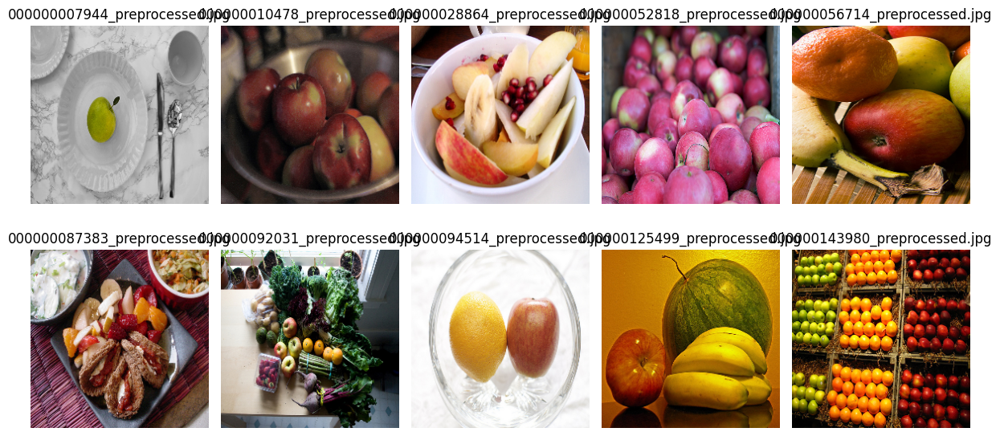

In [ ]:
# Sample data (replace this with your DataFrame)
df_food = pd.DataFrame({
    'image_file': df_food["image_file"],
    'memoscore': df_food["memorability_wo_fa_correction"]
})

# Create a new column to store the paths of preprocessed images
df_food['preprocessed_image_path'] = ''

# Empty lists to store preprocessed images
images = []

# Load and preprocess images
for index, row in df_food.iterrows():
    image_path = row['image_file']
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error reading image: {image_path}")
        continue

    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    image = cv2.resize(image, (224, 224))  # Resize image if necessary

    # Save preprocessed image to the same path
    preprocessed_path = os.path.splitext(image_path)[0] + '_preprocessed.jpg'
    cv2.imwrite(preprocessed_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

    # Store preprocessed image path in the DataFrame
    df_food.at[index, 'preprocessed_image_path'] = preprocessed_path

    images.append(image)

# Convert the list of images into a NumPy array
images = np.array(images)

# Save preprocessed images as NumPy array (if needed)
#np.save('/content/drive/MyDrive/your_folder/preprocessed_images.npy', images)

# Calculate basic image statistics
print('Image shape:', images.shape)
print('Minimum pixel value:', np.min(images))
print('Maximum pixel value:', np.max(images))
print('Mean pixel value:', np.mean(images))
print('Standard deviation of pixel values:', np.std(images))

# Visualize sample images
fig, axes = plt.subplots(2, 5, figsize=(12, 6))
axes = axes.flatten()
for i in range(min(10, len(images))):
    axes[i].imshow(images[i])
    axes[i].axis('off')
    axes[i].set_title(os.path.basename(df_food.at[i, 'preprocessed_image_path']))  # Display file name as title
plt.tight_layout()
plt.show()

# Display the updated DataFrame with preprocessed image paths
#print(df_landscape)

In [ ]:
df_food.head()

,image_file,memoscore,preprocessed_image_path
0,/content/food/000000007944.jpg,0.855556,/content/food/000000007944_preprocessed.jpg
1,/content/food/000000010478.jpg,0.811881,/content/food/000000010478_preprocessed.jpg
2,/content/food/000000028864.jpg,0.823529,/content/food/000000028864_preprocessed.jpg
3,/content/food/000000052818.jpg,0.831579,/content/food/000000052818_preprocessed.jpg
4,/content/food/000000056714.jpg,0.811881,/content/food/000000056714_preprocessed.jpg


In [ ]:
del df_food["image_file"]

In [ ]:
df_food.head()

,memoscore,preprocessed_image_path
0,0.855556,/content/food/000000007944_preprocessed.jpg
1,0.811881,/content/food/000000010478_preprocessed.jpg
2,0.823529,/content/food/000000028864_preprocessed.jpg
3,0.831579,/content/food/000000052818_preprocessed.jpg
4,0.811881,/content/food/000000056714_preprocessed.jpg


In [ ]:
from sklearn.model_selection import train_test_split

# Split the DataFrame into train and validation sets
X_train, X_val, y_train, y_val = train_test_split(pd.DataFrame(df_food.drop('memoscore', axis=1)), pd.DataFrame(df_food['memoscore']), test_size=0.1)

# Split the validation set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_val, y_val, test_size=0.5)

# Print the train, validation, and test set sizes
print('Train set size:', len(X_train))
print('Validation set size:', len(X_val))
print('Test set size:', len(X_test))

Train set size: 1800
Validation set size: 100
Test set size: 100


In [ ]:
X_train.head()

,preprocessed_image_path
943,/content/food/n07929519_31431_preprocessed.jpg
1355,/content/food/n07690273_22075_preprocessed.jpg
231,/content/food/n07654148_19681_preprocessed.jpg
823,/content/food/n07893642_28192_preprocessed.jpg
1341,/content/food/n07690273_20901_preprocessed.jpg


In [ ]:
merged_train_food= pd.concat([X_train, y_train], axis=1)
merged_train_food

,preprocessed_image_path,memoscore
943,/content/food/n07929519_31431_preprocessed.jpg,0.886598
1355,/content/food/n07690273_22075_preprocessed.jpg,0.829268
231,/content/food/n07654148_19681_preprocessed.jpg,0.883495
823,/content/food/n07893642_28192_preprocessed.jpg,0.826087
1341,/content/food/n07690273_20901_preprocessed.jpg,0.871560
...,...,...
905,/content/food/n07911677_352_preprocessed.jpg,0.881579
417,/content/food/n07574602_26378_preprocessed.jpg,0.887755
875,/content/food/n07911677_10420_preprocessed.jpg,0.688073
4,/content/food/000000056714_preprocessed.jpg,0.811881


In [ ]:
merged_val_food = pd.concat([X_val, y_val], axis=1)
merged_val_food

,preprocessed_image_path,memoscore
254,/content/food/n07720875_3102_preprocessed.jpg,0.901235
1172,/content/food/000000455255_preprocessed.jpg,0.871287
1236,/content/food/n07923748_2669_preprocessed.jpg,0.938776
62,/content/food/n07693725_14311_preprocessed.jpg,0.901961
147,/content/food/n07753592_11566_preprocessed.jpg,0.879121
...,...,...
392,/content/food/n07574602_23818_preprocessed.jpg,0.623762
1949,/content/food/n07849336_33495_preprocessed.jpg,0.780220
785,/content/food/n07801508_7358_preprocessed.jpg,0.873684
72,/content/food/n07693725_3177_preprocessed.jpg,0.966292


In [ ]:
merged_test_food = pd.concat([X_test, y_test], axis=1)
merged_test_food

,preprocessed_image_path,memoscore
452,/content/food/000000002068_preprocessed.jpg,0.854545
1946,/content/food/n07849336_32099_preprocessed.jpg,0.876190
1272,/content/food/n07711569_2294_preprocessed.jpg,0.936364
741,/content/food/000000389608_preprocessed.jpg,0.736842
1945,/content/food/n07849336_32035_preprocessed.jpg,0.889908
...,...,...
1597,/content/food/n07806221_22557_preprocessed.jpg,0.784091
609,/content/food/n07880968_6269_preprocessed.jpg,0.752809
593,/content/food/n07880968_5513_preprocessed.jpg,0.818182
1719,/content/food/000000560748_preprocessed.jpg,0.838384


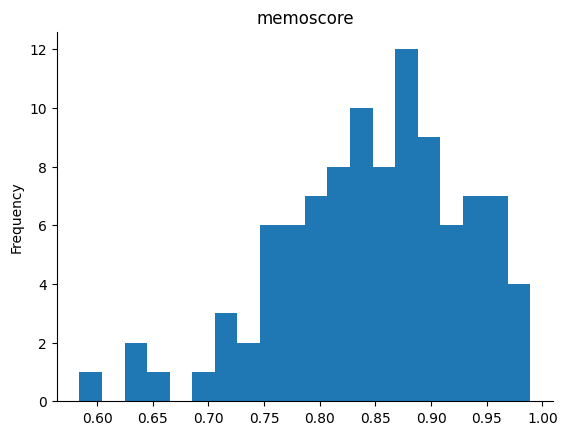

In [ ]:
# @title memoscore

from matplotlib import pyplot as plt
merged_test_food['memoscore'].plot(kind='hist', bins=20, title='memoscore')
plt.gca().spines[['top', 'right',]].set_visible(False)

# Save CSV To GGDrive

In [ ]:
# บันทึกตารางเป็นไฟล์ CSV
csv_train_food= '/content/drive/MyDrive/IS/MemCat_data/dataproject/train/food_ResNet.csv'
merged_train_food.to_csv(csv_train_food, index=False)

In [ ]:
csv_val_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/food_ResNet.csv'
merged_val_food.to_csv(csv_val_food, index=False)

In [ ]:
csv_test_food = '/content/drive/MyDrive/IS/MemCat_data/dataproject/test/food_ResNet.csv'
merged_test_food.to_csv(csv_test_food, index=False)

#Load Dataset

In [ ]:
df_train_food = pd.read_csv("/content/drive/MyDrive/IS/MemCat_data/dataproject/train/food_ResNet.csv")
df_val_food = pd.read_csv( '/content/drive/MyDrive/IS/MemCat_data/dataproject/val/food_ResNet.csv')
df_test_food = pd.read_csv('/content/drive/MyDrive/IS/MemCat_data/dataproject/test/food_ResNet.csv')

In [ ]:
df_train_food.head()

,preprocessed_image_path,memoscore
0,/content/food/n07849336_21675_preprocessed.jpg,0.807339
1,/content/food/n07880968_3281_preprocessed.jpg,0.745614
2,/content/food/n07753592_1991_preprocessed.jpg,0.858586
3,/content/food/n07850329_9287_preprocessed.jpg,0.747253
4,/content/food/000000446303_preprocessed.jpg,0.813187


In [ ]:
df_train_food.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1800 entries, 0 to 1799
Data columns (total 2 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   preprocessed_image_path  1800 non-null   object 
 1   memoscore                1800 non-null   float64
dtypes: float64(1), object(1)
memory usage: 28.2+ KB


#Load Pretrain

In [ ]:
# Define function to add data/model in to GPU (cuda)
def get_default_device():
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
def to_device(data, device):
    # if data is list or tuple, move each of them to device
    if isinstance(data, (list, tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    def __init__(self, dl, device) -> None:
        self.dl = dl
        self.device = device

    def __iter__(self):
        for b in self.dl:
            # yield only execuate when the function is called
            yield to_device(b, self. device)

    def __len__(self):
        return len(self.dl)

## Train

In [ ]:
class Dataset_res_food(Dataset):
    def __init__(self, df,Resnet_transform =None):
        self.labels = df_train_food["memoscore"]
        self.images = df_train_food["preprocessed_image_path"]
        self.Resnet_transform  = Resnet_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.Resnet_transform (image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
#trans_transform = ViTFeatureExtractor.from_pretrained('google/vit-base-patch16-224')
Resnet_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
train_ds = Dataset_res_food(df_train_food, Resnet_transform =Resnet_transform )
train_dl = DataLoader(train_ds, batch_size=32, shuffle=False)



/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/266 [00:00<?, ?B/s]

In [ ]:
class ResNet_model_train_food(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):    #microsoft/resnet-50
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)
        #self.res_AdaptiveAvgPool = nn.AdaptiveAvgPool2d((1, None))


    def forward(self, x):
        resfeat = self.res(x)
        #adap = self.res_AdaptiveAvgPool(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

ResNet = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res =  ResNet_model_train_food( arch="resnet50.a1_in1k")


model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

In [ ]:
# Assuming your model is an instance of YourModelClass and is already on GPU
model =ResNet_model_train_food().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)




----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl = DeviceDataLoader(train_dl, device)
model_res  = to_device(model_res  , device)

In [ ]:
params = [param for param in list(model_res.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)


In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res, train_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.02405600994825363

 Epoch: (1/50) Loss_rmse = 0.1551000028848648

 Epoch: (1/50) R^2 = -10.749095916748047

 Epoch: (1/50) MAE = 0.14868980646133423
Spearman correlation coefficient: SignificanceResult(statistic=0.039698255889797716, pvalue=0.09295789366391992)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021

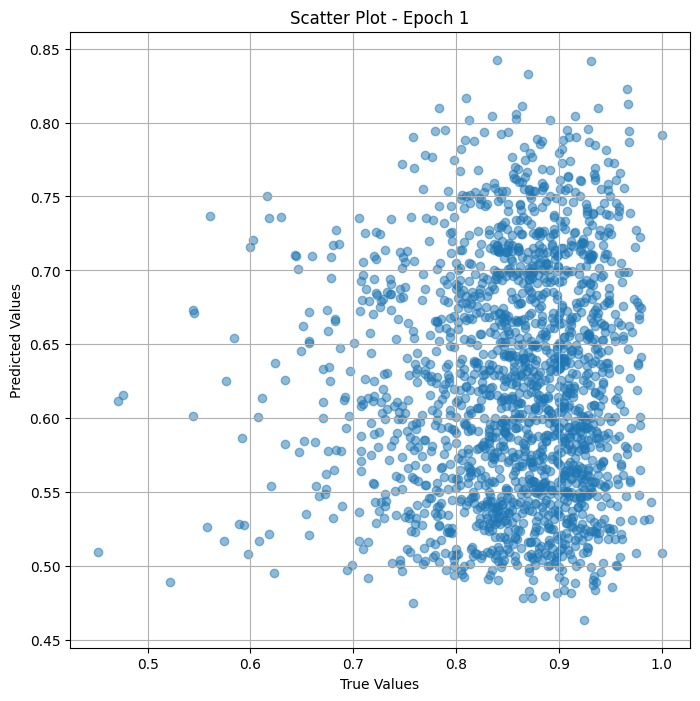

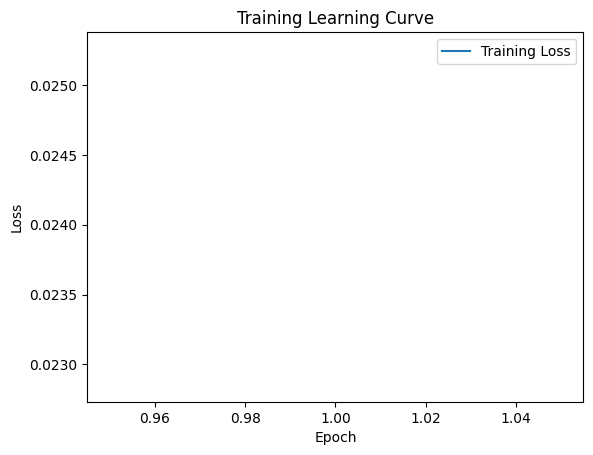


 Epoch: (2/50) Loss = 0.001592676853761077

 Epoch: (2/50) Loss_rmse = 0.039908356964588165

 Epoch: (2/50) R^2 = 0.22212731838226318

 Epoch: (2/50) MAE = 0.03578224033117294
Spearman correlation coefficient: SignificanceResult(statistic=0.3717238395715989, pvalue=7.983405124768029e-60)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8

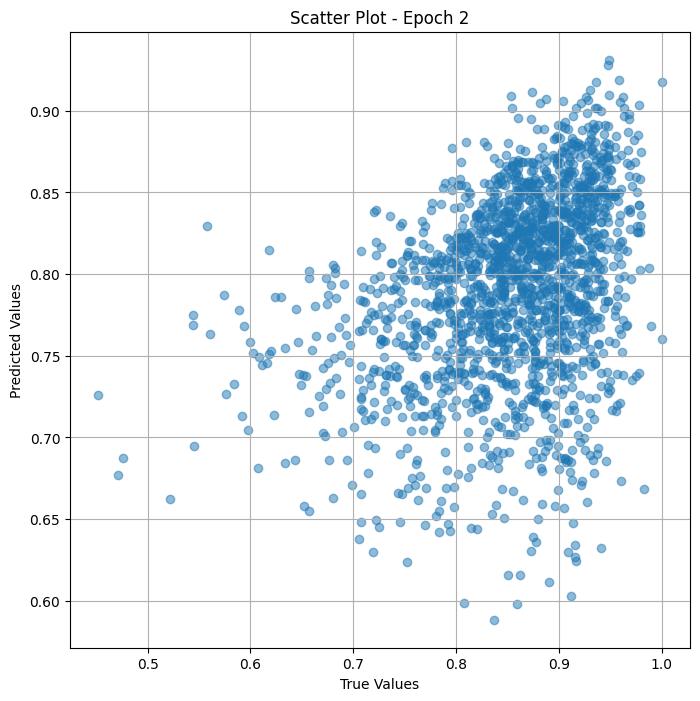

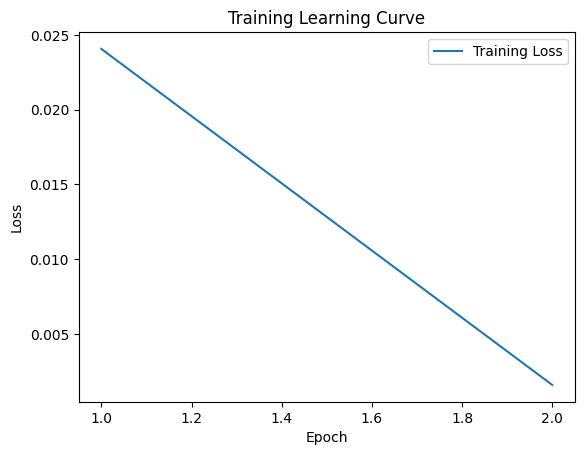


 Epoch: (3/50) Loss = 0.0005468506715260446

 Epoch: (3/50) Loss_rmse = 0.023384839296340942

 Epoch: (3/50) R^2 = 0.732914924621582

 Epoch: (3/50) MAE = 0.017640970647335052
Spearman correlation coefficient: SignificanceResult(statistic=0.8132542080679267, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

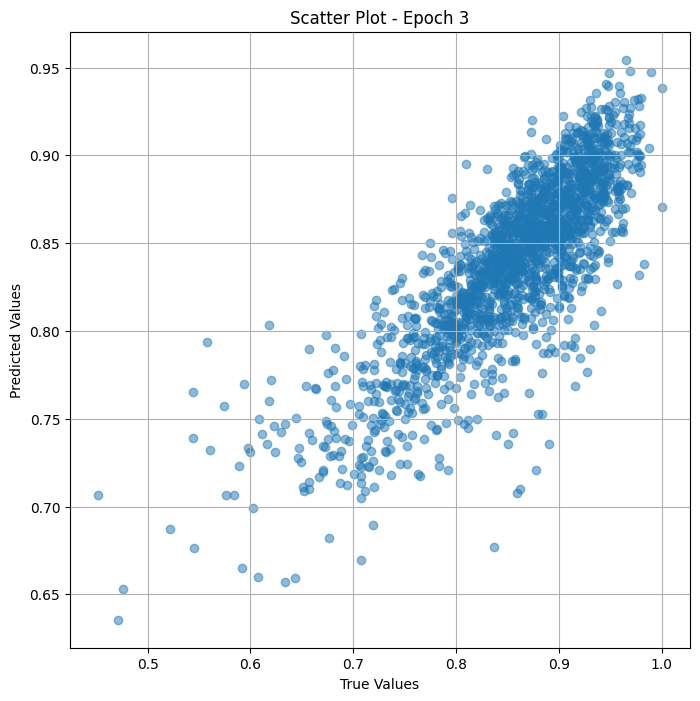

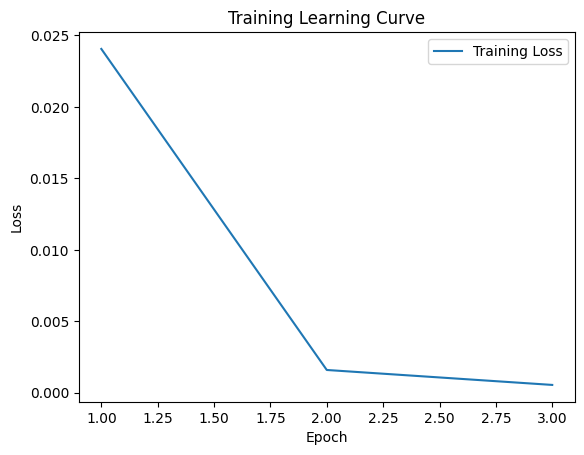


 Epoch: (4/50) Loss = 0.0008086965535767376

 Epoch: (4/50) Loss_rmse = 0.02843759022653103

 Epoch: (4/50) R^2 = 0.6050279140472412

 Epoch: (4/50) MAE = 0.02448456734418869
Spearman correlation coefficient: SignificanceResult(statistic=0.9348762019928678, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.87

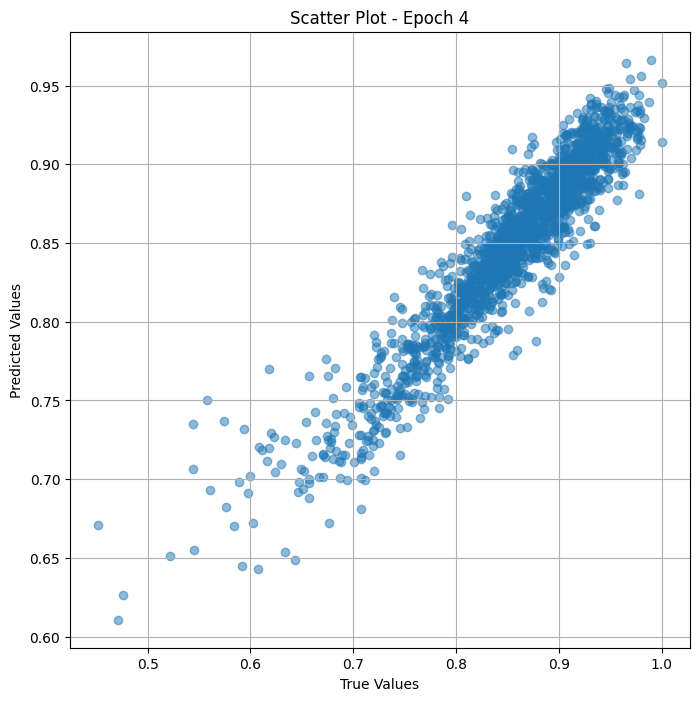

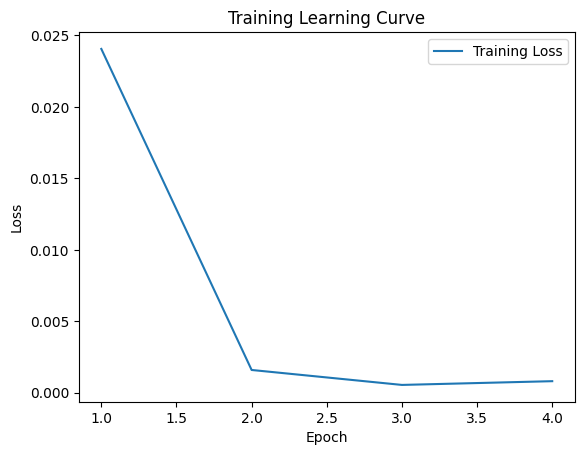


 Epoch: (5/50) Loss = 0.0009195416350848973

 Epoch: (5/50) Loss_rmse = 0.030323944985866547

 Epoch: (5/50) R^2 = 0.5508904457092285

 Epoch: (5/50) MAE = 0.023814693093299866
Spearman correlation coefficient: SignificanceResult(statistic=0.963792958252506, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

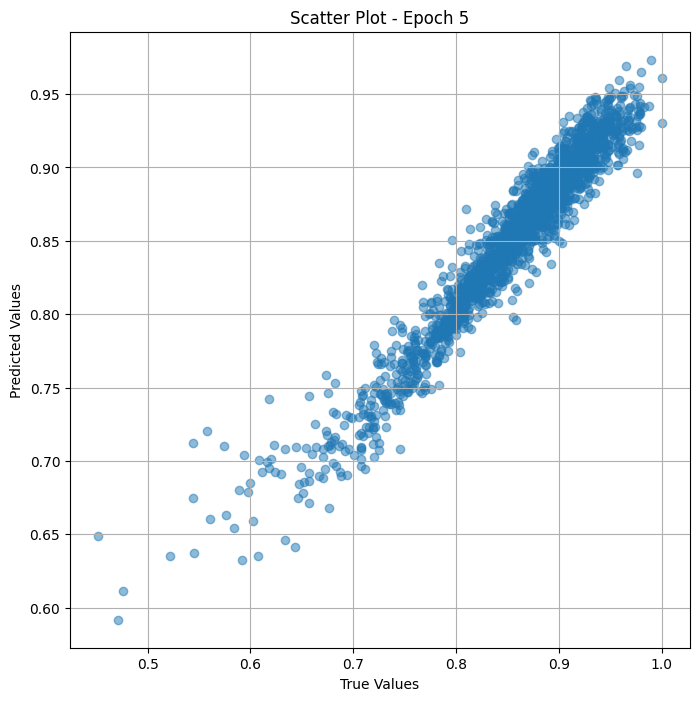

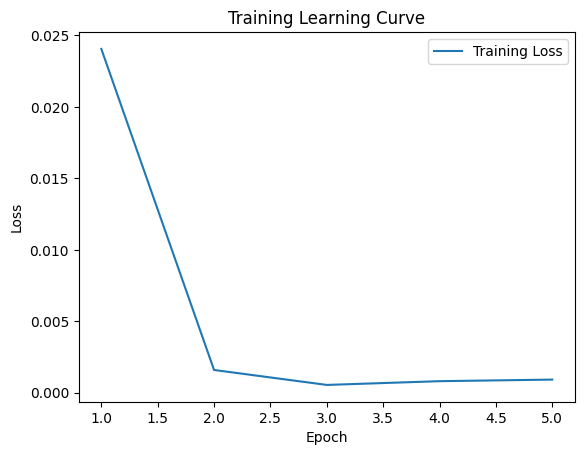

Epoch 0.04: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (6/50) Loss = 0.0013770549558103085

 Epoch: (6/50) Loss_rmse = 0.03710868954658508

 Epoch: (6/50) R^2 = 0.3274382948875427

 Epoch: (6/50) MAE = 0.031729958951473236
Spearman correlation coefficient: SignificanceResult(statistic=0.9719162326351444, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.807

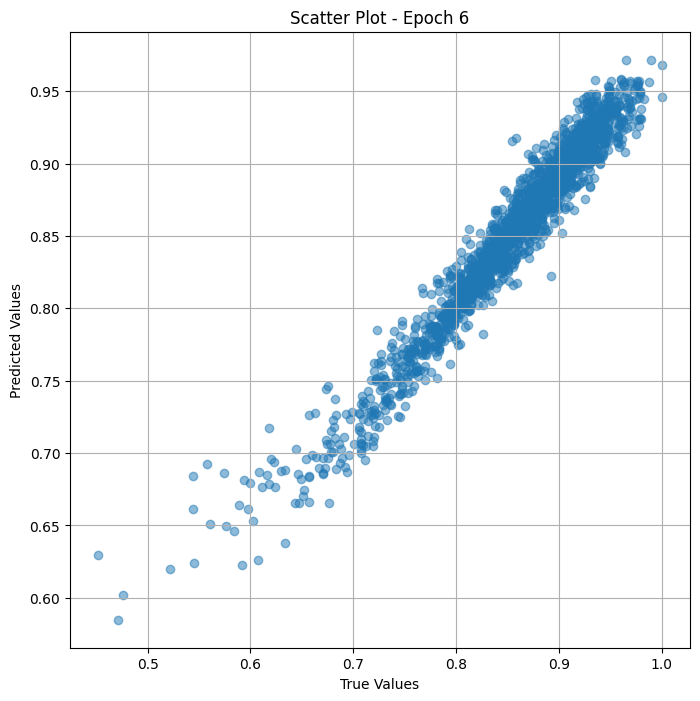

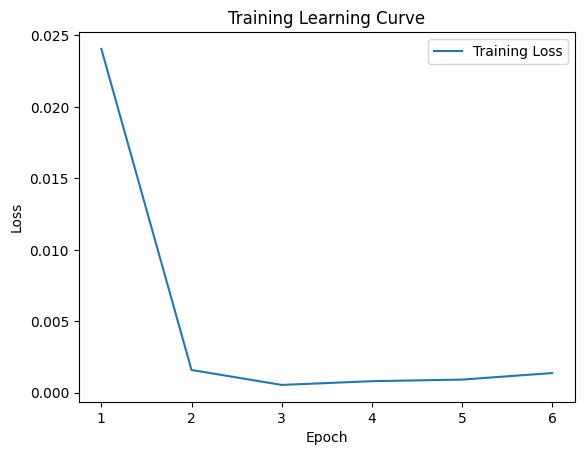


 Epoch: (7/50) Loss = 0.0003067188081331551

 Epoch: (7/50) Loss_rmse = 0.017513388767838478

 Epoch: (7/50) R^2 = 0.8501967191696167

 Epoch: (7/50) MAE = 0.01335560530424118
Spearman correlation coefficient: SignificanceResult(statistic=0.9750706064306854, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

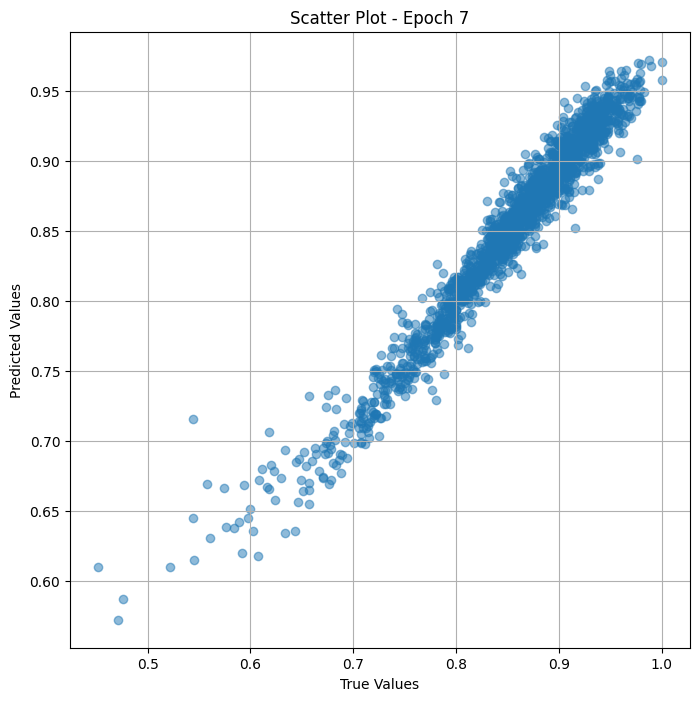

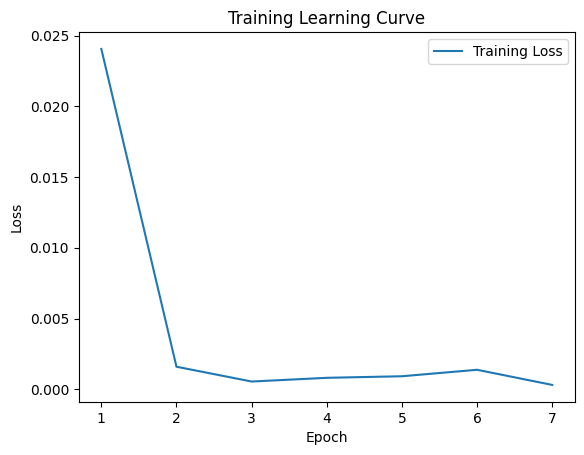


 Epoch: (8/50) Loss = 0.00015404766600113362

 Epoch: (8/50) Loss_rmse = 0.01241159439086914

 Epoch: (8/50) R^2 = 0.9247622489929199

 Epoch: (8/50) MAE = 0.008873112499713898
Spearman correlation coefficient: SignificanceResult(statistic=0.9817383418223535, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.

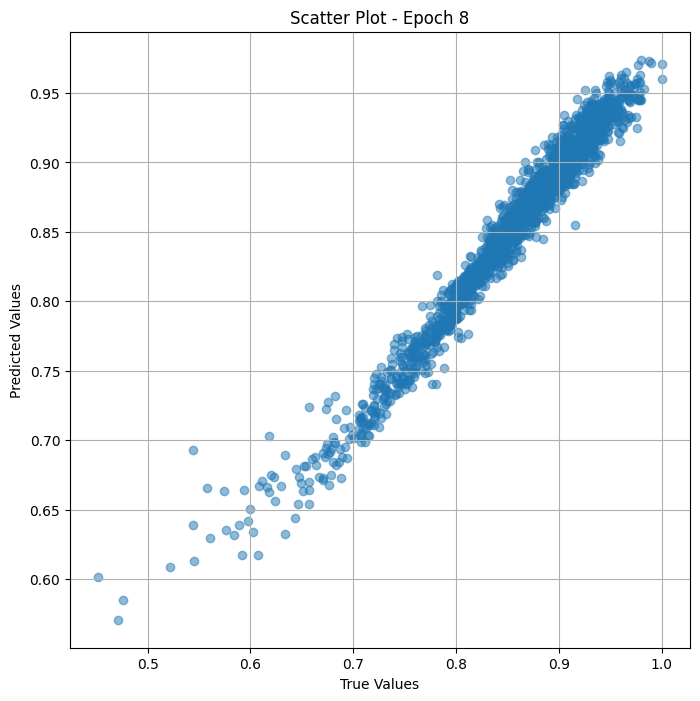

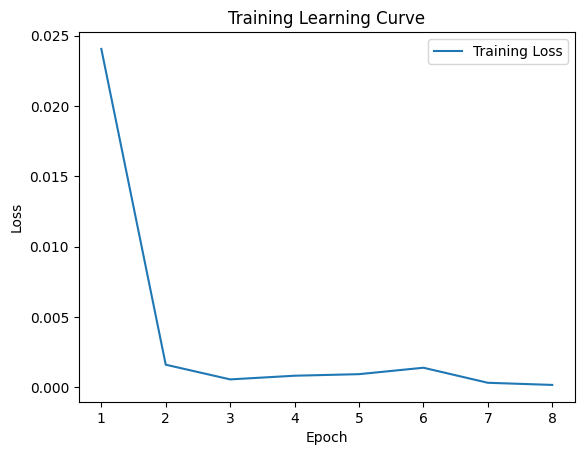


 Epoch: (9/50) Loss = 7.784868648741394e-05

 Epoch: (9/50) Loss_rmse = 0.00882318988442421

 Epoch: (9/50) R^2 = 0.9619782567024231

 Epoch: (9/50) MAE = 0.006371103227138519
Spearman correlation coefficient: SignificanceResult(statistic=0.9848585260560225, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

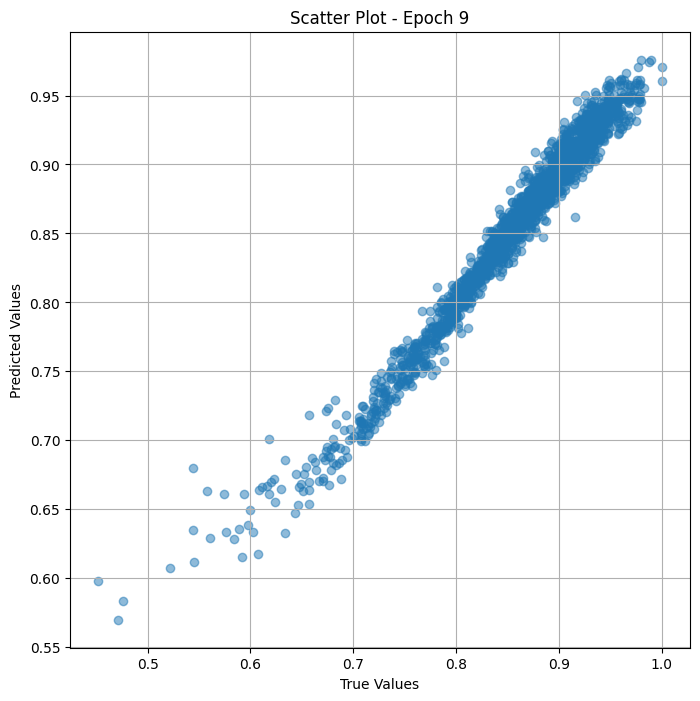

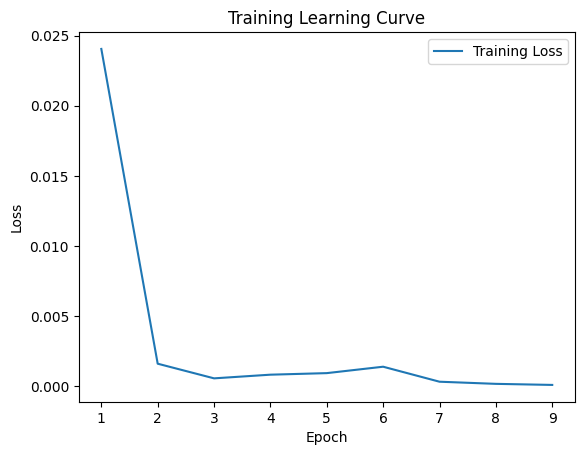


 Epoch: (10/50) Loss = 3.8694161048624665e-05

 Epoch: (10/50) Loss_rmse = 0.0062204631976783276

 Epoch: (10/50) R^2 = 0.9811015725135803

 Epoch: (10/50) MAE = 0.004387862980365753
Spearman correlation coefficient: SignificanceResult(statistic=0.9868729624109068, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

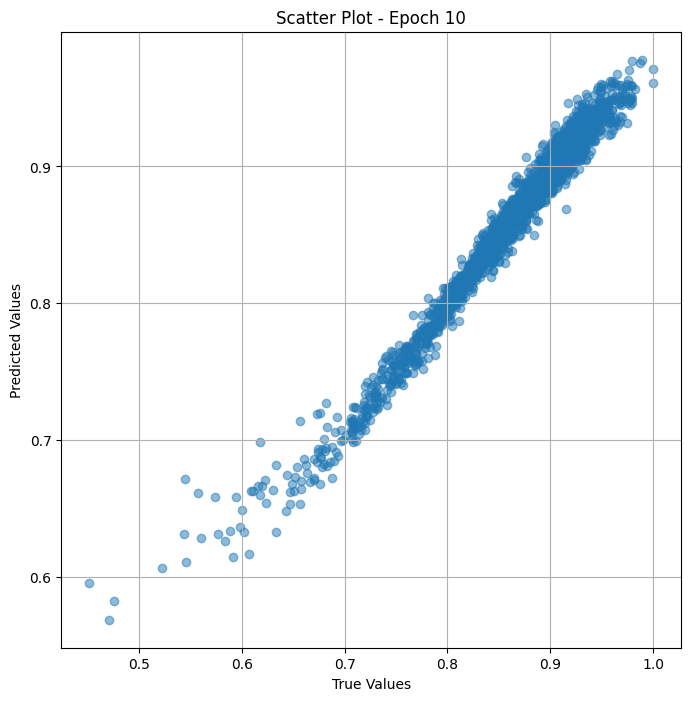

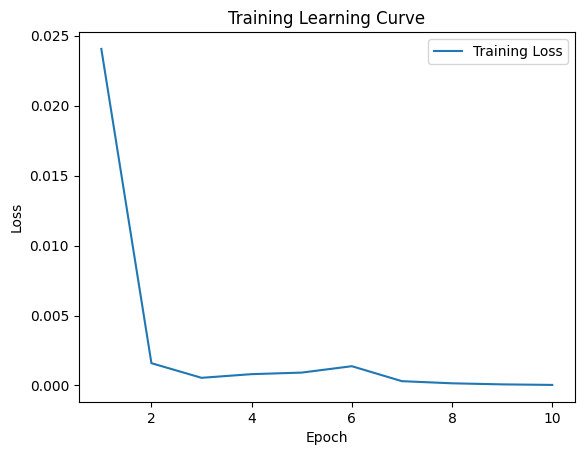


 Epoch: (11/50) Loss = 2.1624138753395528e-05

 Epoch: (11/50) Loss_rmse = 0.004650176037102938

 Epoch: (11/50) R^2 = 0.9894386529922485

 Epoch: (11/50) MAE = 0.0034020990133285522
Spearman correlation coefficient: SignificanceResult(statistic=0.9883506321957397, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

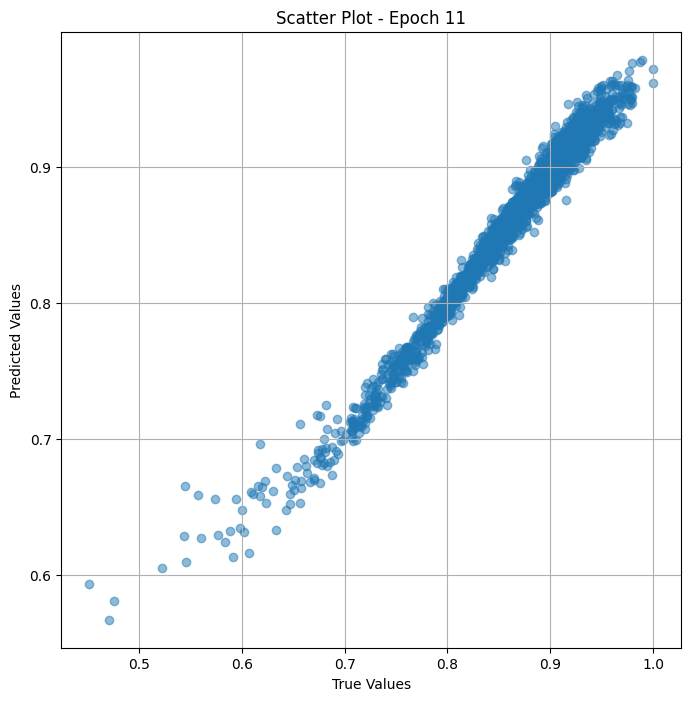

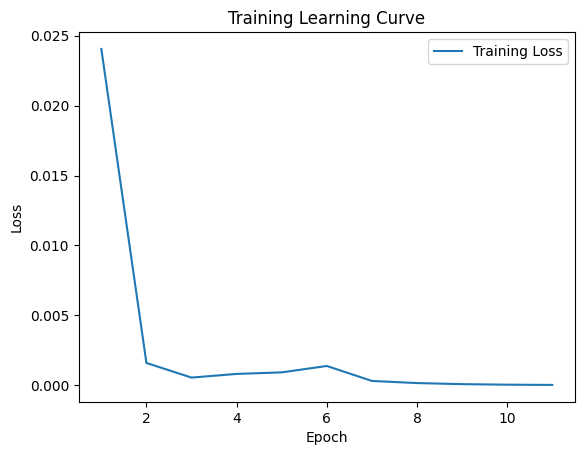


 Epoch: (12/50) Loss = 1.4520499462378211e-05

 Epoch: (12/50) Loss_rmse = 0.0038105773273855448

 Epoch: (12/50) R^2 = 0.9929081201553345

 Epoch: (12/50) MAE = 0.003154166042804718
Spearman correlation coefficient: SignificanceResult(statistic=0.9895163742160211, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

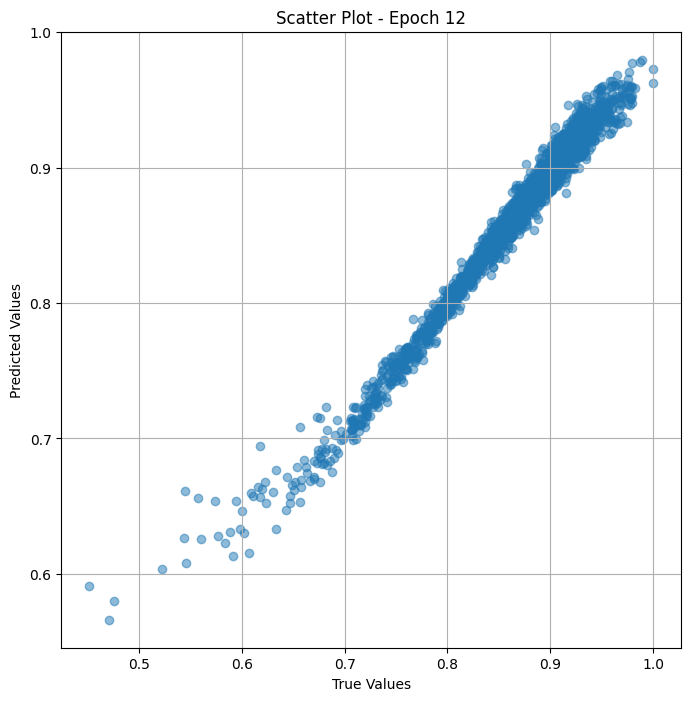

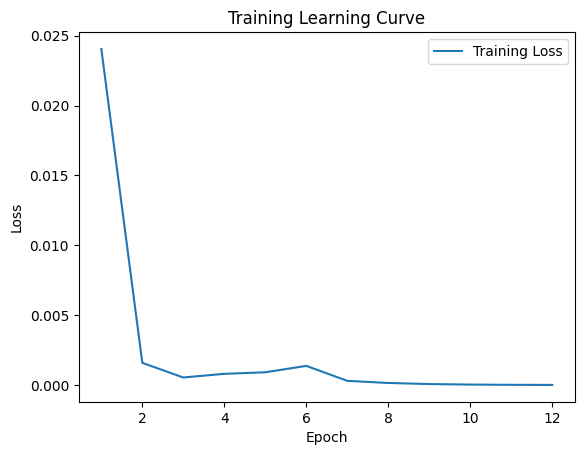


 Epoch: (13/50) Loss = 1.2043410606565885e-05

 Epoch: (13/50) Loss_rmse = 0.0034703616984188557

 Epoch: (13/50) R^2 = 0.9941179156303406

 Epoch: (13/50) MAE = 0.0030683428049087524
Spearman correlation coefficient: SignificanceResult(statistic=0.9904576491516156, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

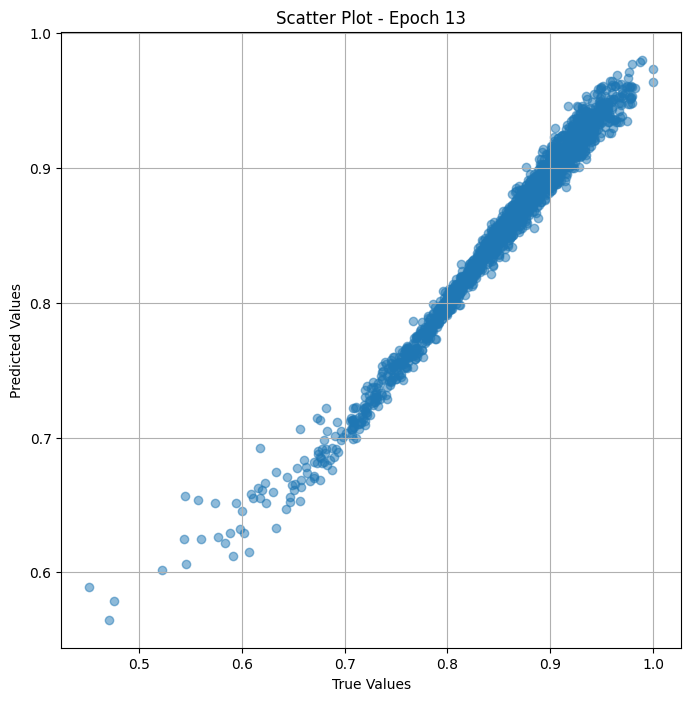

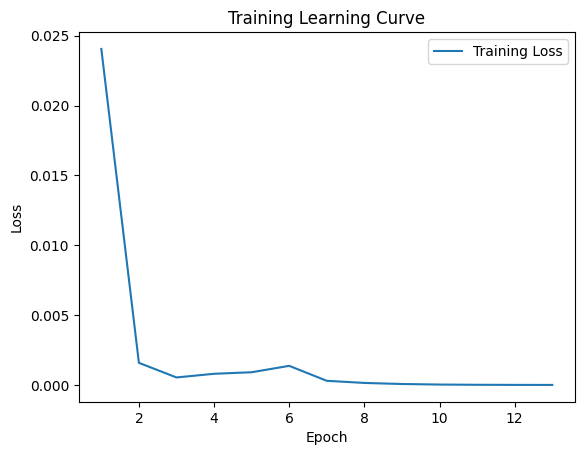


 Epoch: (14/50) Loss = 1.1200594599358737e-05

 Epoch: (14/50) Loss_rmse = 0.0033467288594692945

 Epoch: (14/50) R^2 = 0.9945295453071594

 Epoch: (14/50) MAE = 0.0030075758695602417
Spearman correlation coefficient: SignificanceResult(statistic=0.9912396706369864, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

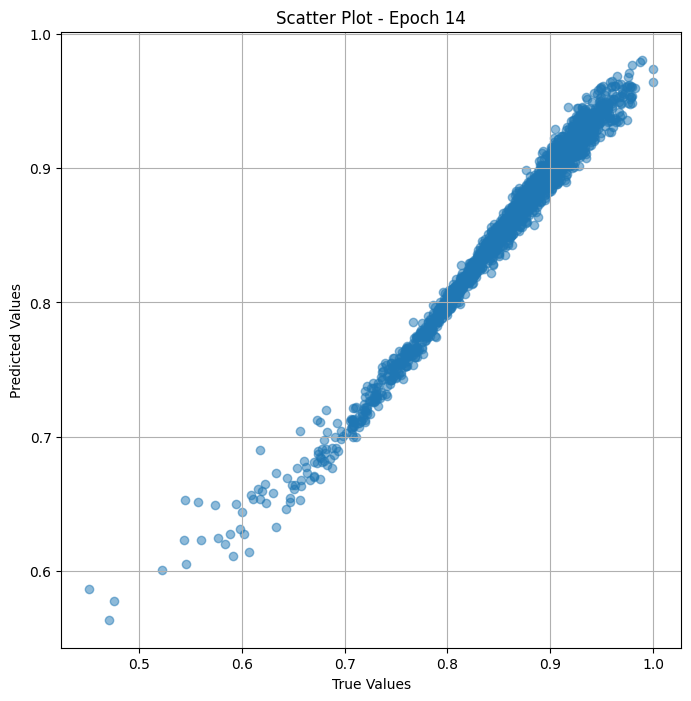

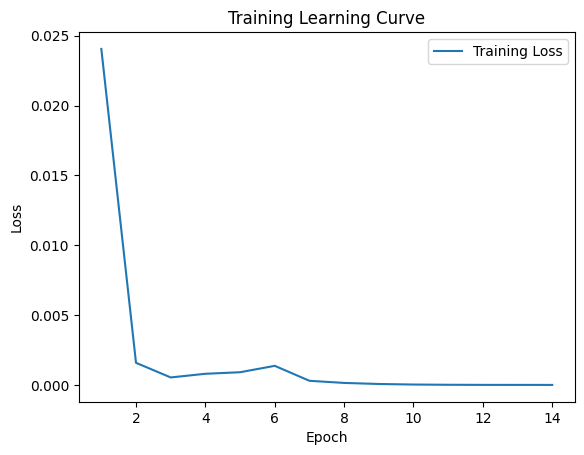


 Epoch: (15/50) Loss = 1.0863352144951932e-05

 Epoch: (15/50) Loss_rmse = 0.0032959599047899246

 Epoch: (15/50) R^2 = 0.9946942925453186

 Epoch: (15/50) MAE = 0.0029500722885131836
Spearman correlation coefficient: SignificanceResult(statistic=0.9919376961761441, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

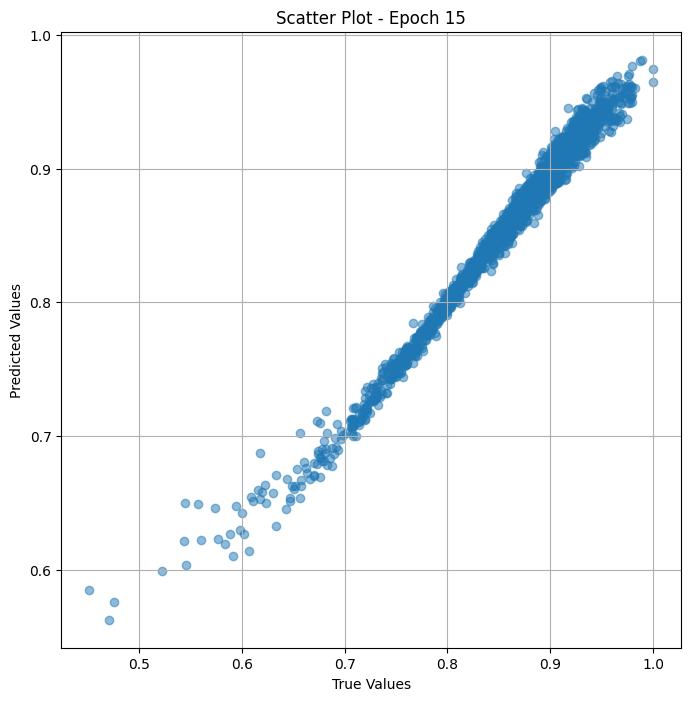

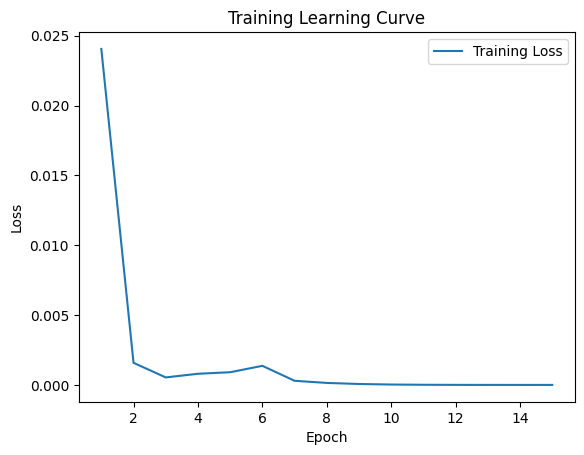


 Epoch: (16/50) Loss = 1.0684472727007233e-05

 Epoch: (16/50) Loss_rmse = 0.003268711268901825

 Epoch: (16/50) R^2 = 0.9947816133499146

 Epoch: (16/50) MAE = 0.0029032155871391296
Spearman correlation coefficient: SignificanceResult(statistic=0.9925561148027985, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

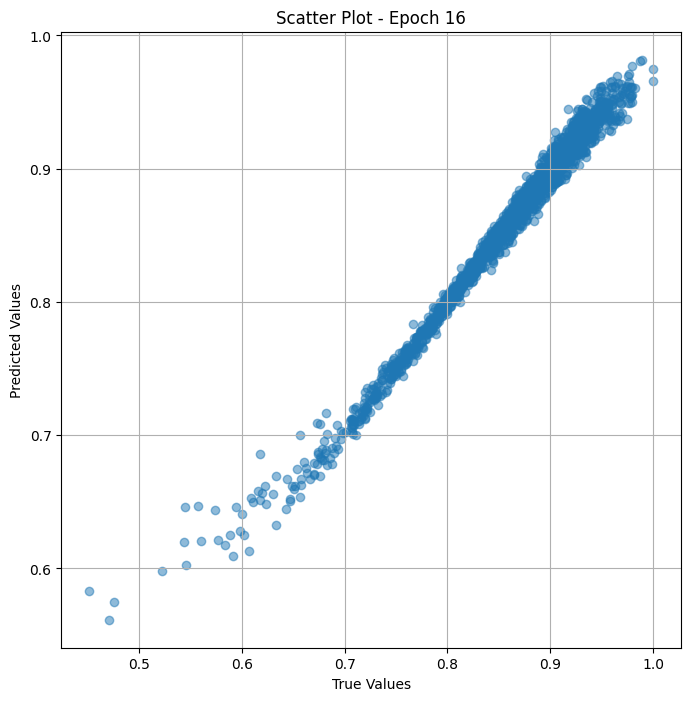

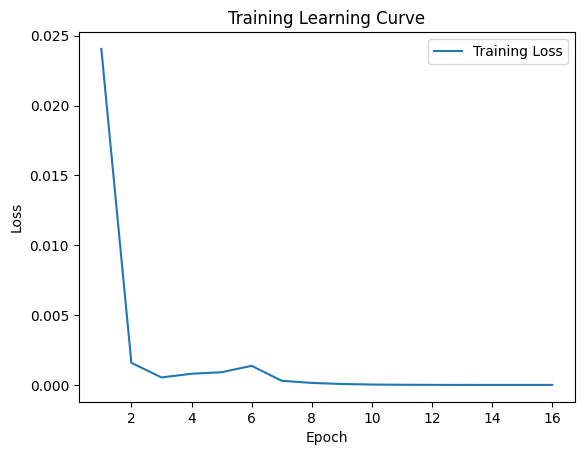


 Epoch: (17/50) Loss = 1.0514773748582229e-05

 Epoch: (17/50) Loss_rmse = 0.0032426491379737854

 Epoch: (17/50) R^2 = 0.9948645234107971

 Epoch: (17/50) MAE = 0.002857521176338196
Spearman correlation coefficient: SignificanceResult(statistic=0.9930806104032821, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

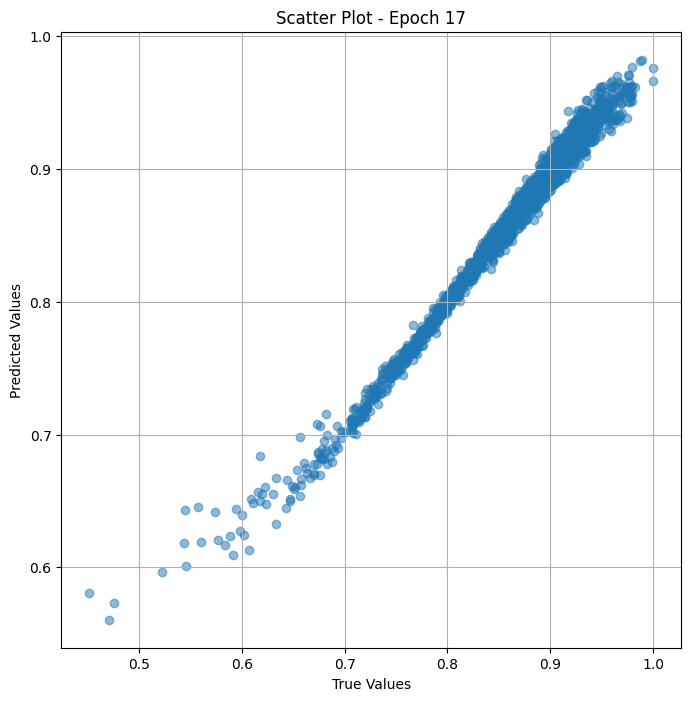

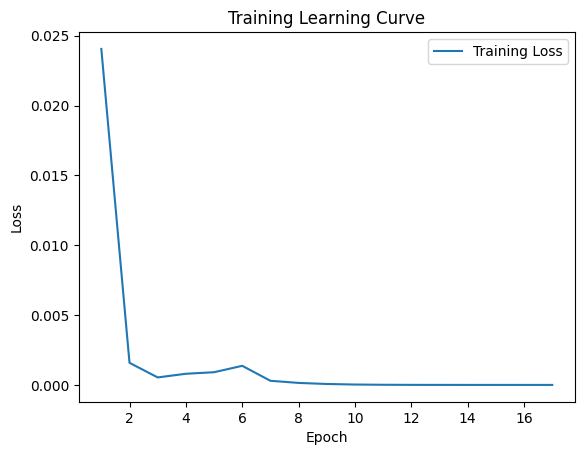


 Epoch: (18/50) Loss = 1.0332510100852232e-05

 Epoch: (18/50) Loss_rmse = 0.003214422147721052

 Epoch: (18/50) R^2 = 0.9949535131454468

 Epoch: (18/50) MAE = 0.0028190985321998596
Spearman correlation coefficient: SignificanceResult(statistic=0.9935463244637448, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

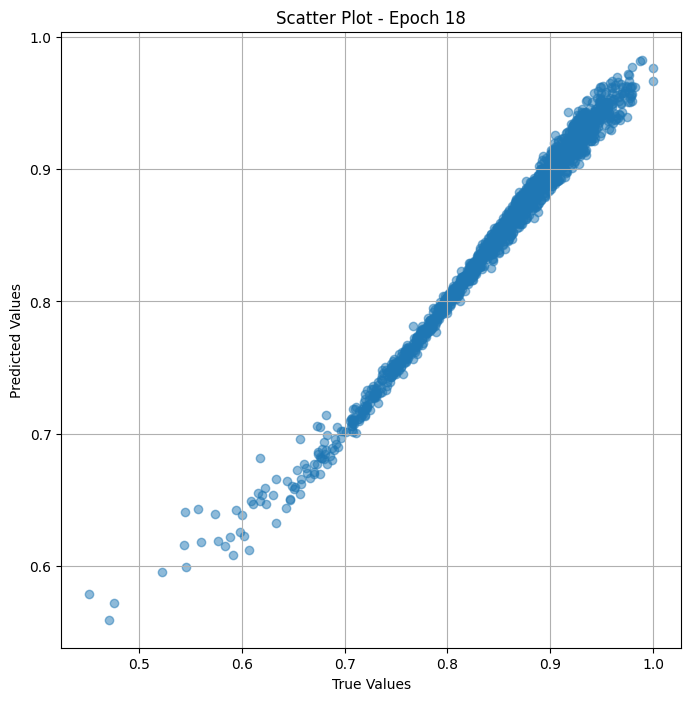

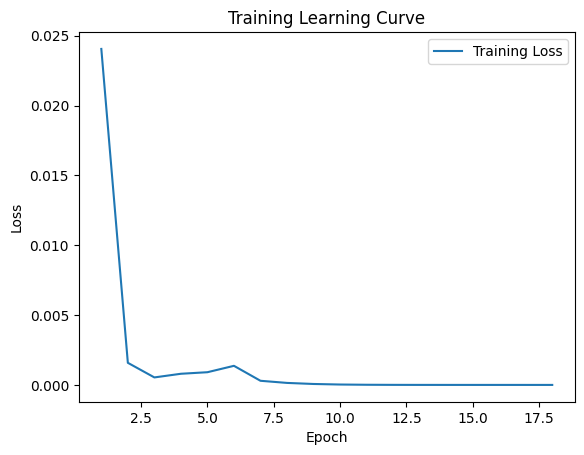


 Epoch: (19/50) Loss = 1.0122902494913433e-05

 Epoch: (19/50) Loss_rmse = 0.0031816510017961264

 Epoch: (19/50) R^2 = 0.9950559139251709

 Epoch: (19/50) MAE = 0.0027723386883735657
Spearman correlation coefficient: SignificanceResult(statistic=0.9939802856559224, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

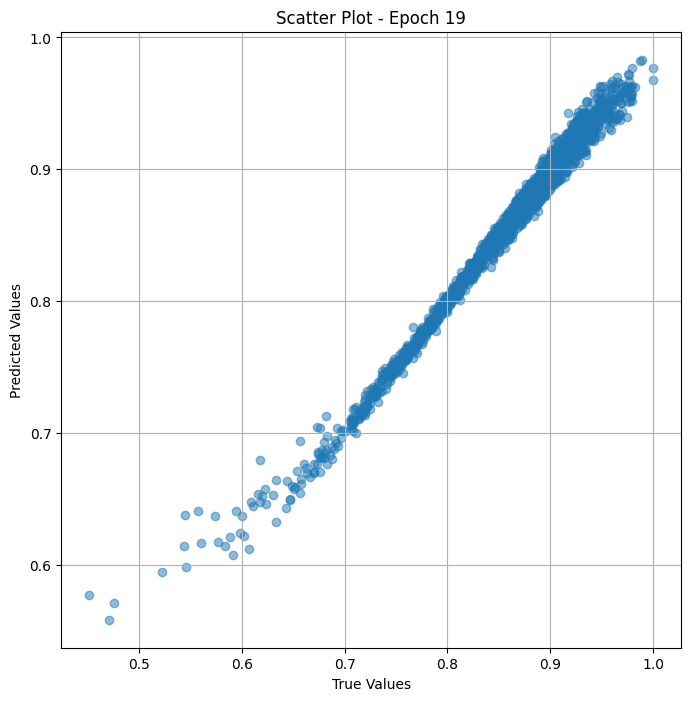

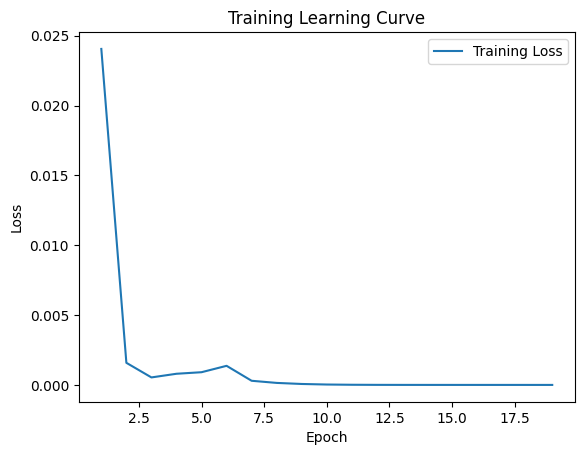


 Epoch: (20/50) Loss = 9.861244507192168e-06

 Epoch: (20/50) Loss_rmse = 0.0031402618624269962

 Epoch: (20/50) R^2 = 0.9951837062835693

 Epoch: (20/50) MAE = 0.0027301236987113953
Spearman correlation coefficient: SignificanceResult(statistic=0.9943719324179007, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

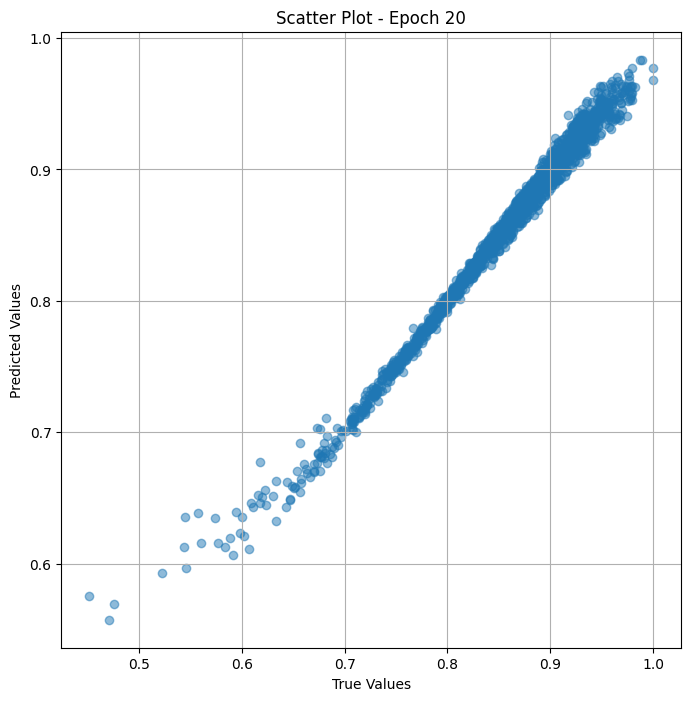

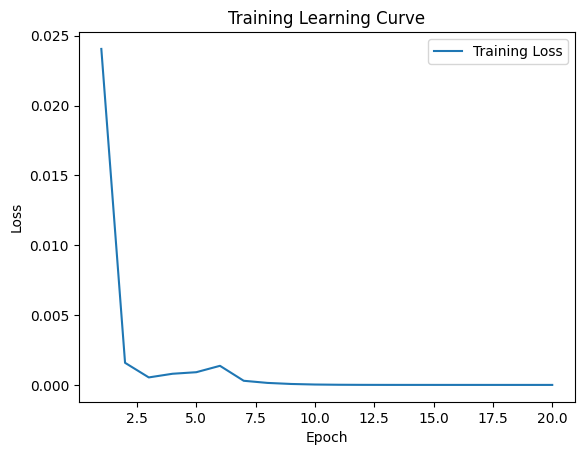


 Epoch: (21/50) Loss = 9.582127859175671e-06

 Epoch: (21/50) Loss_rmse = 0.003095501335337758

 Epoch: (21/50) R^2 = 0.9953200221061707

 Epoch: (21/50) MAE = 0.0026859939098358154
Spearman correlation coefficient: SignificanceResult(statistic=0.9947400006739304, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

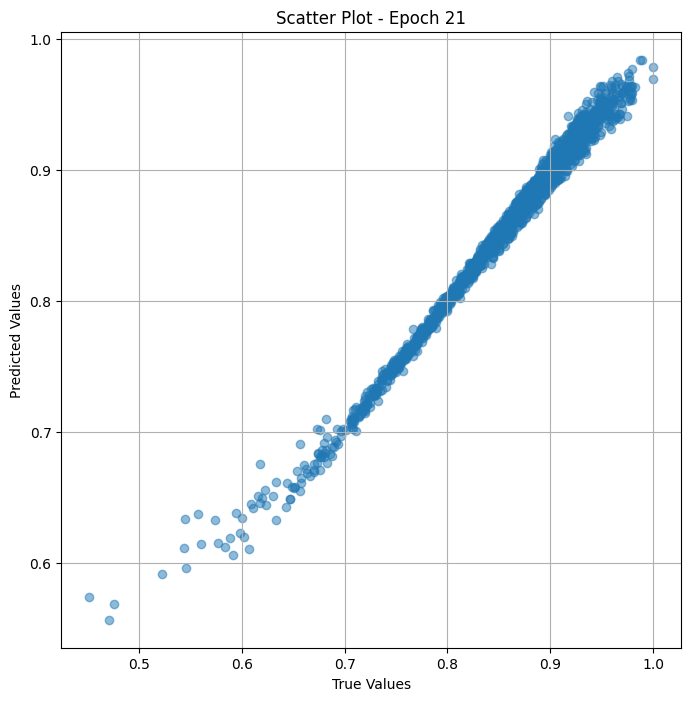

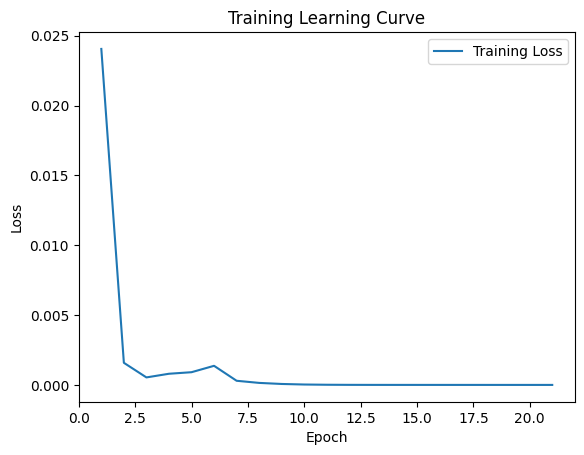


 Epoch: (22/50) Loss = 9.24292817217065e-06

 Epoch: (22/50) Loss_rmse = 0.0030402184929698706

 Epoch: (22/50) R^2 = 0.9954857230186462

 Epoch: (22/50) MAE = 0.0026330500841140747
Spearman correlation coefficient: SignificanceResult(statistic=0.9950939582123456, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

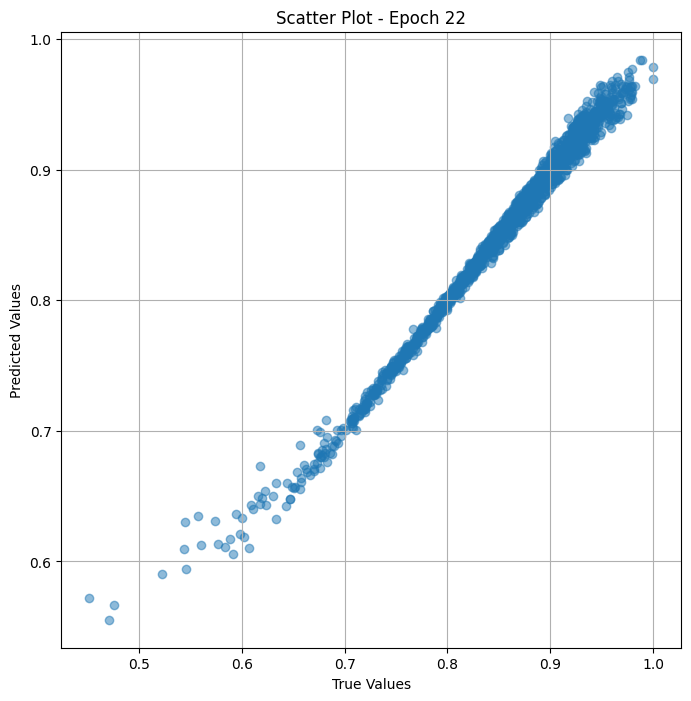

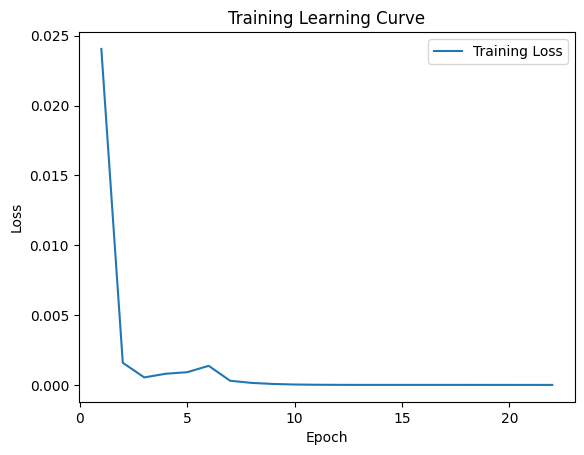


 Epoch: (23/50) Loss = 8.879530469130259e-06

 Epoch: (23/50) Loss_rmse = 0.0029798541218042374

 Epoch: (23/50) R^2 = 0.9956631660461426

 Epoch: (23/50) MAE = 0.002576299011707306
Spearman correlation coefficient: SignificanceResult(statistic=0.9954094221297582, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

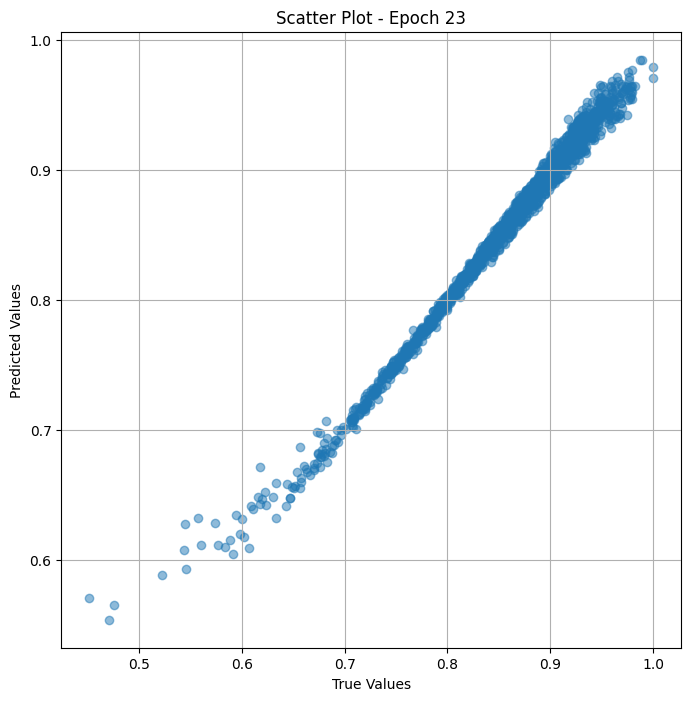

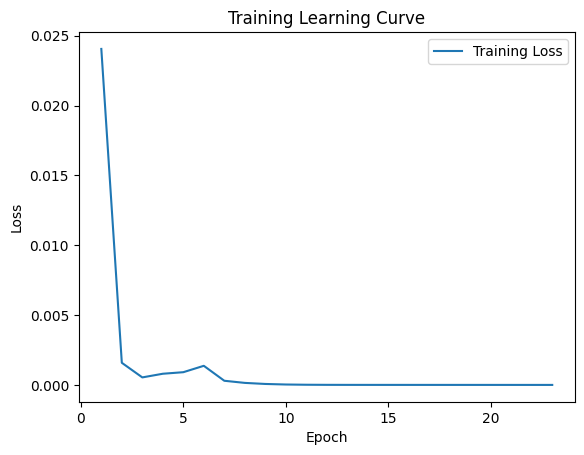


 Epoch: (24/50) Loss = 8.464166967314668e-06

 Epoch: (24/50) Loss_rmse = 0.0029093241319060326

 Epoch: (24/50) R^2 = 0.995866060256958

 Epoch: (24/50) MAE = 0.002511933445930481
Spearman correlation coefficient: SignificanceResult(statistic=0.995711751250737, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975,

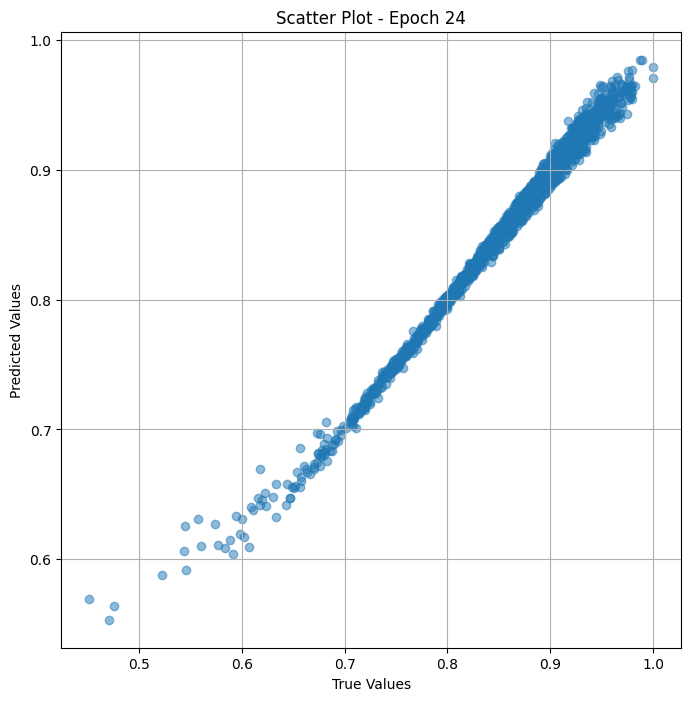

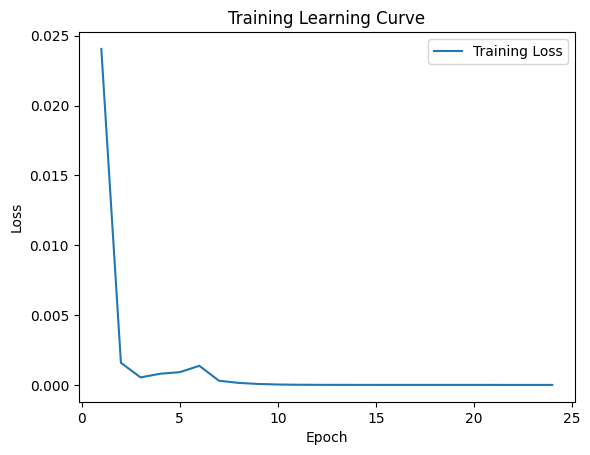


 Epoch: (25/50) Loss = 8.049546522670425e-06

 Epoch: (25/50) Loss_rmse = 0.002837172243744135

 Epoch: (25/50) R^2 = 0.99606853723526

 Epoch: (25/50) MAE = 0.002449117600917816
Spearman correlation coefficient: SignificanceResult(statistic=0.9959958110396328, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 

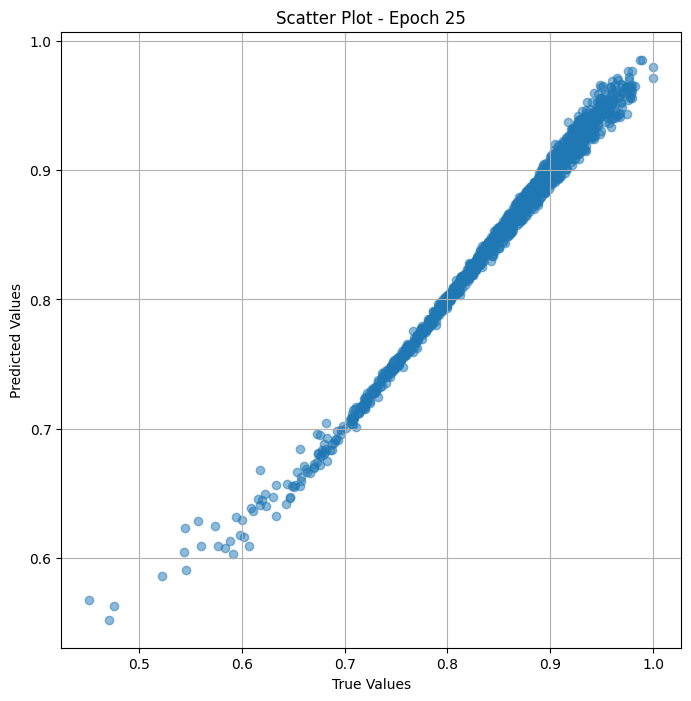

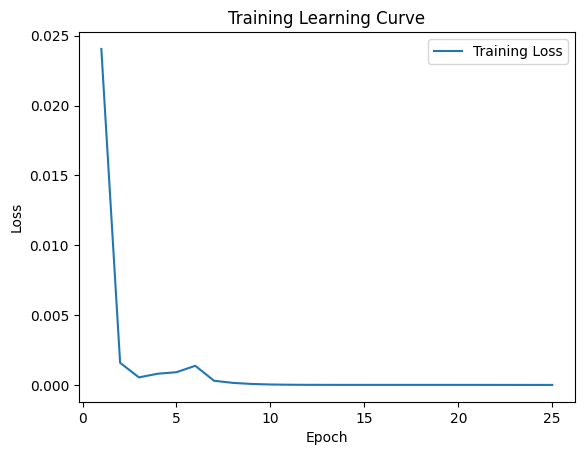


 Epoch: (26/50) Loss = 7.636401278432459e-06

 Epoch: (26/50) Loss_rmse = 0.002763404045253992

 Epoch: (26/50) R^2 = 0.9962703585624695

 Epoch: (26/50) MAE = 0.0023846477270126343
Spearman correlation coefficient: SignificanceResult(statistic=0.9962393836623705, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

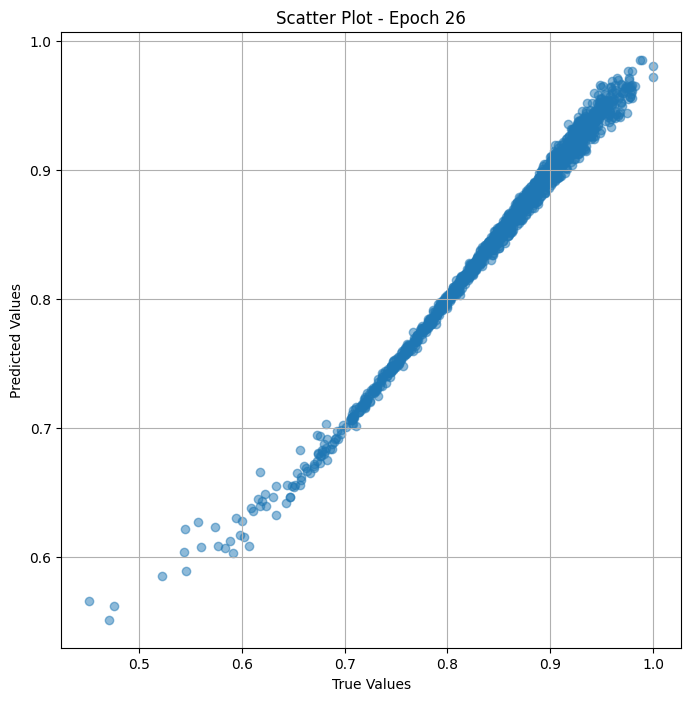

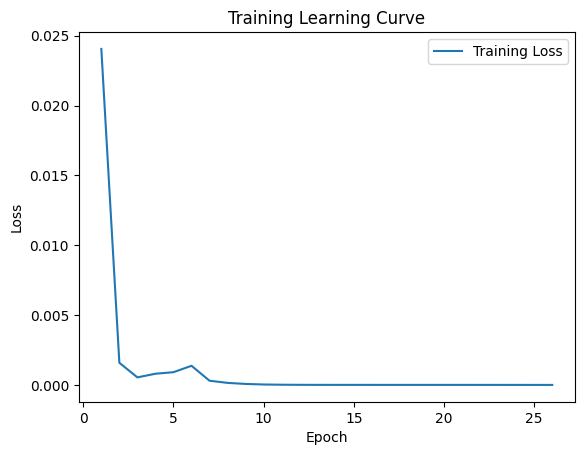


 Epoch: (27/50) Loss = 7.179147814895259e-06

 Epoch: (27/50) Loss_rmse = 0.0026793931610882282

 Epoch: (27/50) R^2 = 0.9964936375617981

 Epoch: (27/50) MAE = 0.002314046025276184
Spearman correlation coefficient: SignificanceResult(statistic=0.9964823854277627, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

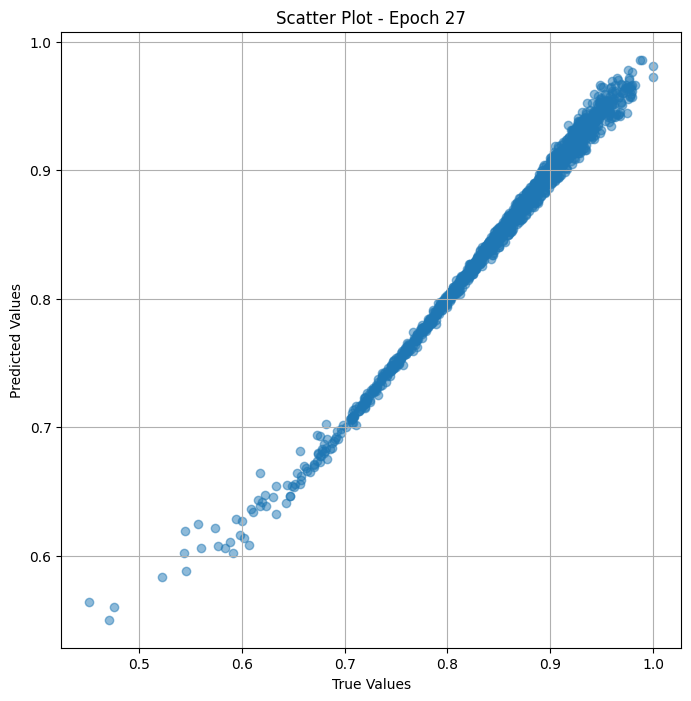

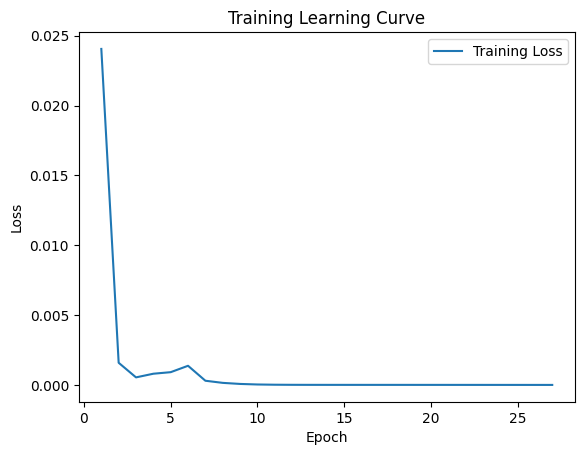


 Epoch: (28/50) Loss = 6.713265065627638e-06

 Epoch: (28/50) Loss_rmse = 0.0025909969117492437

 Epoch: (28/50) R^2 = 0.9967212080955505

 Epoch: (28/50) MAE = 0.0022415444254875183
Spearman correlation coefficient: SignificanceResult(statistic=0.9967248559645175, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

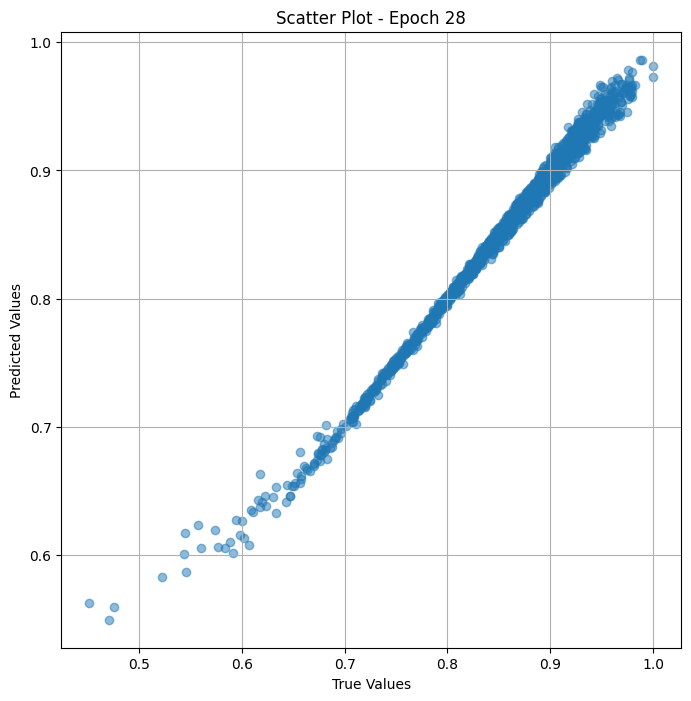

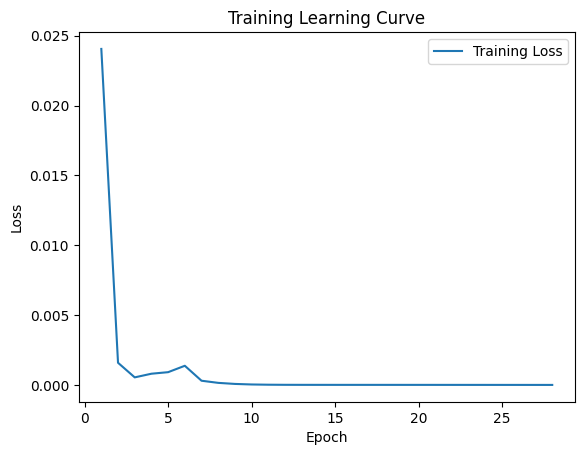


 Epoch: (29/50) Loss = 6.2469530348607805e-06

 Epoch: (29/50) Loss_rmse = 0.0024993906263262033

 Epoch: (29/50) R^2 = 0.9969489574432373

 Epoch: (29/50) MAE = 0.0021646618843078613
Spearman correlation coefficient: SignificanceResult(statistic=0.9969440508869737, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

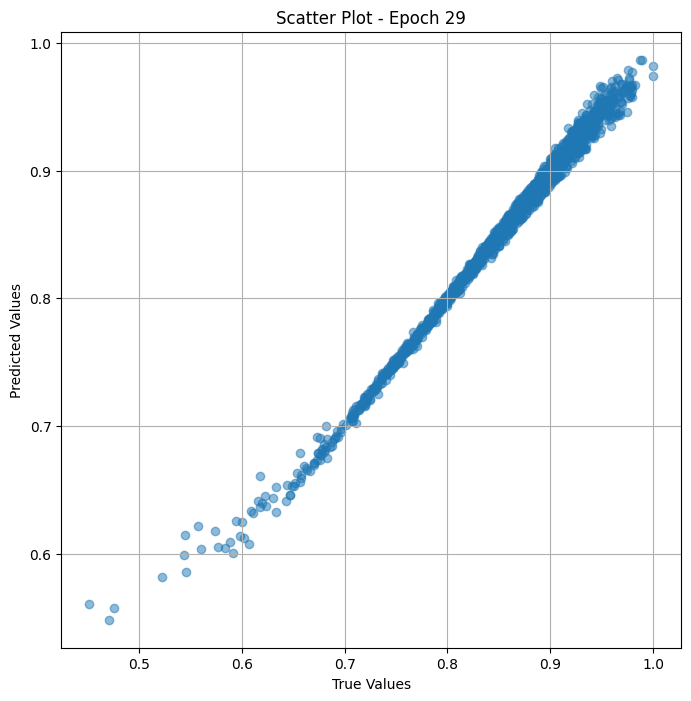

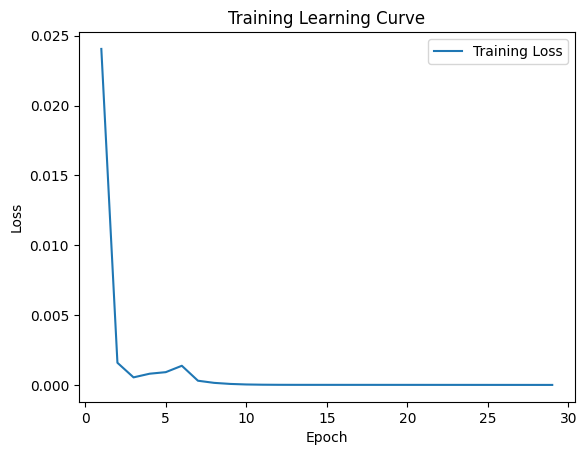


 Epoch: (30/50) Loss = 5.783143478765851e-06

 Epoch: (30/50) Loss_rmse = 0.0024048166815191507

 Epoch: (30/50) R^2 = 0.9971754550933838

 Epoch: (30/50) MAE = 0.0020789653062820435
Spearman correlation coefficient: SignificanceResult(statistic=0.9971418615589595, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

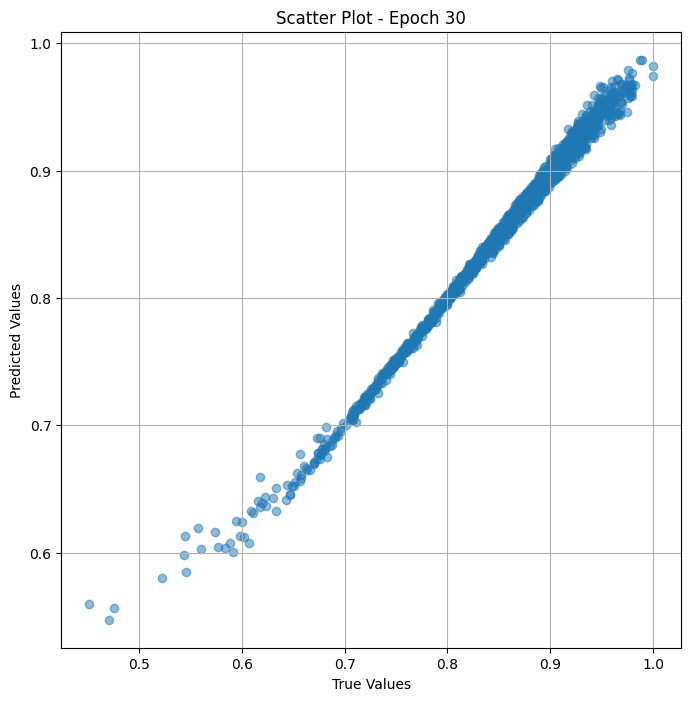

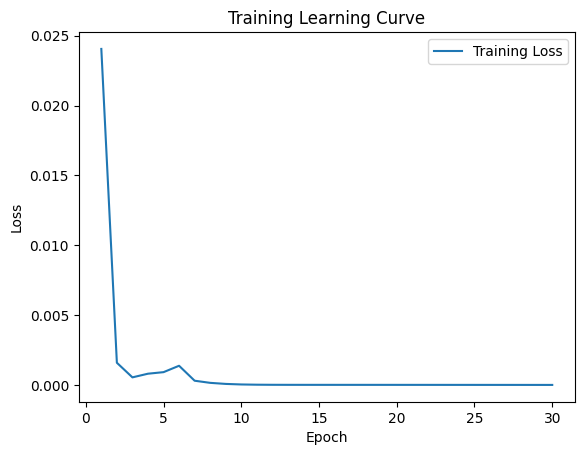


 Epoch: (31/50) Loss = 5.316939223121153e-06

 Epoch: (31/50) Loss_rmse = 0.002305848989635706

 Epoch: (31/50) R^2 = 0.9974032044410706

 Epoch: (31/50) MAE = 0.002000086009502411
Spearman correlation coefficient: SignificanceResult(statistic=0.9973392311912376, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975

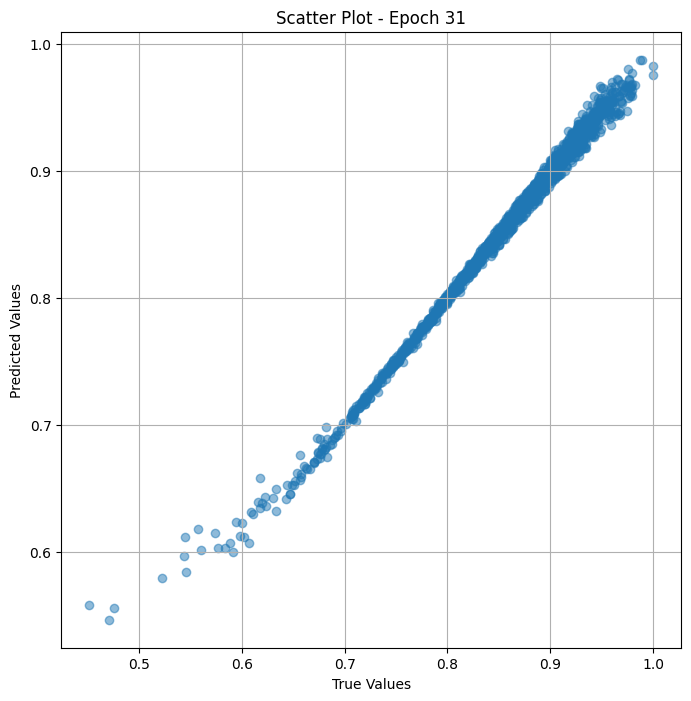

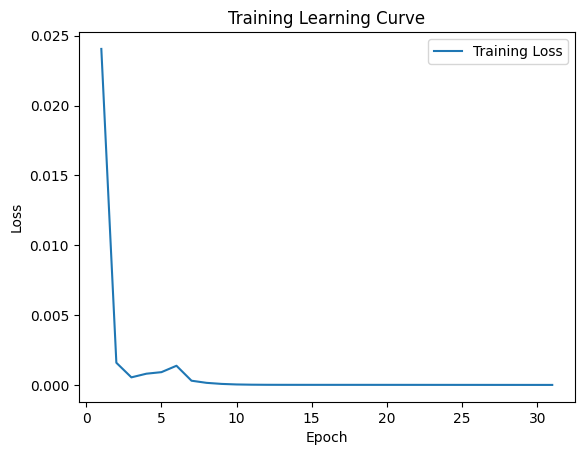


 Epoch: (32/50) Loss = 4.870948032476008e-06

 Epoch: (32/50) Loss_rmse = 0.0022070223931223154

 Epoch: (32/50) R^2 = 0.9976209998130798

 Epoch: (32/50) MAE = 0.0019110292196273804
Spearman correlation coefficient: SignificanceResult(statistic=0.997521150824751, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

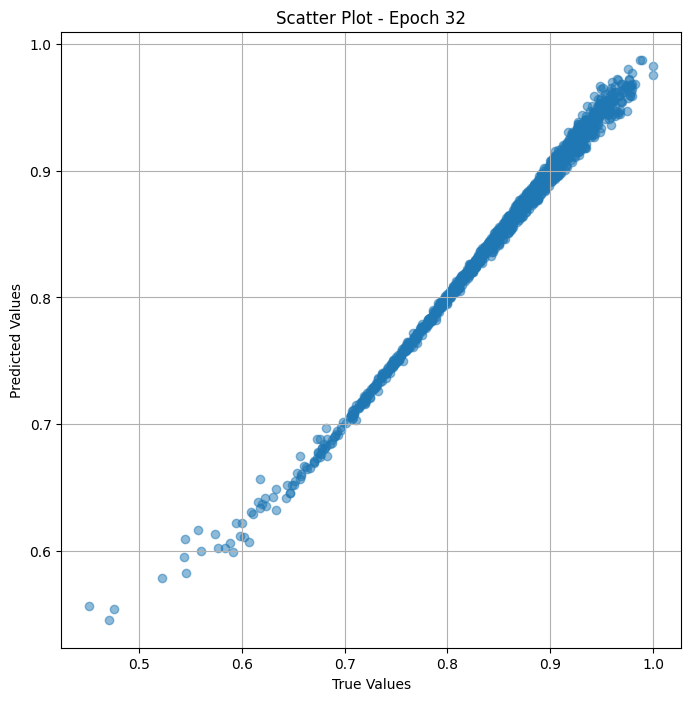

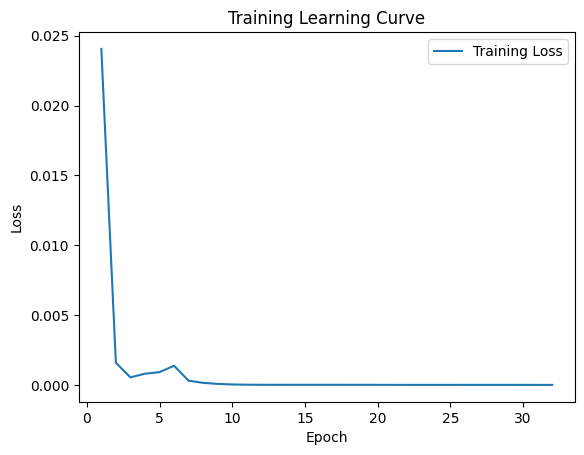


 Epoch: (33/50) Loss = 4.435063601704314e-06

 Epoch: (33/50) Loss_rmse = 0.002105958992615342

 Epoch: (33/50) R^2 = 0.9978339076042175

 Epoch: (33/50) MAE = 0.0018318220973014832
Spearman correlation coefficient: SignificanceResult(statistic=0.9976916805391705, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

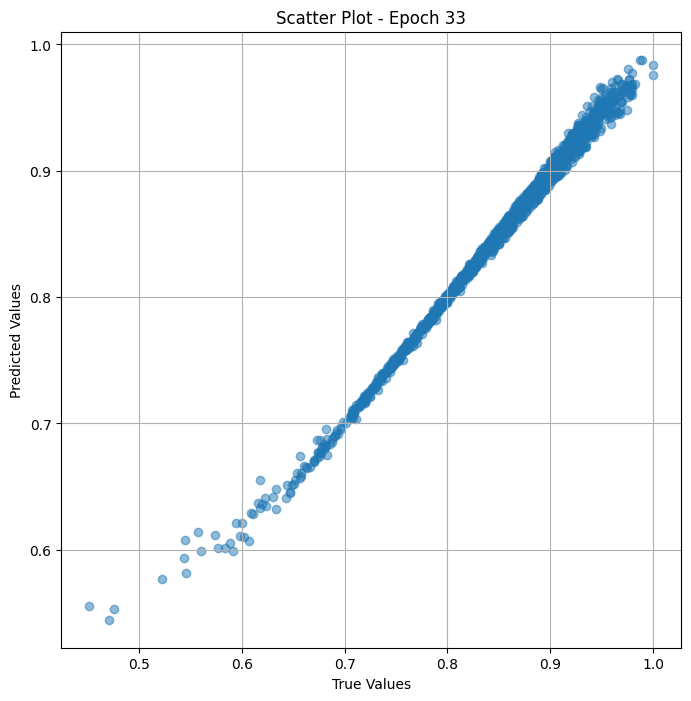

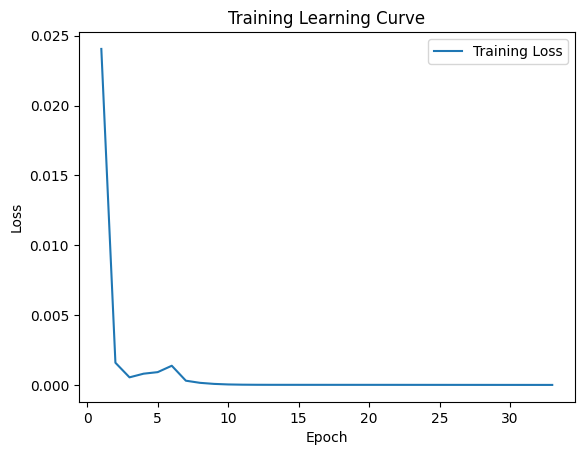


 Epoch: (34/50) Loss = 4.000447916041594e-06

 Epoch: (34/50) Loss_rmse = 0.0020001120865345

 Epoch: (34/50) R^2 = 0.9980461597442627

 Epoch: (34/50) MAE = 0.0017410442233085632
Spearman correlation coefficient: SignificanceResult(statistic=0.9978610930521051, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975,

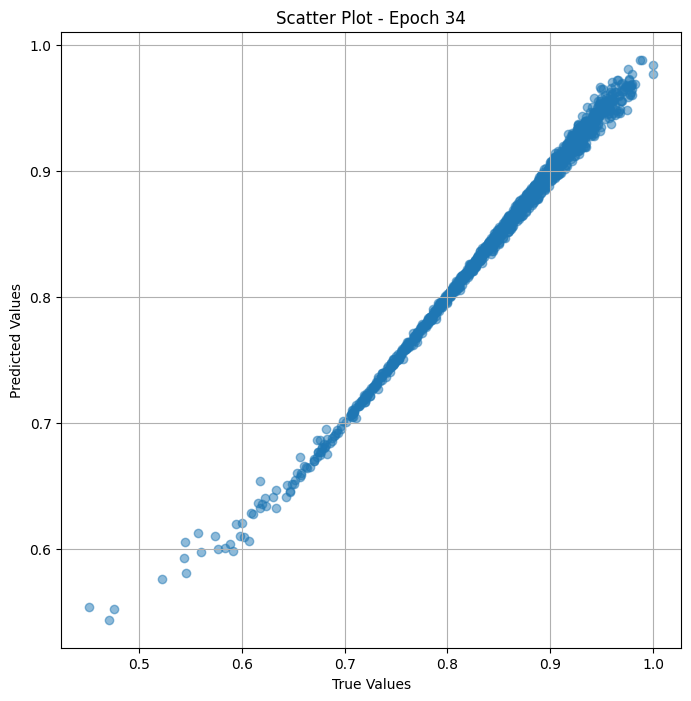

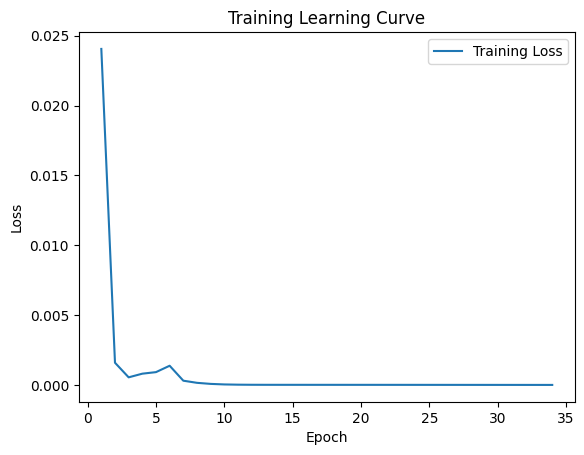


 Epoch: (35/50) Loss = 3.58781448994705e-06

 Epoch: (35/50) Loss_rmse = 0.0018941527232527733

 Epoch: (35/50) R^2 = 0.9982476830482483

 Epoch: (35/50) MAE = 0.0016578882932662964
Spearman correlation coefficient: SignificanceResult(statistic=0.9980248762943922, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

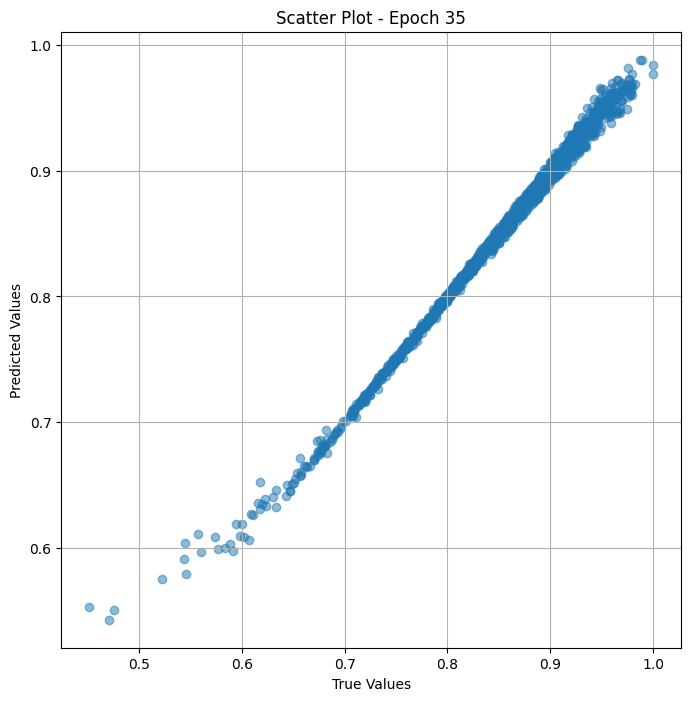

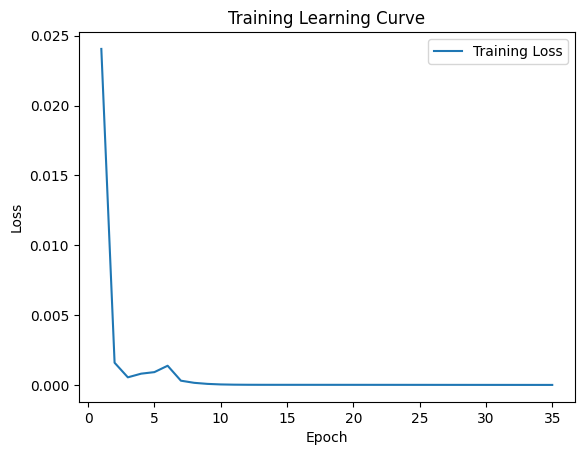


 Epoch: (36/50) Loss = 3.1952536119206343e-06

 Epoch: (36/50) Loss_rmse = 0.0017875272314995527

 Epoch: (36/50) R^2 = 0.9984394311904907

 Epoch: (36/50) MAE = 0.0015633925795555115
Spearman correlation coefficient: SignificanceResult(statistic=0.9981688277974469, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

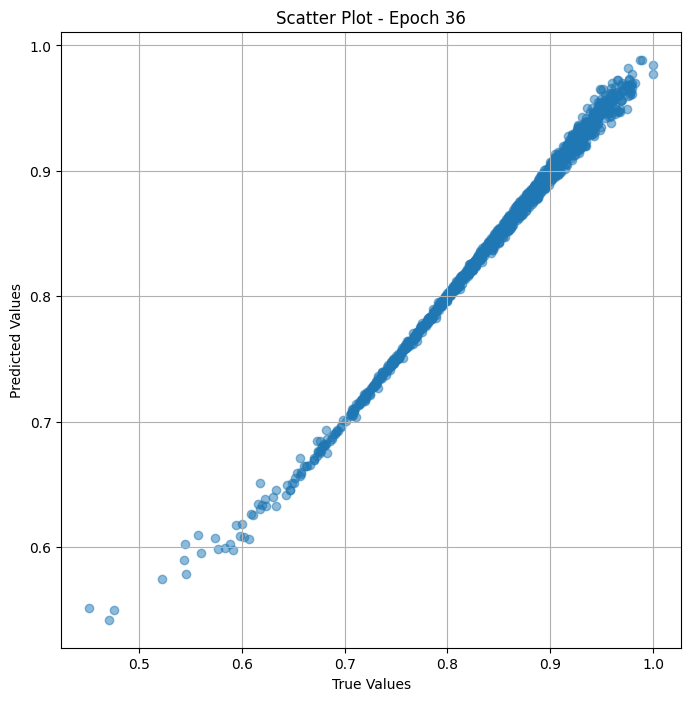

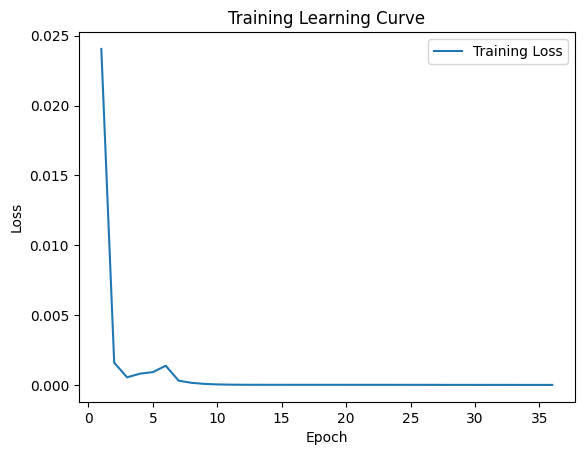


 Epoch: (37/50) Loss = 2.8425874916138127e-06

 Epoch: (37/50) Loss_rmse = 0.0016859974712133408

 Epoch: (37/50) R^2 = 0.9986116886138916

 Epoch: (37/50) MAE = 0.001486554741859436
Spearman correlation coefficient: SignificanceResult(statistic=0.9983019868198056, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

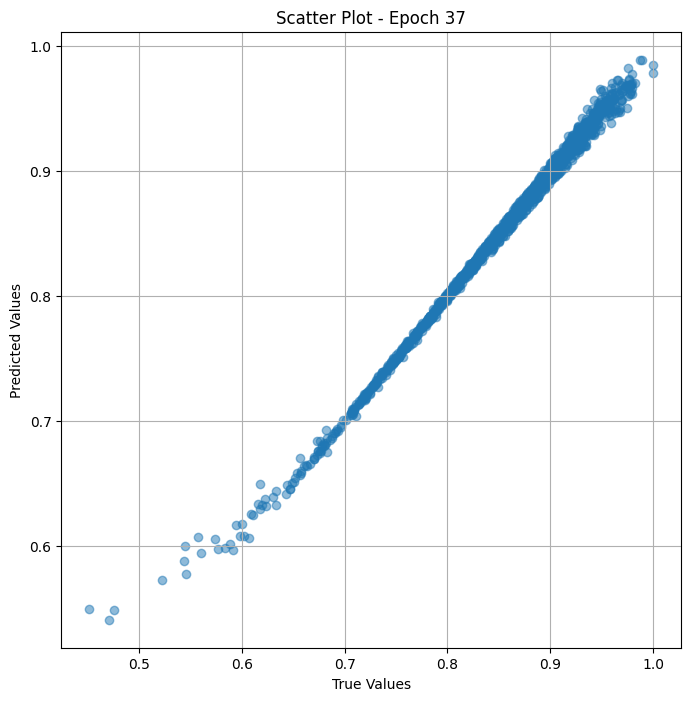

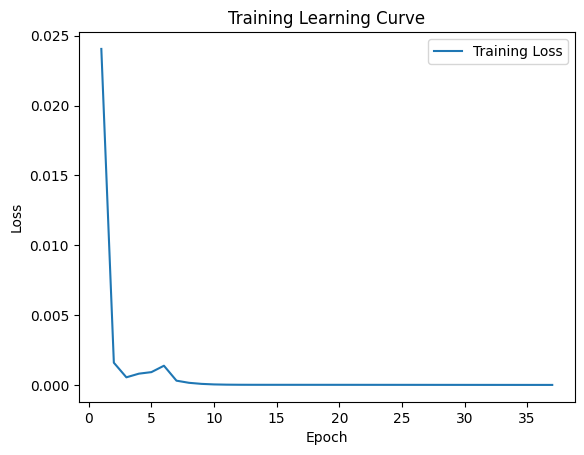


 Epoch: (38/50) Loss = 2.489881808287464e-06

 Epoch: (38/50) Loss_rmse = 0.0015779358800500631

 Epoch: (38/50) R^2 = 0.9987839460372925

 Epoch: (38/50) MAE = 0.0013895854353904724
Spearman correlation coefficient: SignificanceResult(statistic=0.9984351750381619, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

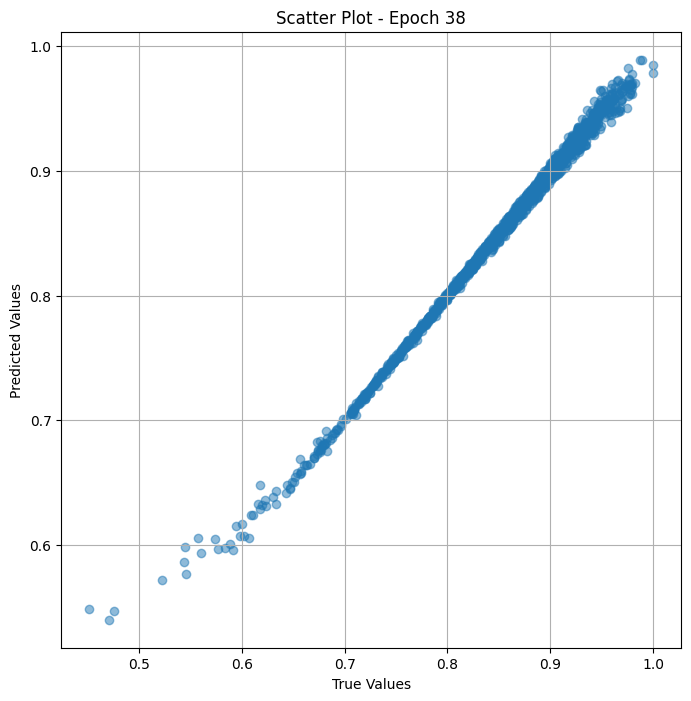

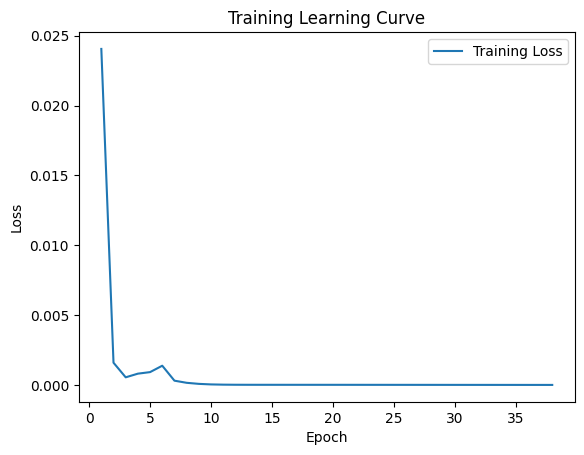


 Epoch: (39/50) Loss = 2.1678238226741087e-06

 Epoch: (39/50) Loss_rmse = 0.0014723531203344464

 Epoch: (39/50) R^2 = 0.9989412426948547

 Epoch: (39/50) MAE = 0.0013047382235527039
Spearman correlation coefficient: SignificanceResult(statistic=0.998560529819919, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

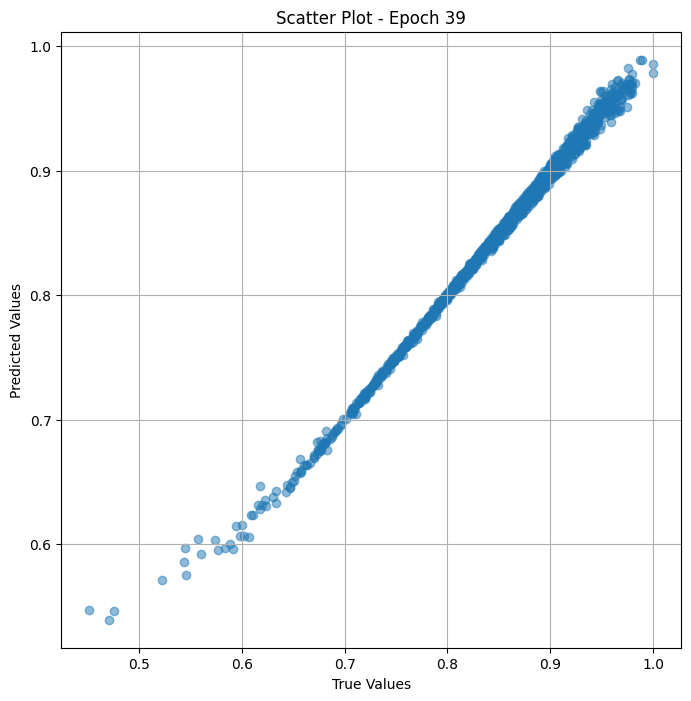

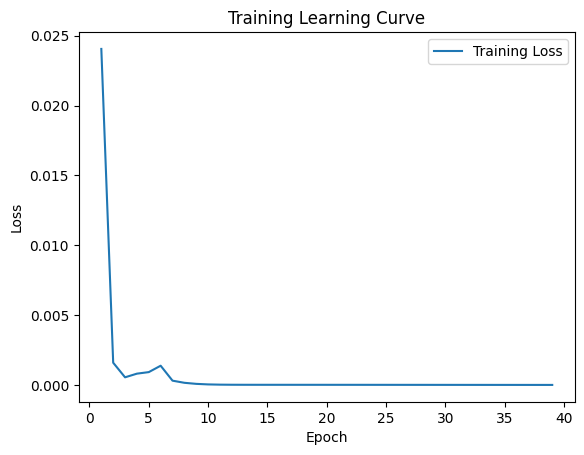


 Epoch: (40/50) Loss = 1.8770726910588564e-06

 Epoch: (40/50) Loss_rmse = 0.0013700630515813828

 Epoch: (40/50) R^2 = 0.9990832209587097

 Epoch: (40/50) MAE = 0.0012135058641433716
Spearman correlation coefficient: SignificanceResult(statistic=0.9986709965897302, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

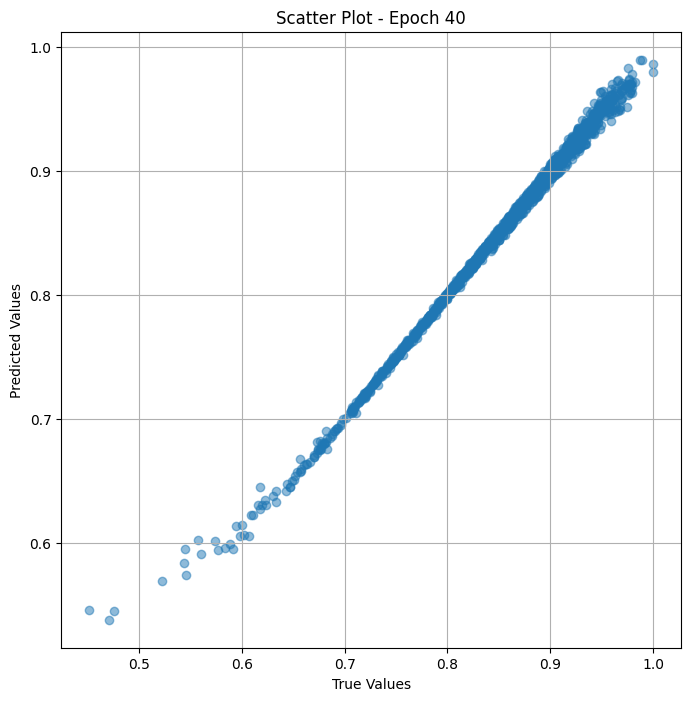

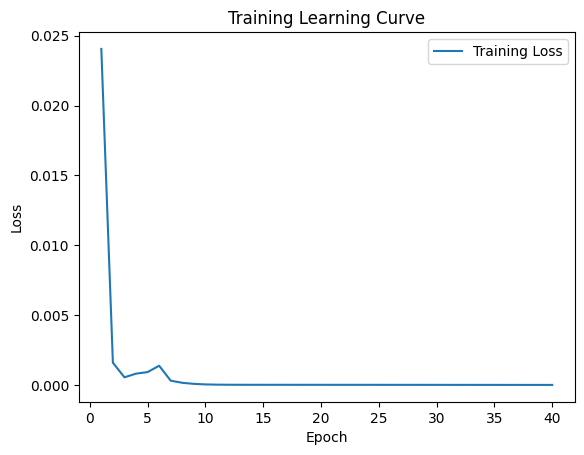


 Epoch: (41/50) Loss = 1.6132680684677325e-06

 Epoch: (41/50) Loss_rmse = 0.0012701449450105429

 Epoch: (41/50) R^2 = 0.9992120862007141

 Epoch: (41/50) MAE = 0.0011238008737564087
Spearman correlation coefficient: SignificanceResult(statistic=0.9987802017521469, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

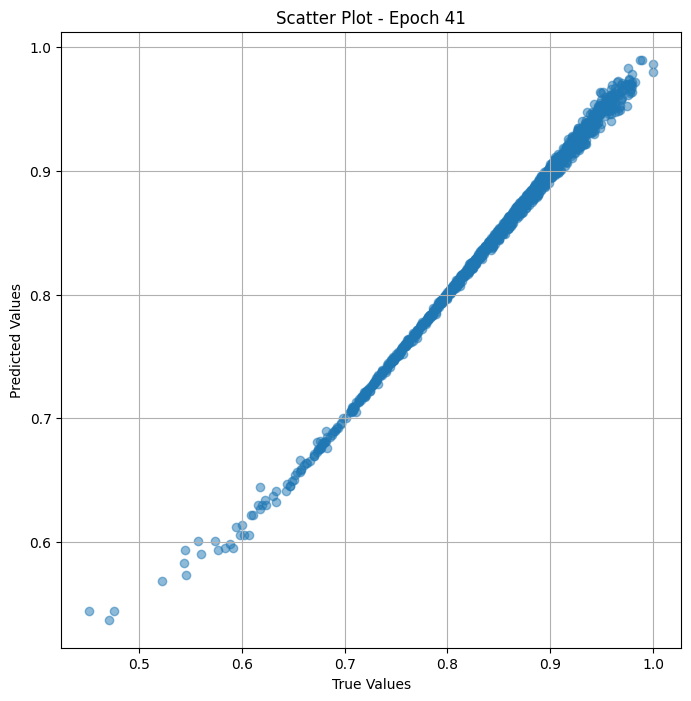

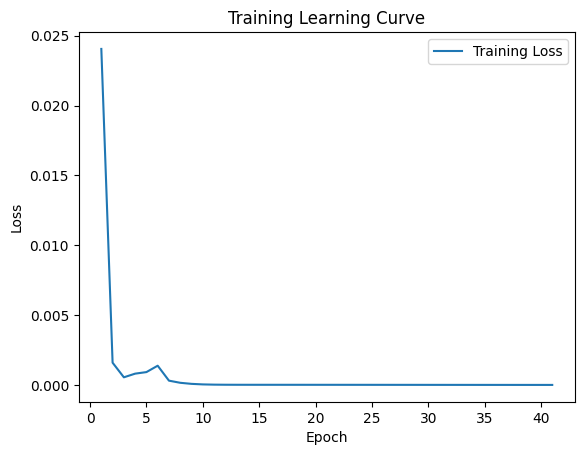


 Epoch: (42/50) Loss = 1.3840506198903313e-06

 Epoch: (42/50) Loss_rmse = 0.0011764568043872714

 Epoch: (42/50) R^2 = 0.9993240237236023

 Epoch: (42/50) MAE = 0.0010455548763275146
Spearman correlation coefficient: SignificanceResult(statistic=0.9988733156861066, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

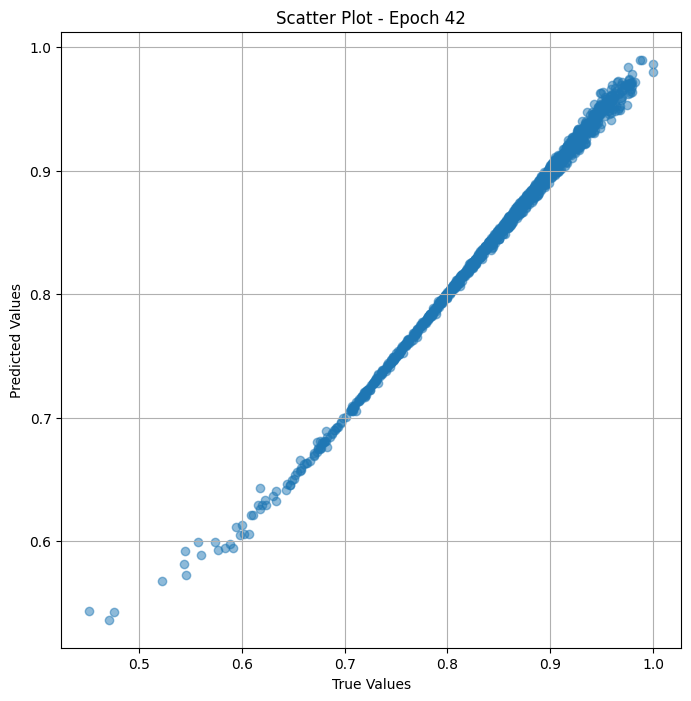

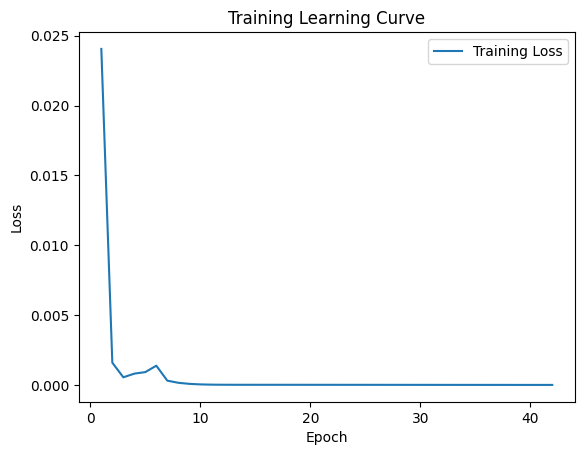


 Epoch: (43/50) Loss = 1.1791107681347057e-06

 Epoch: (43/50) Loss_rmse = 0.0010858686873689294

 Epoch: (43/50) R^2 = 0.9994240999221802

 Epoch: (43/50) MAE = 0.0009593069553375244
Spearman correlation coefficient: SignificanceResult(statistic=0.9989651779159241, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

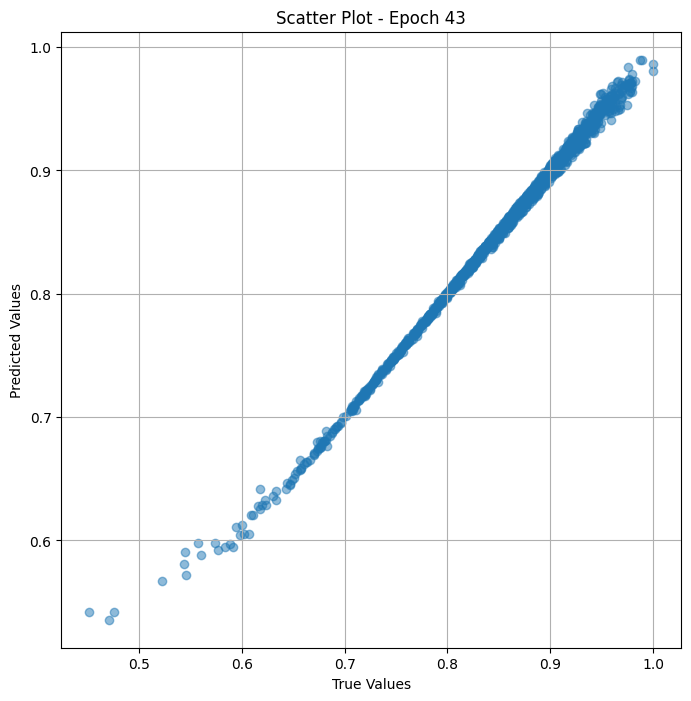

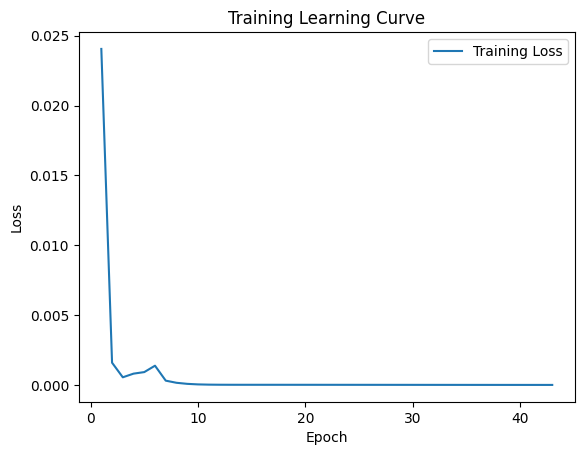


 Epoch: (44/50) Loss = 1.0030613566414104e-06

 Epoch: (44/50) Loss_rmse = 0.0010015295119956136

 Epoch: (44/50) R^2 = 0.9995101094245911

 Epoch: (44/50) MAE = 0.0008938461542129517
Spearman correlation coefficient: SignificanceResult(statistic=0.9990450423636832, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

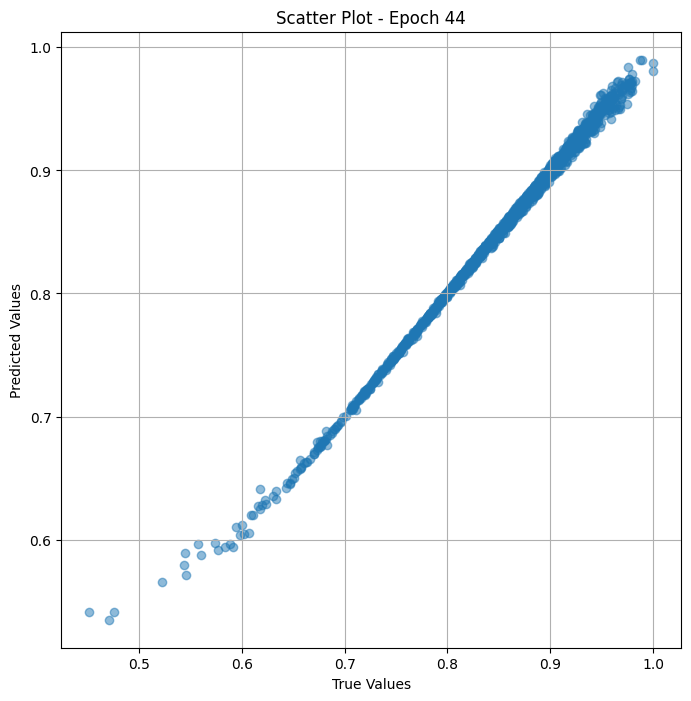

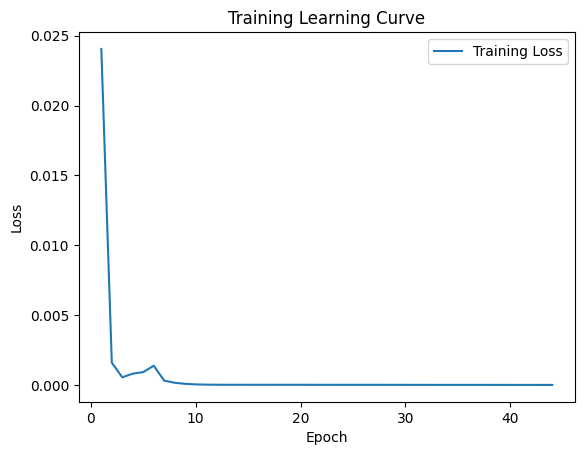


 Epoch: (45/50) Loss = 8.472604804410366e-07

 Epoch: (45/50) Loss_rmse = 0.0009204675443470478

 Epoch: (45/50) R^2 = 0.9995861649513245

 Epoch: (45/50) MAE = 0.0008147582411766052
Spearman correlation coefficient: SignificanceResult(statistic=0.9991259781346322, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

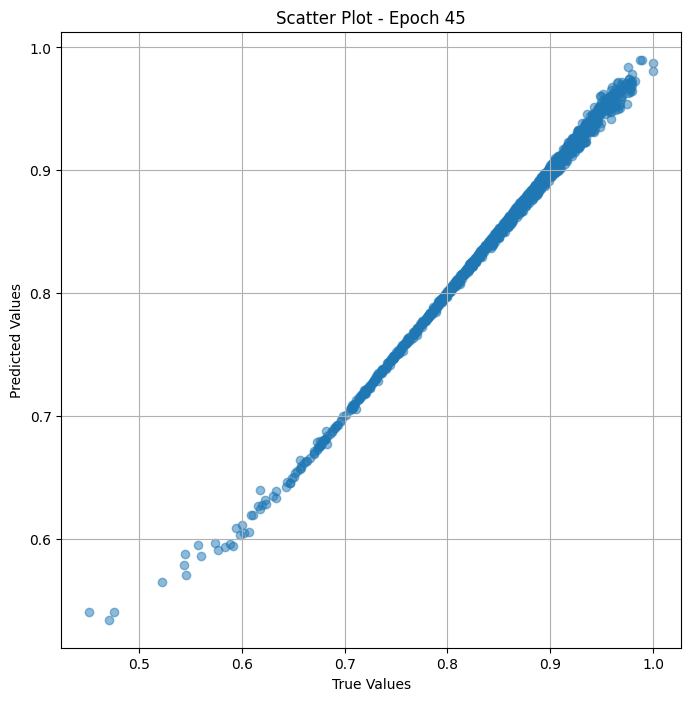

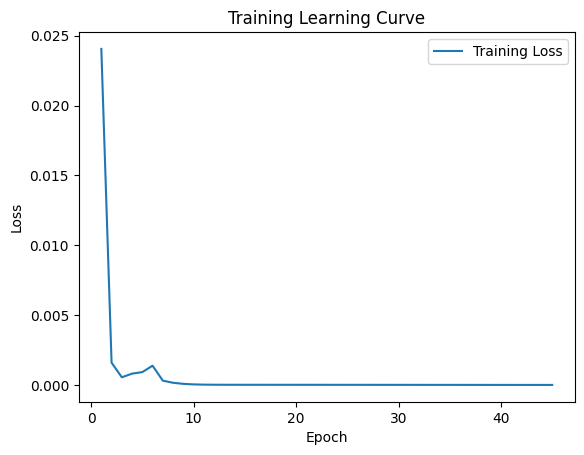


 Epoch: (46/50) Loss = 7.185606136772549e-07

 Epoch: (46/50) Loss_rmse = 0.0008476795628666878

 Epoch: (46/50) R^2 = 0.9996490478515625

 Epoch: (46/50) MAE = 0.0007545426487922668
Spearman correlation coefficient: SignificanceResult(statistic=0.9991988698539817, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

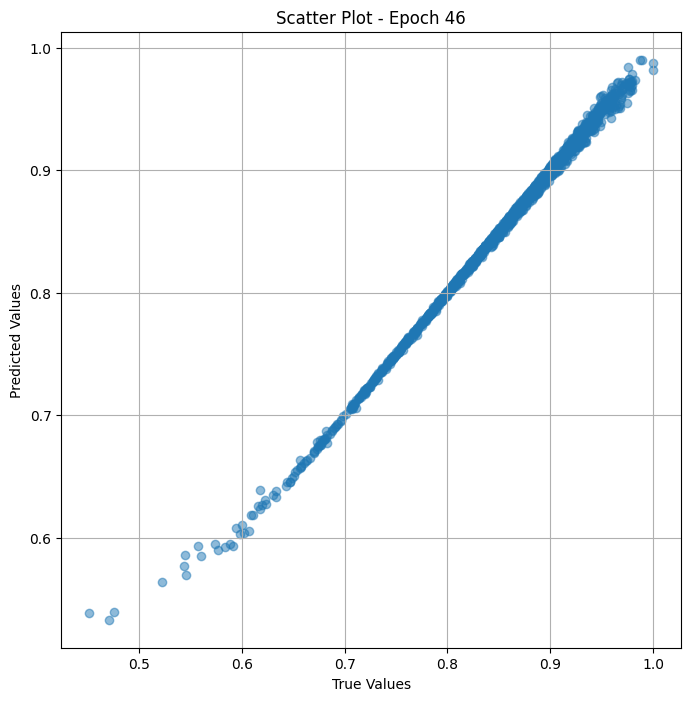

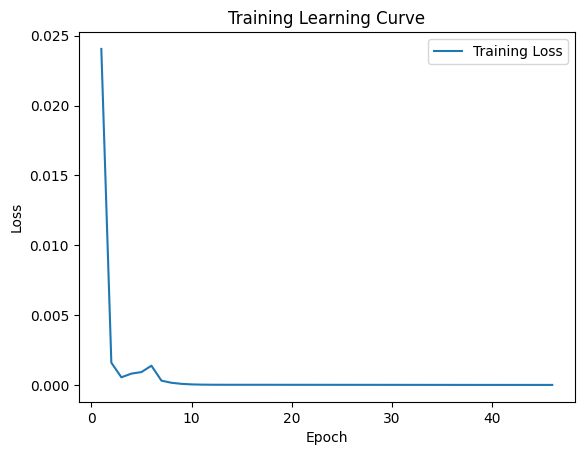


 Epoch: (47/50) Loss = 6.039713298378047e-07

 Epoch: (47/50) Loss_rmse = 0.0007771559176035225

 Epoch: (47/50) R^2 = 0.9997050166130066

 Epoch: (47/50) MAE = 0.0006865784525871277
Spearman correlation coefficient: SignificanceResult(statistic=0.9992623641622077, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

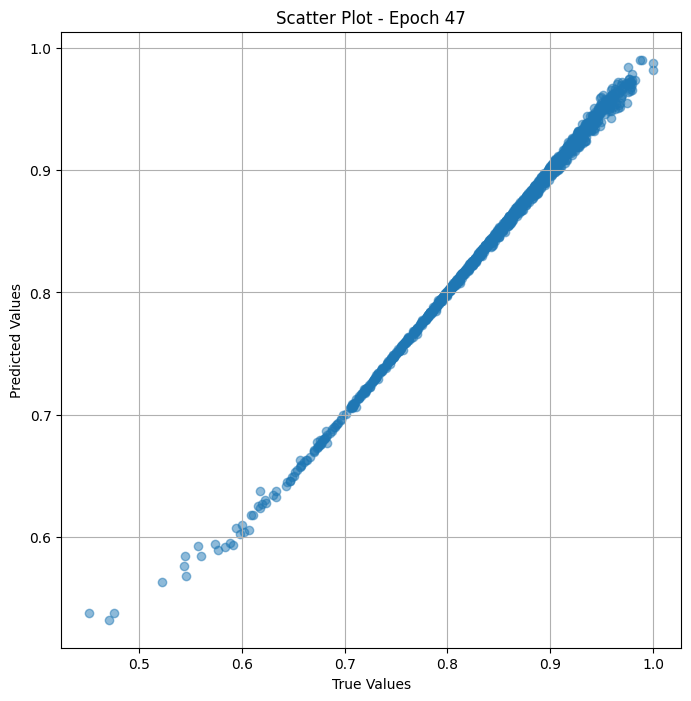

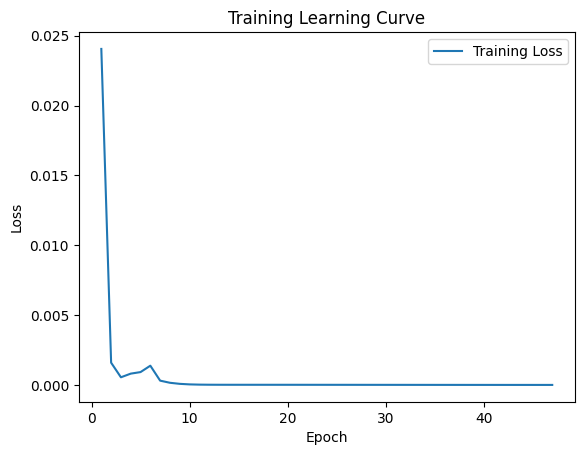


 Epoch: (48/50) Loss = 5.176786430638458e-07

 Epoch: (48/50) Loss_rmse = 0.0007194989011622965

 Epoch: (48/50) R^2 = 0.9997471570968628

 Epoch: (48/50) MAE = 0.0006439834833145142
Spearman correlation coefficient: SignificanceResult(statistic=0.9993253986606432, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

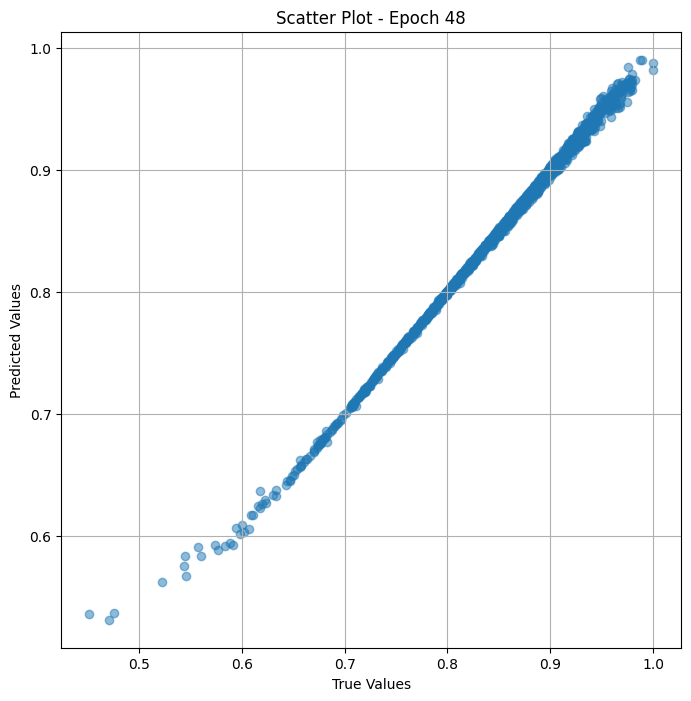

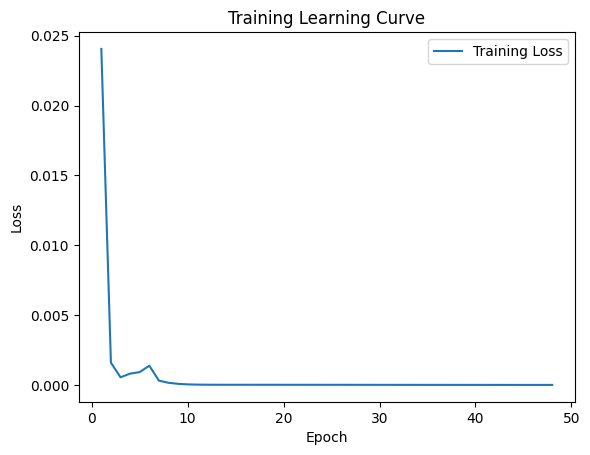


 Epoch: (49/50) Loss = 4.4654589714809845e-07

 Epoch: (49/50) Loss_rmse = 0.0006682408857159317

 Epoch: (49/50) R^2 = 0.9997819066047668

 Epoch: (49/50) MAE = 0.0005702301859855652
Spearman correlation coefficient: SignificanceResult(statistic=0.9993821850743423, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

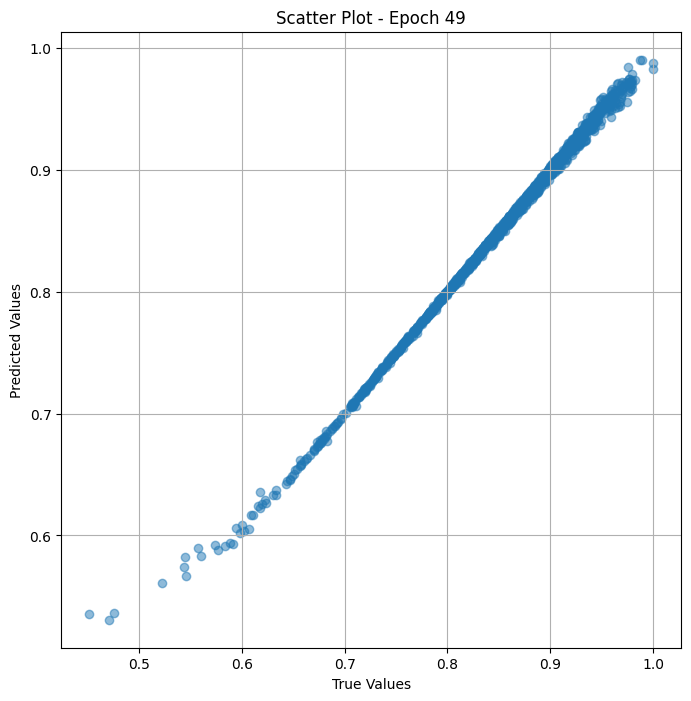

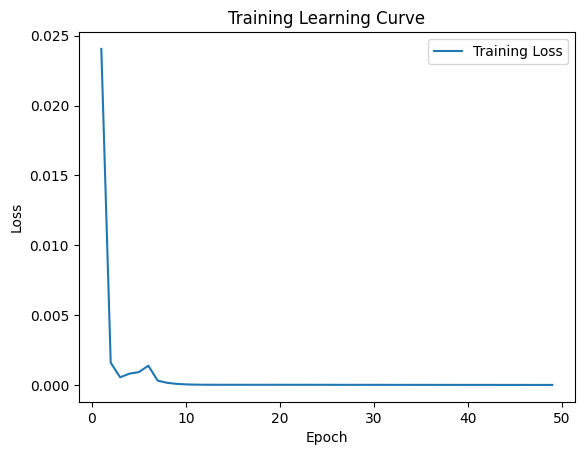


 Epoch: (50/50) Loss = 4.403123057272751e-07

 Epoch: (50/50) Loss_rmse = 0.0006635603494942188

 Epoch: (50/50) R^2 = 0.9997849464416504

 Epoch: (50/50) MAE = 0.0005524605512619019
Spearman correlation coefficient: SignificanceResult(statistic=0.9994391539519372, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

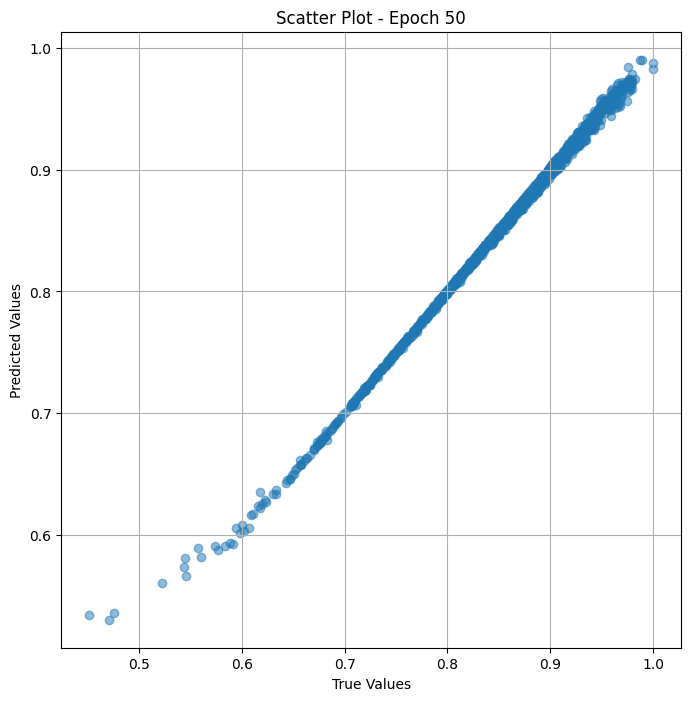

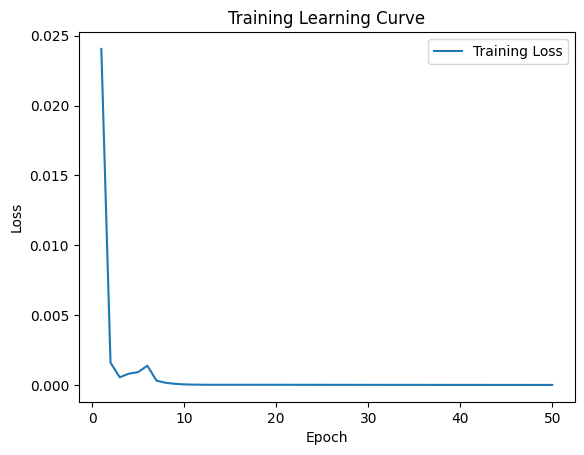

In [ ]:
# Training the model and save weights
fit(50, model_res , train_dl)
torch.save(model_res.state_dict(), "model_weights_1")

In [ ]:
true_values_list = []
predicted_values_list = []

for x_trans, yb in train_dl:
    preds = model_res(x_trans)
    true_values_list.extend(yb.cpu().detach().numpy())
    predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_train_food['preprocessed_image_path'],
    'True Value': true_values_list,  # Replace with your actual true values
    'Predicted Value': predicted_values_list  # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)



                                          Image Path  True Value  \
0     /content/food/n07849336_21675_preprocessed.jpg    0.807339   
1      /content/food/n07880968_3281_preprocessed.jpg    0.745614   
2      /content/food/n07753592_1991_preprocessed.jpg    0.858586   
3      /content/food/n07850329_9287_preprocessed.jpg    0.747253   
4        /content/food/000000446303_preprocessed.jpg    0.813187   
...                                              ...         ...   
1795   /content/food/n07880968_6446_preprocessed.jpg    0.958333   
1796     /content/food/000000036166_preprocessed.jpg    0.851485   
1797    /content/food/n07693725_500_preprocessed.jpg    0.853933   
1798     /content/food/000000572430_preprocessed.jpg    0.885417   
1799   /content/food/n07880968_4615_preprocessed.jpg    0.865854   

      Predicted Value  
0            0.806813  
1            0.744909  
2            0.858095  
3            0.746465  
4            0.813253  
...               ...  
1795         0.

In [ ]:
from prettytable import PrettyTable

# Assuming 'df_result' is your DataFrame
# The 'Image Path' column should contain the paths to your images

# Create a PrettyTable instance
table = PrettyTable()

# Add column names
table.field_names = df_result.columns.tolist()

# Add rows
for _, row in df_result.iterrows():
    table.add_row(row.tolist())

# Display the table
print(table)

+------------------------------------------------+------------+--------------------+
|                   Image Path                   | True Value |  Predicted Value   |
+------------------------------------------------+------------+--------------------+
| /content/food/n07849336_21675_preprocessed.jpg | 0.80733943 | 0.8068132996559143 |
| /content/food/n07880968_3281_preprocessed.jpg  | 0.74561405 | 0.7449090480804443 |
| /content/food/n07753592_1991_preprocessed.jpg  | 0.85858583 | 0.8580951690673828 |
| /content/food/n07850329_9287_preprocessed.jpg  | 0.74725276 | 0.7464650273323059 |
|  /content/food/000000446303_preprocessed.jpg   | 0.8131868  | 0.8132529258728027 |
| /content/food/n07911677_12001_preprocessed.jpg | 0.8378378  | 0.837318480014801  |
| /content/food/n07933274_34426_preprocessed.jpg |    1.0     | 0.9832469820976257 |
| /content/food/n07690273_27508_preprocessed.jpg | 0.8913044  | 0.8903250694274902 |
|  /content/food/000000306047_preprocessed.jpg   | 0.9550562  | 0

## Valid

In [ ]:
class Dataset_val_resnet_food(Dataset):
    def __init__(self, df,res_transform=None):
        self.labels = df_val_food["memoscore"]
        self.images = df_val_food["preprocessed_image_path"]
        self.res_transform = res_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
val_ds =Dataset_val_resnet_food(df_val_food,res_transform=res_transform)
val_dl = DataLoader(val_ds, batch_size=32, shuffle=False)

In [ ]:
class ResNet_model_val_food(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)


    def forward(self, x):
        resfeat = self.res(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

ResNet = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_val =  ResNet_model_val_food( arch="resnet50.a1_in1k")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = ResNet_model_val_food().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
device = get_default_device()
val_dl = DeviceDataLoader(val_dl, device)
model_res_val  = to_device(model_res_val  , device)

In [ ]:
params = [param for param in list(model_res_val.parameters()) if param.requires_grad]
optimizer = torch.optim.Adam(params, lr=1e-4)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_val, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_val(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.12899306416511536

 Epoch: (1/50) Loss_rmse = 0.3591560423374176

 Epoch: (1/50) R^2 = -52.59389877319336

 Epoch: (1/50) MAE = 0.35573065280914307
Spearman correlation coefficient: SignificanceResult(statistic=-0.07525452247804483, pvalue=0.46617530761860404)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899, 0

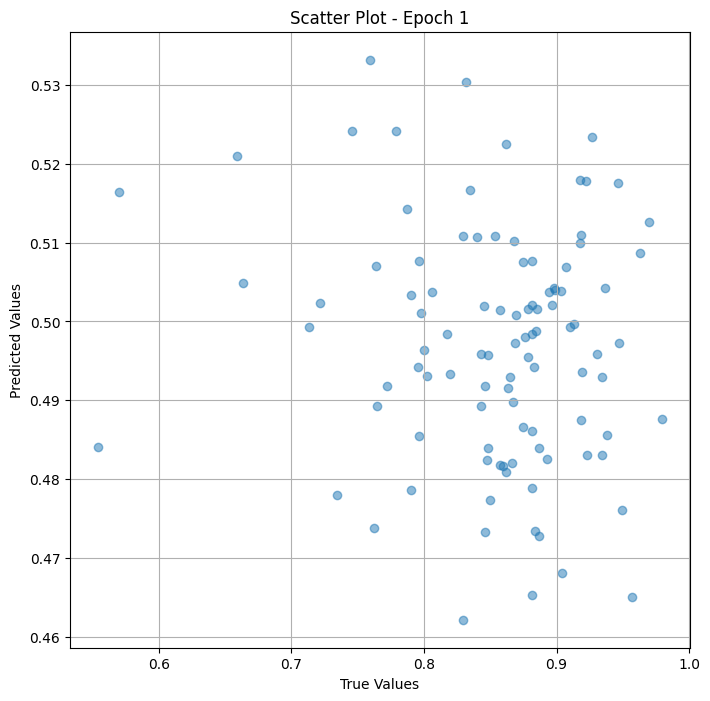

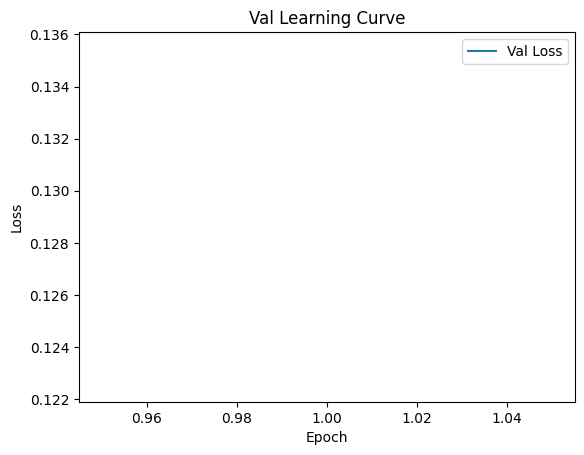


 Epoch: (2/50) Loss = 0.09878409653902054

 Epoch: (2/50) Loss_rmse = 0.3142993748188019

 Epoch: (2/50) R^2 = -40.04270935058594

 Epoch: (2/50) MAE = 0.311617910861969
Spearman correlation coefficient: SignificanceResult(statistic=0.06341863768992512, pvalue=0.5393131858243068)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899, 0.926

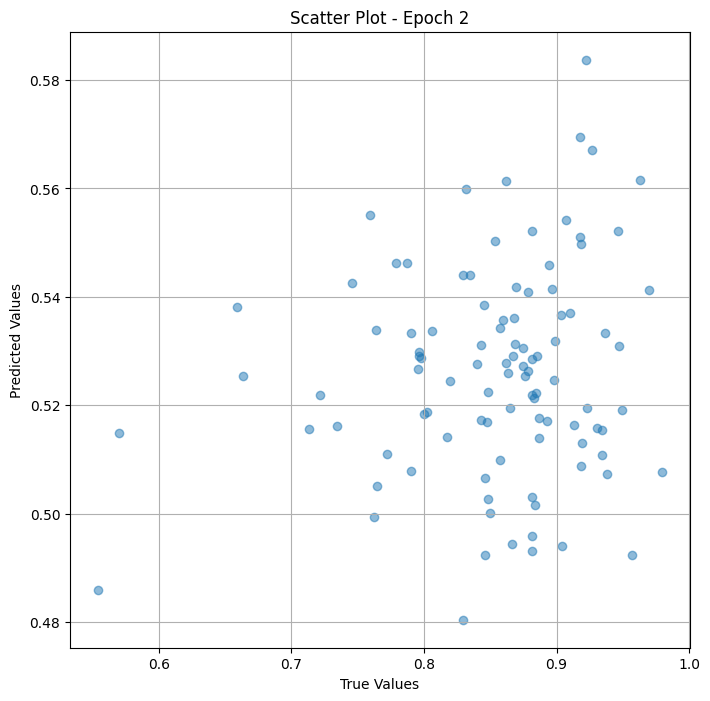

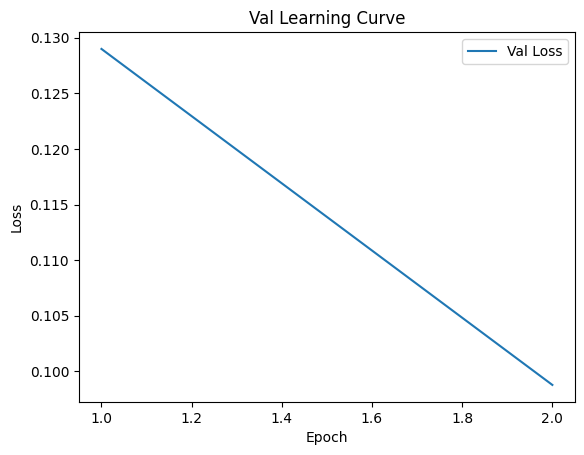


 Epoch: (3/50) Loss = 0.07588526606559753

 Epoch: (3/50) Loss_rmse = 0.2754727900028229

 Epoch: (3/50) R^2 = -30.528728485107422

 Epoch: (3/50) MAE = 0.27255719900131226
Spearman correlation coefficient: SignificanceResult(statistic=0.12364260389835777, pvalue=0.2300666003666256)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899, 0.

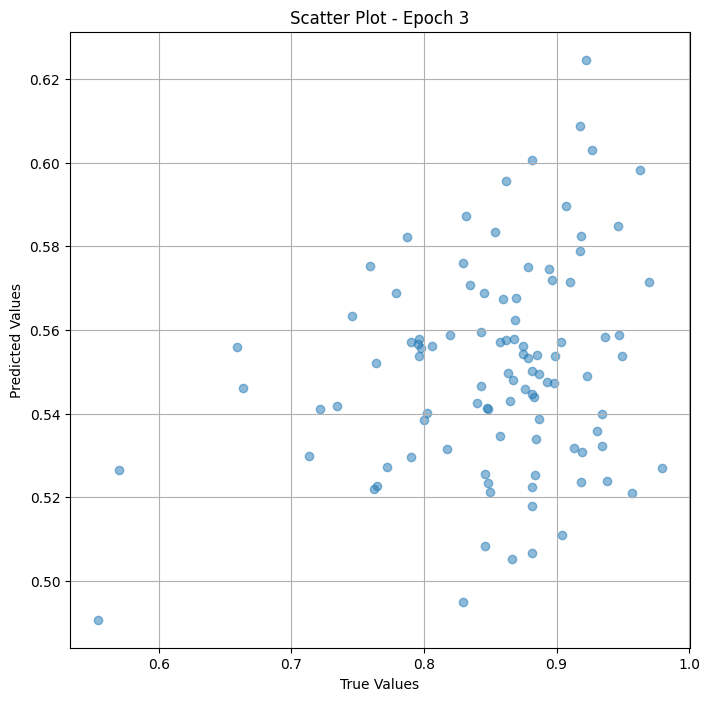

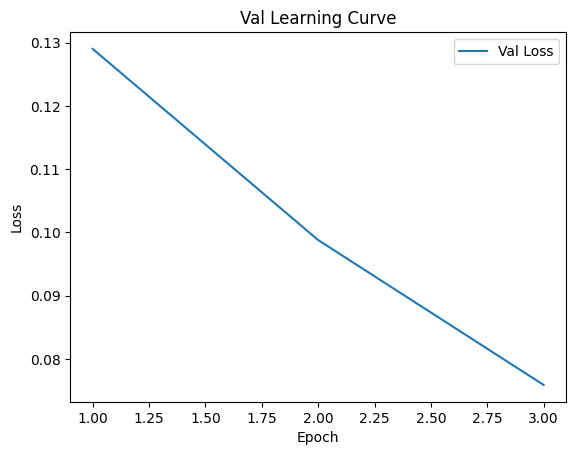


 Epoch: (4/50) Loss = 0.057260483503341675

 Epoch: (4/50) Loss_rmse = 0.23929162323474884

 Epoch: (4/50) R^2 = -22.790523529052734

 Epoch: (4/50) MAE = 0.2364315688610077
Spearman correlation coefficient: SignificanceResult(statistic=0.20104725559006106, pvalue=0.04951233187260461)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899, 

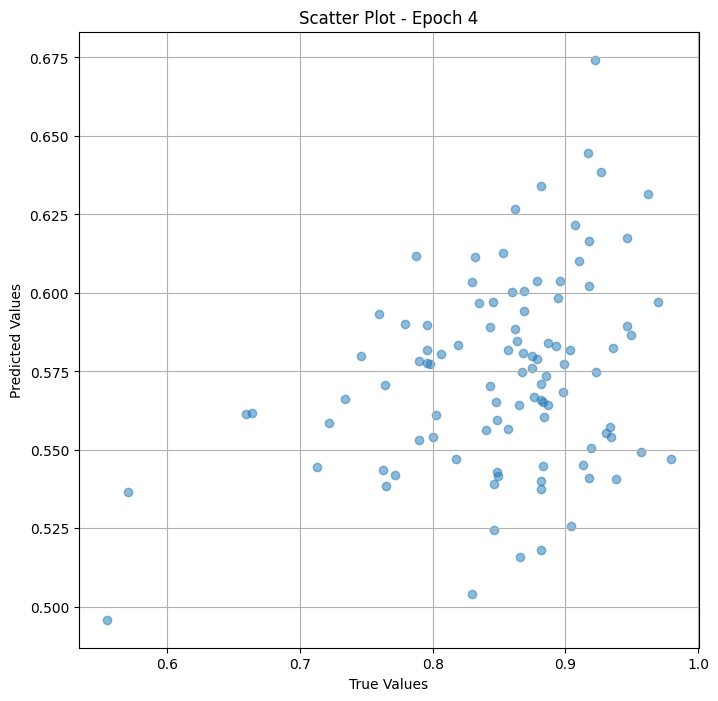

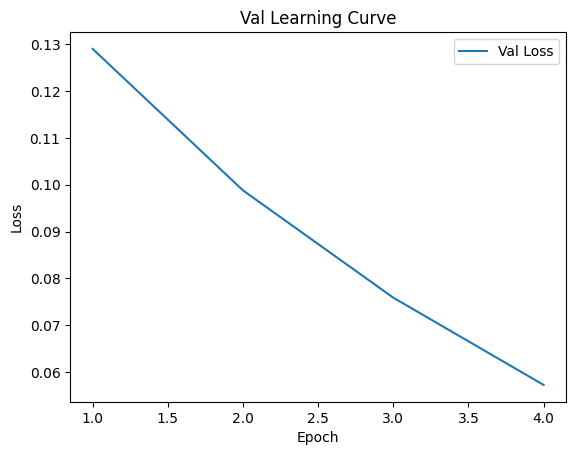


 Epoch: (5/50) Loss = 0.042131513357162476

 Epoch: (5/50) Loss_rmse = 0.20525962114334106

 Epoch: (5/50) R^2 = -16.504756927490234

 Epoch: (5/50) MAE = 0.20291770994663239
Spearman correlation coefficient: SignificanceResult(statistic=0.26498816441390316, pvalue=0.009076708302763322)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899

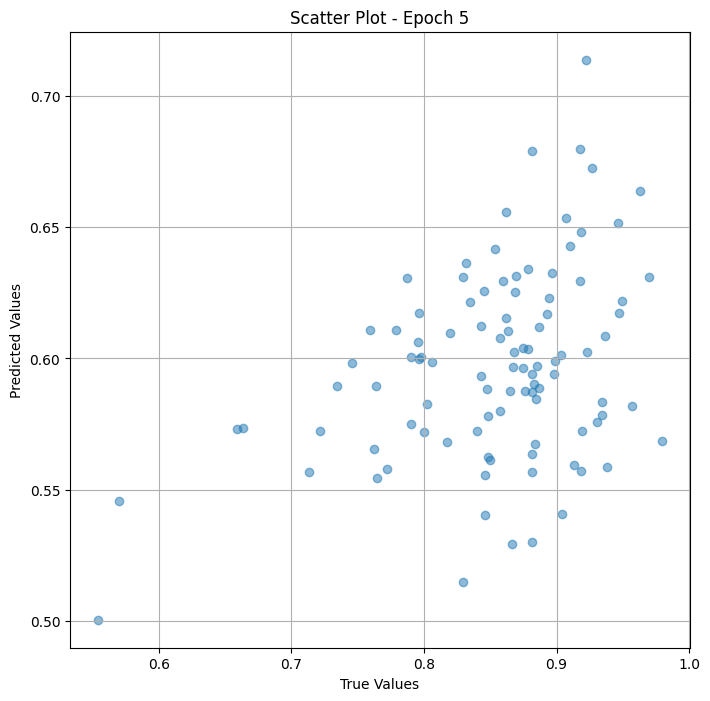

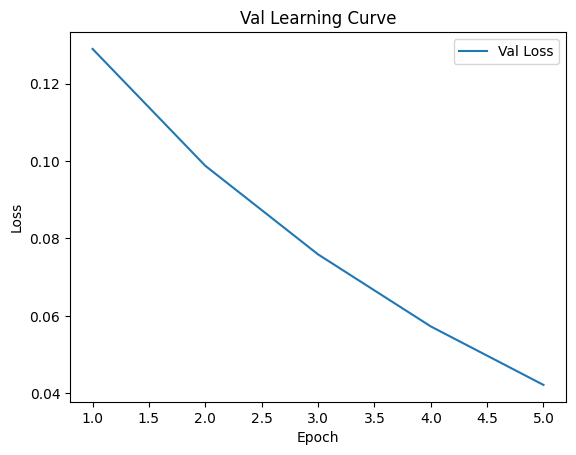


 Epoch: (6/50) Loss = 0.0308089442551136

 Epoch: (6/50) Loss_rmse = 0.1755247712135315

 Epoch: (6/50) R^2 = -11.800467491149902

 Epoch: (6/50) MAE = 0.17333970963954926
Spearman correlation coefficient: SignificanceResult(statistic=0.330882502933435, pvalue=0.0009920459719072073)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899, 0.

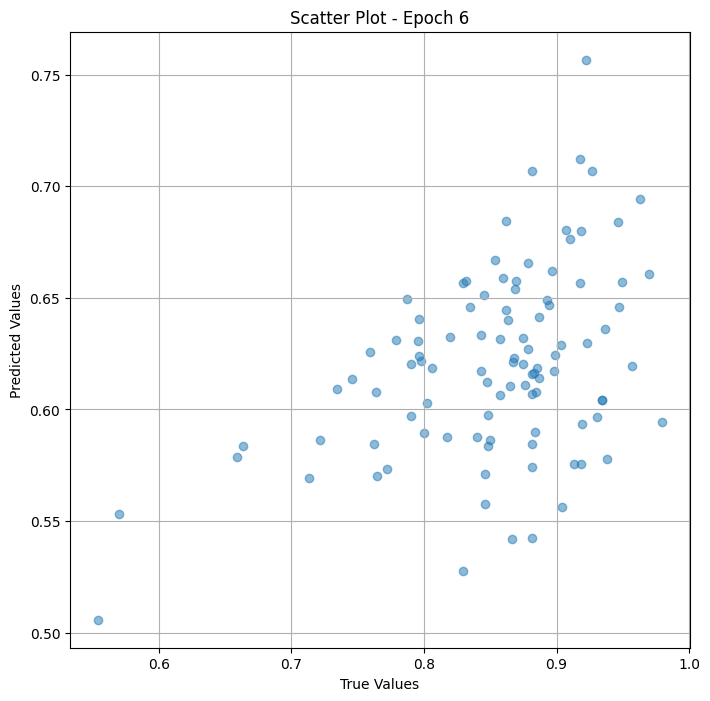

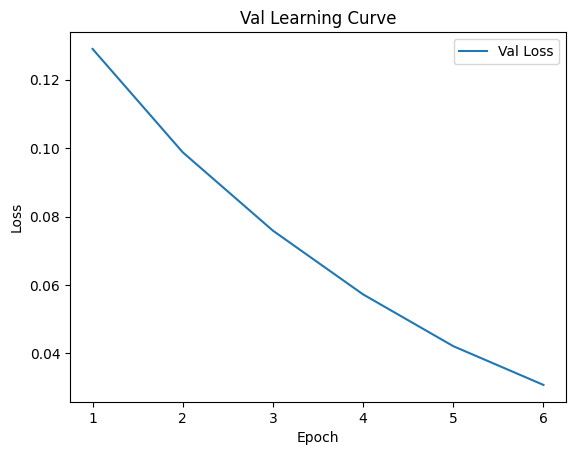


 Epoch: (7/50) Loss = 0.021279867738485336

 Epoch: (7/50) Loss_rmse = 0.1458762139081955

 Epoch: (7/50) R^2 = -7.841336250305176

 Epoch: (7/50) MAE = 0.14343412220478058
Spearman correlation coefficient: SignificanceResult(statistic=0.4086127262410865, pvalue=3.579799631437231e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899, 

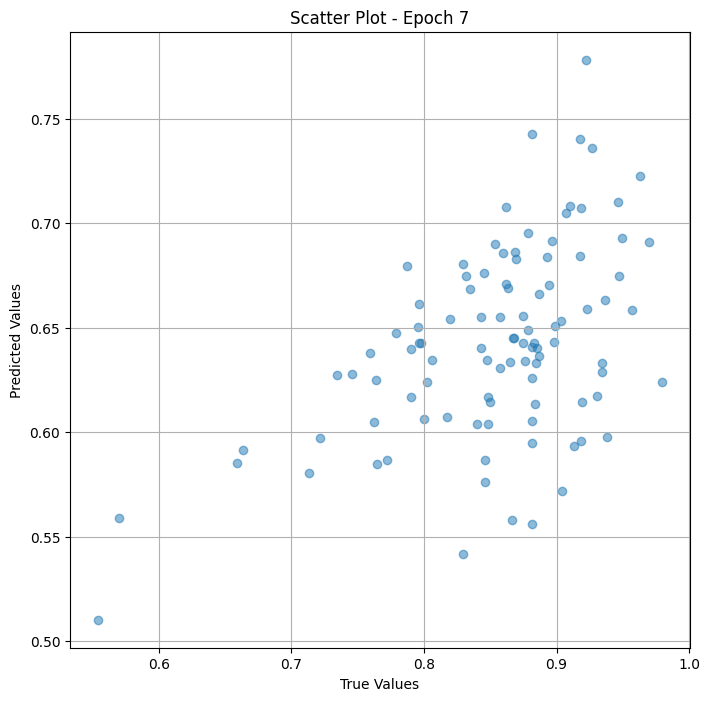

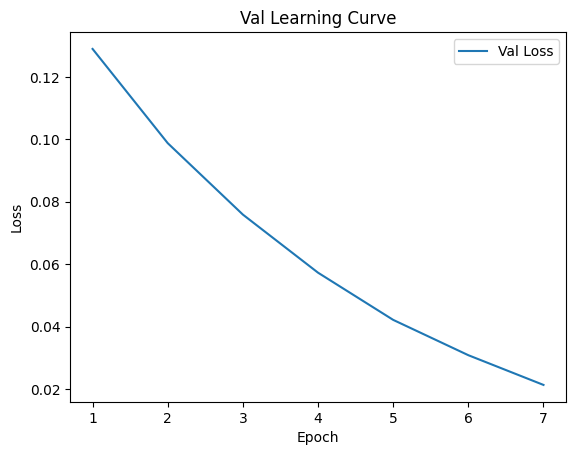


 Epoch: (8/50) Loss = 0.014499859884381294

 Epoch: (8/50) Loss_rmse = 0.12041536718606949

 Epoch: (8/50) R^2 = -5.024386405944824

 Epoch: (8/50) MAE = 0.11829273402690887
Spearman correlation coefficient: SignificanceResult(statistic=0.47302164426285437, pvalue=1.134819221632458e-06)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899

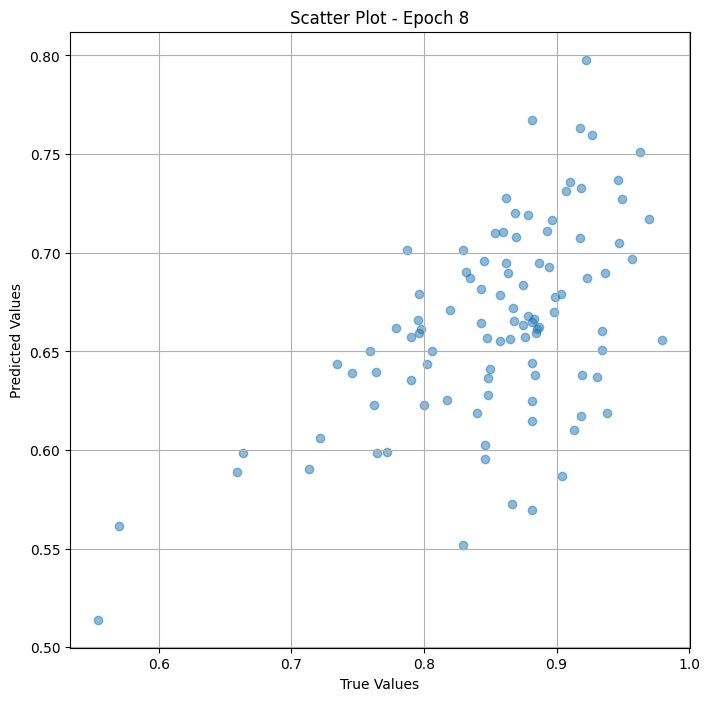

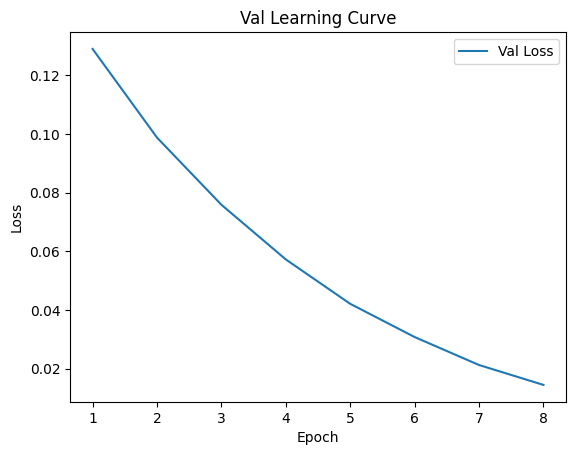


 Epoch: (9/50) Loss = 0.009586302563548088

 Epoch: (9/50) Loss_rmse = 0.09790966659784317

 Epoch: (9/50) R^2 = -2.9829068183898926

 Epoch: (9/50) MAE = 0.09629994630813599
Spearman correlation coefficient: SignificanceResult(statistic=0.555994927135673, pvalue=4.084851568449175e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989899,

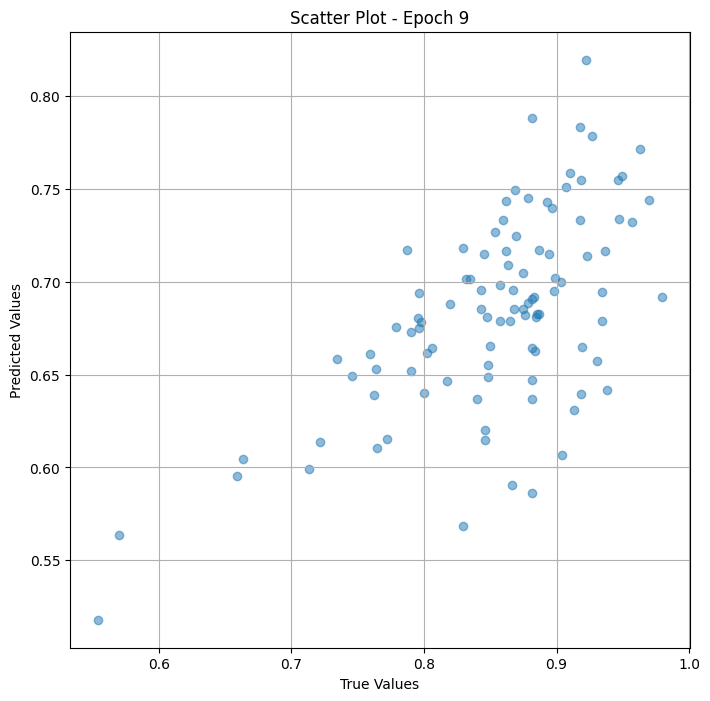

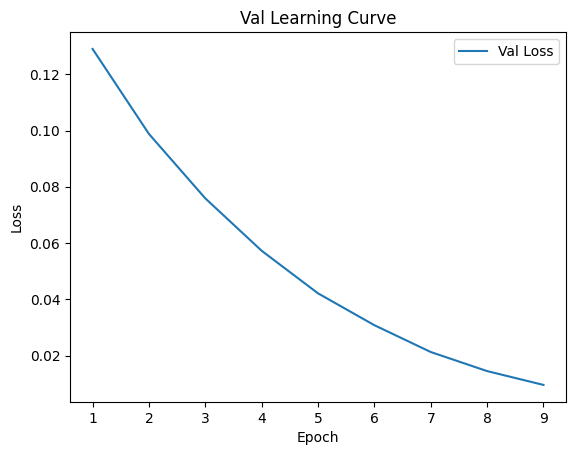


 Epoch: (10/50) Loss = 0.006134300492703915

 Epoch: (10/50) Loss_rmse = 0.07832177728414536

 Epoch: (10/50) R^2 = -1.5486726760864258

 Epoch: (10/50) MAE = 0.0771593451499939
Spearman correlation coefficient: SignificanceResult(statistic=0.619942618701514, pvalue=1.6379111812484812e-11)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989

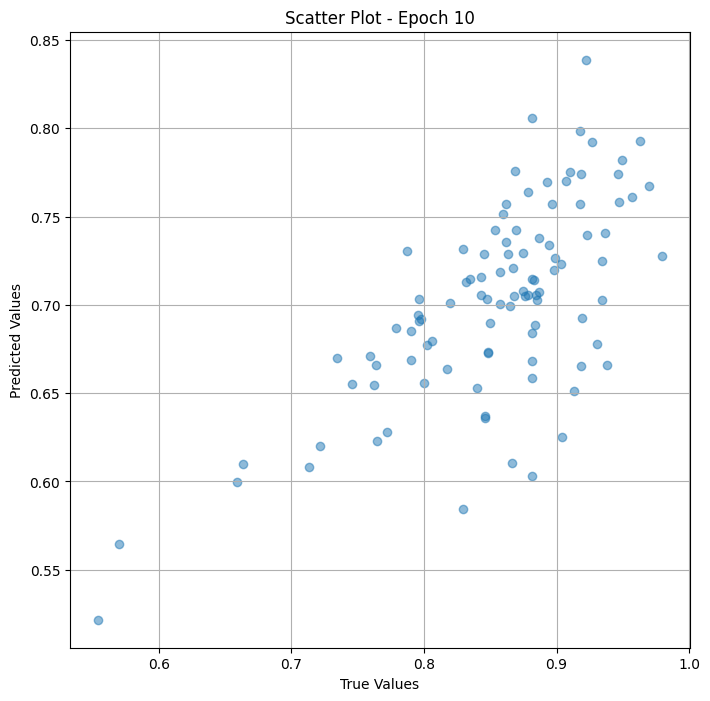

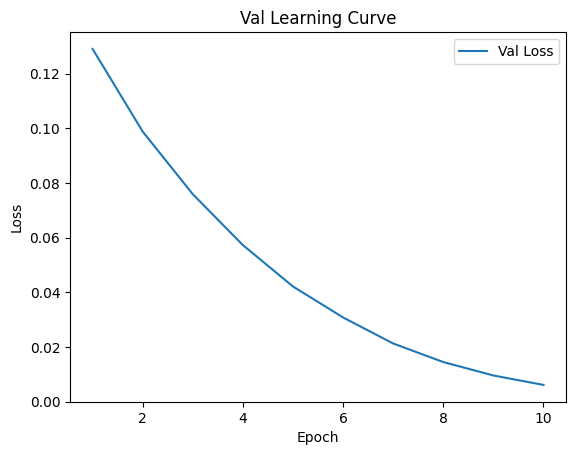


 Epoch: (11/50) Loss = 0.003805539570748806

 Epoch: (11/50) Loss_rmse = 0.06168905645608902

 Epoch: (11/50) R^2 = -0.5811214447021484

 Epoch: (11/50) MAE = 0.0607176274061203
Spearman correlation coefficient: SignificanceResult(statistic=0.6823913242855932, pvalue=1.9171257168254823e-14)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.898

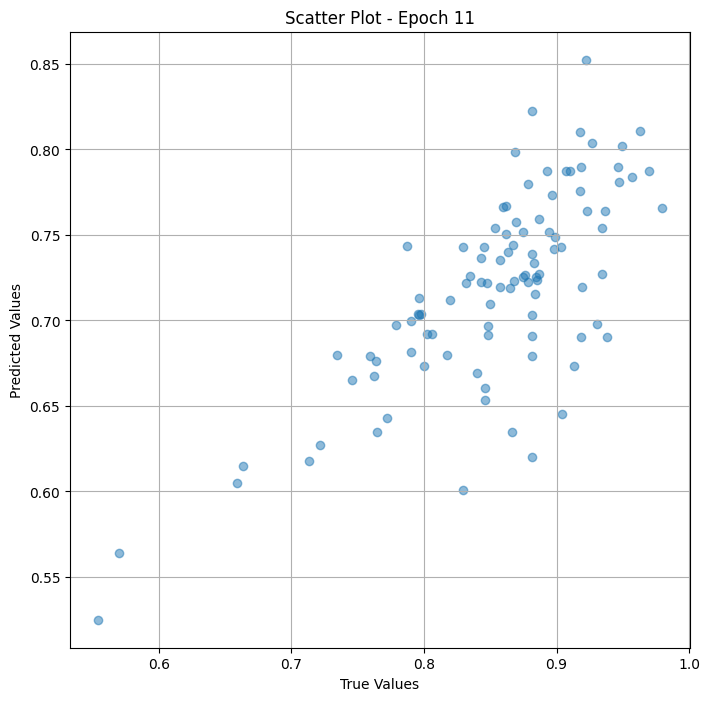

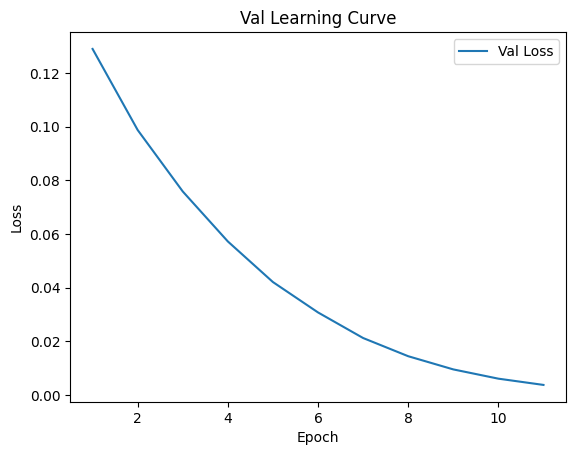


 Epoch: (12/50) Loss = 0.0022775952238589525

 Epoch: (12/50) Loss_rmse = 0.0477241575717926

 Epoch: (12/50) R^2 = 0.05370718240737915

 Epoch: (12/50) MAE = 0.04653400182723999
Spearman correlation coefficient: SignificanceResult(statistic=0.7447789851916822, pvalue=3.3535543441260466e-18)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

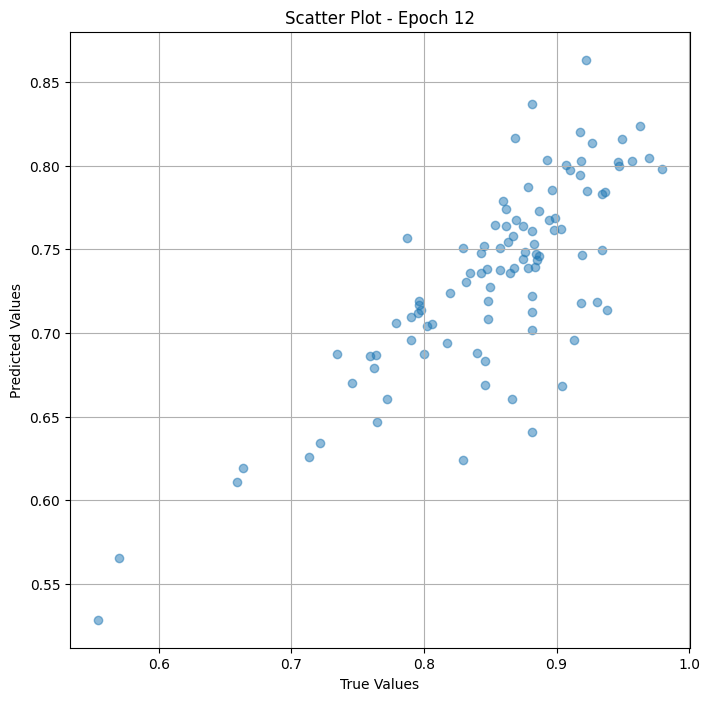

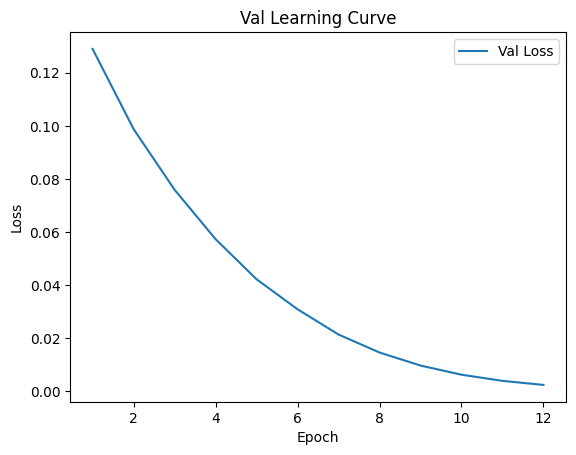


 Epoch: (13/50) Loss = 0.0012915852712467313

 Epoch: (13/50) Loss_rmse = 0.03593863174319267

 Epoch: (13/50) R^2 = 0.4633735418319702

 Epoch: (13/50) MAE = 0.03482277691364288
Spearman correlation coefficient: SignificanceResult(statistic=0.7918105182122106, pvalue=7.677828721938156e-22)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.898

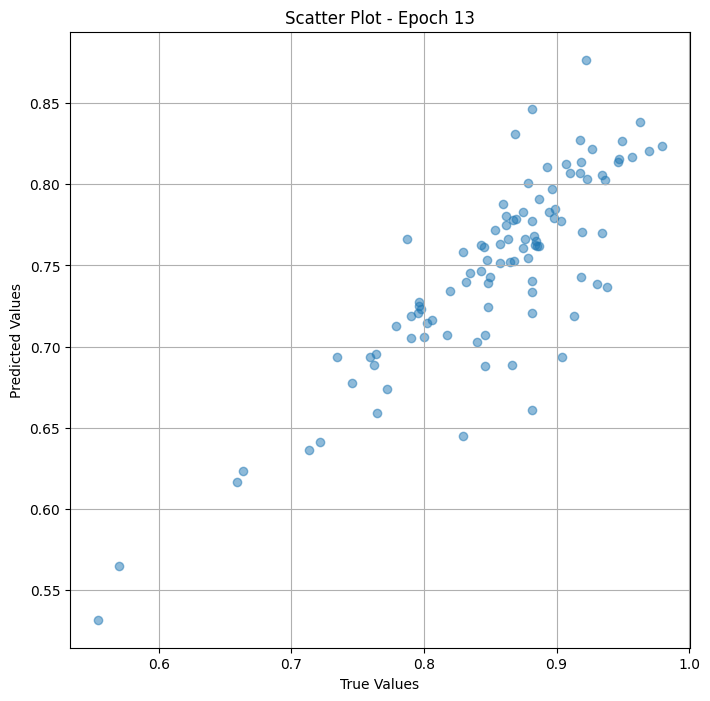

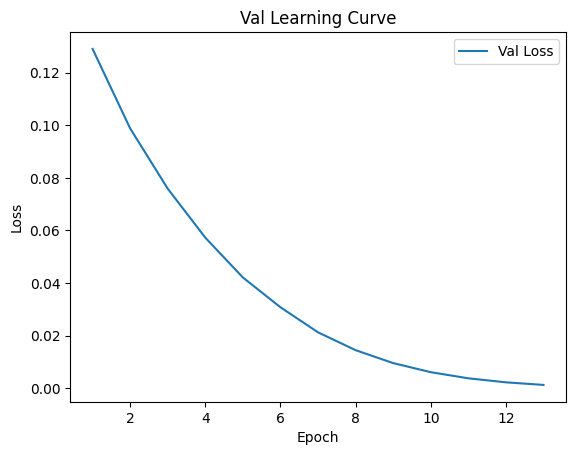


 Epoch: (14/50) Loss = 0.0006845554453320801

 Epoch: (14/50) Loss_rmse = 0.026164010167121887

 Epoch: (14/50) R^2 = 0.7155816555023193

 Epoch: (14/50) MAE = 0.025055110454559326
Spearman correlation coefficient: SignificanceResult(statistic=0.8389030959107293, pvalue=1.4321508862568378e-26)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

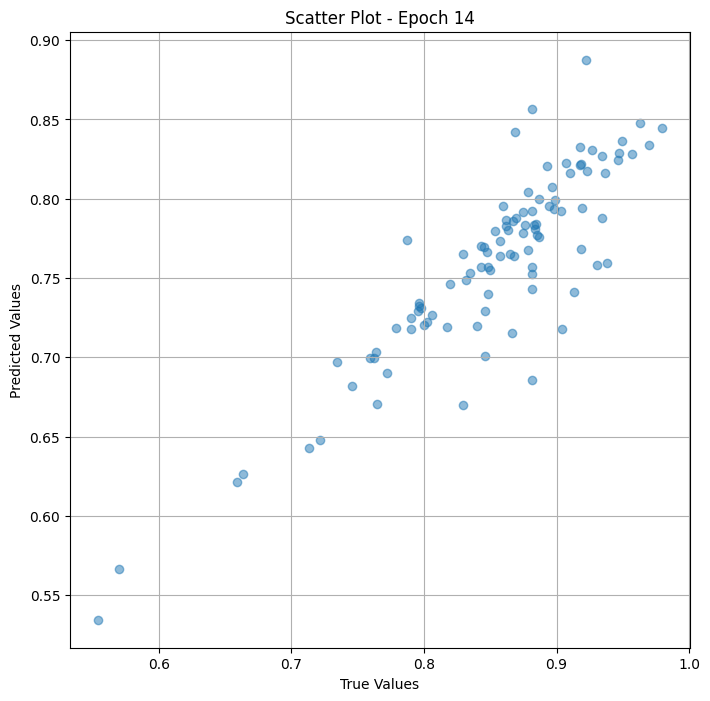

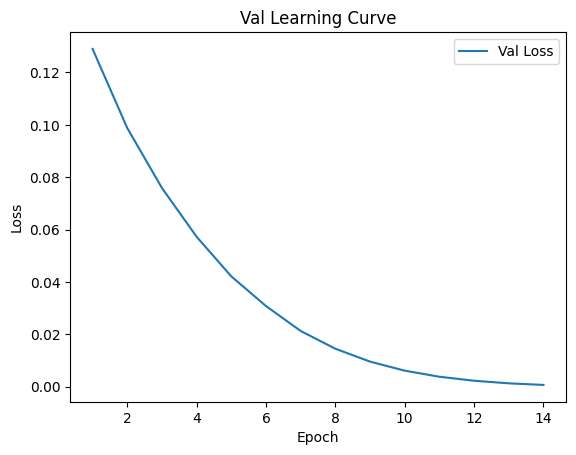


 Epoch: (15/50) Loss = 0.00032719160662963986

 Epoch: (15/50) Loss_rmse = 0.018088437616825104

 Epoch: (15/50) R^2 = 0.864058792591095

 Epoch: (15/50) MAE = 0.017036333680152893
Spearman correlation coefficient: SignificanceResult(statistic=0.883648844877621, pvalue=9.613926174245393e-33)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

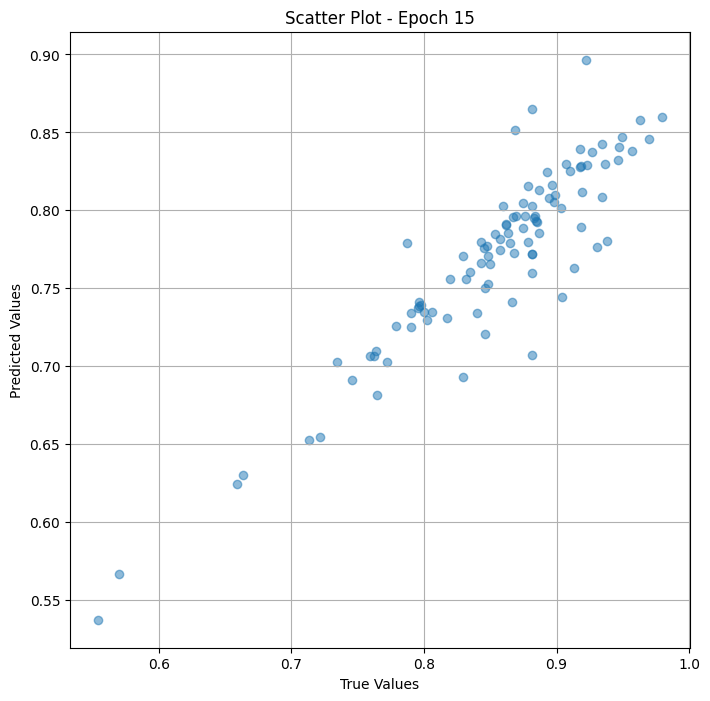

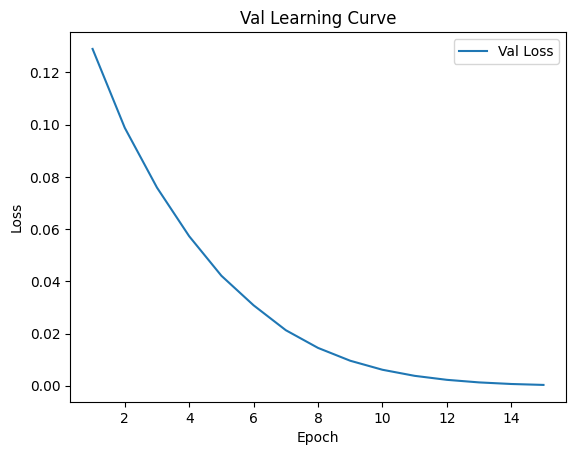


 Epoch: (16/50) Loss = 0.0001317484420724213

 Epoch: (16/50) Loss_rmse = 0.011478172615170479

 Epoch: (16/50) R^2 = 0.9452612996101379

 Epoch: (16/50) MAE = 0.01055920124053955
Spearman correlation coefficient: SignificanceResult(statistic=0.9133572548329014, pvalue=1.8642952031277003e-38)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

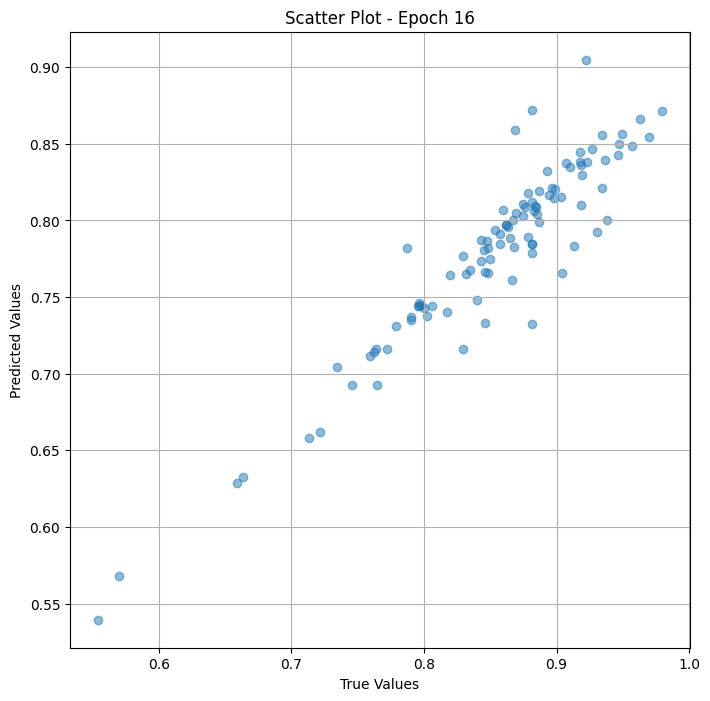

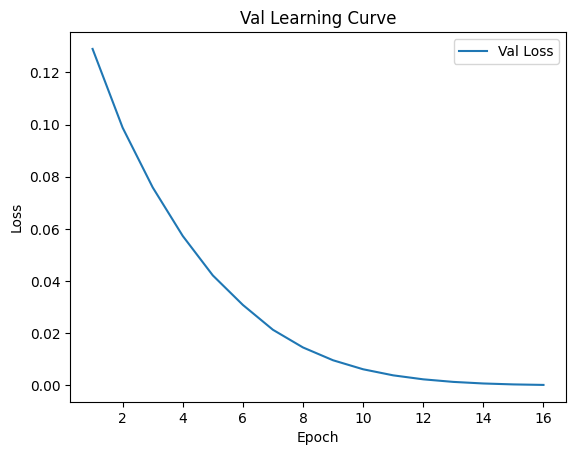


 Epoch: (17/50) Loss = 3.884113903040998e-05

 Epoch: (17/50) Loss_rmse = 0.0062322658486664295

 Epoch: (17/50) R^2 = 0.9838623404502869

 Epoch: (17/50) MAE = 0.005237072706222534
Spearman correlation coefficient: SignificanceResult(statistic=0.9429096617222066, pvalue=1.1347598209777941e-46)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

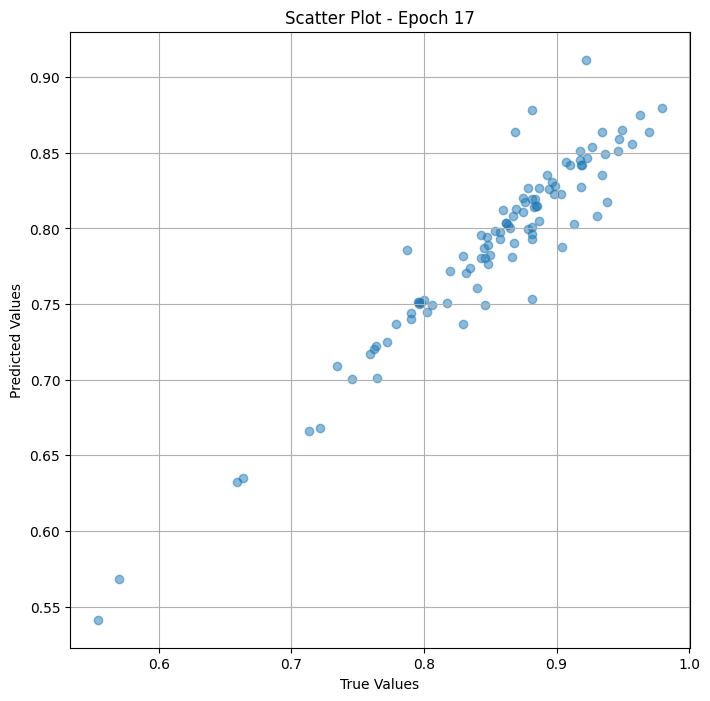

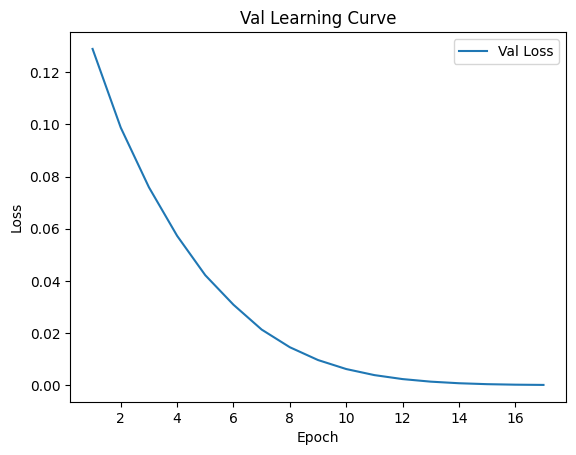


 Epoch: (18/50) Loss = 5.017785497329896e-06

 Epoch: (18/50) Loss_rmse = 0.0022400415036827326

 Epoch: (18/50) R^2 = 0.9979152083396912

 Epoch: (18/50) MAE = 0.0013166368007659912
Spearman correlation coefficient: SignificanceResult(statistic=0.9617114225432196, pvalue=1.227196919538365e-54)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

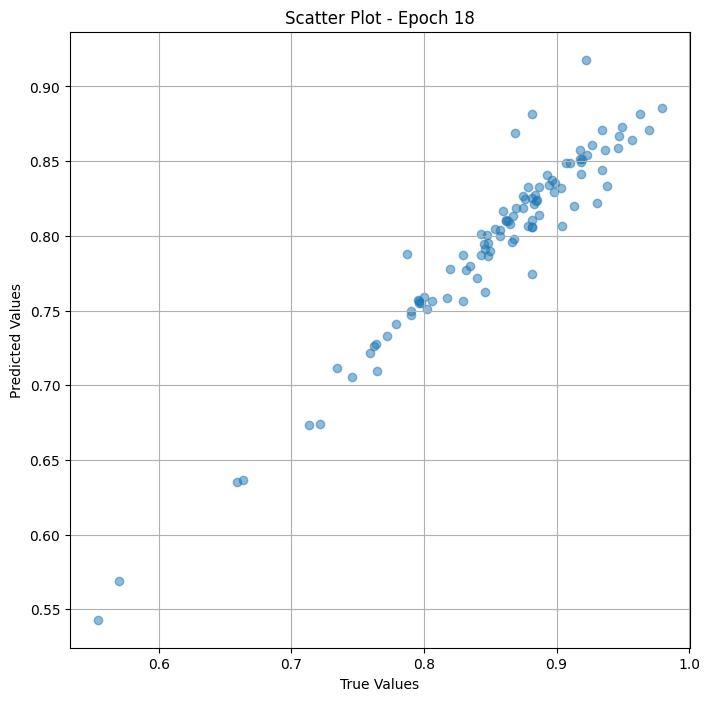

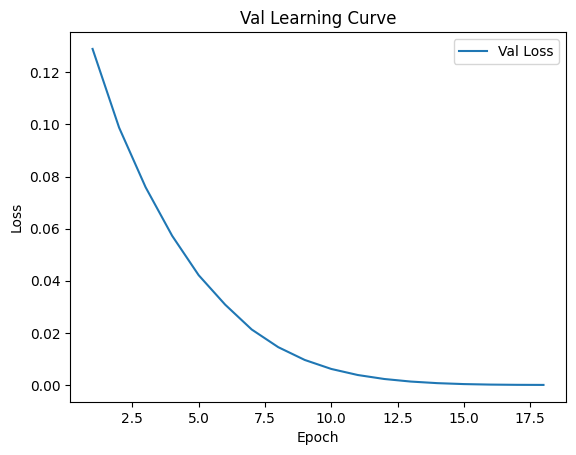


 Epoch: (19/50) Loss = 7.014427410467761e-06

 Epoch: (19/50) Loss_rmse = 0.0026484765112400055

 Epoch: (19/50) R^2 = 0.9970856308937073

 Epoch: (19/50) MAE = 0.002463608980178833
Spearman correlation coefficient: SignificanceResult(statistic=0.9755617817050194, pvalue=1.1520317936439012e-63)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

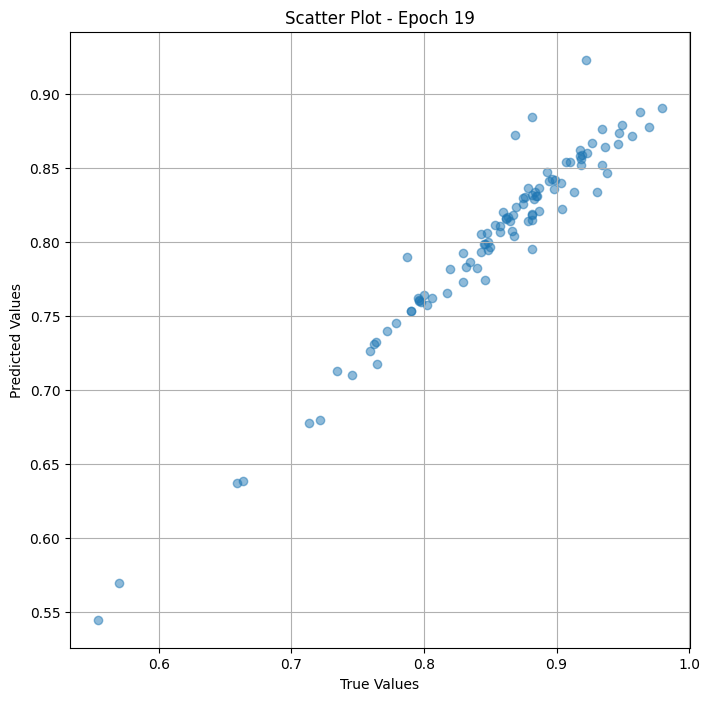

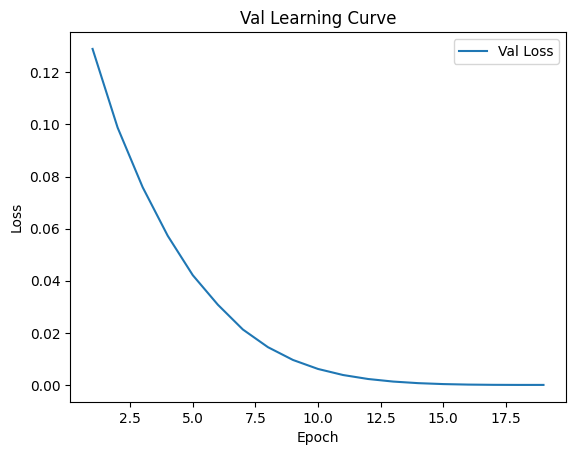


 Epoch: (20/50) Loss = 2.6085890567628667e-05

 Epoch: (20/50) Loss_rmse = 0.005107434932142496

 Epoch: (20/50) R^2 = 0.9891618490219116

 Epoch: (20/50) MAE = 0.0050465017557144165
Spearman correlation coefficient: SignificanceResult(statistic=0.9812592849841143, pvalue=5.005577773512268e-69)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

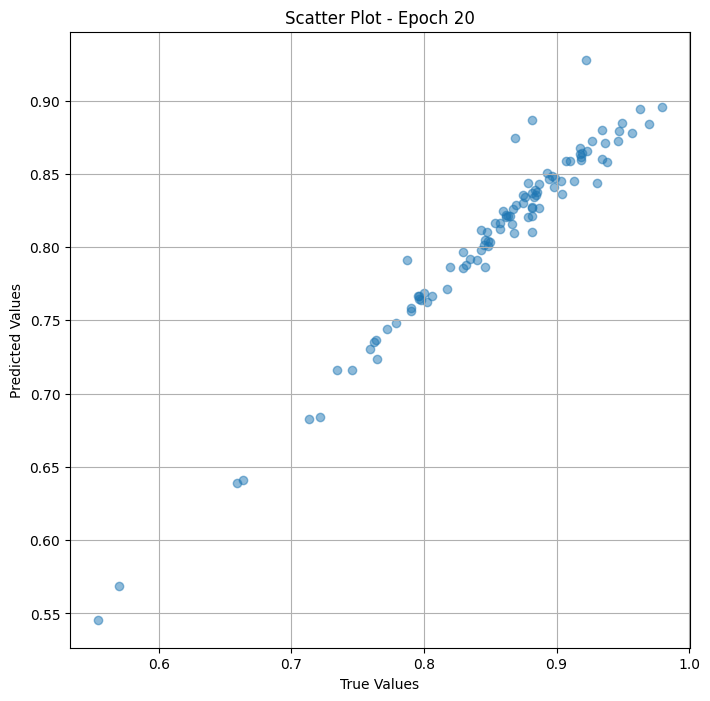

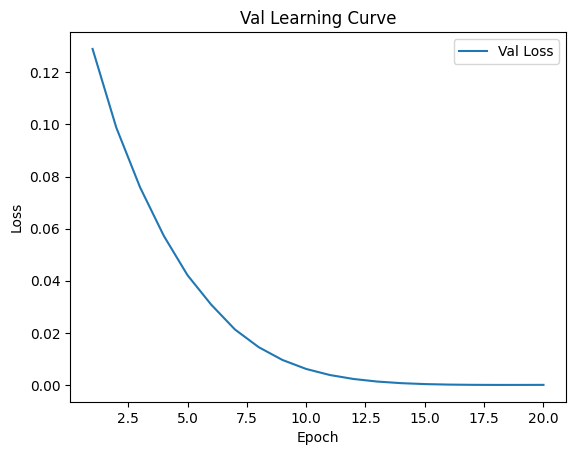

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (21/50) Loss = 5.256379517959431e-05

 Epoch: (21/50) Loss_rmse = 0.007250089198350906

 Epoch: (21/50) R^2 = 0.9781608581542969

 Epoch: (21/50) MAE = 0.006994456052780151
Spearman correlation coefficient: SignificanceResult(statistic=0.986000421641361, pvalue=6.203638230553775e-75)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0

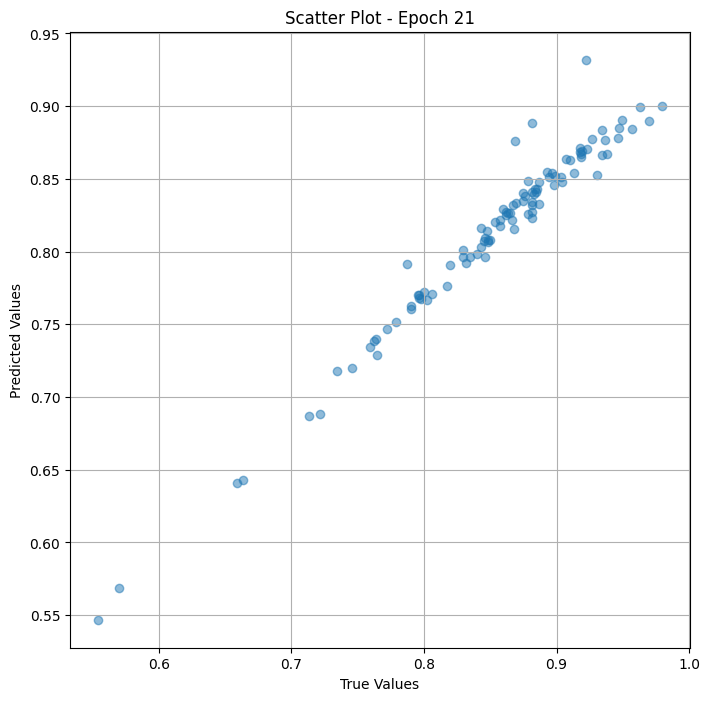

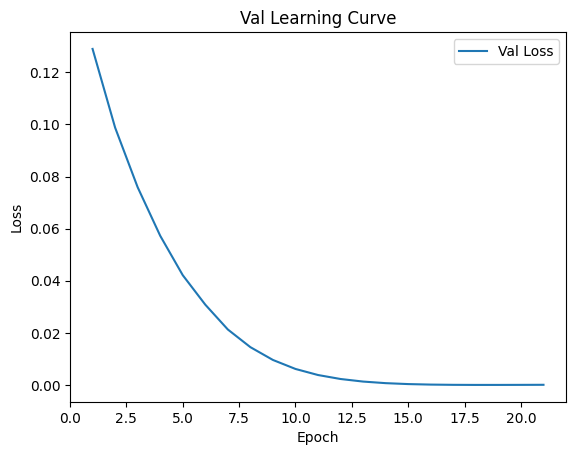


 Epoch: (22/50) Loss = 6.0677892179228365e-05

 Epoch: (22/50) Loss_rmse = 0.007789601571857929

 Epoch: (22/50) R^2 = 0.9747896194458008

 Epoch: (22/50) MAE = 0.007443740963935852
Spearman correlation coefficient: SignificanceResult(statistic=0.9868618298752242, pvalue=3.1978886307742e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

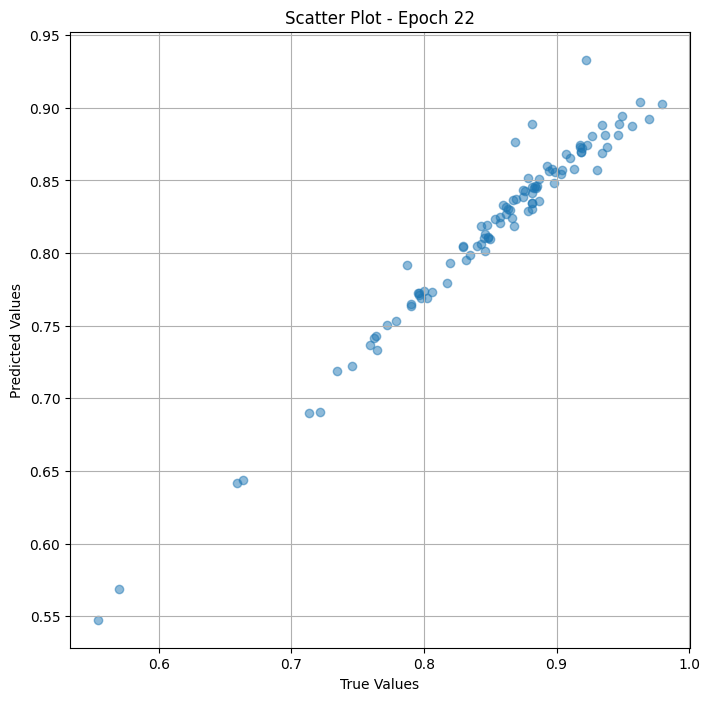

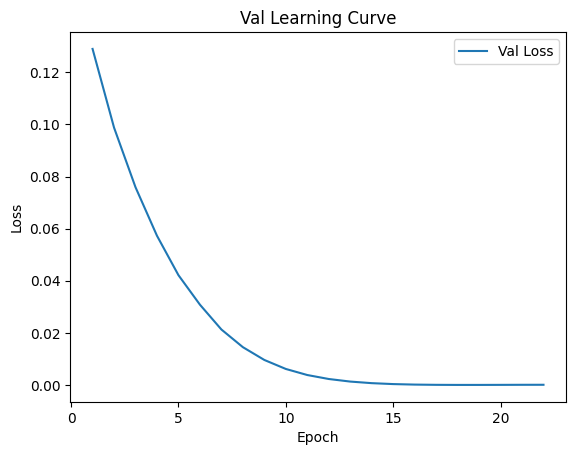


 Epoch: (23/50) Loss = 6.279330409597605e-05

 Epoch: (23/50) Loss_rmse = 0.007924222387373447

 Epoch: (23/50) R^2 = 0.9739106893539429

 Epoch: (23/50) MAE = 0.0075561851263046265
Spearman correlation coefficient: SignificanceResult(statistic=0.9871874014911725, pvalue=9.905522787223544e-77)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

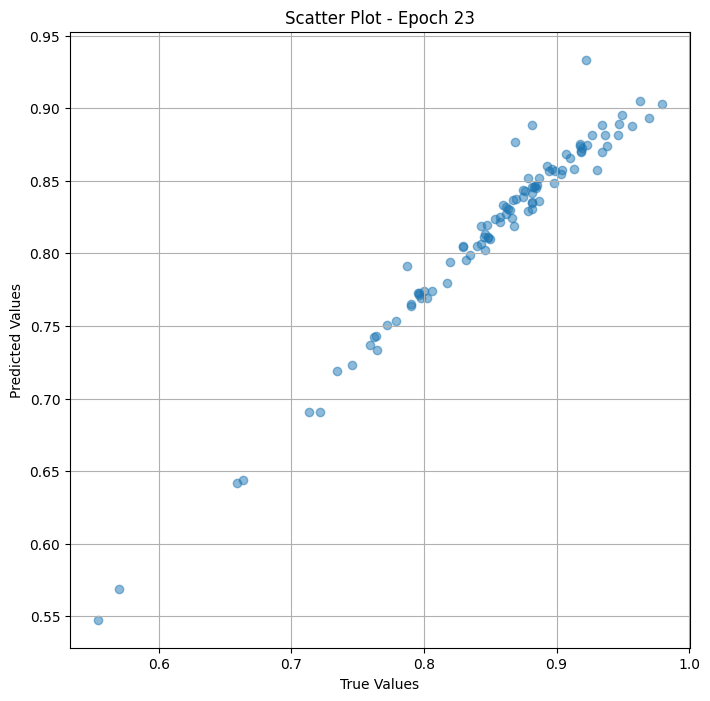

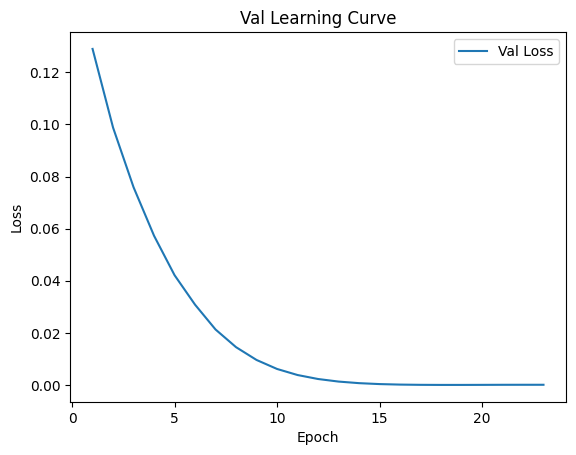

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (24/50) Loss = 6.455960829043761e-05

 Epoch: (24/50) Loss_rmse = 0.008034899830818176

 Epoch: (24/50) R^2 = 0.9731768369674683

 Epoch: (24/50) MAE = 0.007645055651664734
Spearman correlation coefficient: SignificanceResult(statistic=0.9871874014911725, pvalue=9.905522787223544e-77)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 

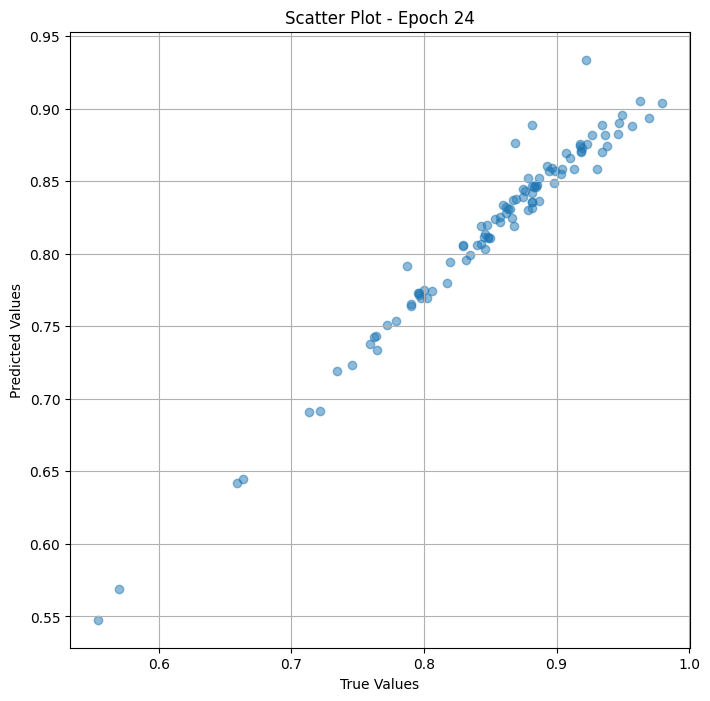

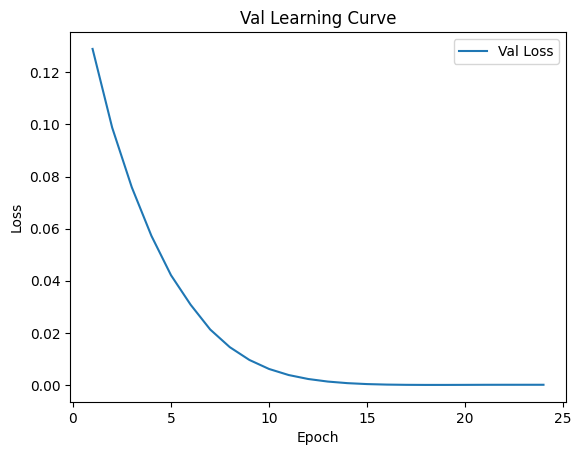


 Epoch: (25/50) Loss = 6.500040763057768e-05

 Epoch: (25/50) Loss_rmse = 0.00806228257715702

 Epoch: (25/50) R^2 = 0.9729936718940735

 Epoch: (25/50) MAE = 0.007664039731025696
Spearman correlation coefficient: SignificanceResult(statistic=0.9869432227792111, pvalue=2.392306133750108e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

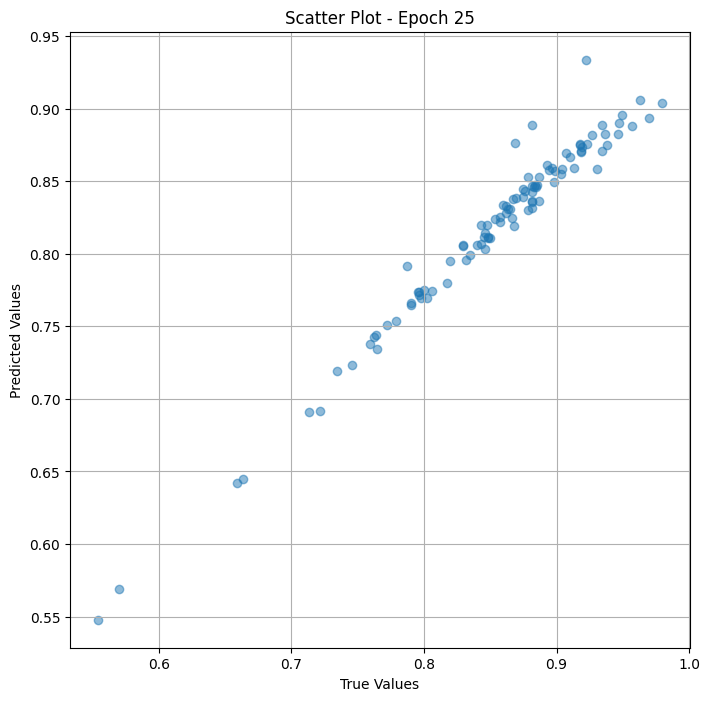

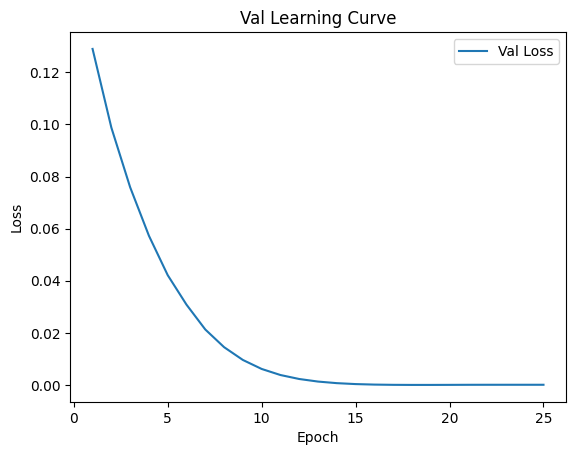


 Epoch: (26/50) Loss = 6.513885455206037e-05

 Epoch: (26/50) Loss_rmse = 0.008070864714682102

 Epoch: (26/50) R^2 = 0.9729361534118652

 Epoch: (26/50) MAE = 0.007670477032661438
Spearman correlation coefficient: SignificanceResult(statistic=0.9869703537472069, pvalue=2.170828119575817e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

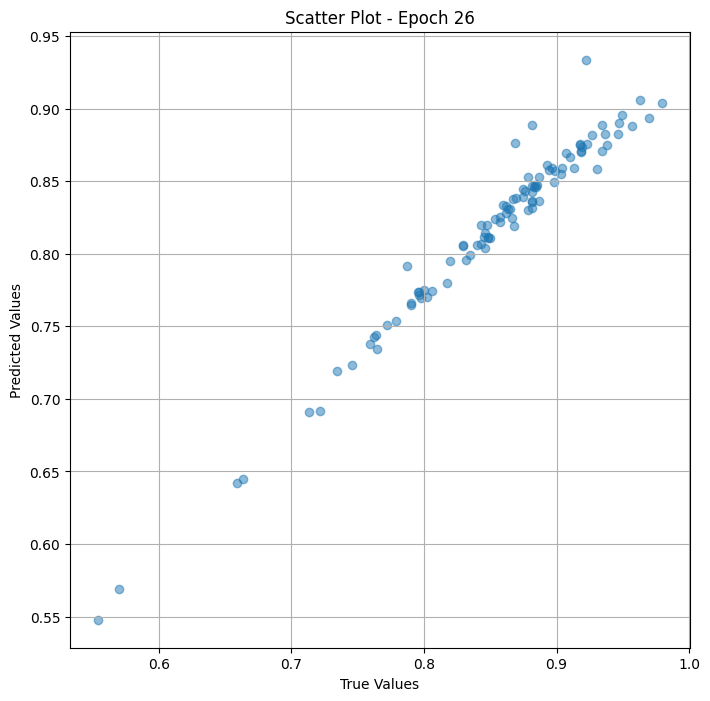

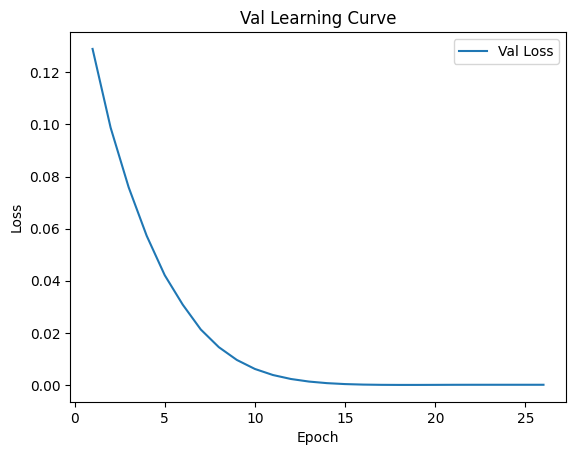

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (27/50) Loss = 6.526582001242787e-05

 Epoch: (27/50) Loss_rmse = 0.008078726008534431

 Epoch: (27/50) R^2 = 0.972883403301239

 Epoch: (27/50) MAE = 0.007676228880882263
Spearman correlation coefficient: SignificanceResult(statistic=0.9869703537472069, pvalue=2.170828119575817e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0

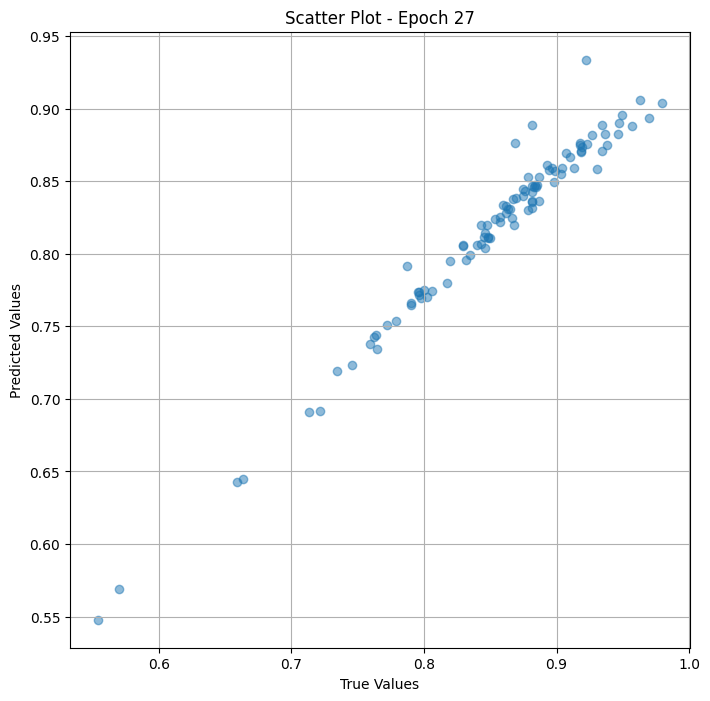

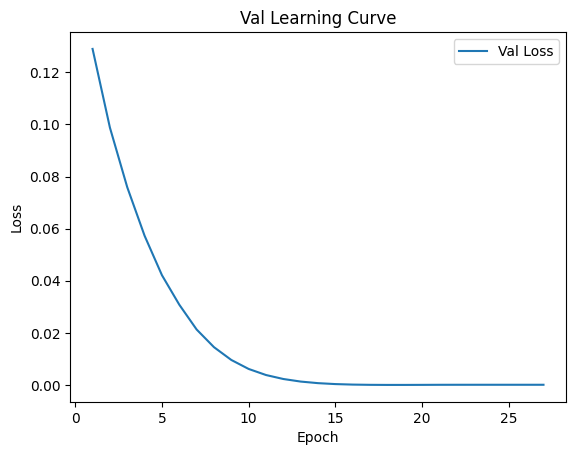


 Epoch: (28/50) Loss = 6.529995880555362e-05

 Epoch: (28/50) Loss_rmse = 0.008080839179456234

 Epoch: (28/50) R^2 = 0.9728692173957825

 Epoch: (28/50) MAE = 0.007677540183067322
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

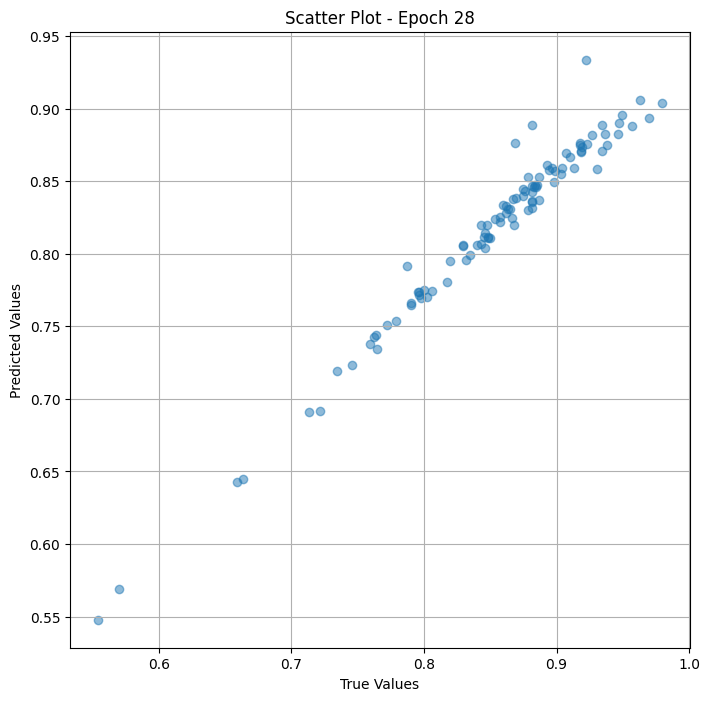

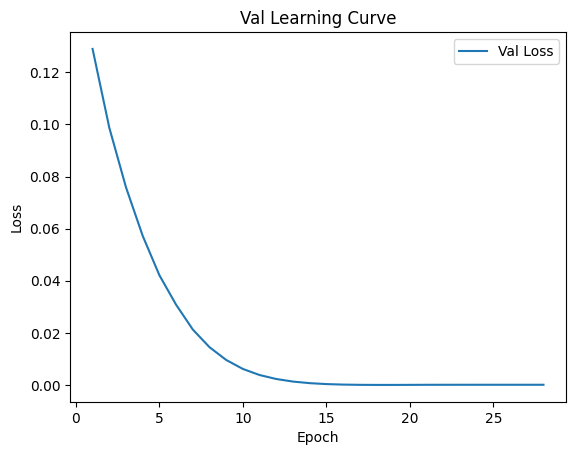


 Epoch: (29/50) Loss = 6.531407416332513e-05

 Epoch: (29/50) Loss_rmse = 0.008081712760031223

 Epoch: (29/50) R^2 = 0.9728633761405945

 Epoch: (29/50) MAE = 0.007678329944610596
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

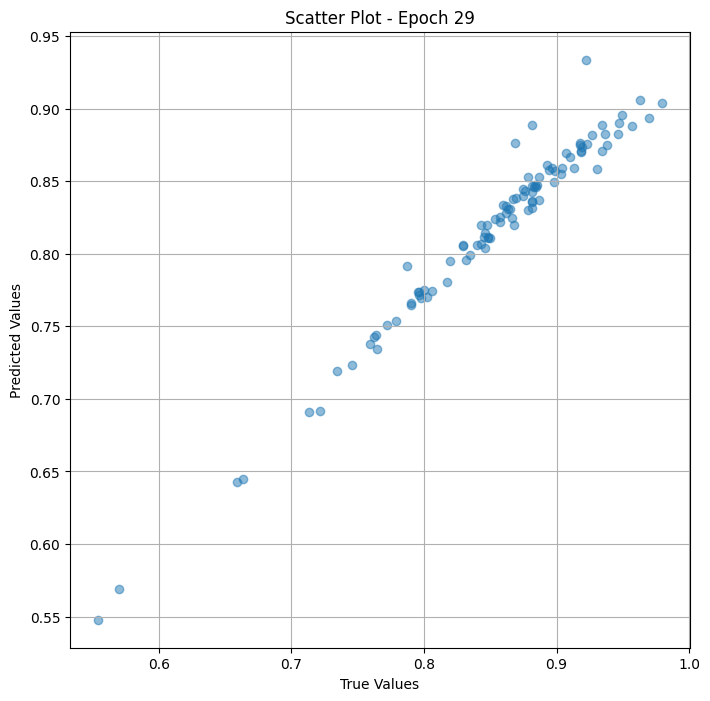

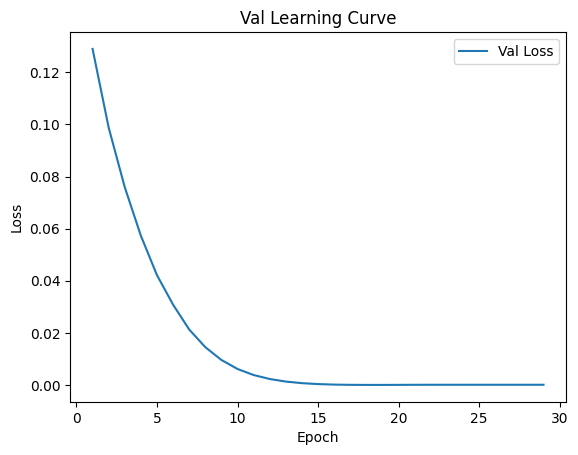

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (30/50) Loss = 6.532808765769005e-05

 Epoch: (30/50) Loss_rmse = 0.008082578890025616

 Epoch: (30/50) R^2 = 0.9728575348854065

 Epoch: (30/50) MAE = 0.0076790302991867065
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627,

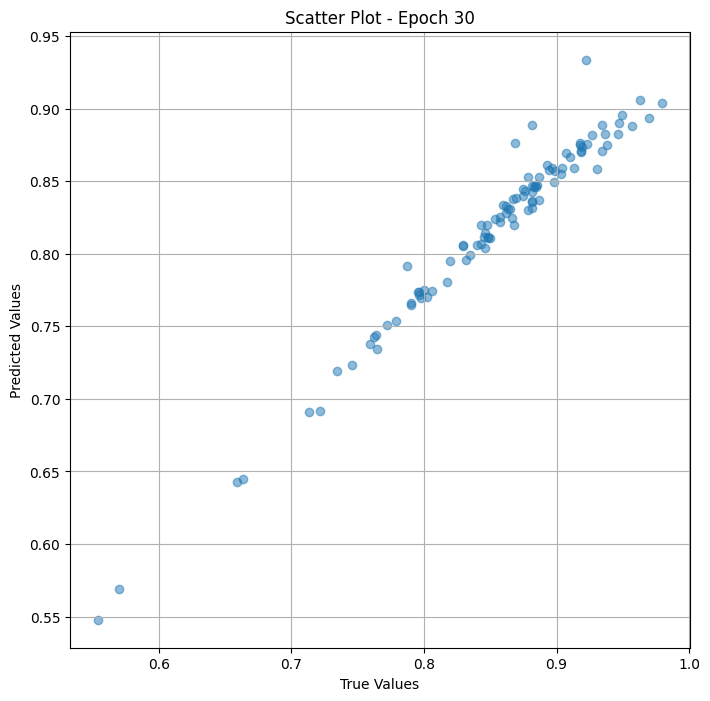

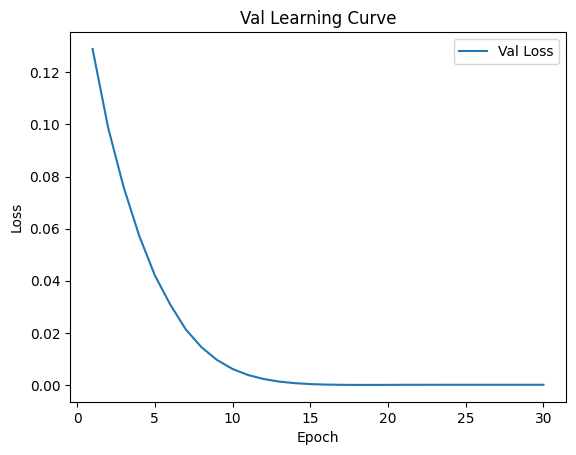


 Epoch: (31/50) Loss = 6.533194391522557e-05

 Epoch: (31/50) Loss_rmse = 0.008082818239927292

 Epoch: (31/50) R^2 = 0.9728559255599976

 Epoch: (31/50) MAE = 0.007679253816604614
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

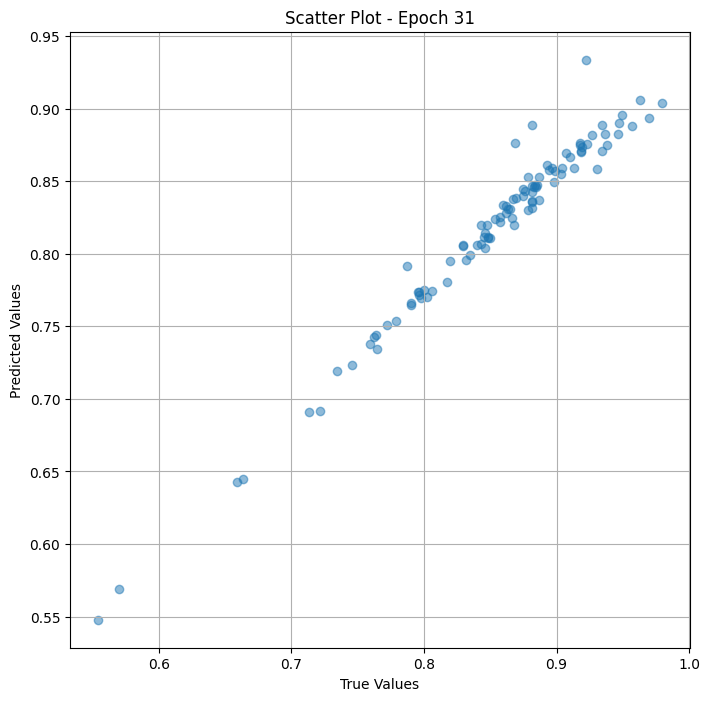

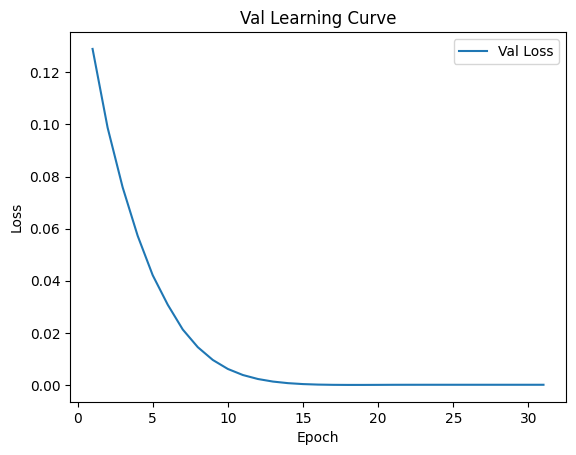


 Epoch: (32/50) Loss = 6.533492705784738e-05

 Epoch: (32/50) Loss_rmse = 0.008083002641797066

 Epoch: (32/50) R^2 = 0.972854733467102

 Epoch: (32/50) MAE = 0.007679447531700134
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

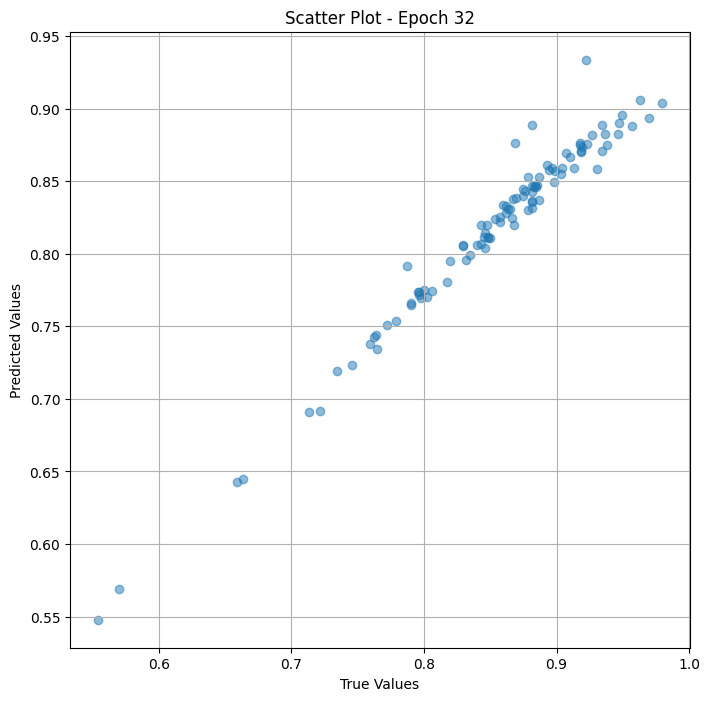

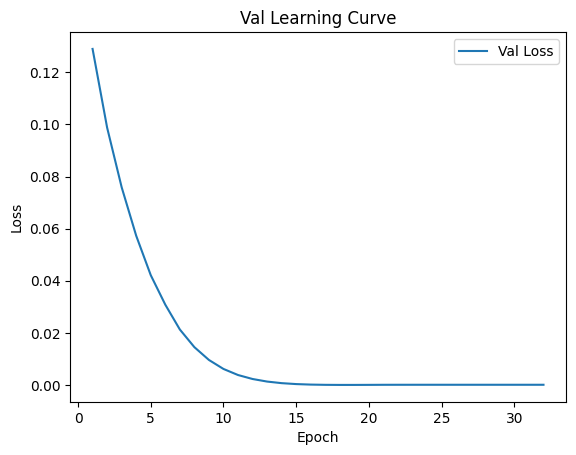


 Epoch: (33/50) Loss = 6.53365277685225e-05

 Epoch: (33/50) Loss_rmse = 0.008083101361989975

 Epoch: (33/50) R^2 = 0.9728540778160095

 Epoch: (33/50) MAE = 0.007679551839828491
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

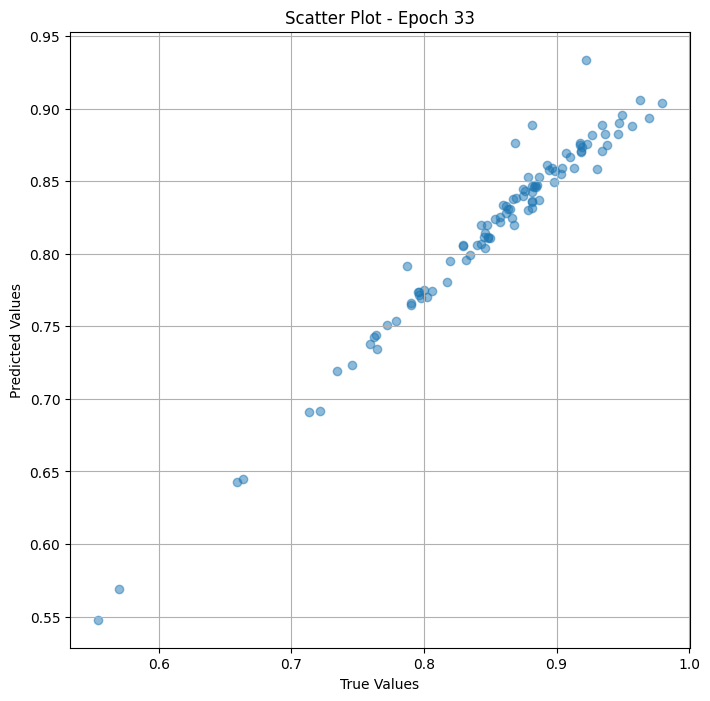

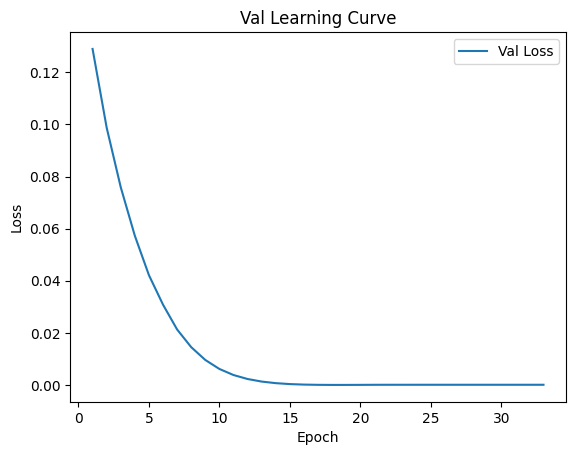


 Epoch: (34/50) Loss = 6.533889245474711e-05

 Epoch: (34/50) Loss_rmse = 0.00808324757963419

 Epoch: (34/50) R^2 = 0.9728530645370483

 Epoch: (34/50) MAE = 0.0076797157526016235
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

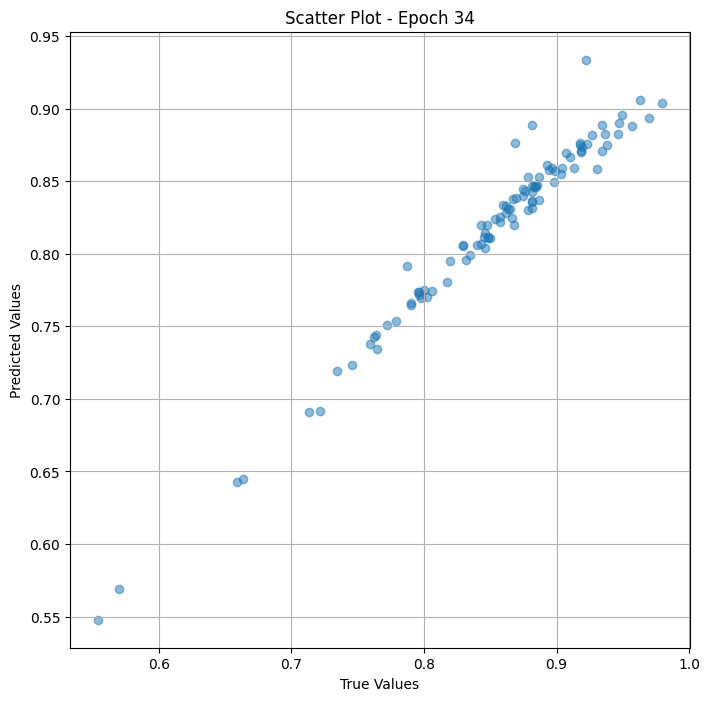

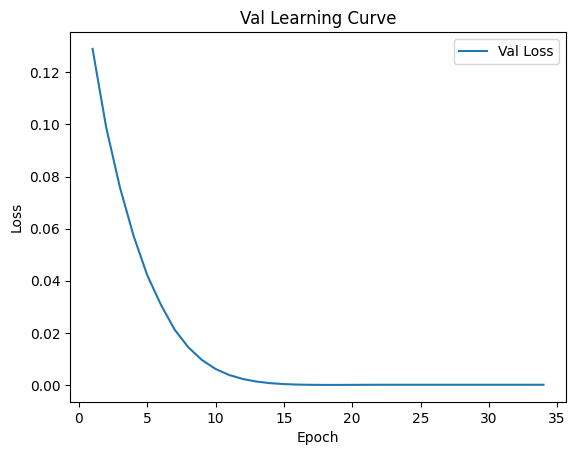


 Epoch: (35/50) Loss = 6.534098065458238e-05

 Epoch: (35/50) Loss_rmse = 0.008083377033472061

 Epoch: (35/50) R^2 = 0.9728522300720215

 Epoch: (35/50) MAE = 0.007679834961891174
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

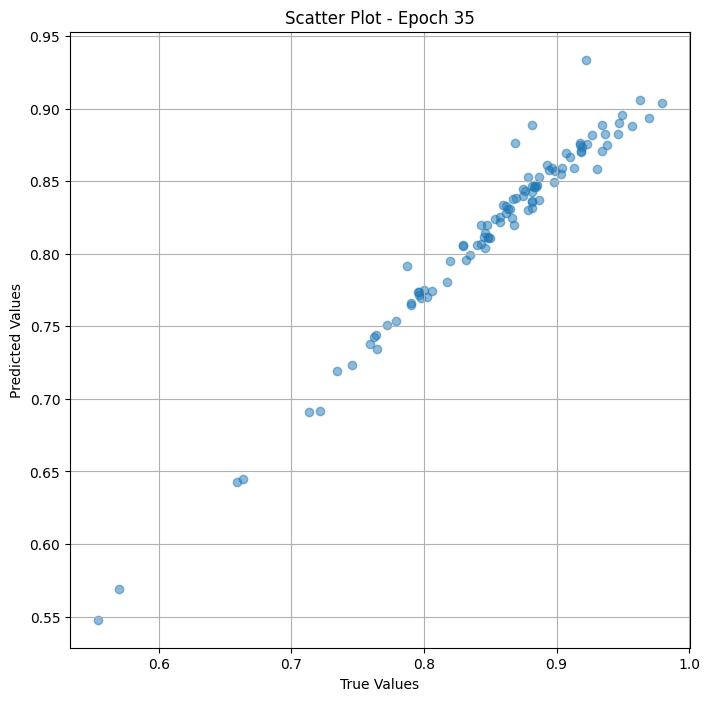

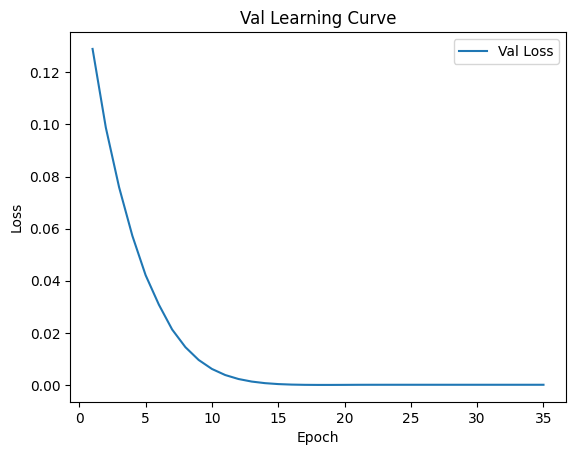


 Epoch: (36/50) Loss = 6.534301064675674e-05

 Epoch: (36/50) Loss_rmse = 0.008083502762019634

 Epoch: (36/50) R^2 = 0.9728513360023499

 Epoch: (36/50) MAE = 0.007679983973503113
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

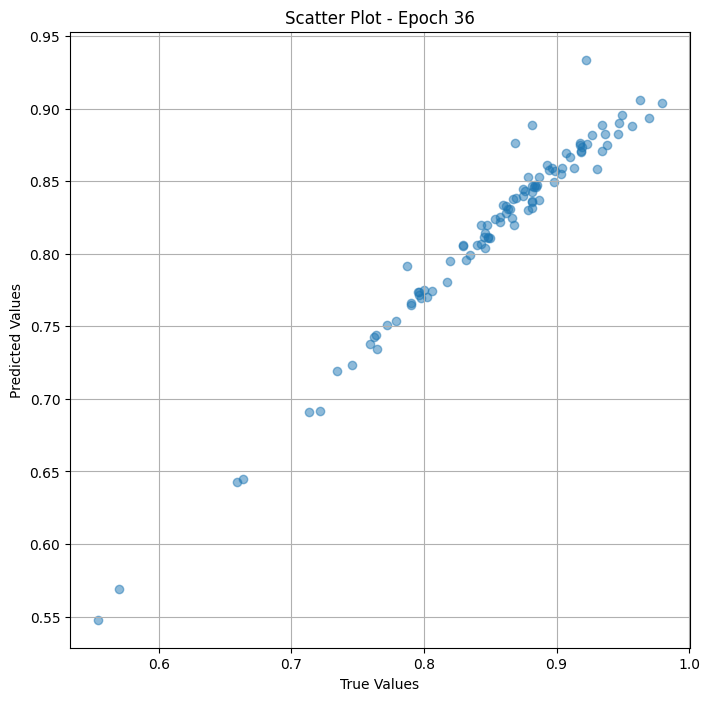

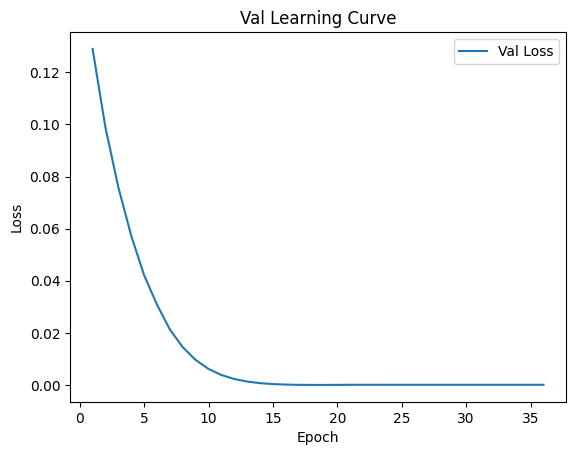


 Epoch: (37/50) Loss = 6.534532440127805e-05

 Epoch: (37/50) Loss_rmse = 0.00808364525437355

 Epoch: (37/50) R^2 = 0.9728503823280334

 Epoch: (37/50) MAE = 0.007680132985115051
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

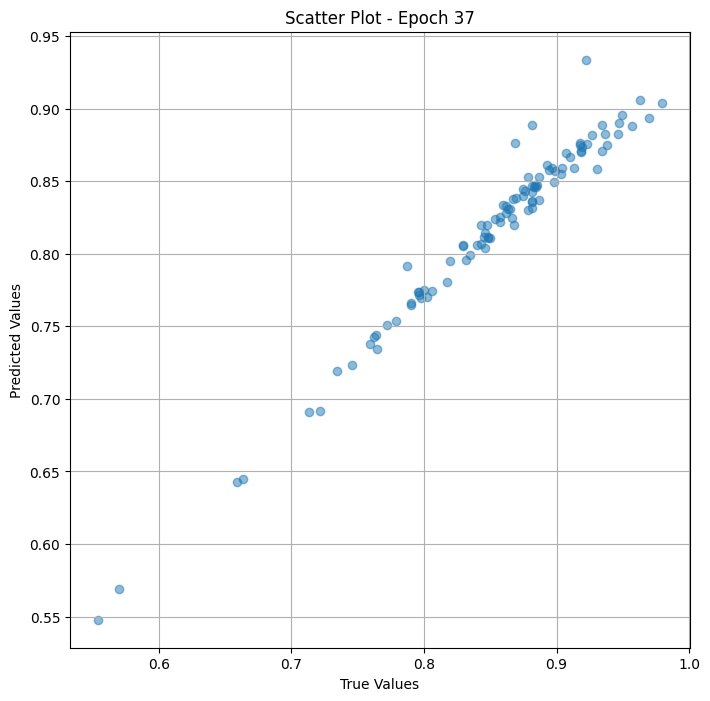

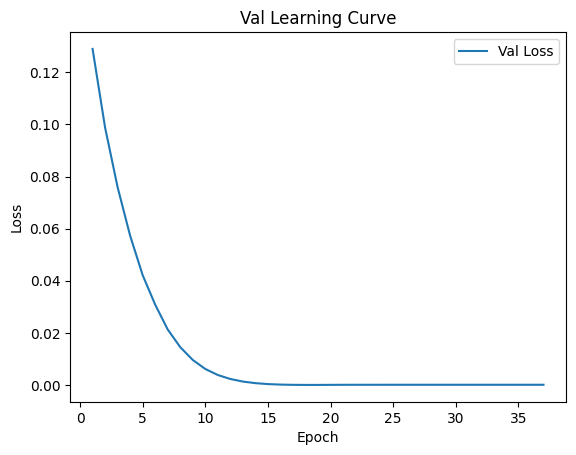


 Epoch: (38/50) Loss = 6.53477109153755e-05

 Epoch: (38/50) Loss_rmse = 0.008083793334662914

 Epoch: (38/50) R^2 = 0.972849428653717

 Epoch: (38/50) MAE = 0.00768028199672699
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989

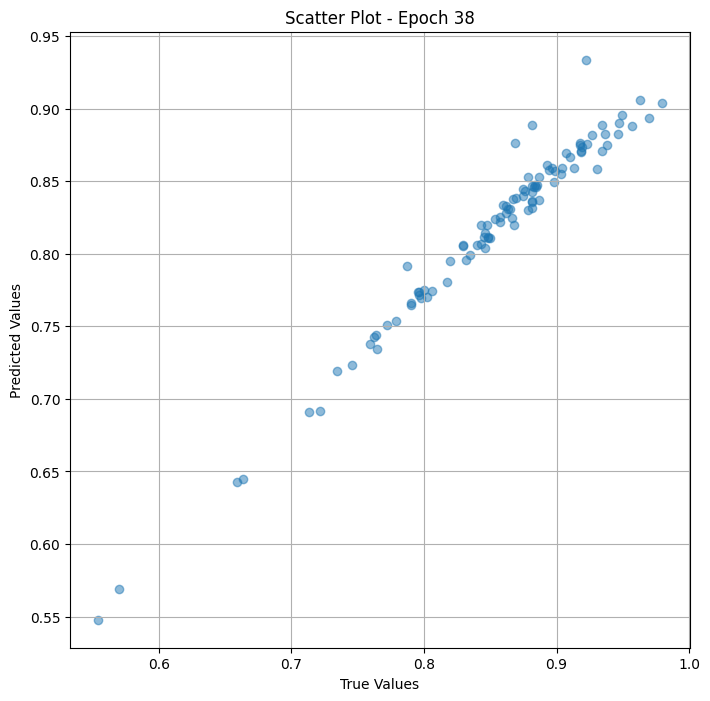

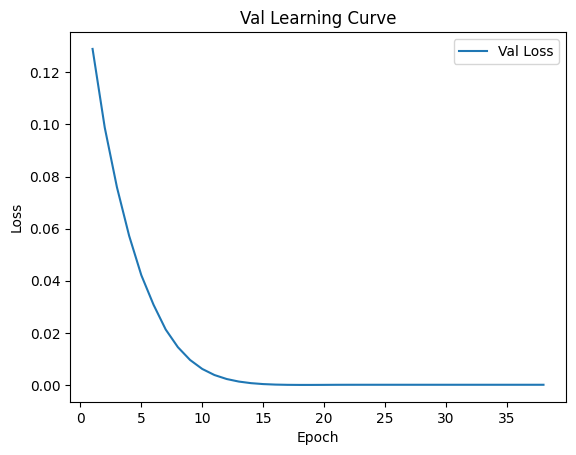


 Epoch: (39/50) Loss = 6.534956628456712e-05

 Epoch: (39/50) Loss_rmse = 0.008083907887339592

 Epoch: (39/50) R^2 = 0.972848653793335

 Epoch: (39/50) MAE = 0.007680416107177734
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

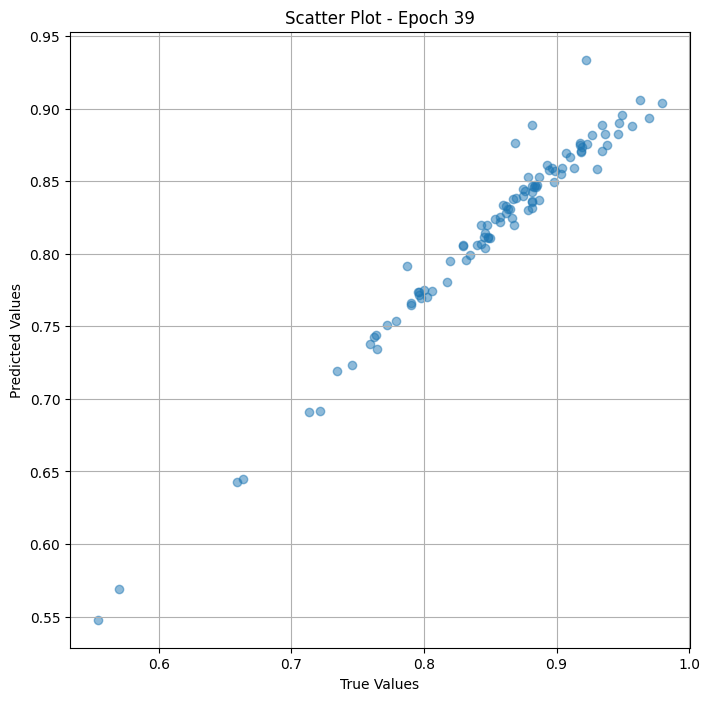

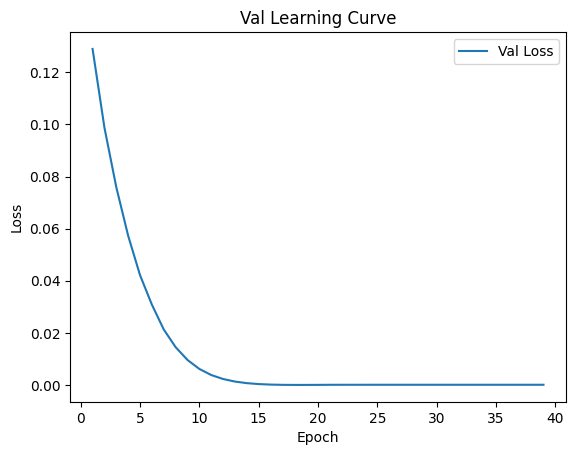


 Epoch: (40/50) Loss = 6.53519673505798e-05

 Epoch: (40/50) Loss_rmse = 0.008084055967628956

 Epoch: (40/50) R^2 = 0.9728476405143738

 Epoch: (40/50) MAE = 0.007680580019950867
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

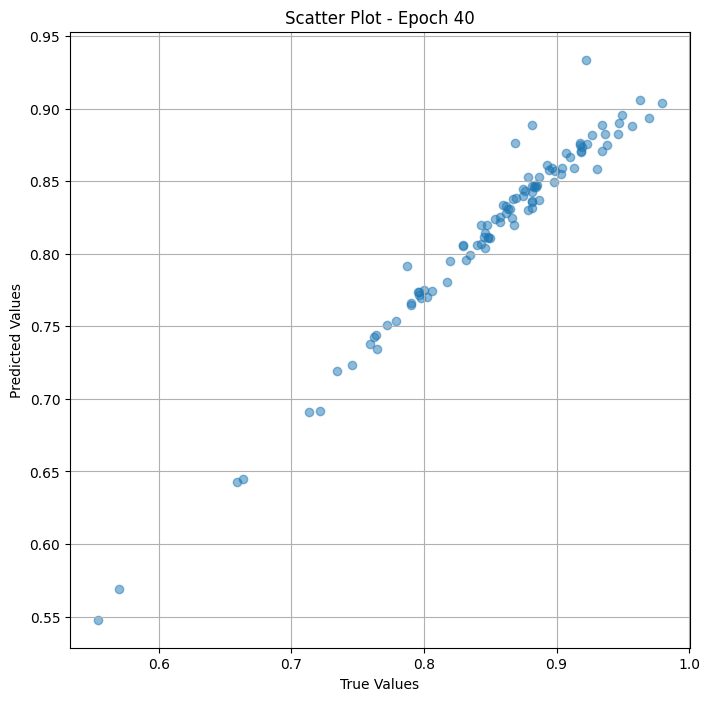

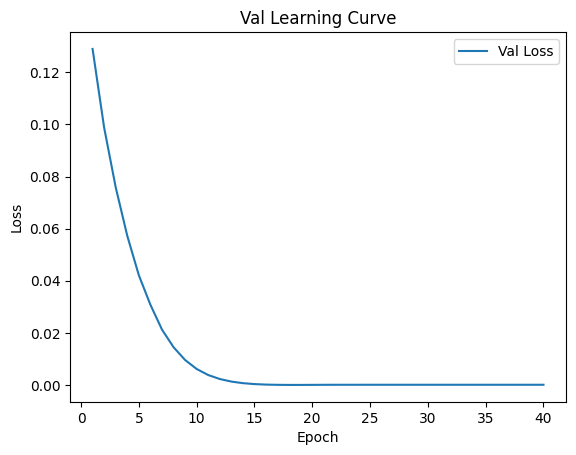


 Epoch: (41/50) Loss = 6.535456486744806e-05

 Epoch: (41/50) Loss_rmse = 0.008084217086434364

 Epoch: (41/50) R^2 = 0.9728465676307678

 Epoch: (41/50) MAE = 0.007680729031562805
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

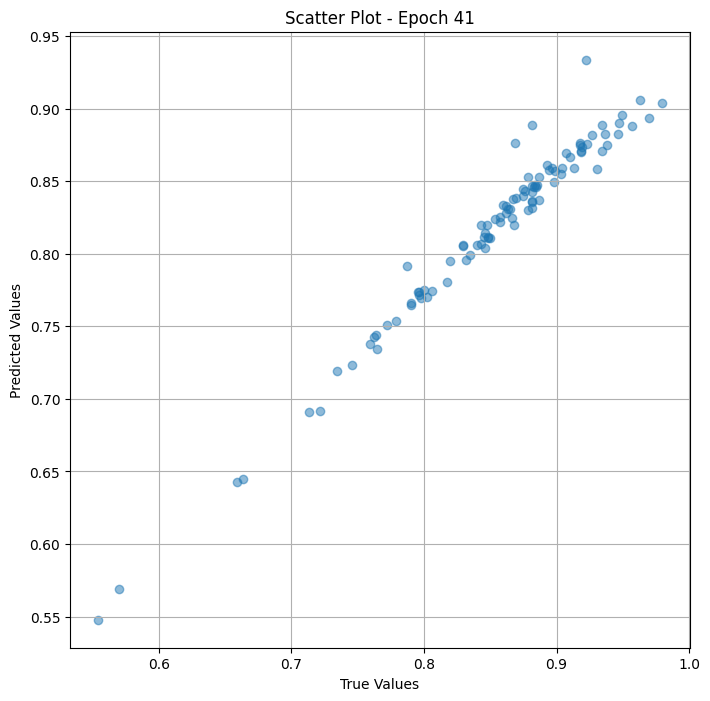

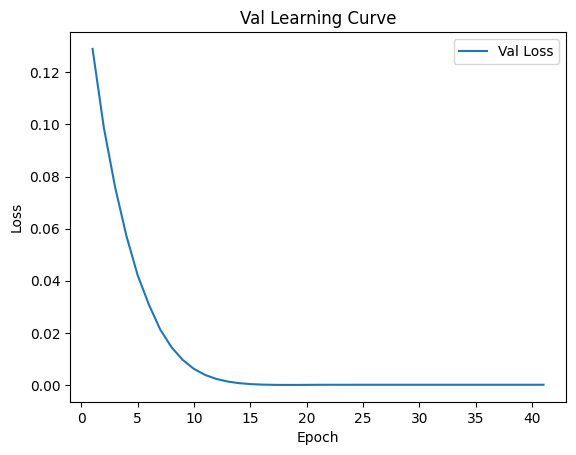


 Epoch: (42/50) Loss = 6.535671127494425e-05

 Epoch: (42/50) Loss_rmse = 0.00808434933423996

 Epoch: (42/50) R^2 = 0.9728456735610962

 Epoch: (42/50) MAE = 0.007680848240852356
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

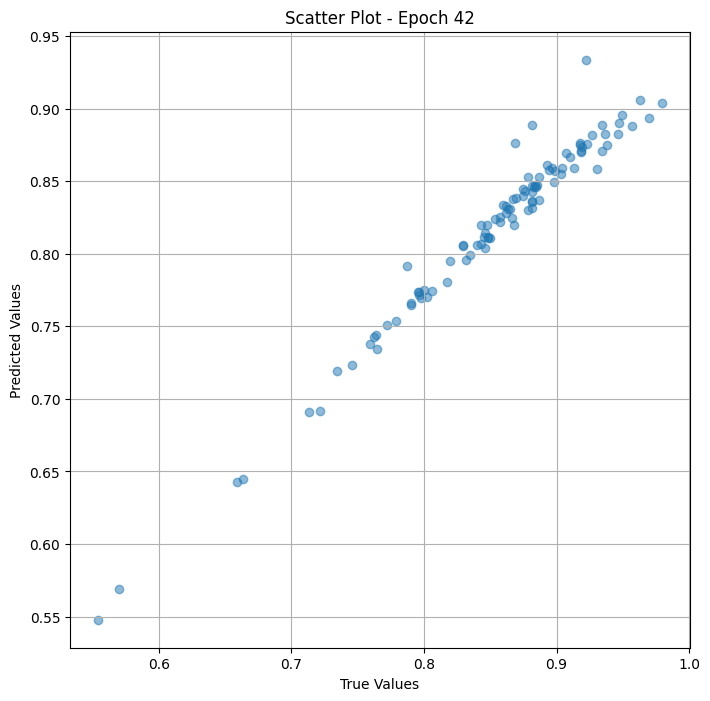

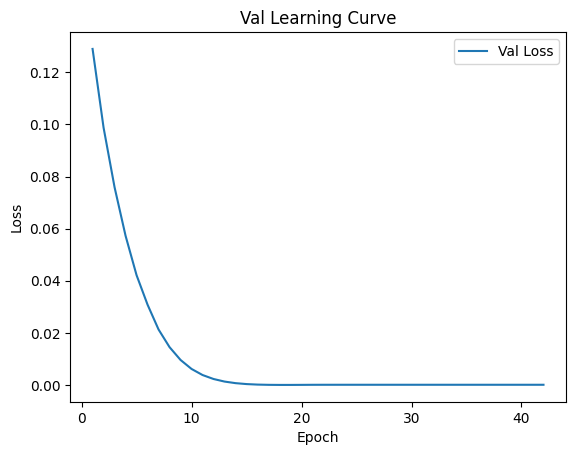


 Epoch: (43/50) Loss = 6.535882130265236e-05

 Epoch: (43/50) Loss_rmse = 0.00808448065072298

 Epoch: (43/50) R^2 = 0.9728447794914246

 Epoch: (43/50) MAE = 0.007680982351303101
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

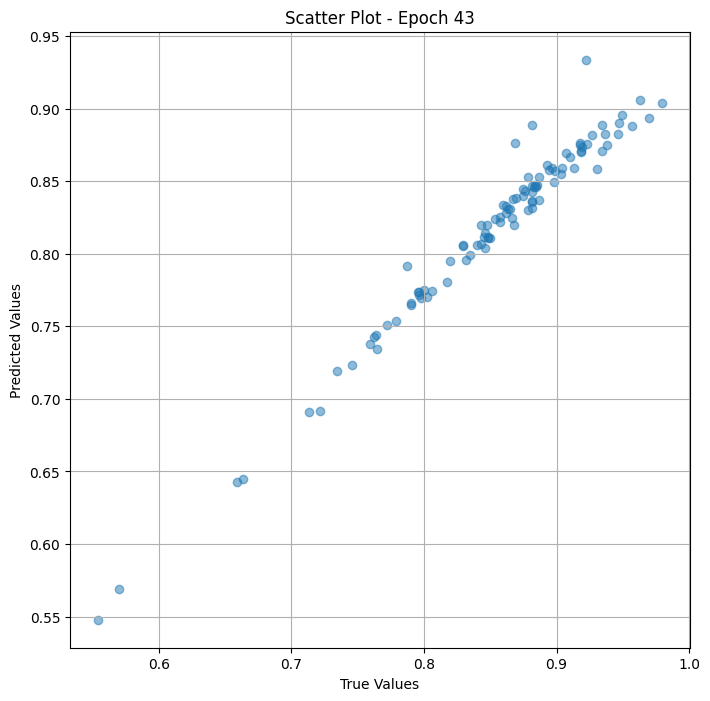

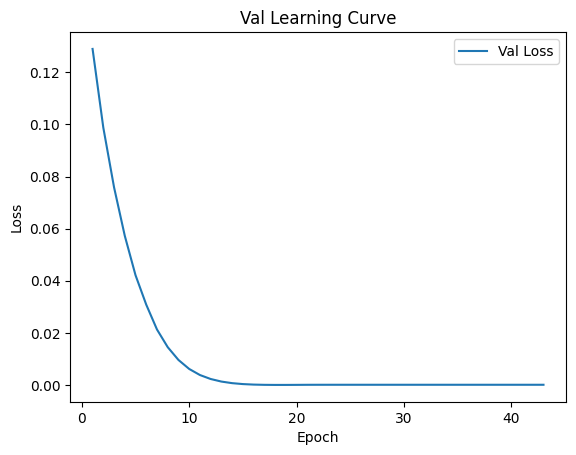


 Epoch: (44/50) Loss = 6.536100408993661e-05

 Epoch: (44/50) Loss_rmse = 0.0080846156924963

 Epoch: (44/50) R^2 = 0.9728438854217529

 Epoch: (44/50) MAE = 0.007681146264076233
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.898

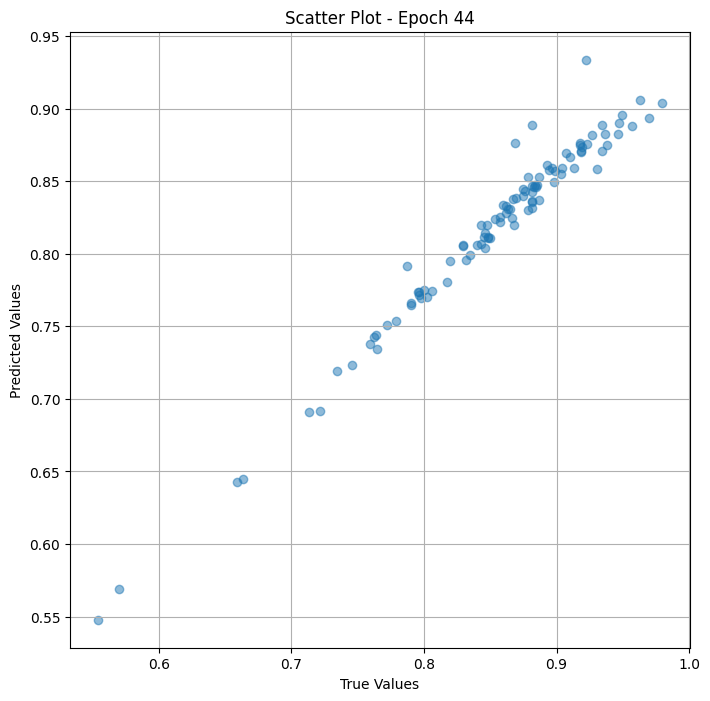

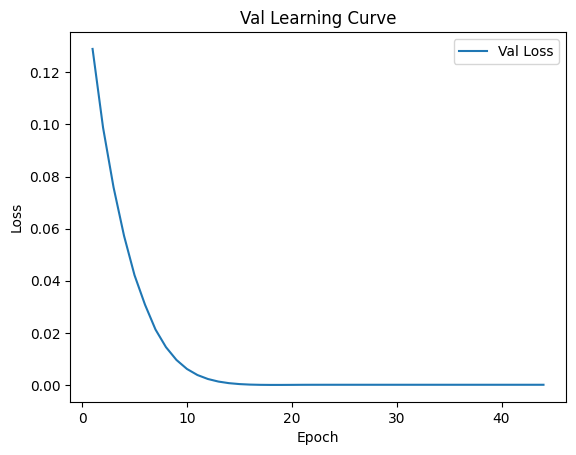


 Epoch: (45/50) Loss = 6.536342698382214e-05

 Epoch: (45/50) Loss_rmse = 0.008084764704108238

 Epoch: (45/50) R^2 = 0.9728428721427917

 Epoch: (45/50) MAE = 0.007681310176849365
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

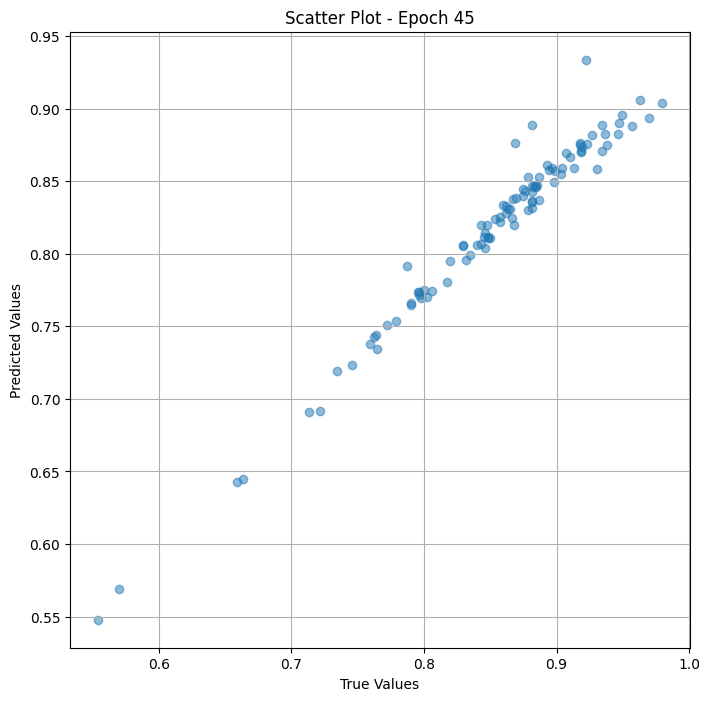

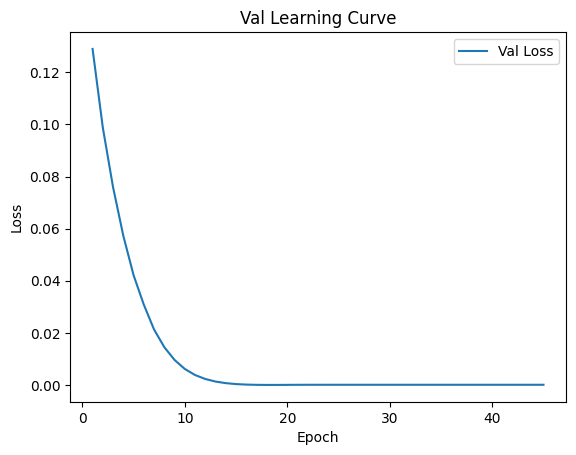


 Epoch: (46/50) Loss = 6.536543514812365e-05

 Epoch: (46/50) Loss_rmse = 0.008084889501333237

 Epoch: (46/50) R^2 = 0.9728420376777649

 Epoch: (46/50) MAE = 0.00768144428730011
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

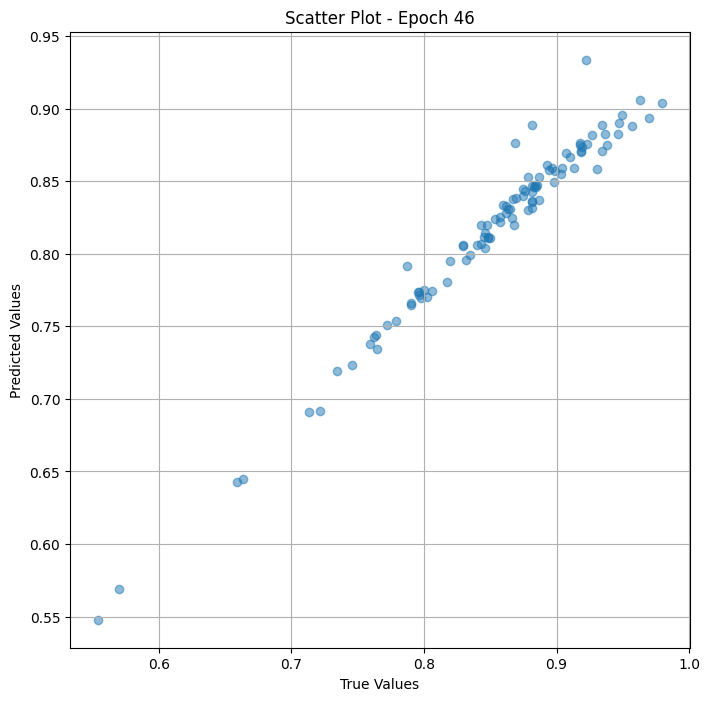

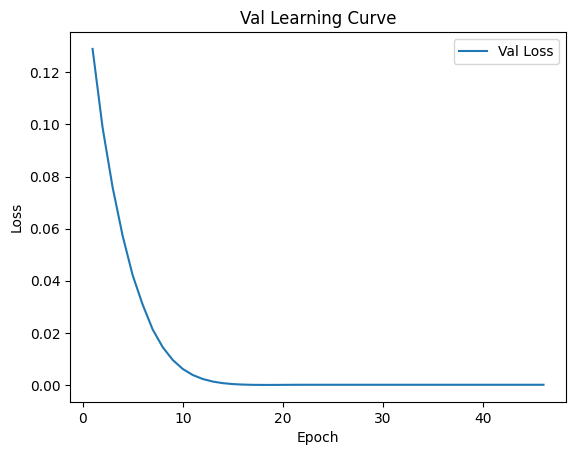


 Epoch: (47/50) Loss = 6.536762521136552e-05

 Epoch: (47/50) Loss_rmse = 0.008085024543106556

 Epoch: (47/50) R^2 = 0.9728411436080933

 Epoch: (47/50) MAE = 0.0076815783977508545
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

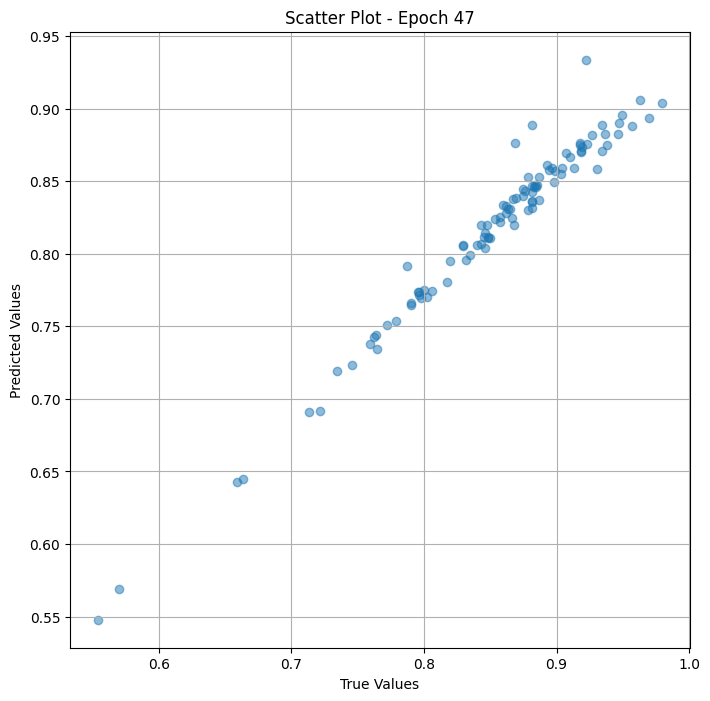

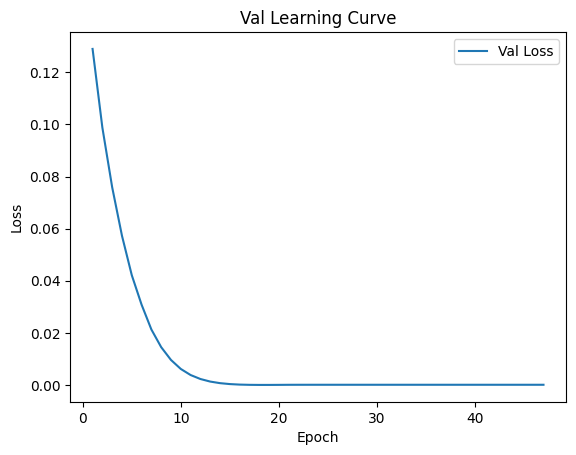


 Epoch: (48/50) Loss = 6.537047738675028e-05

 Epoch: (48/50) Loss_rmse = 0.008085201494395733

 Epoch: (48/50) R^2 = 0.9728399515151978

 Epoch: (48/50) MAE = 0.0076817721128463745
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

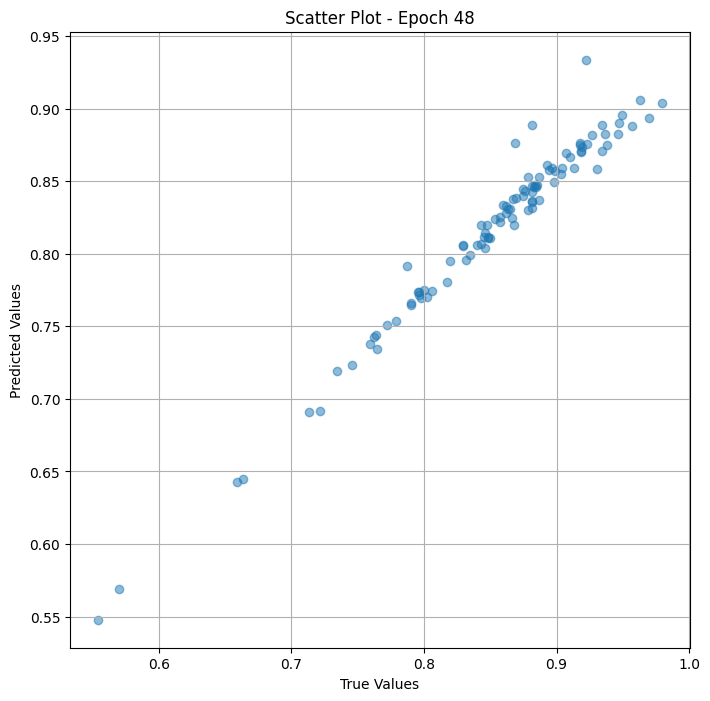

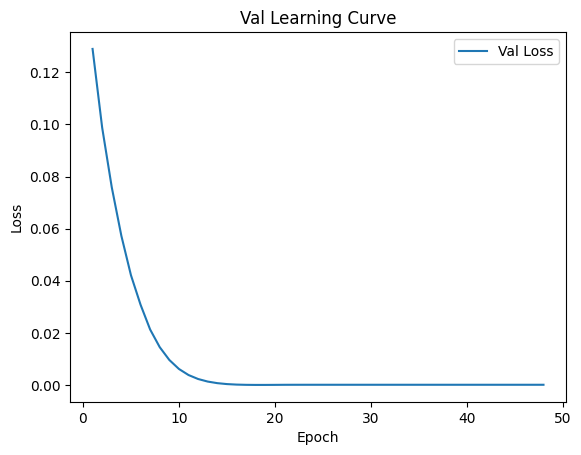


 Epoch: (49/50) Loss = 6.537343870149925e-05

 Epoch: (49/50) Loss_rmse = 0.008085384033620358

 Epoch: (49/50) R^2 = 0.9728386998176575

 Epoch: (49/50) MAE = 0.007681950926780701
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

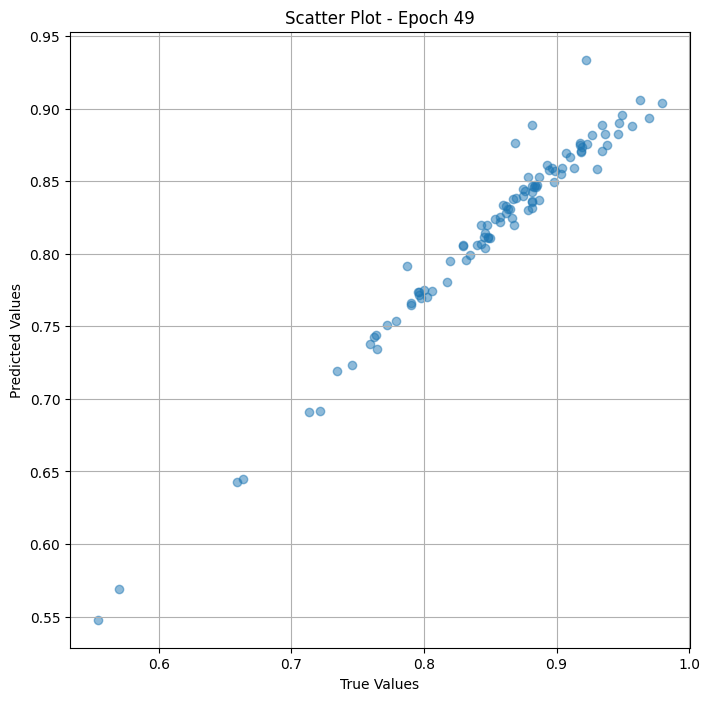

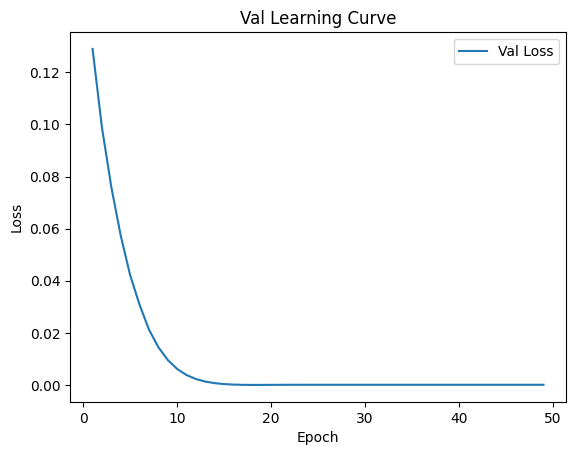


 Epoch: (50/50) Loss = 6.537507579196244e-05

 Epoch: (50/50) Loss_rmse = 0.00808548554778099

 Epoch: (50/50) R^2 = 0.9728380441665649

 Epoch: (50/50) MAE = 0.0076820701360702515
Spearman correlation coefficient: SignificanceResult(statistic=0.9869025263272178, pvalue=2.766550382717314e-76)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

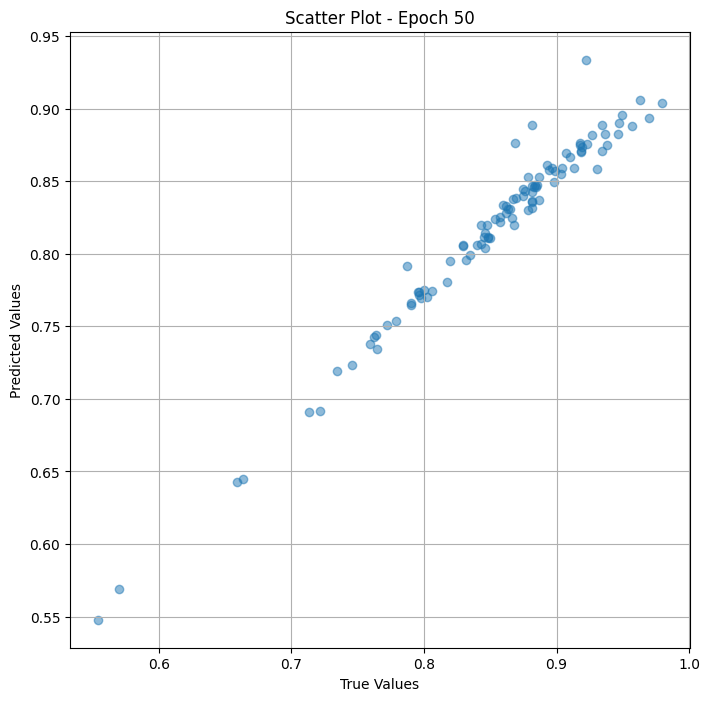

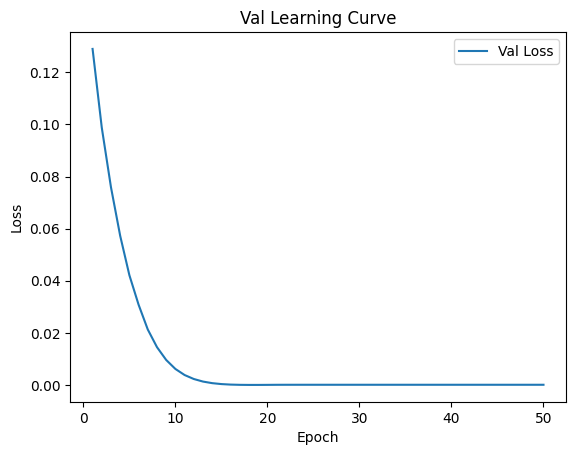

In [ ]:
# val the model and save weights
fit(50, model_res_val , val_dl )
torch.save(model_res_val .state_dict(), "model_weights_s")

In [ ]:
true_values_list_val = []
predicted_values_list_val = []

for x_trans, yb in val_dl:
    preds = model_res_val(x_trans)
    true_values_list_val.extend(yb.cpu().detach().numpy())
    predicted_values_list_val.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_val_food['preprocessed_image_path'],
    'True Value': true_values_list_val,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_val # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                        Image Path  True Value  \
0      /content/food/000000234238_preprocessed.jpg    0.763889   
1    /content/food/n07753592_6754_preprocessed.jpg    0.819277   
2   /content/food/n07849336_25045_preprocessed.jpg    0.859813   
3    /content/food/n07720875_5671_preprocessed.jpg    0.892857   
4    /content/food/n07880968_2787_preprocessed.jpg    0.795699   
..                                             ...         ...   
95  /content/food/n07693725_12175_preprocessed.jpg    0.797980   
96   /content/food/n07711569_2201_preprocessed.jpg    0.787234   
97   /content/food/n07711569_5967_preprocessed.jpg    0.868687   
98  /content/food/n07654148_18263_preprocessed.jpg    0.881720   
99    /content/food/n07711569_865_preprocessed.jpg    0.922330   

    Predicted Value  
0          0.743815  
1          0.794866  
2          0.833902  
3          0.861008  
4          0.773455  
..              ...  
95         0.769610  
96         0.791575  
97       

## Test

In [ ]:
df_test_food.head()


,preprocessed_image_path,memoscore
0,/content/food/000000445557_preprocessed.jpg,0.923729
1,/content/food/000000321324_preprocessed.jpg,0.860465
2,/content/food/n07806221_23145_preprocessed.jpg,0.854545
3,/content/food/n07863374_17253_preprocessed.jpg,0.892157
4,/content/food/n07711569_4665_preprocessed.jpg,0.934579


In [ ]:
class Dataset_test_res_food(Dataset):
    def __init__(self, df, res_transform =None):
        self.labels = df_test_food["memoscore"]
        self.images = df_test_food["preprocessed_image_path"]
        self.res_transform  = res_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
test_ds = Dataset_test_res_food(df_test_food, res_transform =res_transform )
test_dl = DataLoader(test_ds, batch_size=32, shuffle=False)

In [ ]:
print(test_ds)

In [ ]:
class Resnet_model_test_res_food(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)

    def forward(self, x):
        resfeat = self.res(x)
        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_test = Resnet_model_test_res_food( arch="resnet50.a1_in1k")

In [ ]:


# Assuming your model is an instance of YourModelClass and is already on GPU
model = Resnet_model_test_res_food().cuda()

# Assuming your input tensor shape
input_tensor_shape = ( 3   ,224,224)

# Print the model summary
summary(model, input_tensor_shape)


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]           4,096
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
         Identity-10           [-1, 64, 56, 56]               0
             ReLU-11           [-1, 64, 56, 56]               0
         Identity-12           [-1, 64, 56, 56]               0
           Conv2d-13          [-1, 256, 56, 56]          16,384
      BatchNorm2d-14          [-1, 256,

In [ ]:
device = get_default_device()
test_dl = DeviceDataLoader(test_dl, device)
model_res_test  = to_device(model_res_test  , device)

In [ ]:
params = [param for param in list(model_res_test.parameters()) if param.requires_grad ]
optimizer = torch.optim.Adam(params, lr=1e-4)   #,weight_decay=1e-7

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)




/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.13566380739212036

 Epoch: (1/50) Loss_rmse = 0.36832568049430847

 Epoch: (1/50) R^2 = -55.95100021362305

 Epoch: (1/50) MAE = 0.3647899925708771
Spearman correlation coefficient: SignificanceResult(statistic=0.14622516738988864, pvalue=0.15514414954021727)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606, 0.930

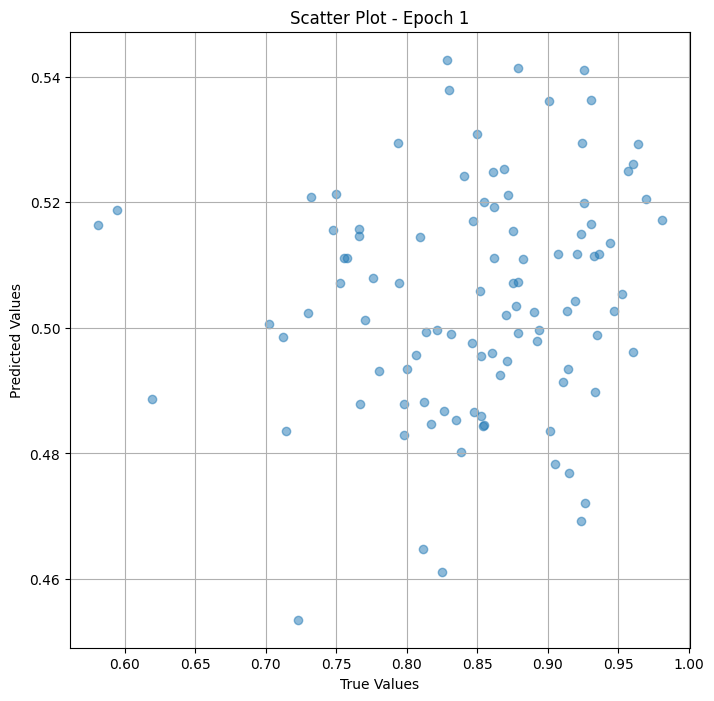

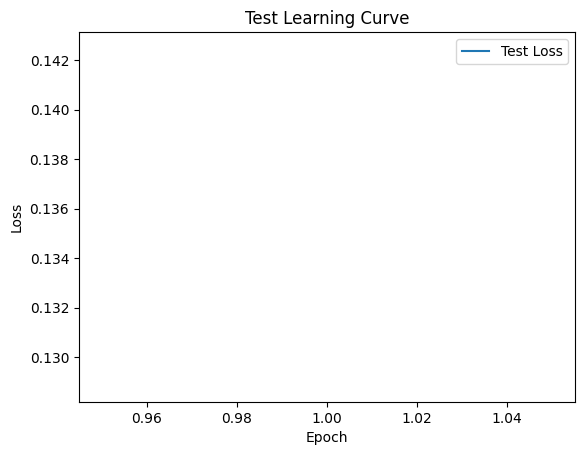


 Epoch: (2/50) Loss = 0.09136287122964859

 Epoch: (2/50) Loss_rmse = 0.30226293206214905

 Epoch: (2/50) R^2 = -37.35368728637695

 Epoch: (2/50) MAE = 0.2987474799156189
Spearman correlation coefficient: SignificanceResult(statistic=0.10172480451382483, pvalue=0.32403479030462556)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606, 0.930

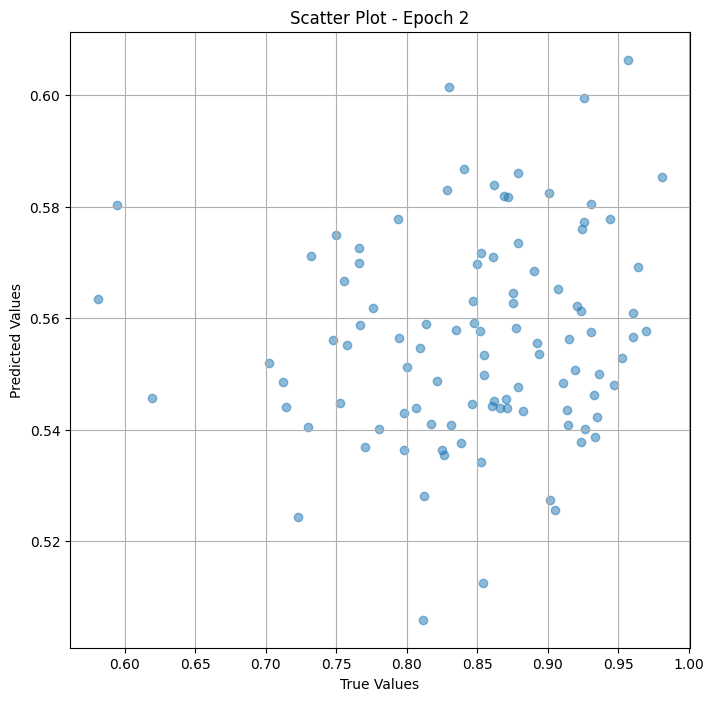

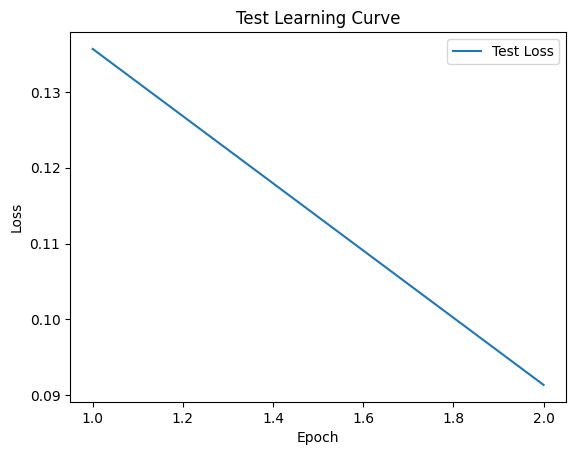


 Epoch: (3/50) Loss = 0.049622077494859695

 Epoch: (3/50) Loss_rmse = 0.2227601408958435

 Epoch: (3/50) R^2 = -19.831104278564453

 Epoch: (3/50) MAE = 0.2192728966474533
Spearman correlation coefficient: SignificanceResult(statistic=0.02991786322912931, pvalue=0.772306772628616)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606, 0.9306

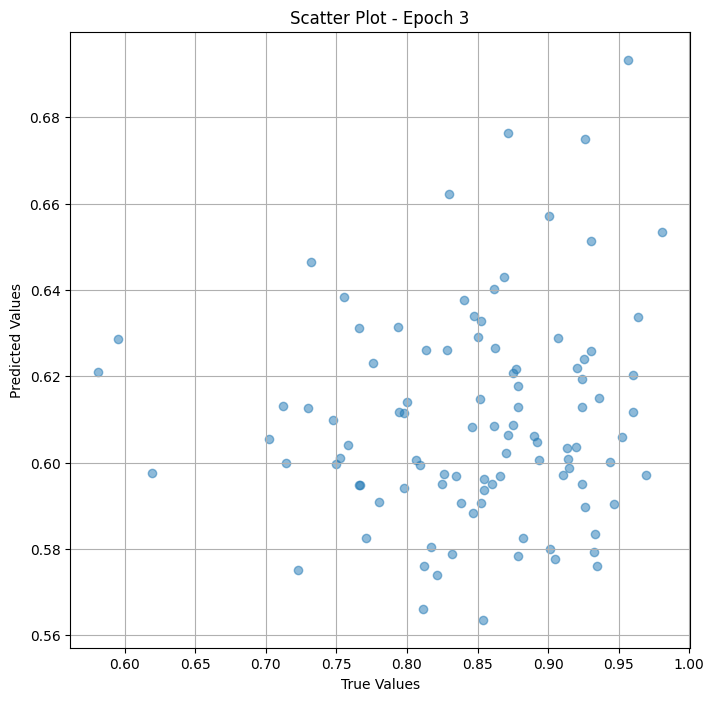

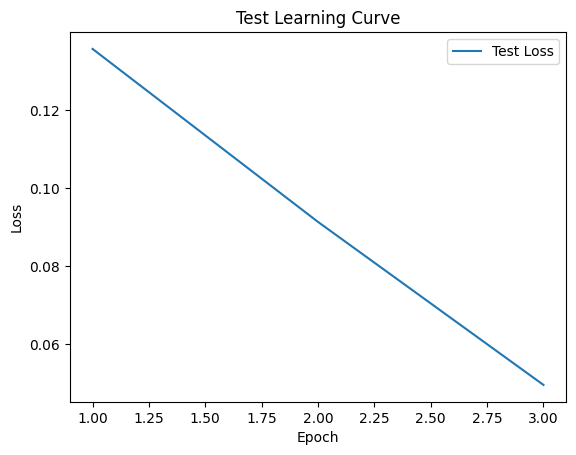


 Epoch: (4/50) Loss = 0.018068913370370865

 Epoch: (4/50) Loss_rmse = 0.13442066311836243

 Epoch: (4/50) R^2 = -6.585241317749023

 Epoch: (4/50) MAE = 0.12945674359798431
Spearman correlation coefficient: SignificanceResult(statistic=-0.009783873058620997, pvalue=0.9246258041090608)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606, 0.

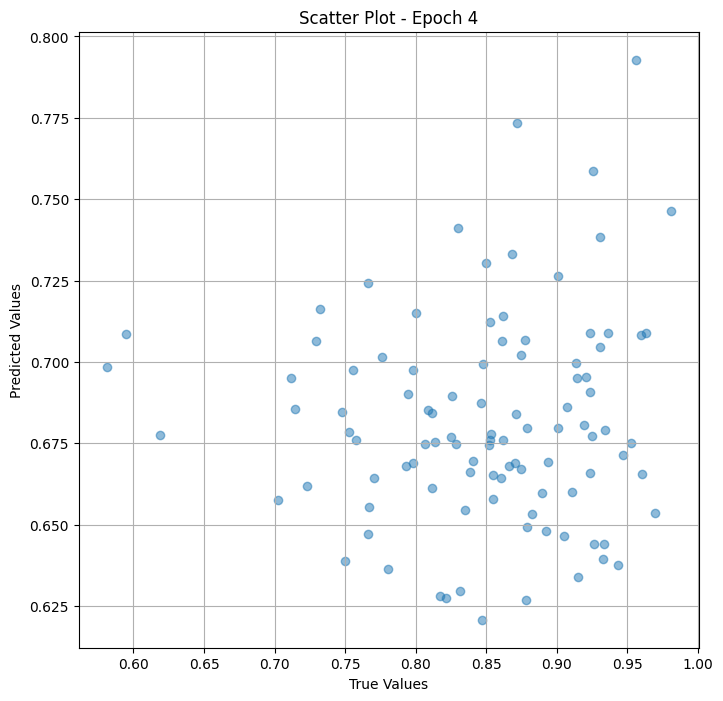

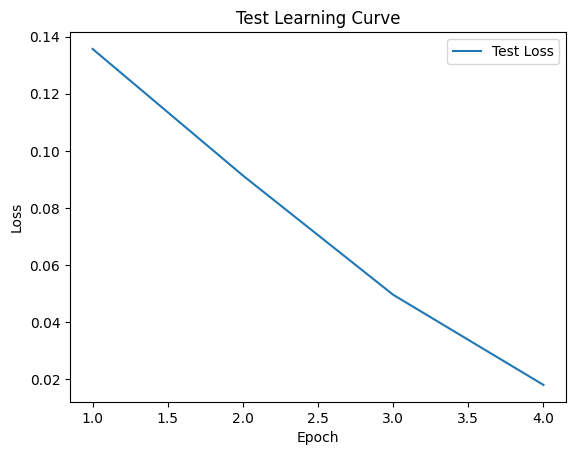


 Epoch: (5/50) Loss = 0.003280554199591279

 Epoch: (5/50) Loss_rmse = 0.05727612227201462

 Epoch: (5/50) R^2 = -0.37716054916381836

 Epoch: (5/50) MAE = 0.047577306628227234
Spearman correlation coefficient: SignificanceResult(statistic=-0.006490907982379675, pvalue=0.9499534748166341)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606,

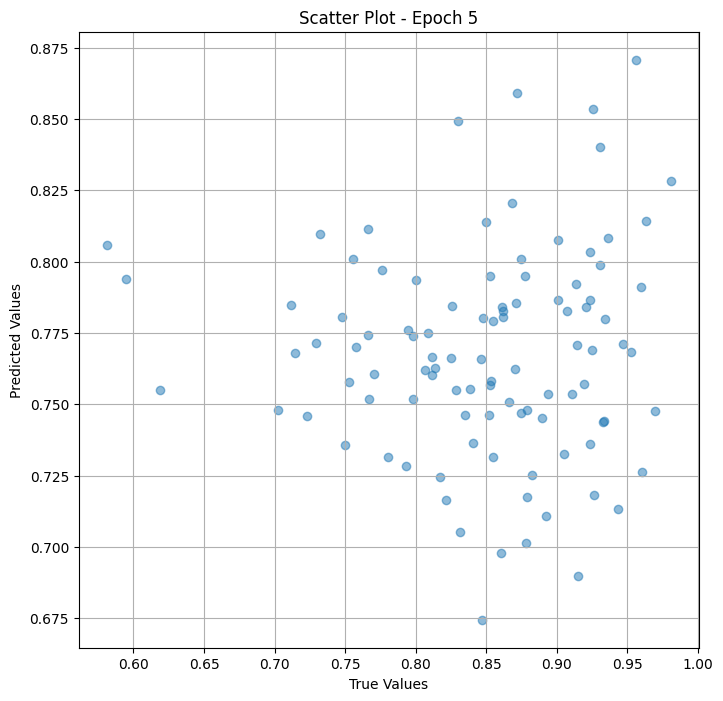

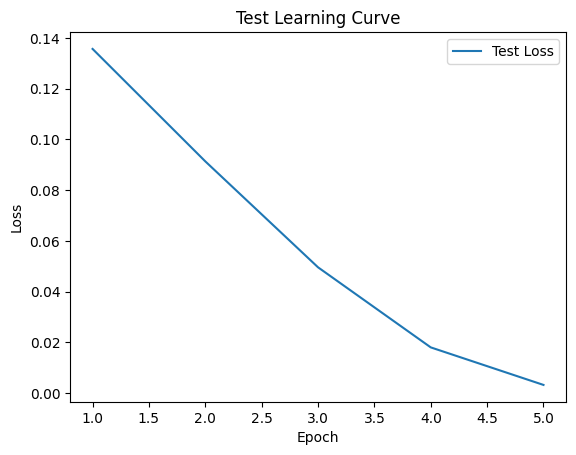


 Epoch: (6/50) Loss = 0.0014706198126077652

 Epoch: (6/50) Loss_rmse = 0.03834865987300873

 Epoch: (6/50) R^2 = 0.3826410174369812

 Epoch: (6/50) MAE = 0.03561130166053772
Spearman correlation coefficient: SignificanceResult(statistic=0.09850987203352395, pvalue=0.33963981251781794)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606, 0.

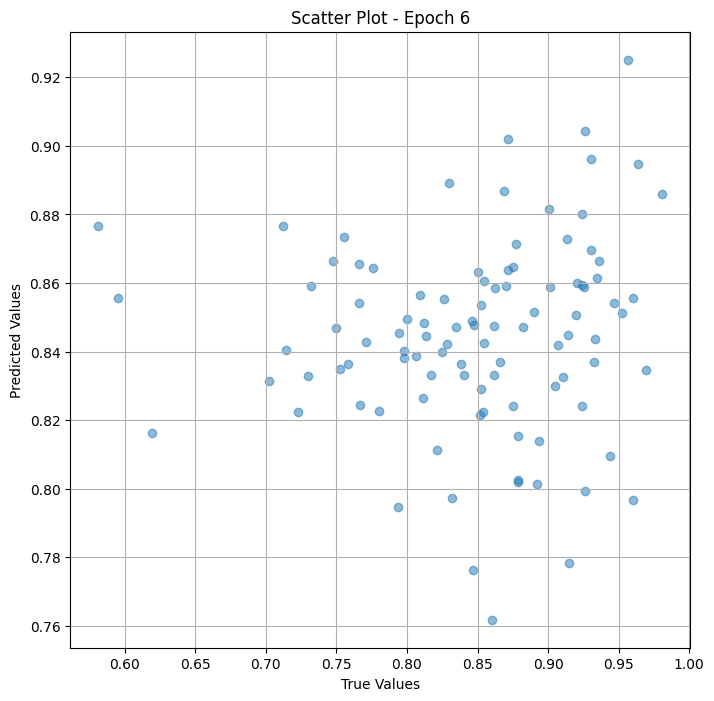

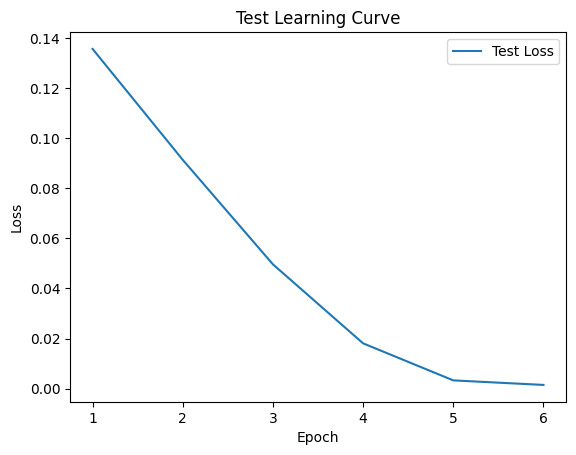


 Epoch: (7/50) Loss = 0.000659335230011493

 Epoch: (7/50) Loss_rmse = 0.025677524507045746

 Epoch: (7/50) R^2 = 0.7232142686843872

 Epoch: (7/50) MAE = 0.021958976984024048
Spearman correlation coefficient: SignificanceResult(statistic=0.2864545535295958, pvalue=0.004662755733039399)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606, 0

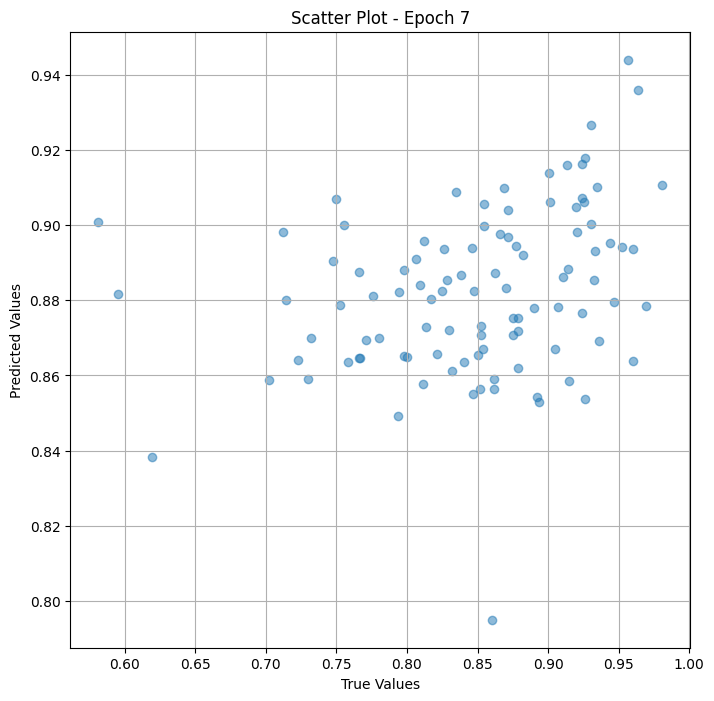

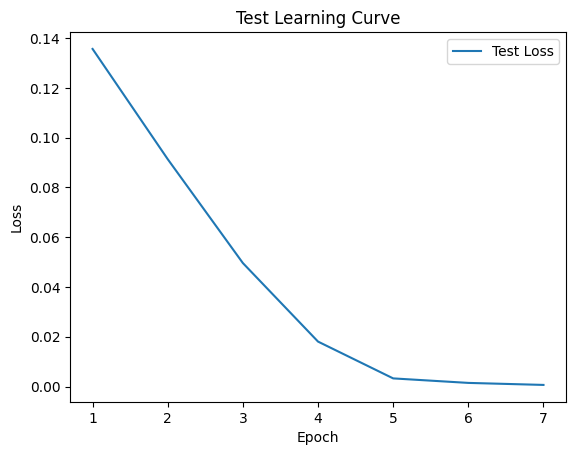


 Epoch: (8/50) Loss = 0.0007388817612081766

 Epoch: (8/50) Loss_rmse = 0.027182379737496376

 Epoch: (8/50) R^2 = 0.6898210644721985

 Epoch: (8/50) MAE = 0.023769065737724304
Spearman correlation coefficient: SignificanceResult(statistic=0.397708851998743, pvalue=6.007481557740164e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606, 

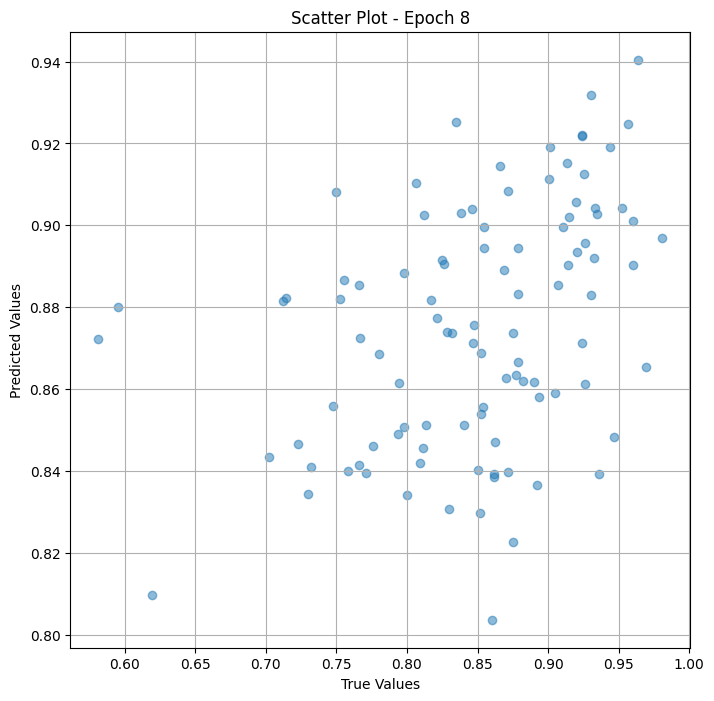

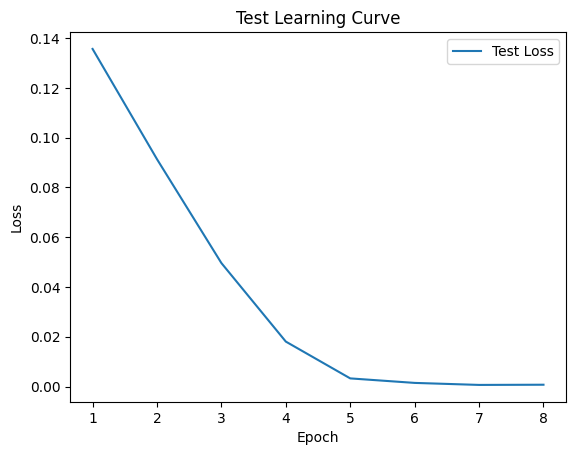


 Epoch: (9/50) Loss = 0.0016346012707799673

 Epoch: (9/50) Loss_rmse = 0.04043020308017731

 Epoch: (9/50) R^2 = 0.31380242109298706

 Epoch: (9/50) MAE = 0.03864029049873352
Spearman correlation coefficient: SignificanceResult(statistic=0.4308280825922226, pvalue=1.1775079446021219e-05)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606,

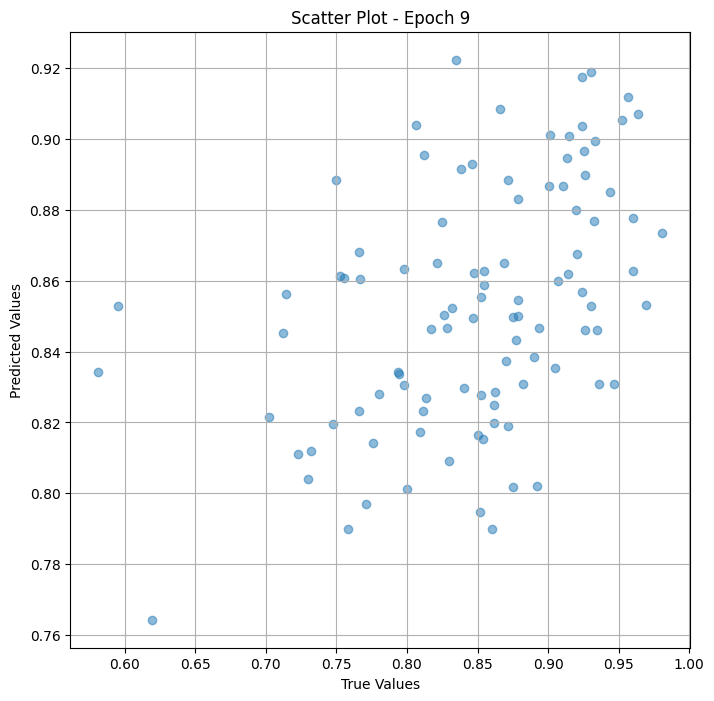

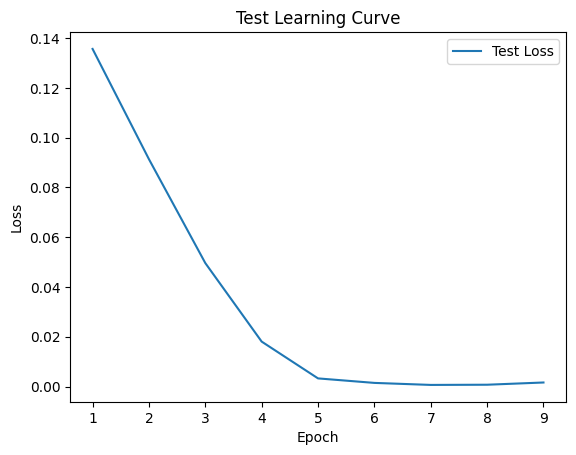


 Epoch: (10/50) Loss = 0.0003106276853941381

 Epoch: (10/50) Loss_rmse = 0.017624633386731148

 Epoch: (10/50) R^2 = 0.8696000576019287

 Epoch: (10/50) MAE = 0.01496724784374237
Spearman correlation coefficient: SignificanceResult(statistic=0.5475966006953036, pvalue=7.75162146783767e-09)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8478260

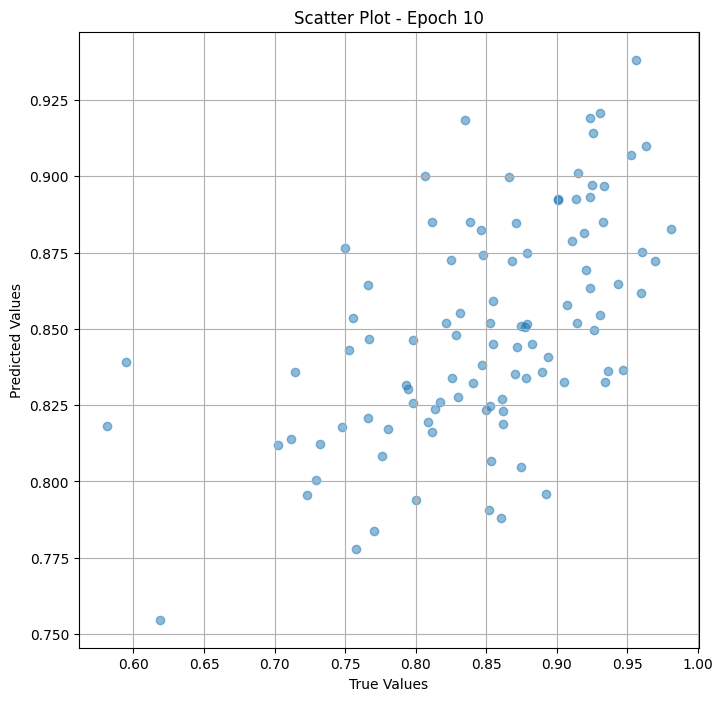

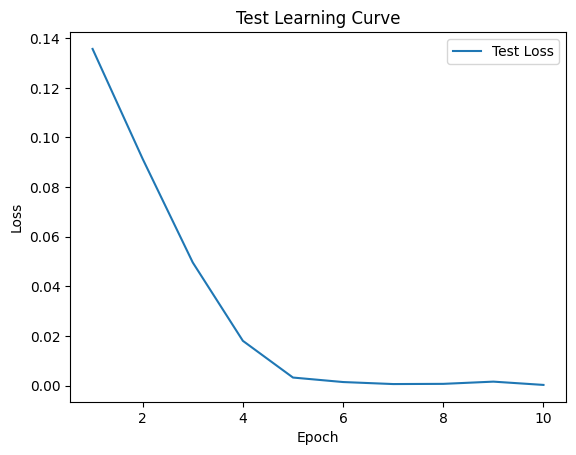


 Epoch: (11/50) Loss = 1.4654875485575758e-05

 Epoch: (11/50) Loss_rmse = 0.0038281686138361692

 Epoch: (11/50) R^2 = 0.9938479661941528

 Epoch: (11/50) MAE = 0.0036527514457702637
Spearman correlation coefficient: SignificanceResult(statistic=0.66671866641582, pvalue=1.2146164314717954e-13)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

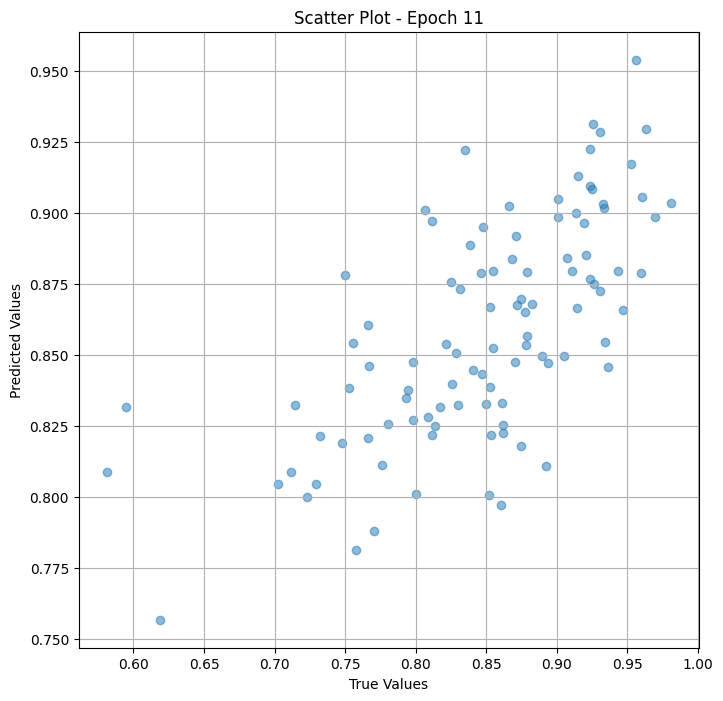

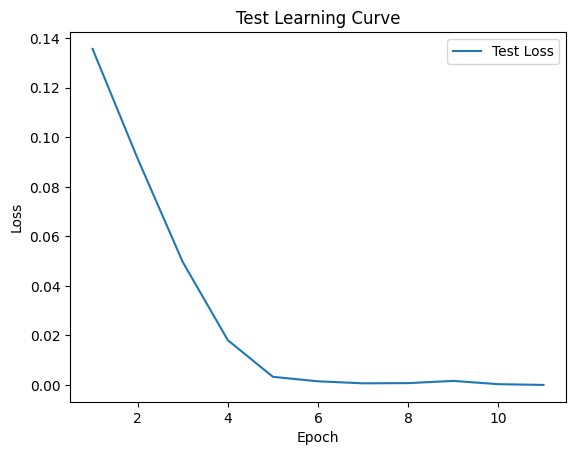


 Epoch: (12/50) Loss = 1.2016648724966217e-05

 Epoch: (12/50) Loss_rmse = 0.0034665039274841547

 Epoch: (12/50) R^2 = 0.9949554800987244

 Epoch: (12/50) MAE = 0.00298193097114563
Spearman correlation coefficient: SignificanceResult(statistic=0.7582153735028647, pvalue=3.72116999259293e-19)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782

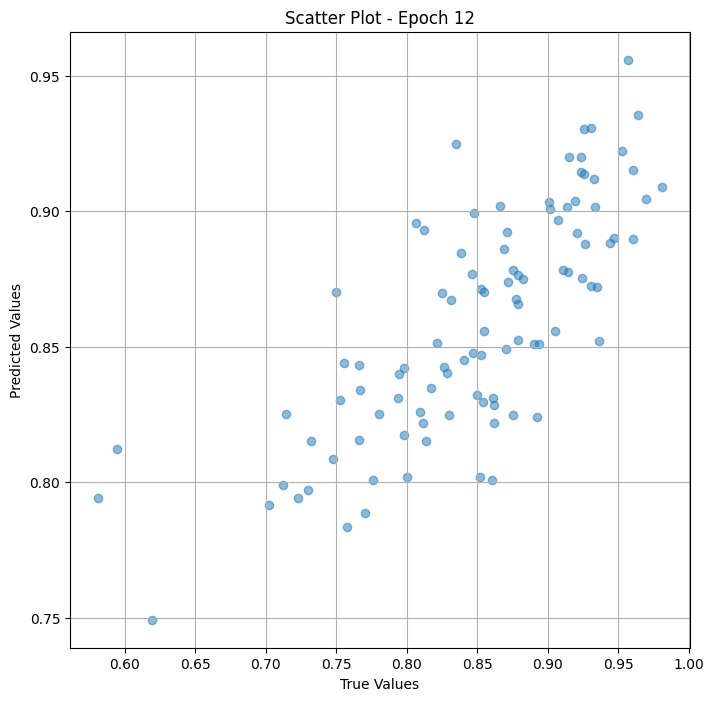

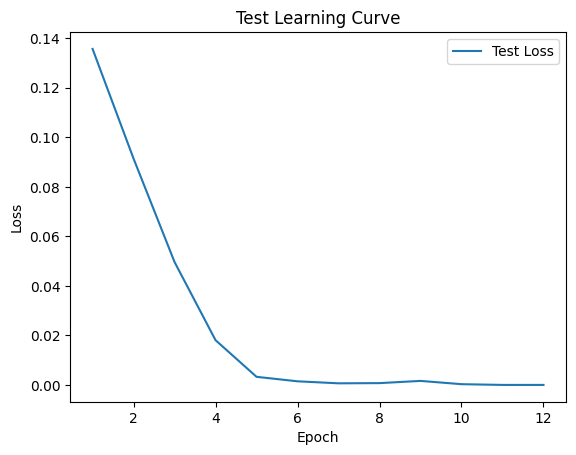


 Epoch: (13/50) Loss = 1.3493760889105033e-05

 Epoch: (13/50) Loss_rmse = 0.0036733855959028006

 Epoch: (13/50) R^2 = 0.994335412979126

 Epoch: (13/50) MAE = 0.0027951300144195557
Spearman correlation coefficient: SignificanceResult(statistic=0.8118925373195344, pvalue=1.0757741599487029e-23)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

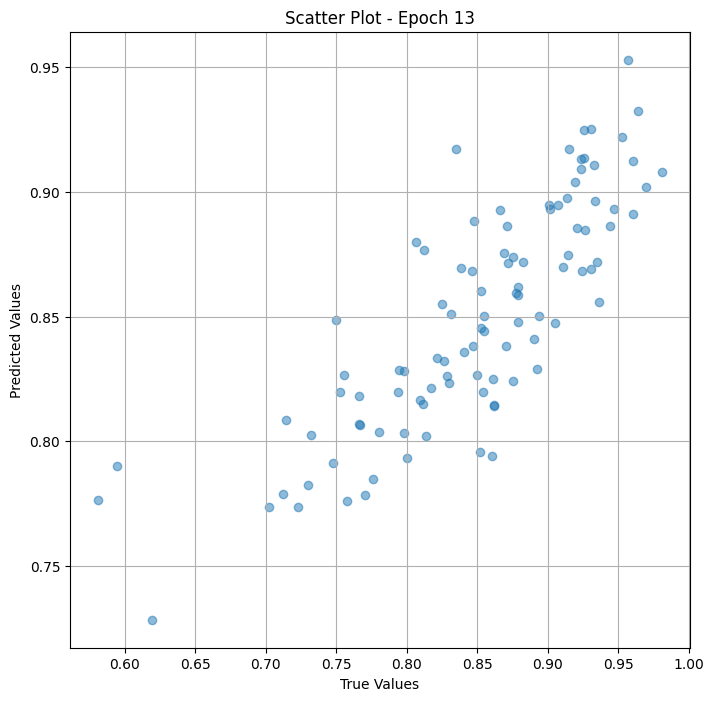

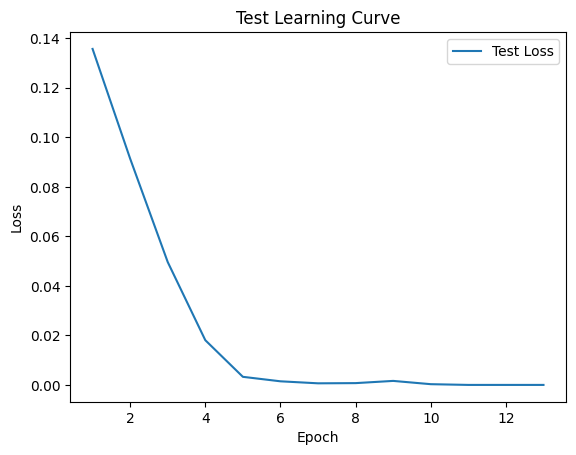


 Epoch: (14/50) Loss = 9.769385542313103e-06

 Epoch: (14/50) Loss_rmse = 0.0031256016809493303

 Epoch: (14/50) R^2 = 0.9958988428115845

 Epoch: (14/50) MAE = 0.0023154765367507935
Spearman correlation coefficient: SignificanceResult(statistic=0.8673535138837126, pvalue=3.082446153116202e-30)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

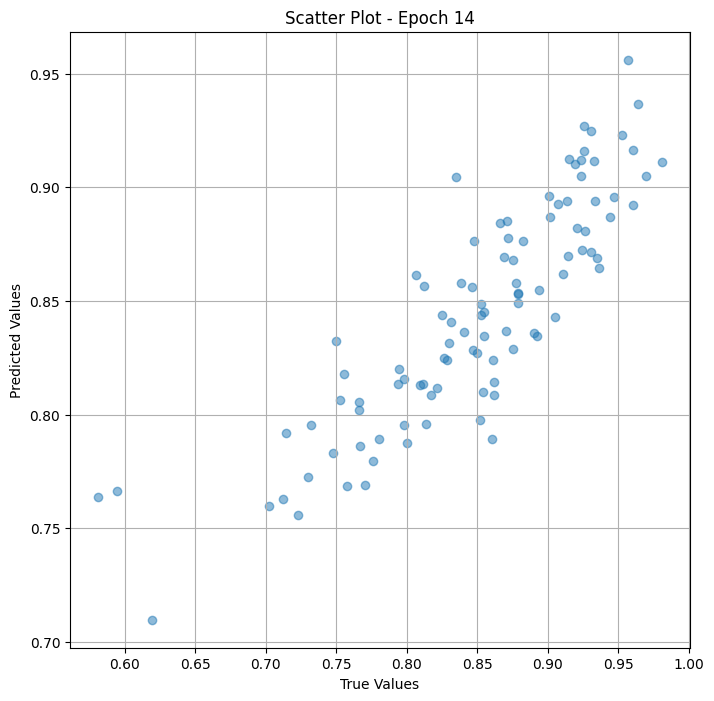

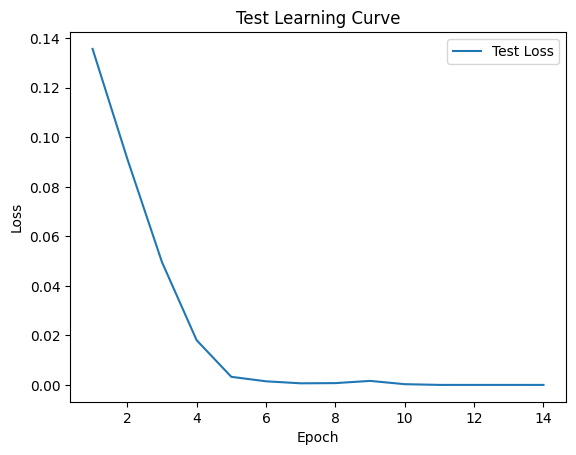


 Epoch: (15/50) Loss = 5.2200935897417367e-05

 Epoch: (15/50) Loss_rmse = 0.007225021719932556

 Epoch: (15/50) R^2 = 0.9780862927436829

 Epoch: (15/50) MAE = 0.006694704294204712
Spearman correlation coefficient: SignificanceResult(statistic=0.9017682130504779, pvalue=5.1801872174709846e-36)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

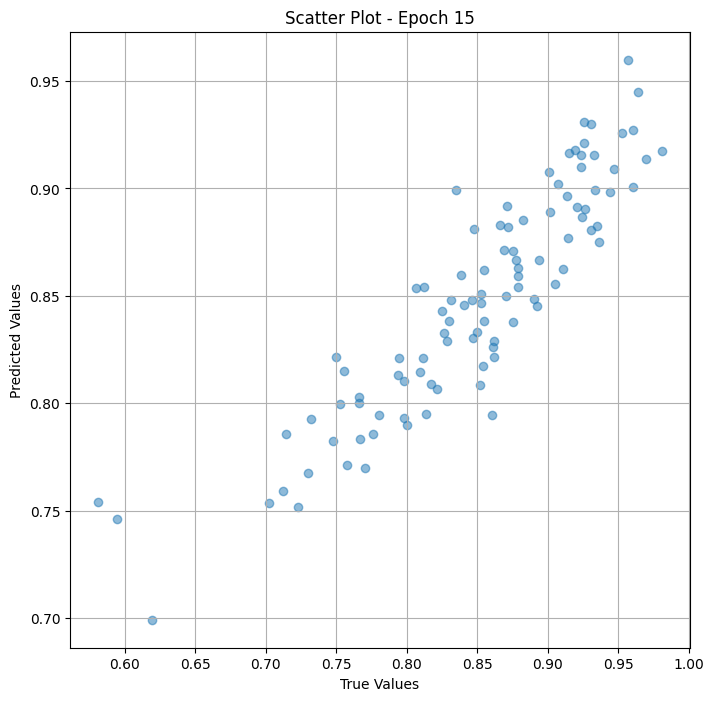

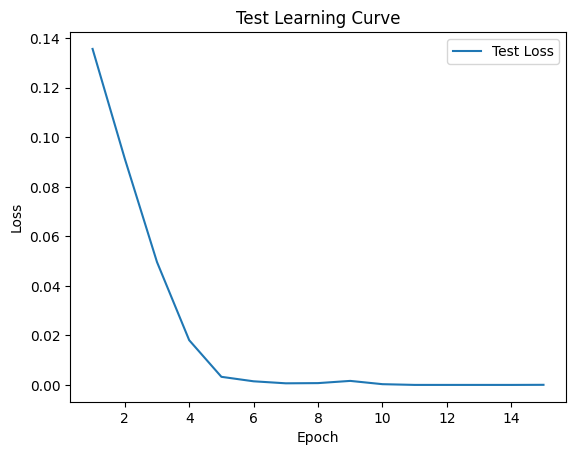


 Epoch: (16/50) Loss = 6.1794471548637375e-06

 Epoch: (16/50) Loss_rmse = 0.002485849428921938

 Epoch: (16/50) R^2 = 0.9974058866500854

 Epoch: (16/50) MAE = 0.0022369176149368286
Spearman correlation coefficient: SignificanceResult(statistic=0.9272909787116009, pvalue=6.814648560429844e-42)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

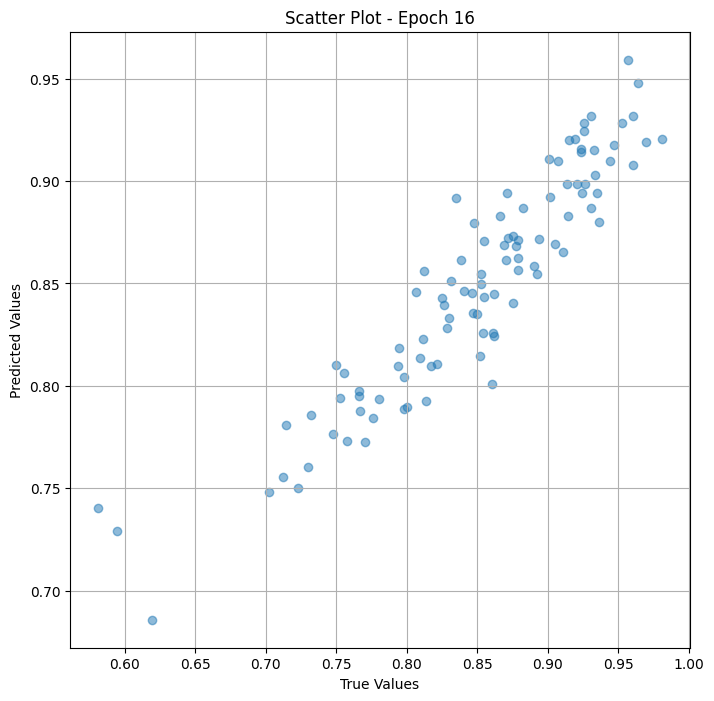

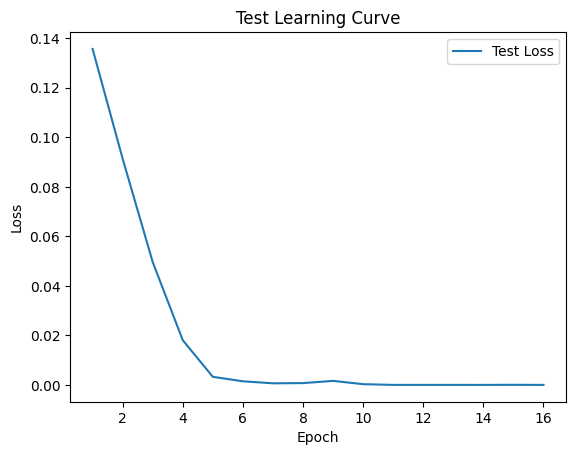


 Epoch: (17/50) Loss = 1.203995543619385e-05

 Epoch: (17/50) Loss_rmse = 0.0034698639065027237

 Epoch: (17/50) R^2 = 0.9949457049369812

 Epoch: (17/50) MAE = 0.002331659197807312
Spearman correlation coefficient: SignificanceResult(statistic=0.9463296189483196, pvalue=6.735236654492611e-48)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8478

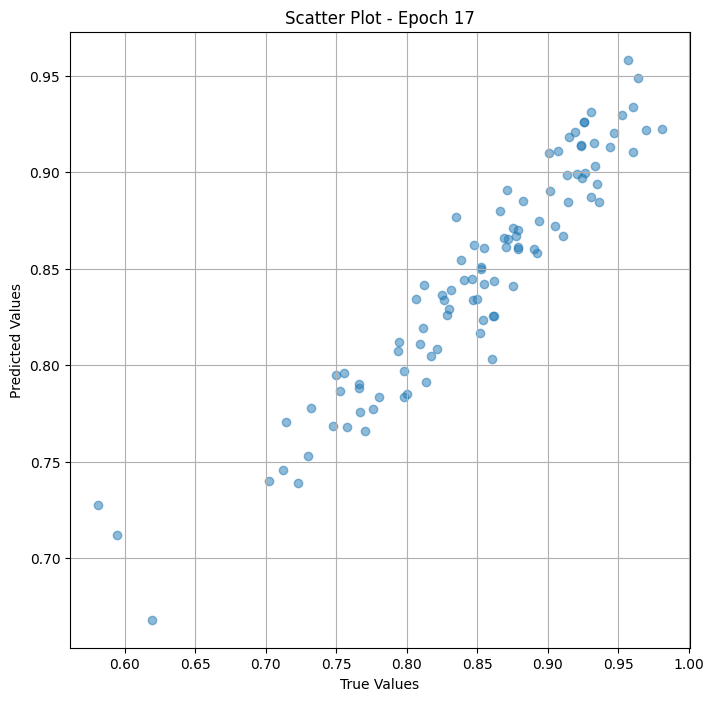

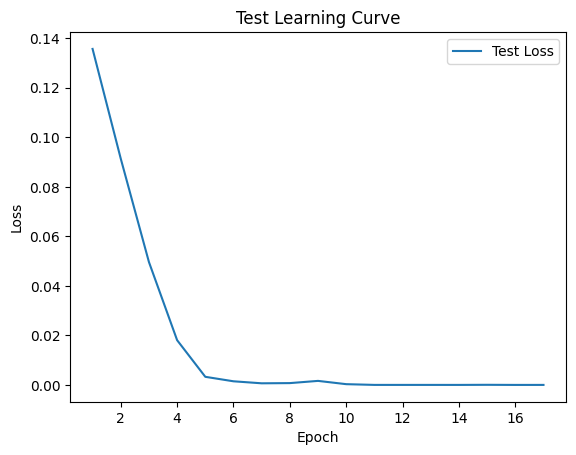


 Epoch: (18/50) Loss = 4.167546649114229e-06

 Epoch: (18/50) Loss_rmse = 0.002041456988081336

 Epoch: (18/50) R^2 = 0.9982504844665527

 Epoch: (18/50) MAE = 0.0015742629766464233
Spearman correlation coefficient: SignificanceResult(statistic=0.960484817442809, pvalue=5.252219925872862e-54)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782

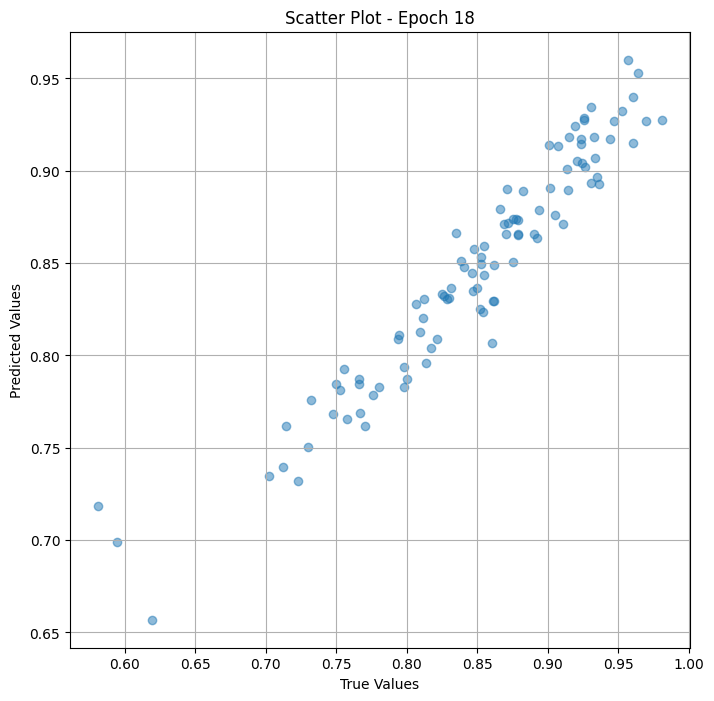

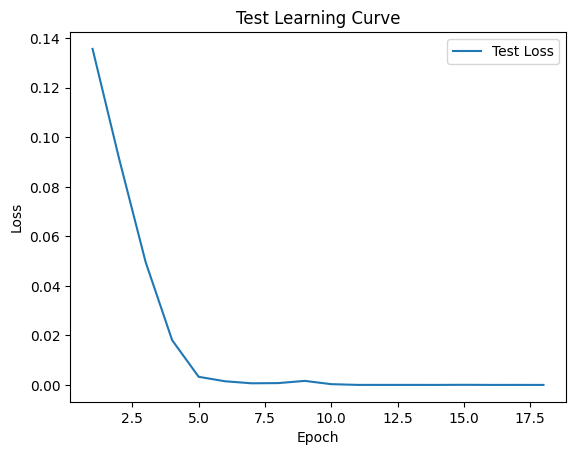


 Epoch: (19/50) Loss = 5.684575171471806e-06

 Epoch: (19/50) Loss_rmse = 0.0023842346854507923

 Epoch: (19/50) R^2 = 0.9976136684417725

 Epoch: (19/50) MAE = 0.0020637959241867065
Spearman correlation coefficient: SignificanceResult(statistic=0.9698650951226744, pvalue=1.9143498510641484e-59)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

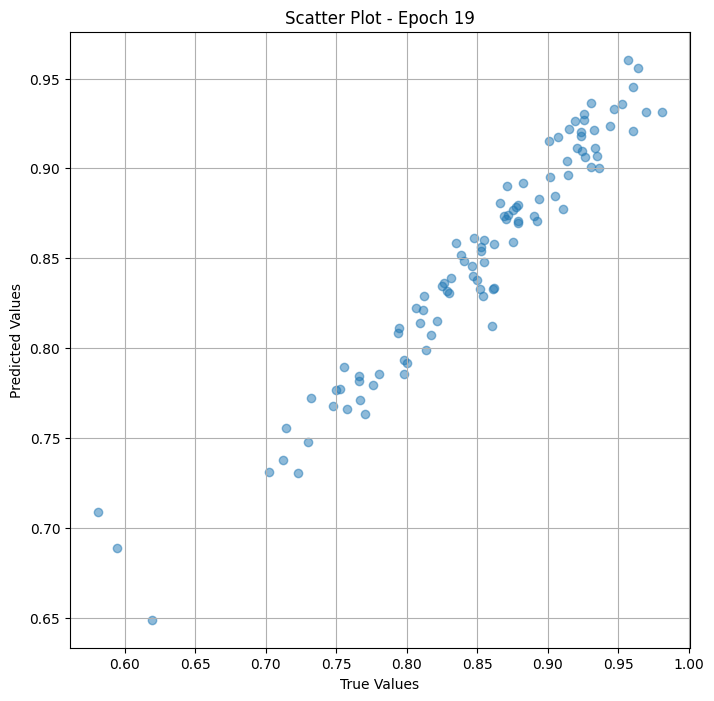

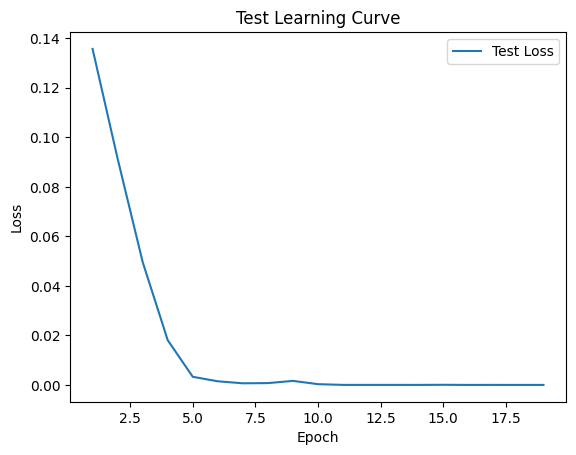


 Epoch: (20/50) Loss = 3.257930529798614e-06

 Epoch: (20/50) Loss_rmse = 0.0018049738137051463

 Epoch: (20/50) R^2 = 0.9986323118209839

 Epoch: (20/50) MAE = 0.001693233847618103
Spearman correlation coefficient: SignificanceResult(statistic=0.9764238286848071, pvalue=2.1725502942026252e-64)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

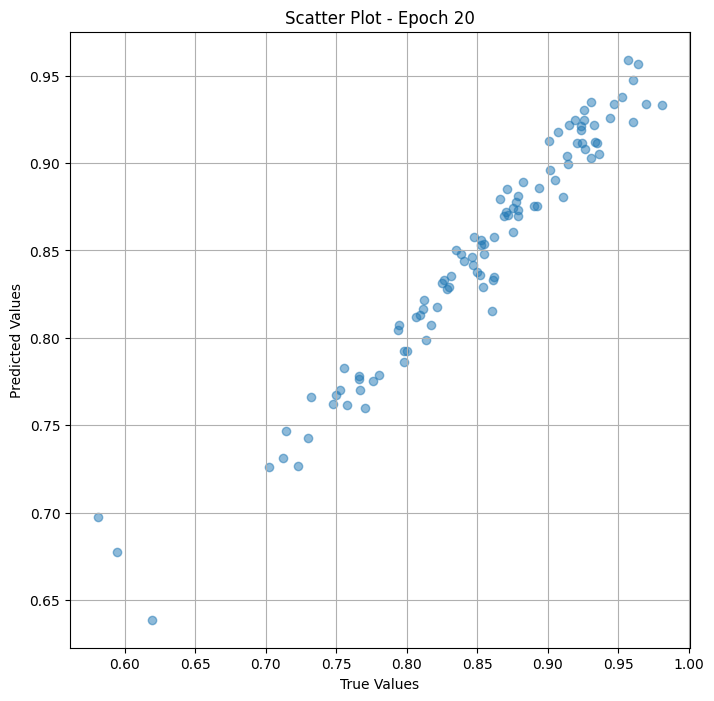

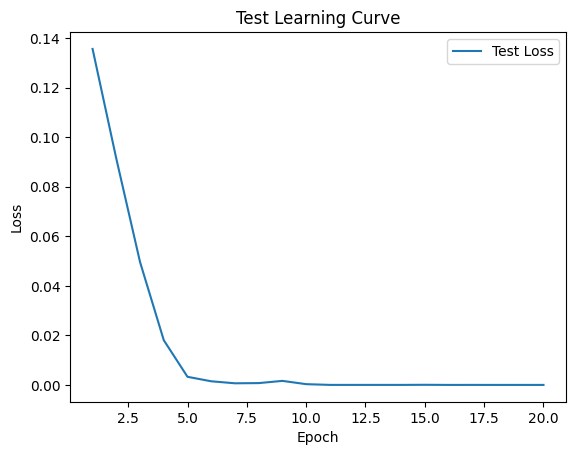


 Epoch: (21/50) Loss = 2.6523932774580317e-06

 Epoch: (21/50) Loss_rmse = 0.0016286169411614537

 Epoch: (21/50) R^2 = 0.9988865256309509

 Epoch: (21/50) MAE = 0.0012051910161972046
Spearman correlation coefficient: SignificanceResult(statistic=0.982087264594198, pvalue=6.099366268177264e-70)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

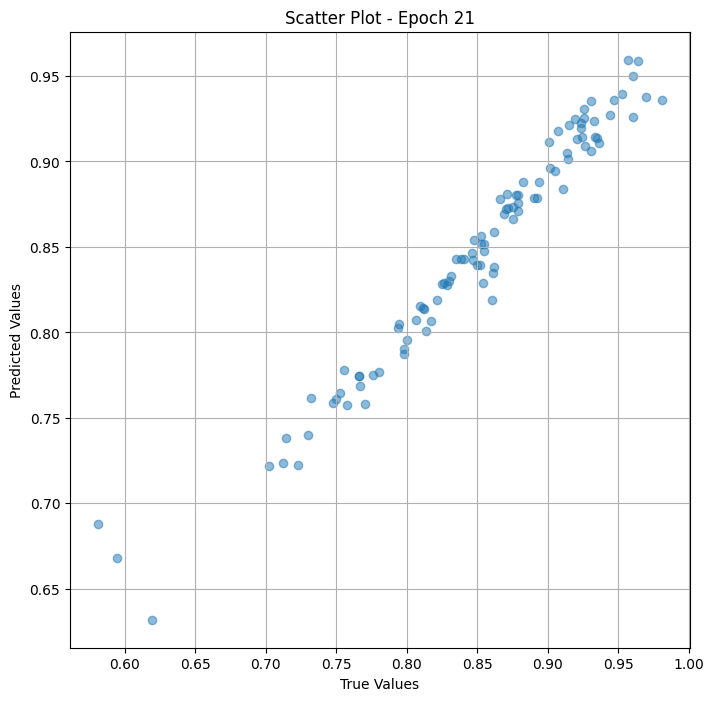

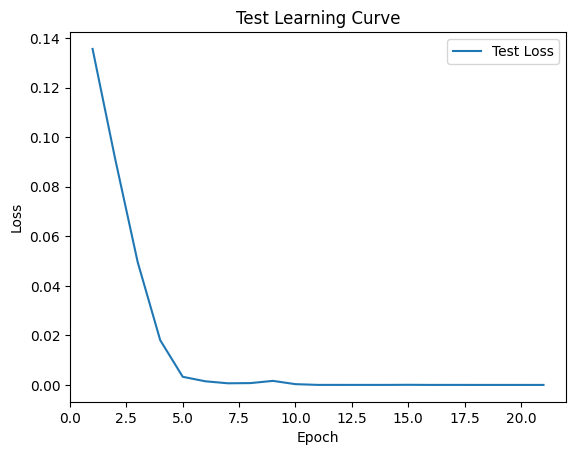


 Epoch: (22/50) Loss = 4.30463887823862e-06

 Epoch: (22/50) Loss_rmse = 0.0020747624803334475

 Epoch: (22/50) R^2 = 0.9981929063796997

 Epoch: (22/50) MAE = 0.0018115043640136719
Spearman correlation coefficient: SignificanceResult(statistic=0.98543106567603, pvalue=3.987882404129448e-74)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847826

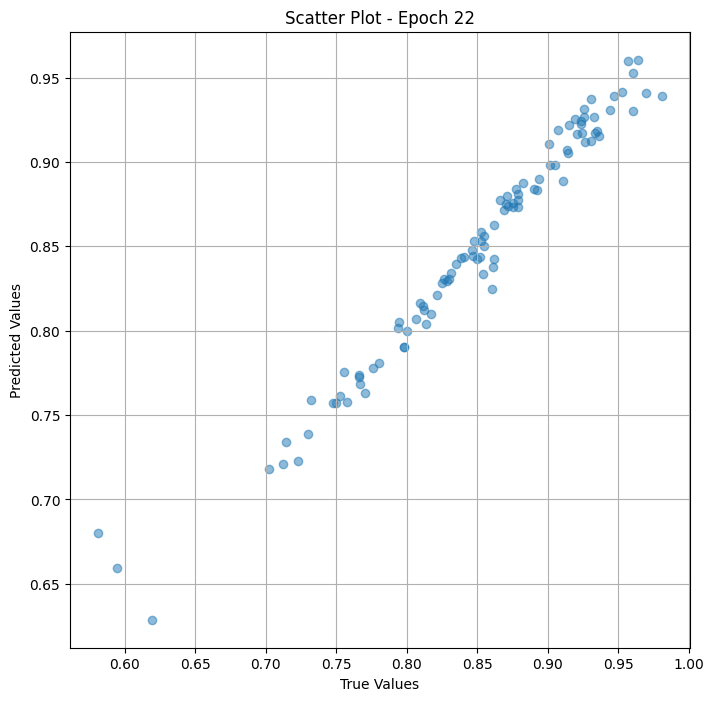

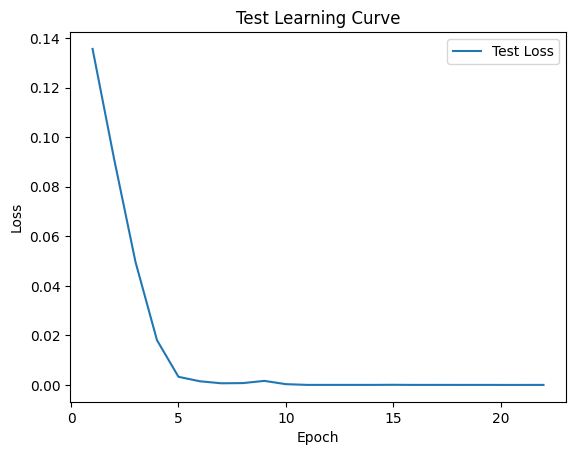


 Epoch: (23/50) Loss = 2.5061508495127782e-06

 Epoch: (23/50) Loss_rmse = 0.0015830827178433537

 Epoch: (23/50) R^2 = 0.9989479184150696

 Epoch: (23/50) MAE = 0.001250624656677246
Spearman correlation coefficient: SignificanceResult(statistic=0.9894056446495666, pvalue=1.3716705711464573e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

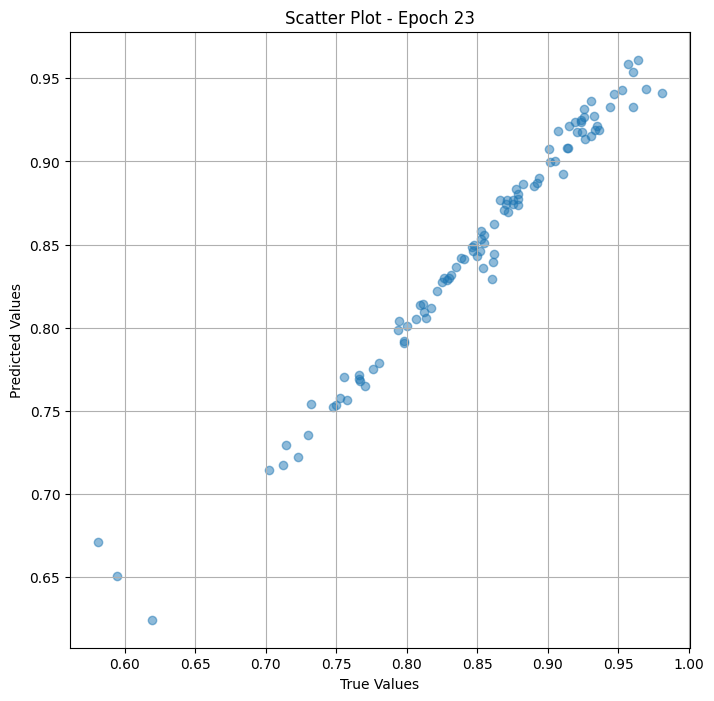

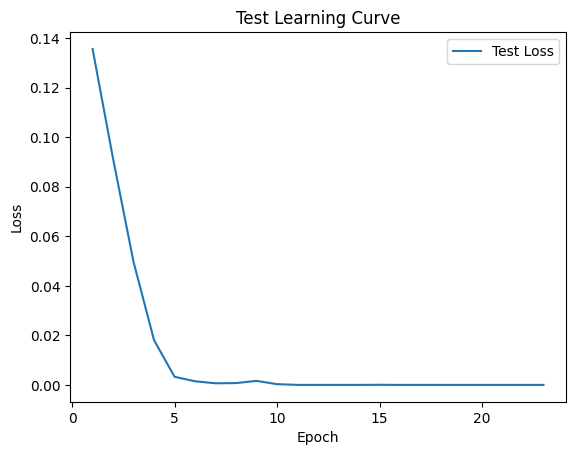


 Epoch: (24/50) Loss = 1.7728893908497412e-06

 Epoch: (24/50) Loss_rmse = 0.0013314989628270268

 Epoch: (24/50) R^2 = 0.9992557764053345

 Epoch: (24/50) MAE = 0.001041114330291748
Spearman correlation coefficient: SignificanceResult(statistic=0.9919355387743604, pvalue=3.914207423125188e-86)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

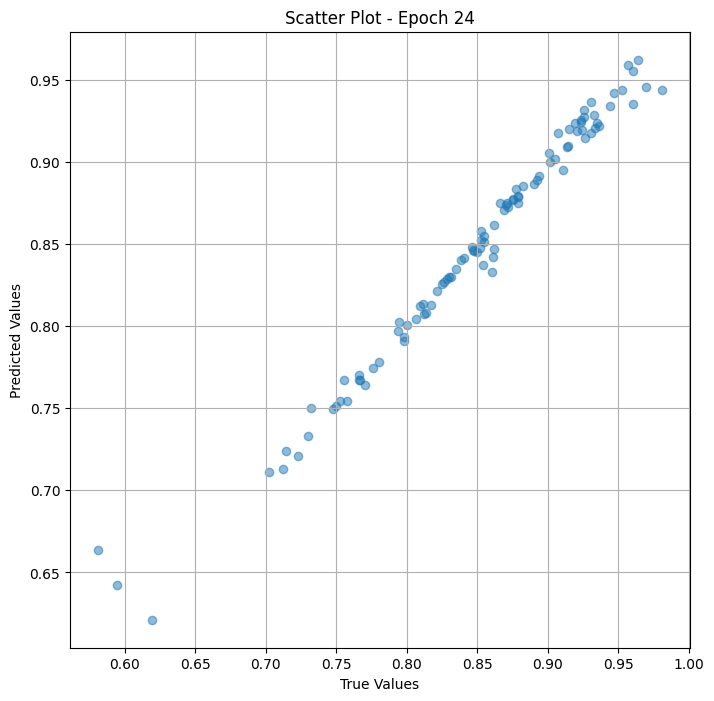

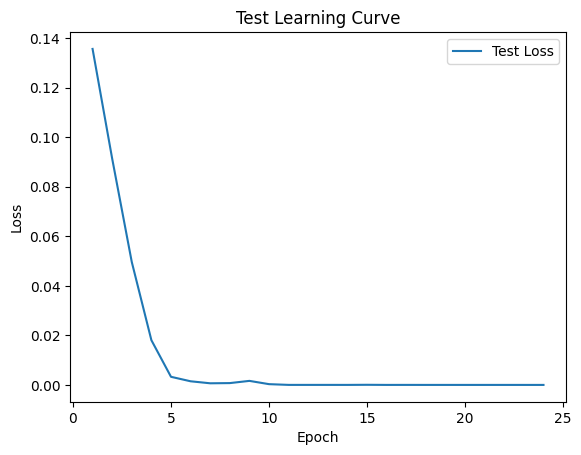


 Epoch: (25/50) Loss = 1.8028755448540323e-06

 Epoch: (25/50) Loss_rmse = 0.0013427119702100754

 Epoch: (25/50) R^2 = 0.9992431402206421

 Epoch: (25/50) MAE = 0.00117570161819458
Spearman correlation coefficient: SignificanceResult(statistic=0.9938685677973261, pvalue=1.0422782899647983e-91)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

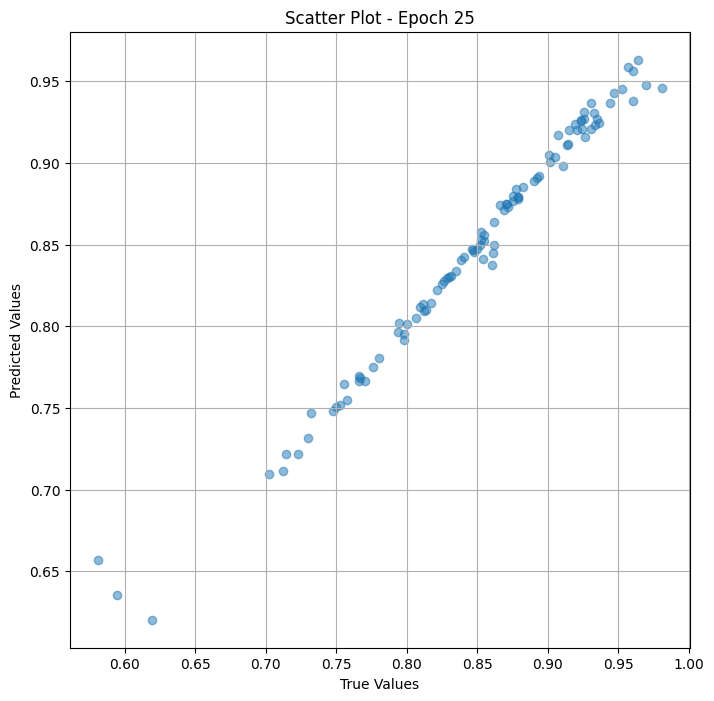

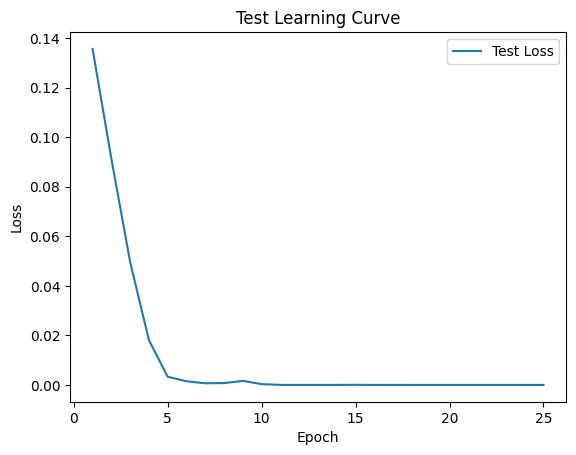


 Epoch: (26/50) Loss = 1.0035182640422136e-06

 Epoch: (26/50) Loss_rmse = 0.0010017575696110725

 Epoch: (26/50) R^2 = 0.9995787143707275

 Epoch: (26/50) MAE = 0.0007405579090118408
Spearman correlation coefficient: SignificanceResult(statistic=0.9953742956678466, pvalue=1.9085256205764383e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

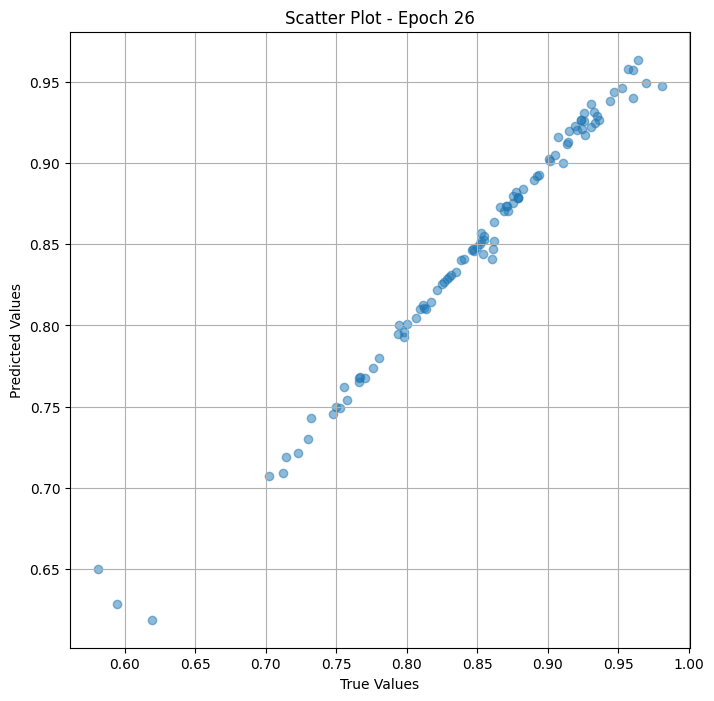

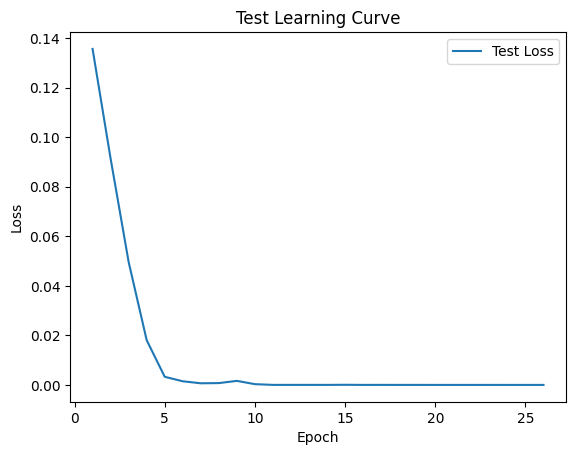


 Epoch: (27/50) Loss = 7.992848622961901e-07

 Epoch: (27/50) Loss_rmse = 0.0008940273546613753

 Epoch: (27/50) R^2 = 0.9996644854545593

 Epoch: (27/50) MAE = 0.0007845014333724976
Spearman correlation coefficient: SignificanceResult(statistic=0.9960254212334773, pvalue=1.5502502390398918e-100)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

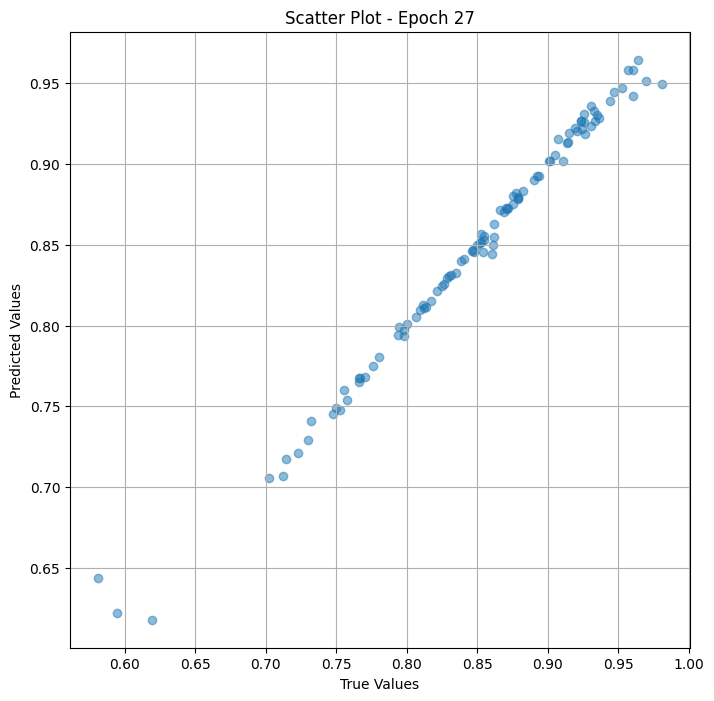

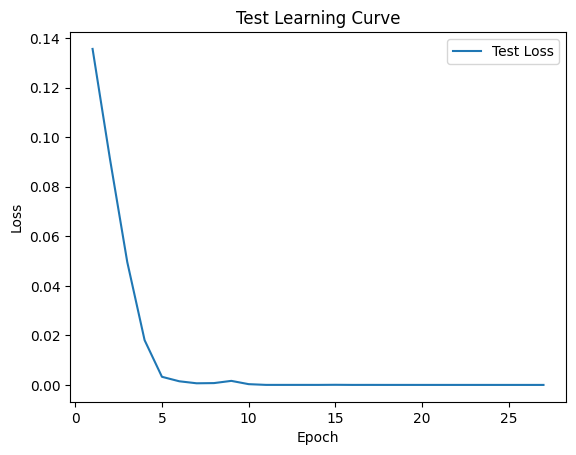


 Epoch: (28/50) Loss = 2.1771479907783942e-07

 Epoch: (28/50) Loss_rmse = 0.00046659918734803796

 Epoch: (28/50) R^2 = 0.9999086260795593

 Epoch: (28/50) MAE = 0.00036551058292388916
Spearman correlation coefficient: SignificanceResult(statistic=0.9976532351475538, pvalue=2.8296652916072944e-111)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 

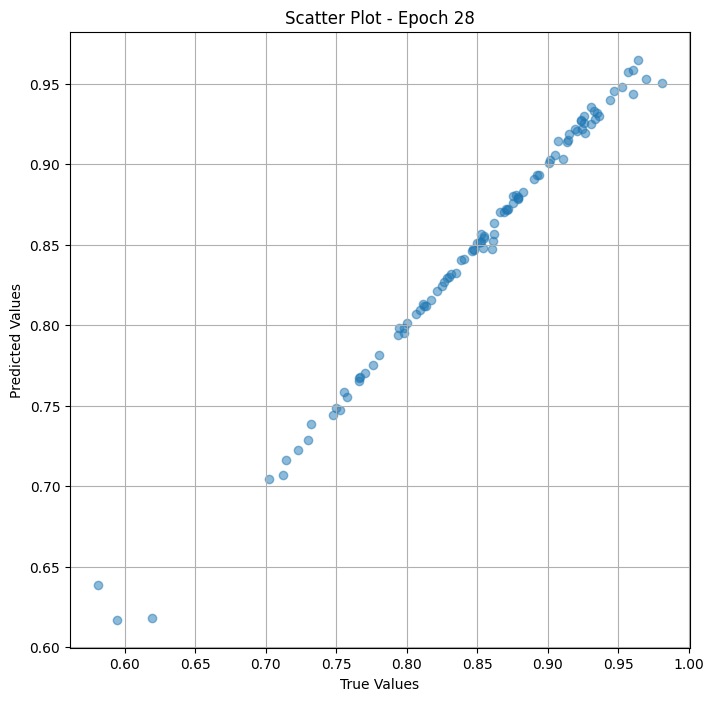

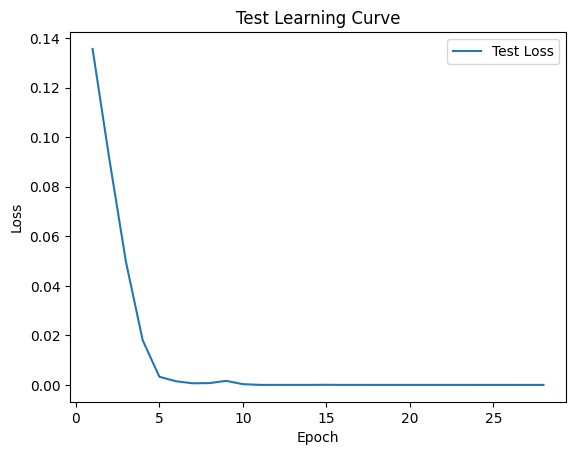


 Epoch: (29/50) Loss = 1.9972833342762897e-07

 Epoch: (29/50) Loss_rmse = 0.00044690974755212665

 Epoch: (29/50) R^2 = 0.999916136264801

 Epoch: (29/50) MAE = 0.0003582686185836792
Spearman correlation coefficient: SignificanceResult(statistic=0.9977753211911093, pvalue=2.3036917948150776e-112)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.

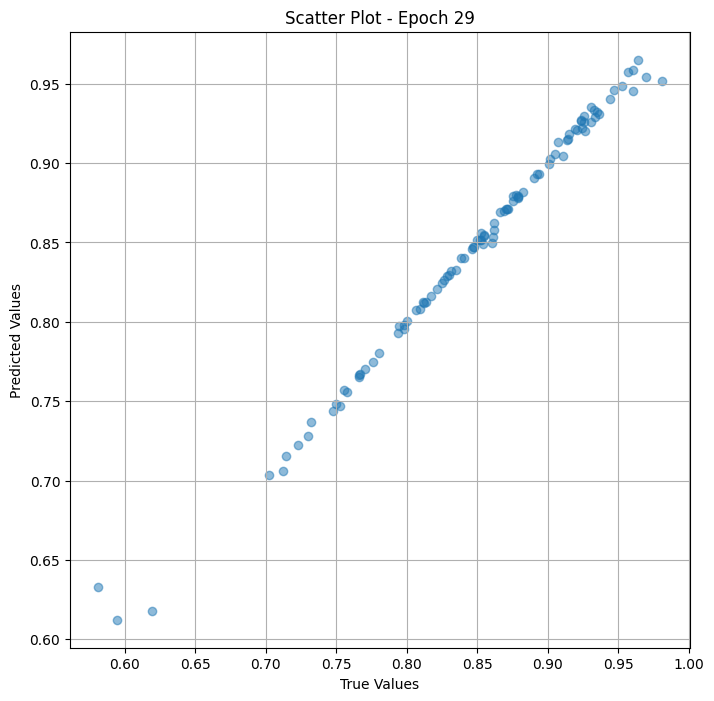

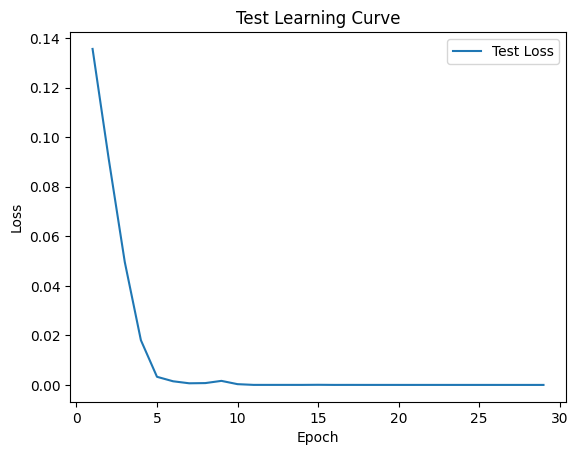


 Epoch: (30/50) Loss = 3.389218932170479e-07

 Epoch: (30/50) Loss_rmse = 0.0005821699742227793

 Epoch: (30/50) R^2 = 0.9998577237129211

 Epoch: (30/50) MAE = 0.000550583004951477
Spearman correlation coefficient: SignificanceResult(statistic=0.9983586211769868, pvalue=1.4500587968341753e-118)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

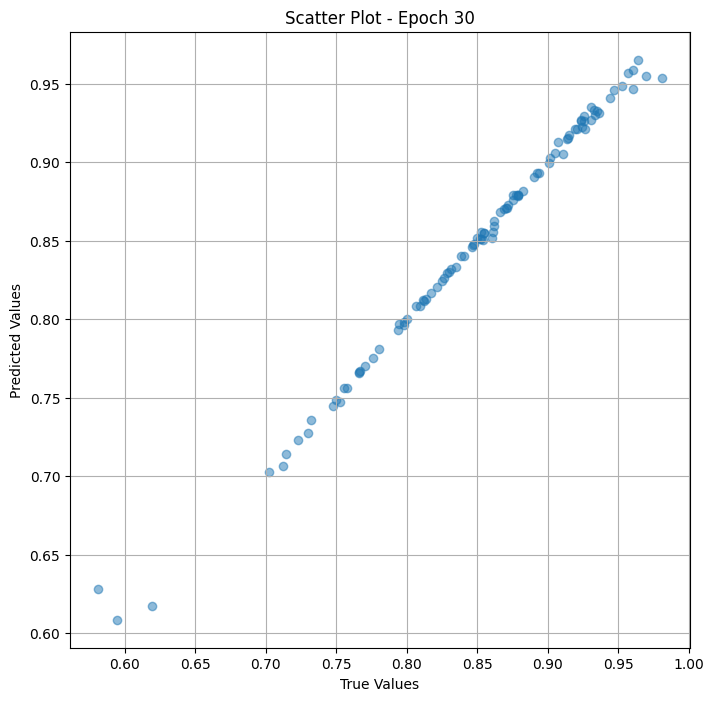

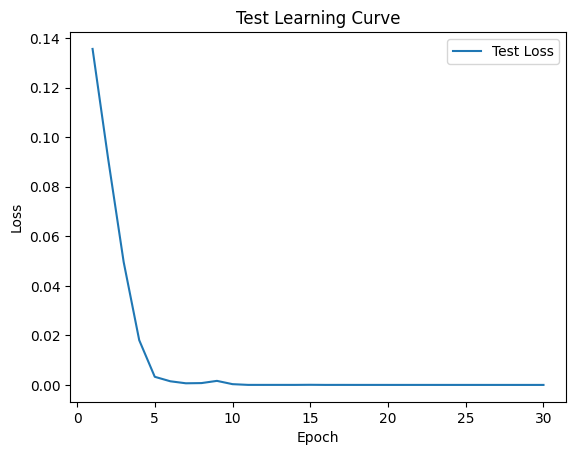


 Epoch: (31/50) Loss = 9.713522786114481e-08

 Epoch: (31/50) Loss_rmse = 0.00031166523694992065

 Epoch: (31/50) R^2 = 0.9999592304229736

 Epoch: (31/50) MAE = 0.0002455711364746094
Spearman correlation coefficient: SignificanceResult(statistic=0.999023311858568, pvalue=3.729099727684423e-129)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

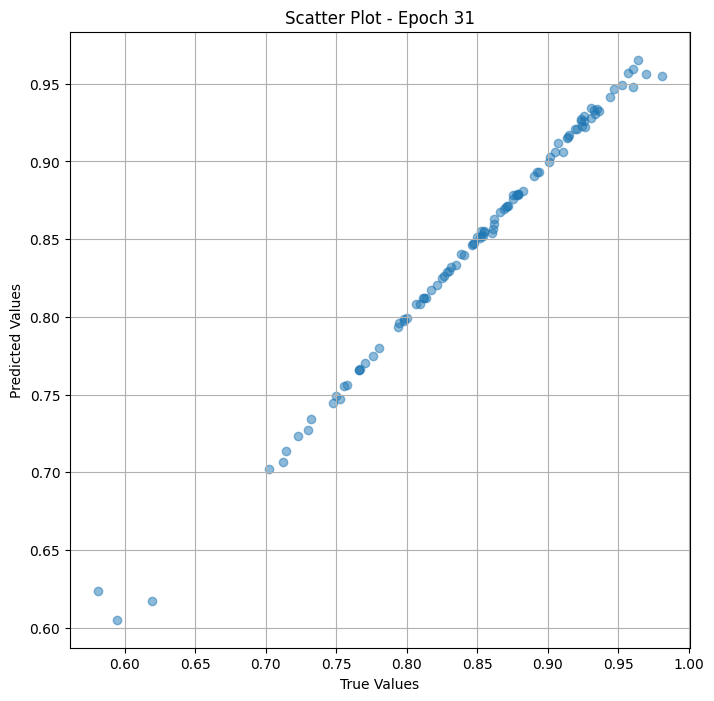

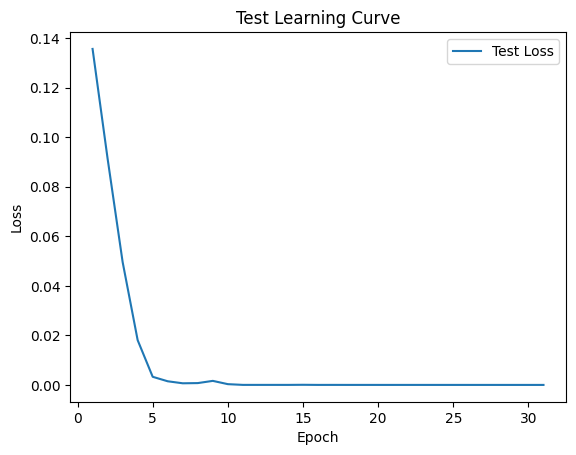


 Epoch: (32/50) Loss = 4.1501223790874064e-08

 Epoch: (32/50) Loss_rmse = 0.0002037184895016253

 Epoch: (32/50) R^2 = 0.9999825954437256

 Epoch: (32/50) MAE = 0.00017677247524261475
Spearman correlation coefficient: SignificanceResult(statistic=0.999213223481877, pvalue=1.4452719332006233e-133)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.

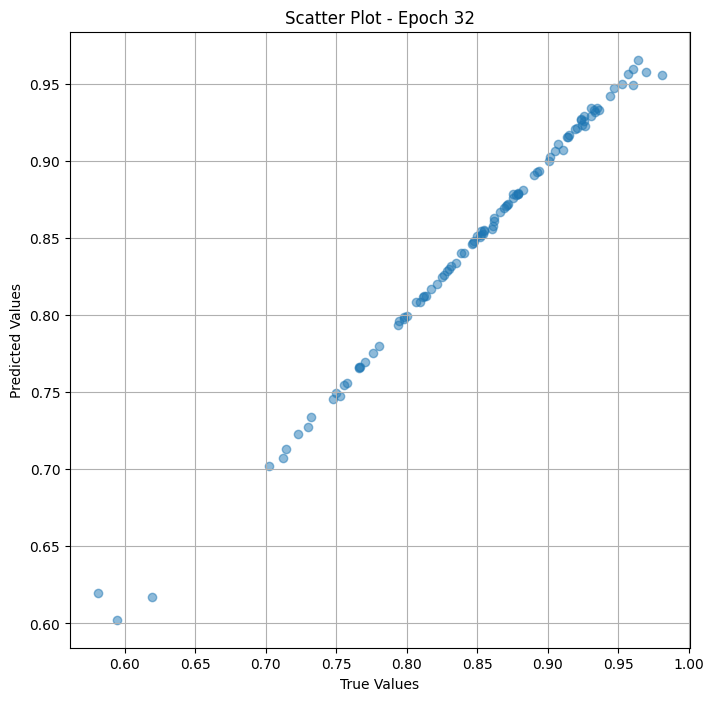

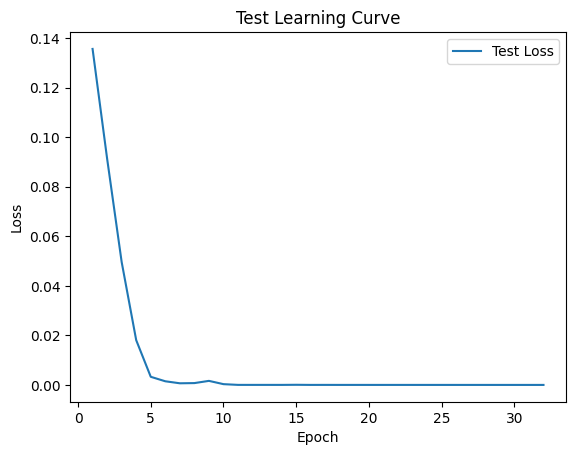


 Epoch: (33/50) Loss = 3.2856410925319324e-09

 Epoch: (33/50) Loss_rmse = 5.7320510677527636e-05

 Epoch: (33/50) R^2 = 0.9999986290931702

 Epoch: (33/50) MAE = 5.556643009185791e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9994099176631611, pvalue=1.9487296615758448e-139)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0

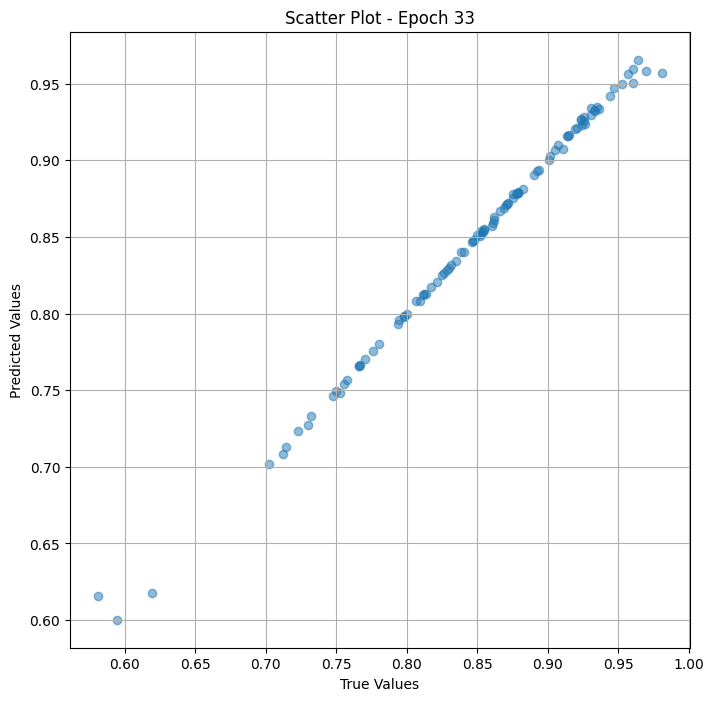

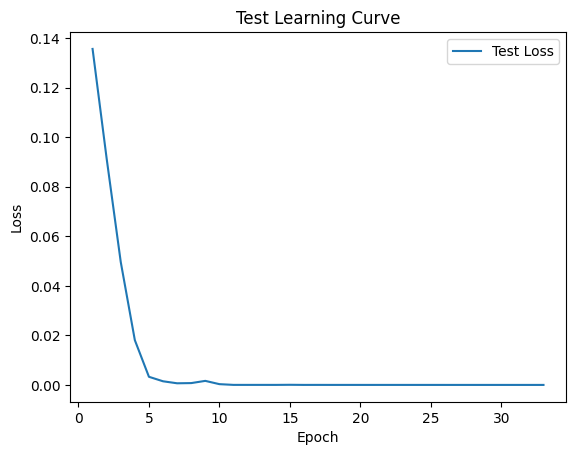


 Epoch: (34/50) Loss = 1.2170922936149964e-08

 Epoch: (34/50) Loss_rmse = 0.00011032190377591178

 Epoch: (34/50) R^2 = 0.9999948740005493

 Epoch: (34/50) MAE = 9.573996067047119e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9994845258008898, pvalue=3.398712546856323e-142)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.

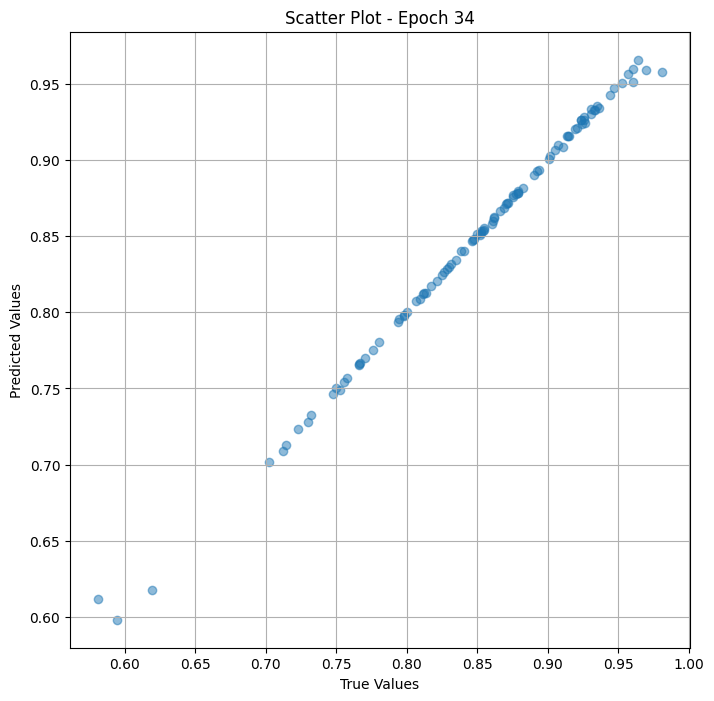

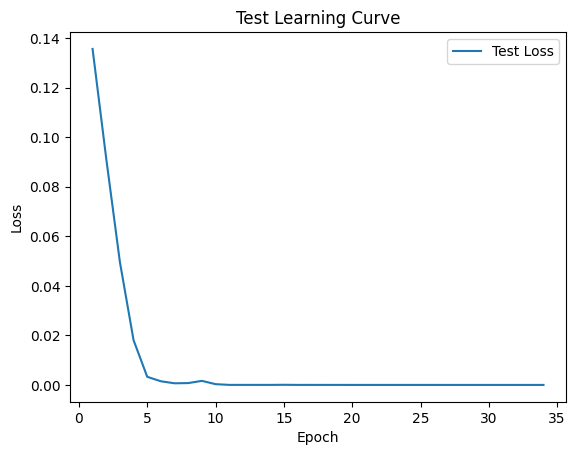


 Epoch: (35/50) Loss = 3.084485911131196e-08

 Epoch: (35/50) Loss_rmse = 0.0001756270503392443

 Epoch: (35/50) R^2 = 0.9999870657920837

 Epoch: (35/50) MAE = 0.0001423954963684082
Spearman correlation coefficient: SignificanceResult(statistic=0.9994777432429144, pvalue=6.281645629790134e-142)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

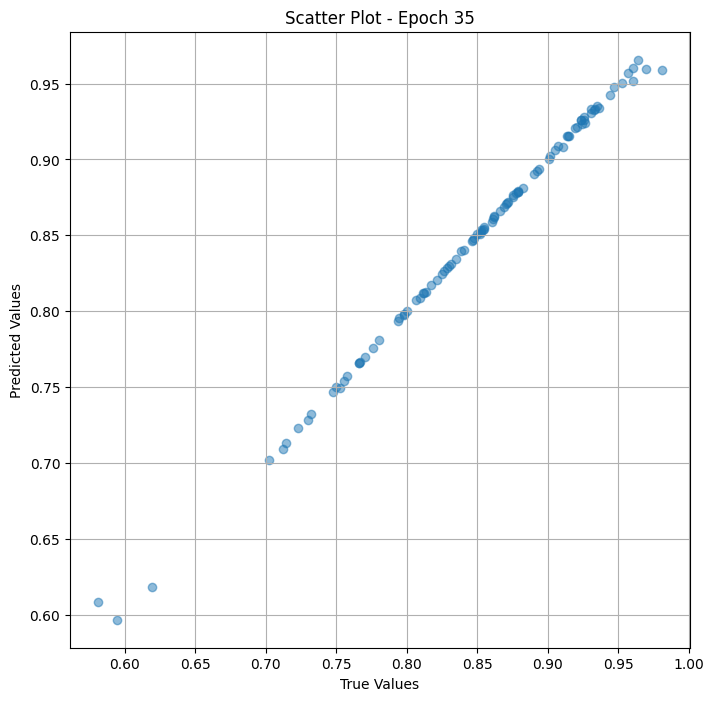

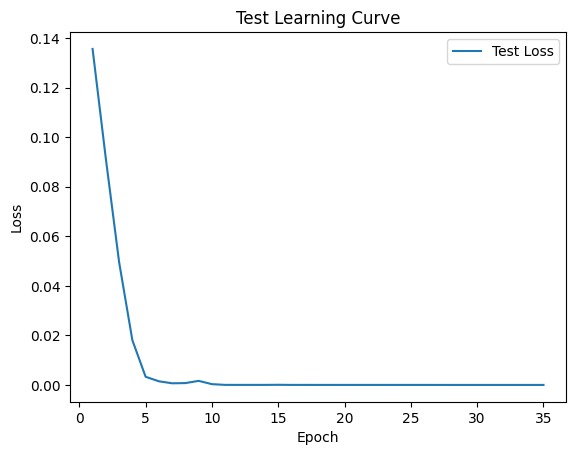

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (36/50) Loss = 3.600908016210269e-08

 Epoch: (36/50) Loss_rmse = 0.00018976058345288038

 Epoch: (36/50) R^2 = 0.999984860420227

 Epoch: (36/50) MAE = 0.00015148520469665527
Spearman correlation coefficient: SignificanceResult(statistic=0.9995659164965935, pvalue=1.0576185880897255e-145)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096,

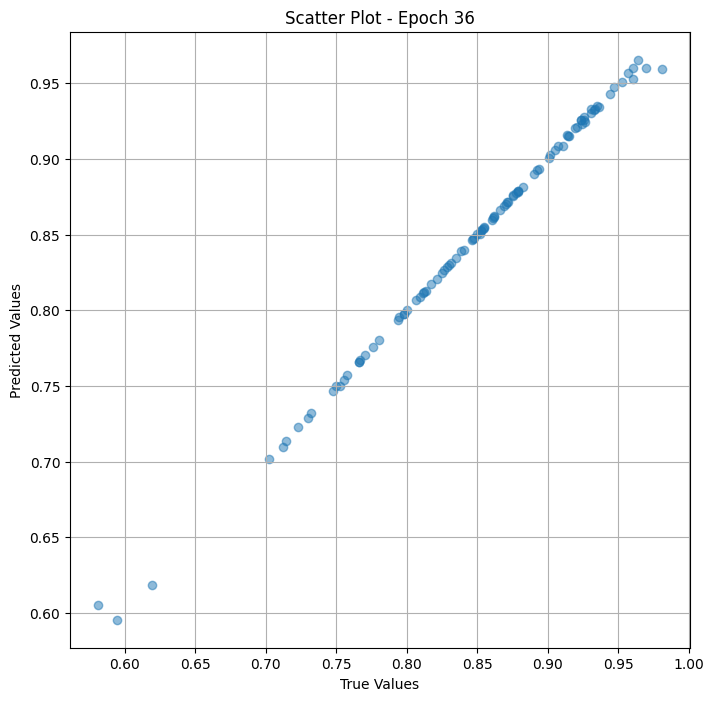

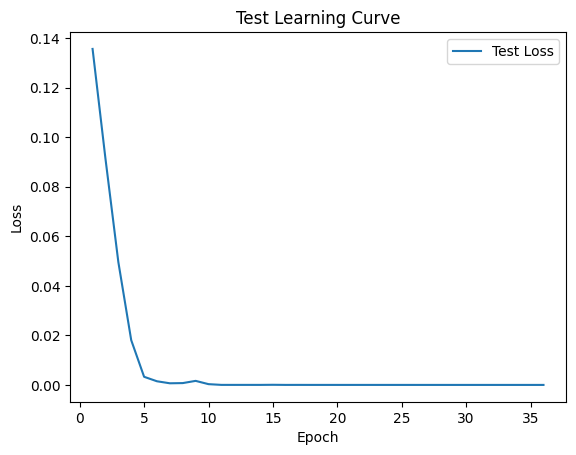


 Epoch: (37/50) Loss = 8.879101898173758e-09

 Epoch: (37/50) Loss_rmse = 9.422898438060656e-05

 Epoch: (37/50) R^2 = 0.9999962449073792

 Epoch: (37/50) MAE = 7.417798042297363e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996133944024207, pvalue=4.5756392467291686e-148)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

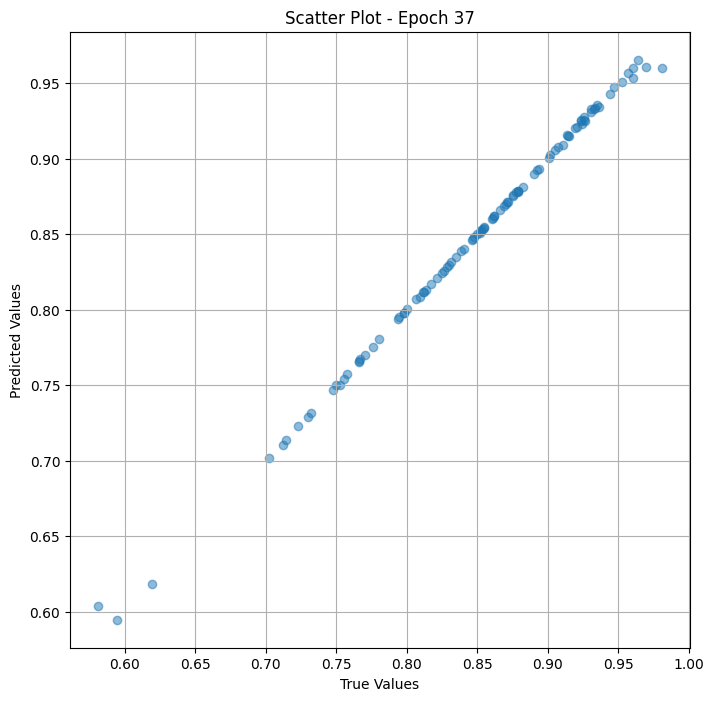

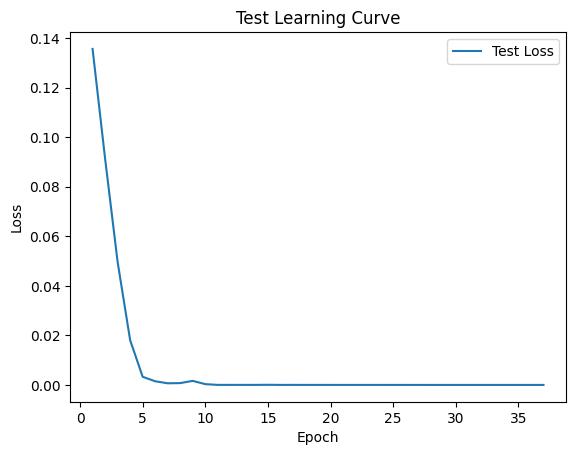


 Epoch: (38/50) Loss = 7.12900938282246e-09

 Epoch: (38/50) Loss_rmse = 8.443346450803801e-05

 Epoch: (38/50) R^2 = 0.9999970197677612

 Epoch: (38/50) MAE = 5.619227886199951e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996133944024207, pvalue=4.5756392467291686e-148)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

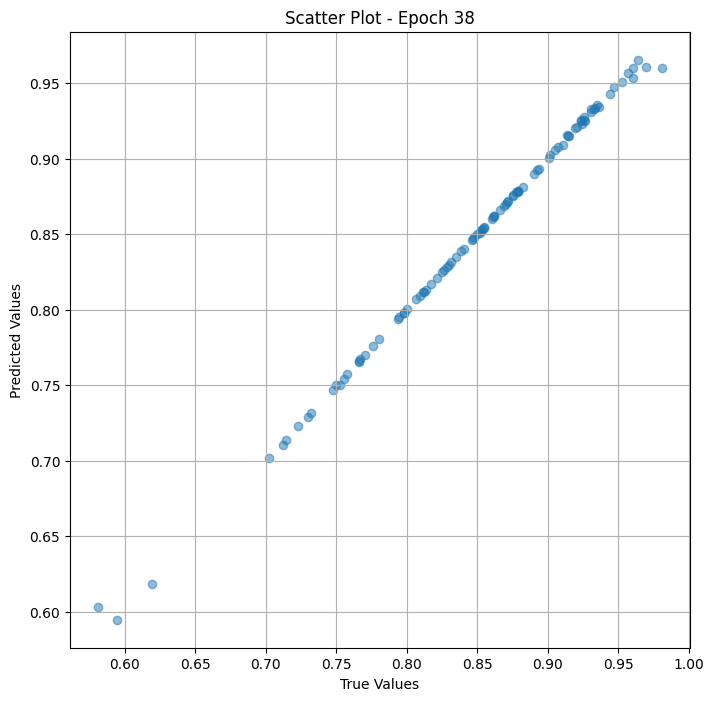

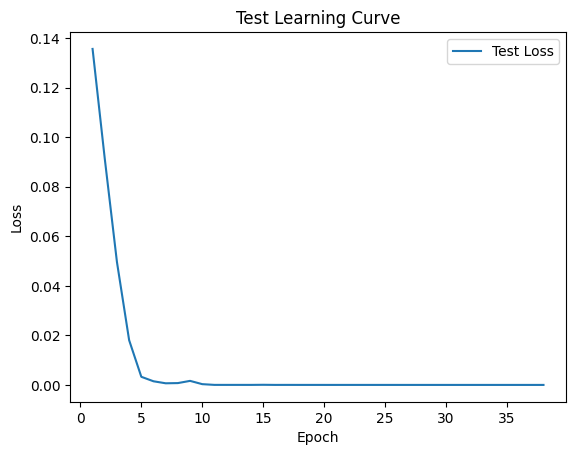

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (39/50) Loss = 8.728306077898651e-09

 Epoch: (39/50) Loss_rmse = 9.34254057938233e-05

 Epoch: (39/50) R^2 = 0.9999963641166687

 Epoch: (39/50) MAE = 7.928907871246338e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0

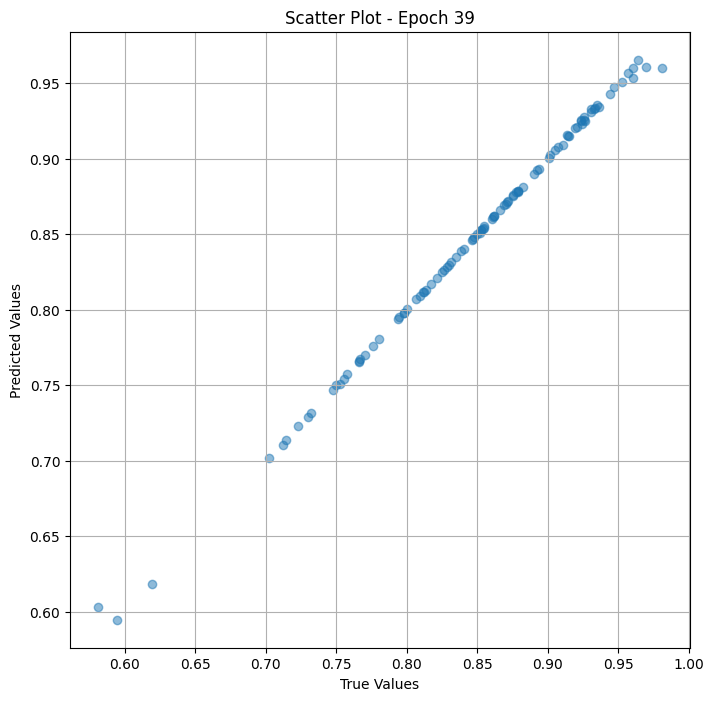

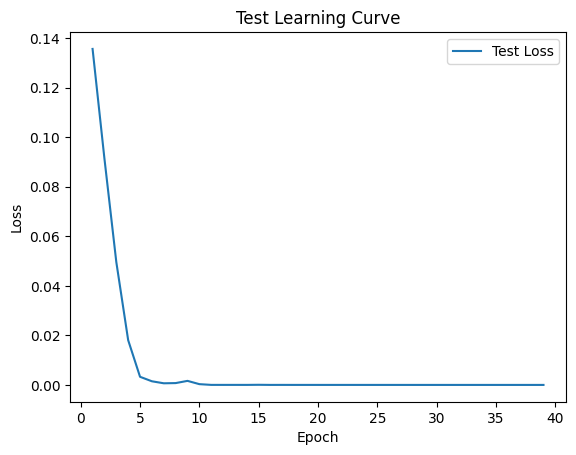


 Epoch: (40/50) Loss = 8.800069117853582e-09

 Epoch: (40/50) Loss_rmse = 9.380868141306564e-05

 Epoch: (40/50) R^2 = 0.9999963045120239

 Epoch: (40/50) MAE = 8.068978786468506e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

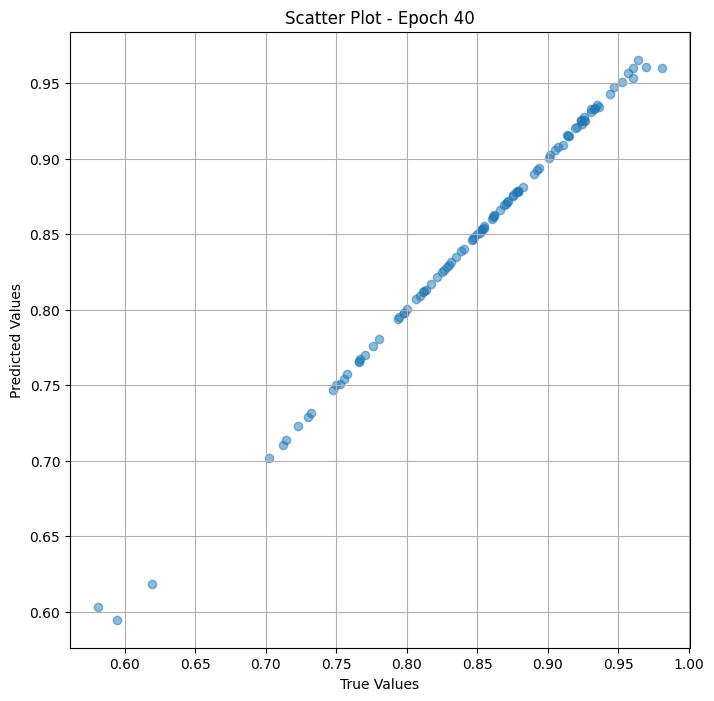

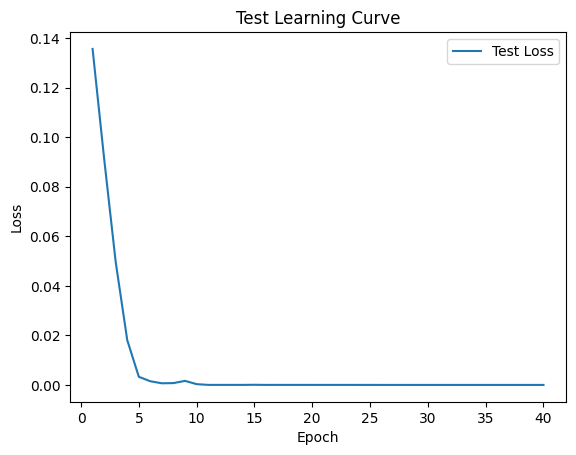


 Epoch: (41/50) Loss = 8.69436433958981e-09

 Epoch: (41/50) Loss_rmse = 9.324357233708724e-05

 Epoch: (41/50) R^2 = 0.9999963641166687

 Epoch: (41/50) MAE = 8.004903793334961e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

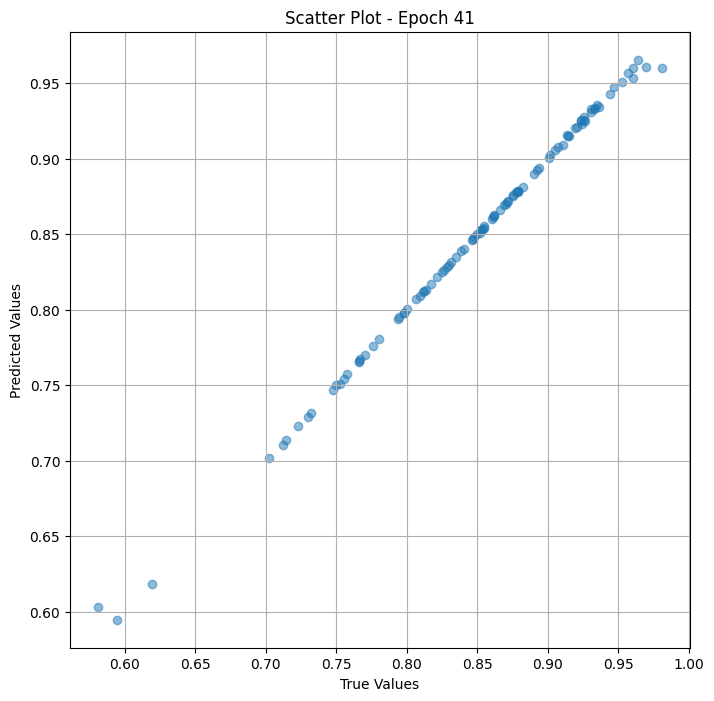

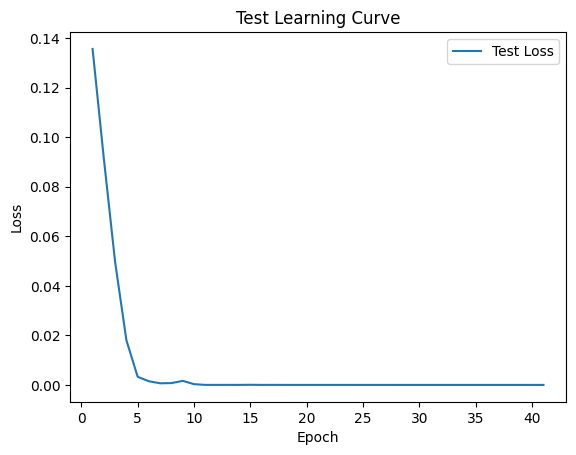

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (42/50) Loss = 8.513511673413632e-09

 Epoch: (42/50) Loss_rmse = 9.226869588019326e-05

 Epoch: (42/50) R^2 = 0.9999964237213135

 Epoch: (42/50) MAE = 7.88569450378418e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0

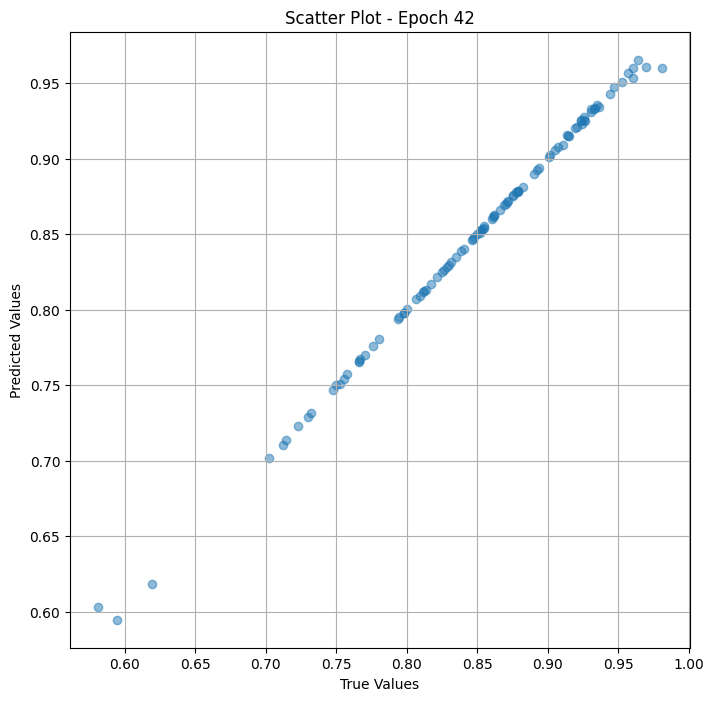

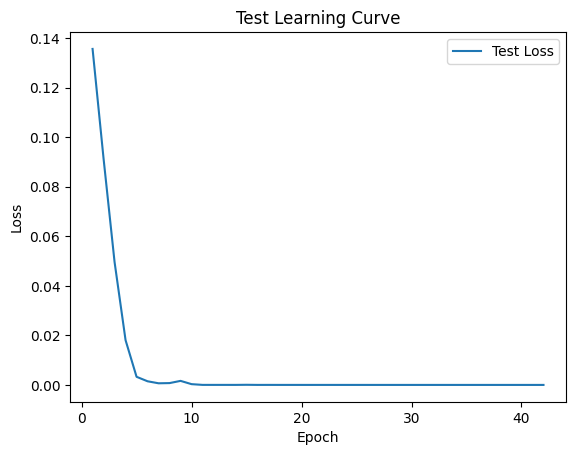


 Epoch: (43/50) Loss = 8.420923514051992e-09

 Epoch: (43/50) Loss_rmse = 9.176559251500294e-05

 Epoch: (43/50) R^2 = 0.9999964833259583

 Epoch: (43/50) MAE = 7.818639278411865e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

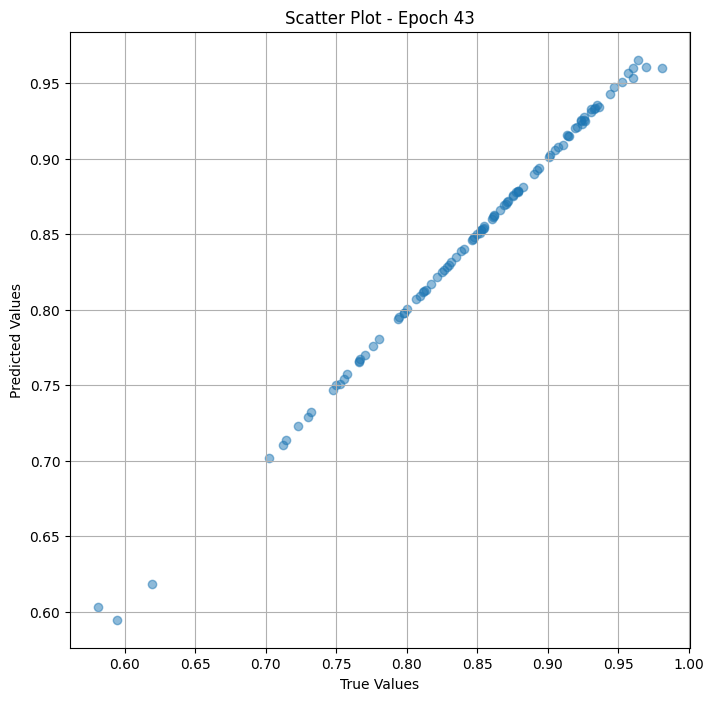

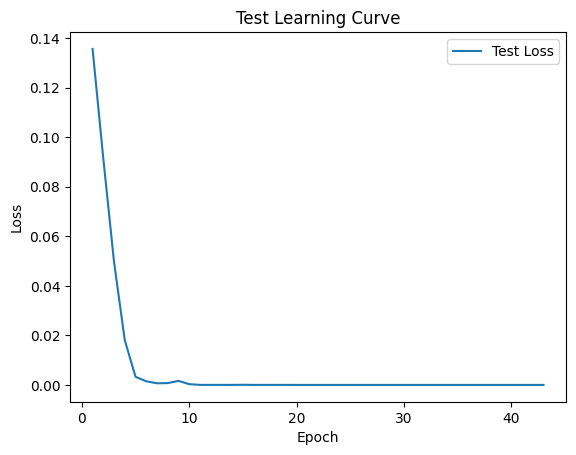


 Epoch: (44/50) Loss = 8.412916585598396e-09

 Epoch: (44/50) Loss_rmse = 9.172195132123306e-05

 Epoch: (44/50) R^2 = 0.9999964833259583

 Epoch: (44/50) MAE = 7.811188697814941e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

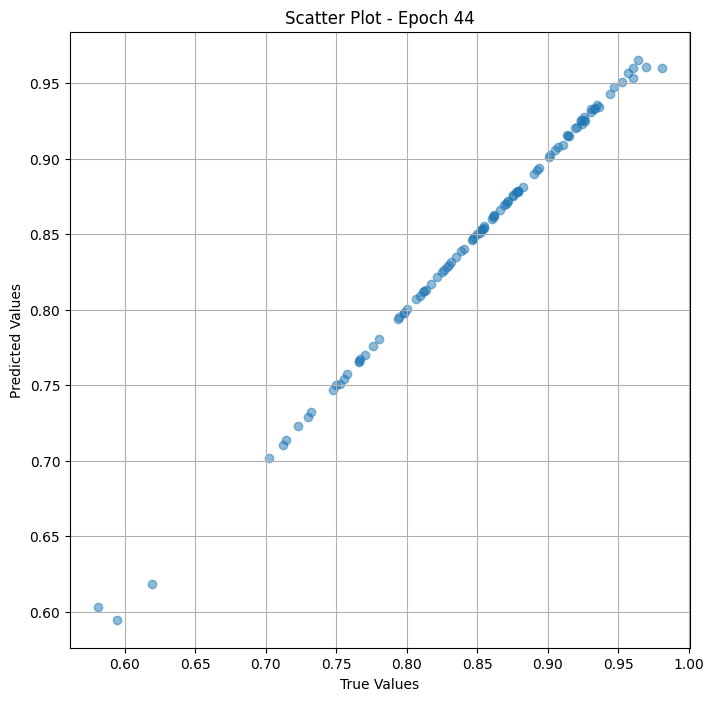

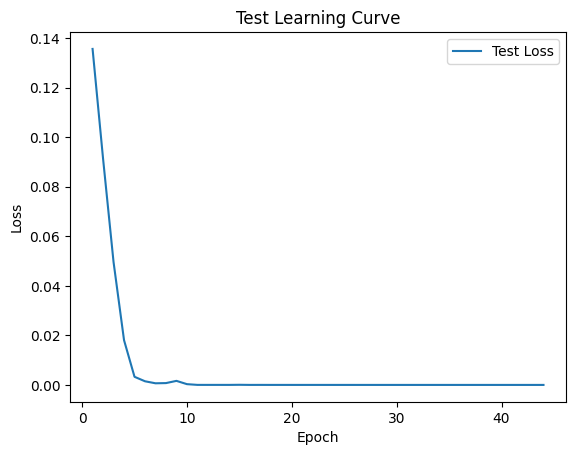

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (45/50) Loss = 8.405207196915399e-09

 Epoch: (45/50) Loss_rmse = 9.167991811409593e-05

 Epoch: (45/50) R^2 = 0.9999964833259583

 Epoch: (45/50) MAE = 7.805228233337402e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 

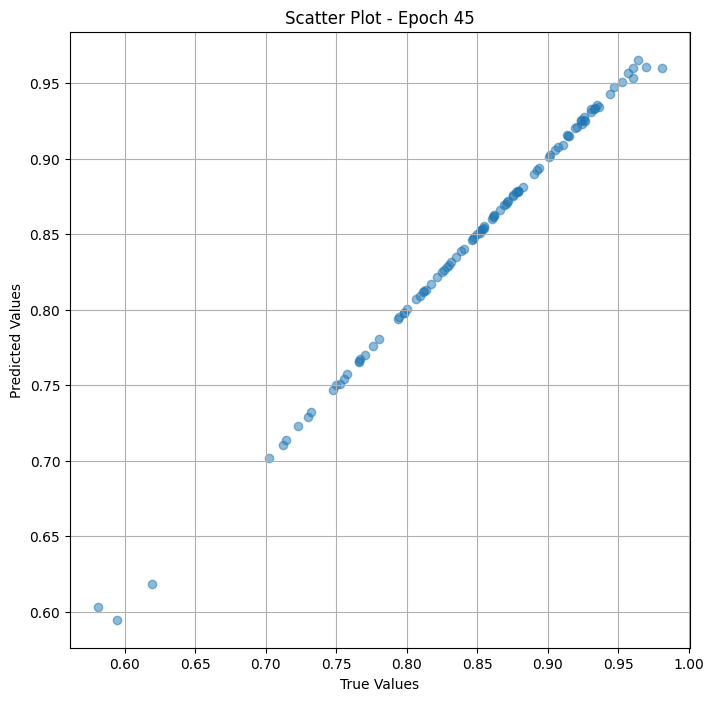

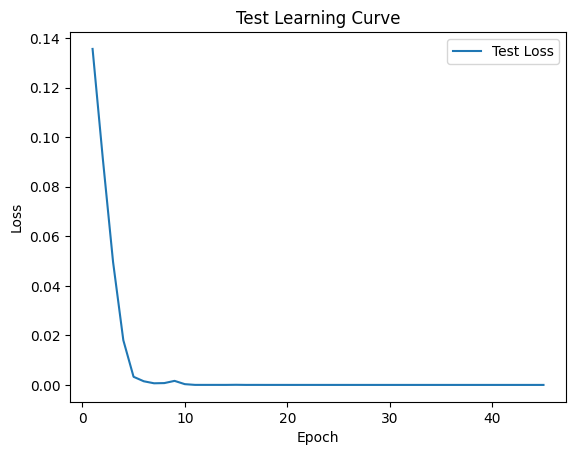


 Epoch: (46/50) Loss = 8.390732553209546e-09

 Epoch: (46/50) Loss_rmse = 9.160094487015158e-05

 Epoch: (46/50) R^2 = 0.9999964833259583

 Epoch: (46/50) MAE = 7.797777652740479e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

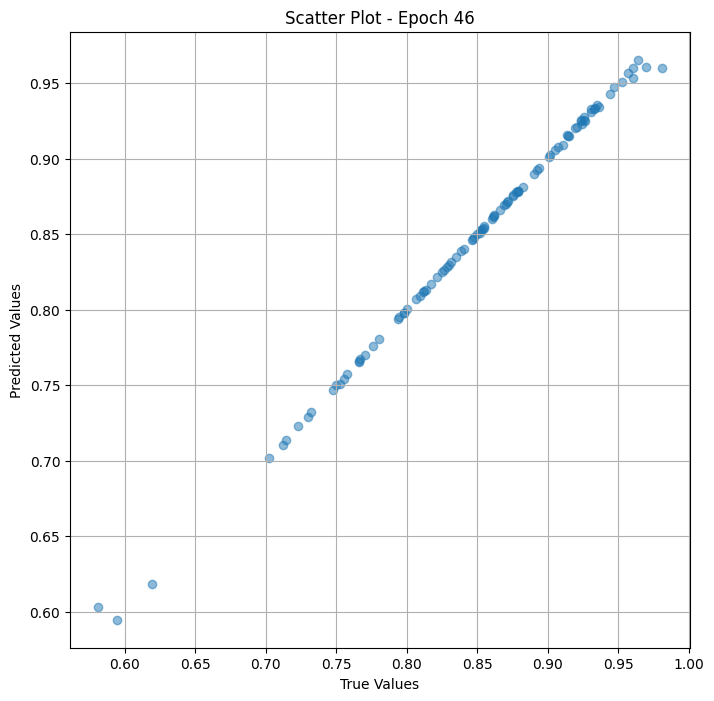

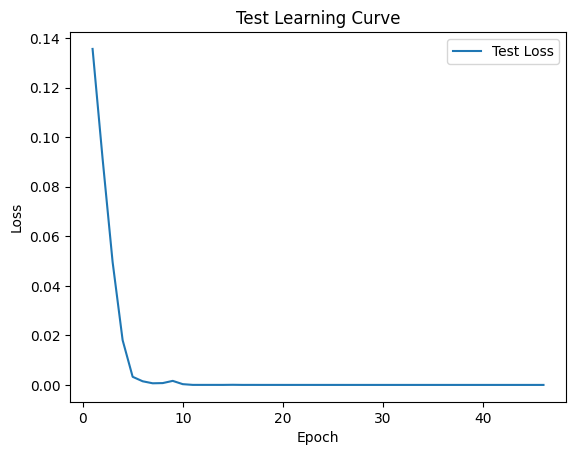


 Epoch: (47/50) Loss = 8.388533423442368e-09

 Epoch: (47/50) Loss_rmse = 9.158893954008818e-05

 Epoch: (47/50) R^2 = 0.9999964833259583

 Epoch: (47/50) MAE = 7.794797420501709e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

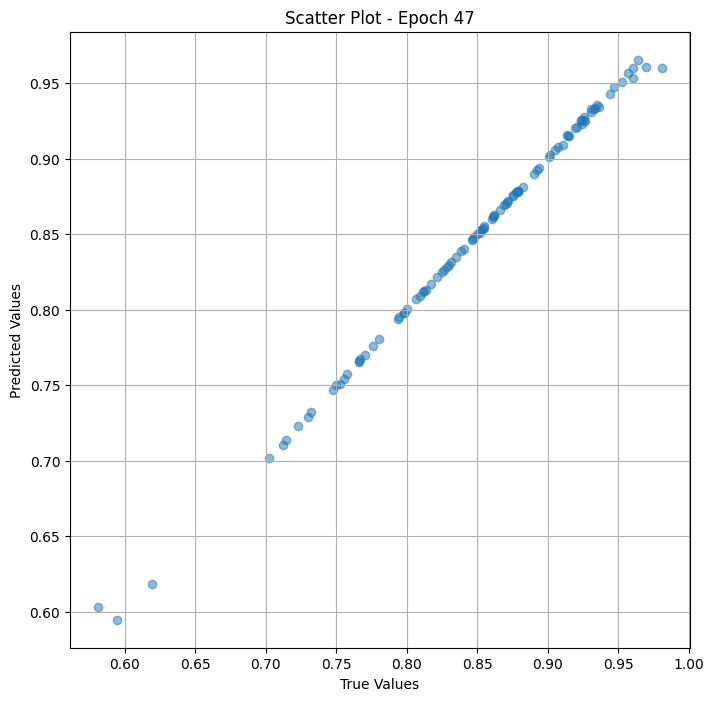

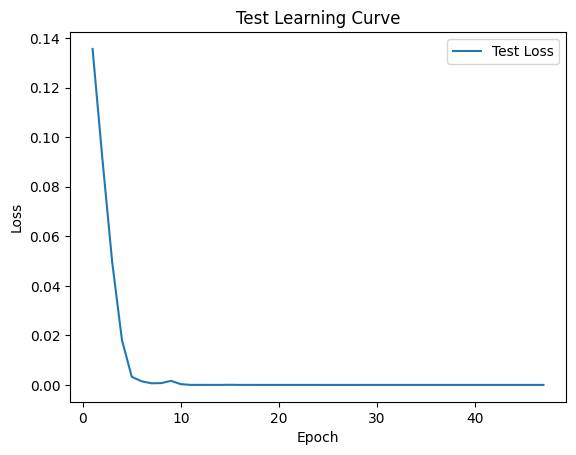


 Epoch: (48/50) Loss = 8.390732553209546e-09

 Epoch: (48/50) Loss_rmse = 9.160094487015158e-05

 Epoch: (48/50) R^2 = 0.9999964833259583

 Epoch: (48/50) MAE = 7.797777652740479e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

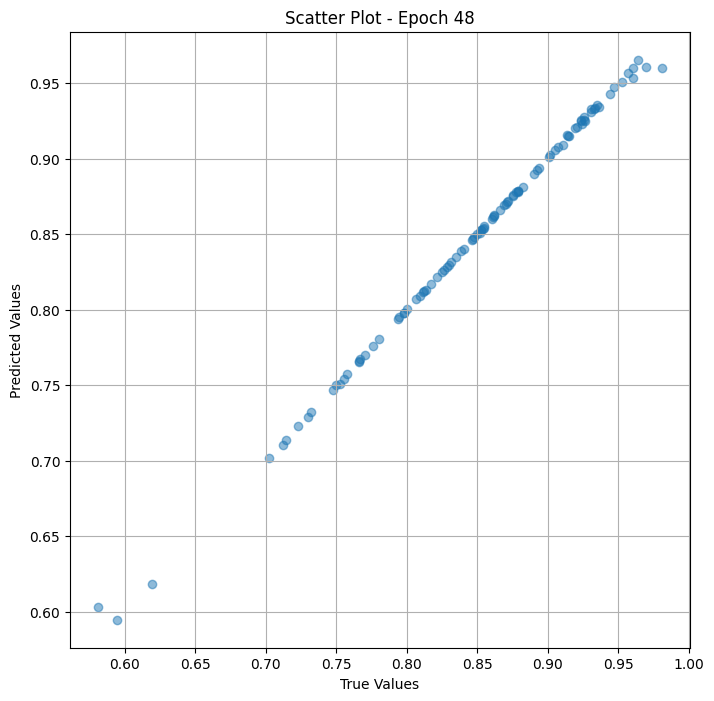

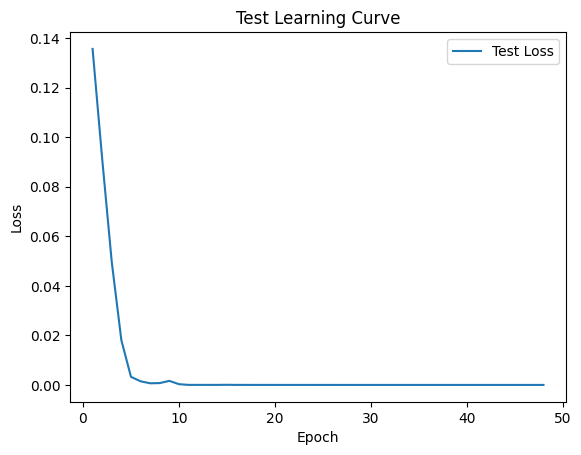


 Epoch: (49/50) Loss = 8.390732553209546e-09

 Epoch: (49/50) Loss_rmse = 9.160094487015158e-05

 Epoch: (49/50) R^2 = 0.9999964833259583

 Epoch: (49/50) MAE = 7.797777652740479e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

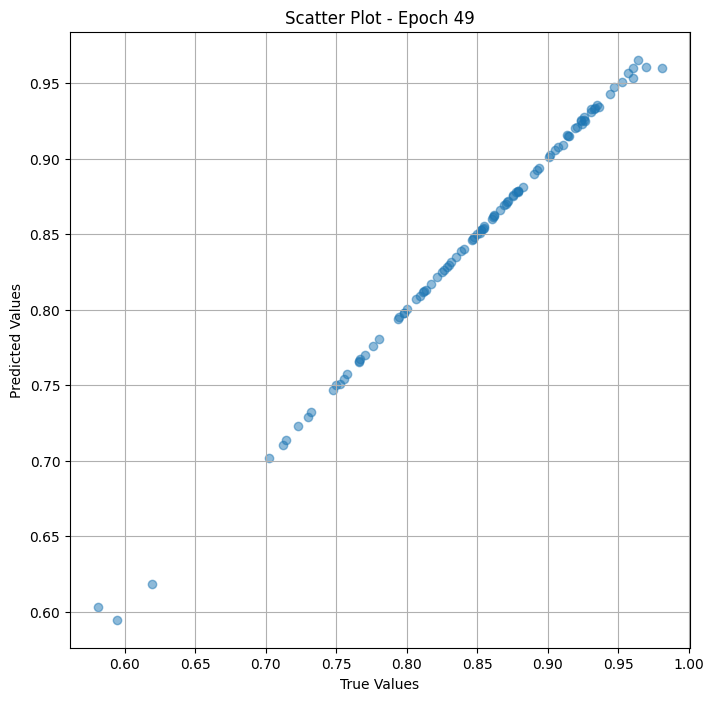

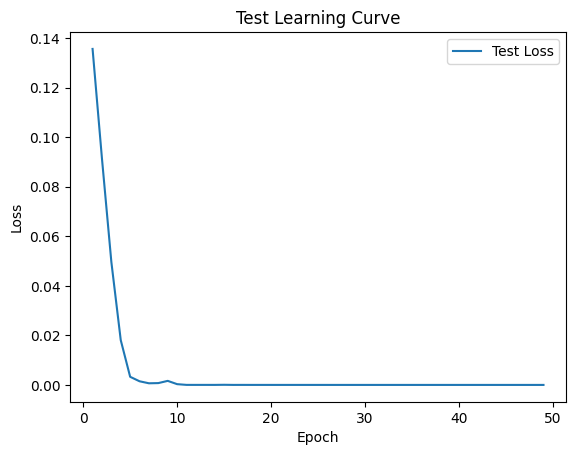


 Epoch: (50/50) Loss = 8.390456329721019e-09

 Epoch: (50/50) Loss_rmse = 9.159943147096783e-05

 Epoch: (50/50) R^2 = 0.9999964833259583

 Epoch: (50/50) MAE = 7.796287536621094e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996744374241985, pvalue=1.4232028706676195e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

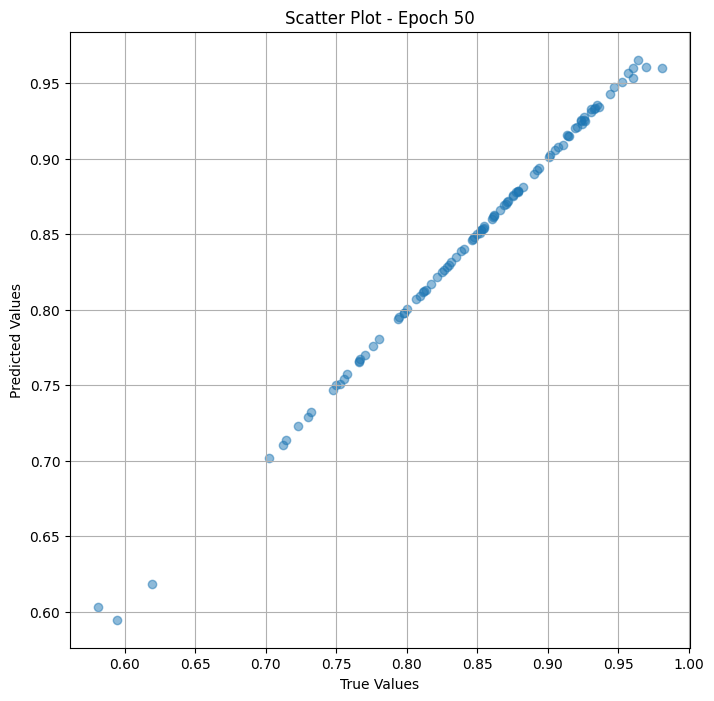

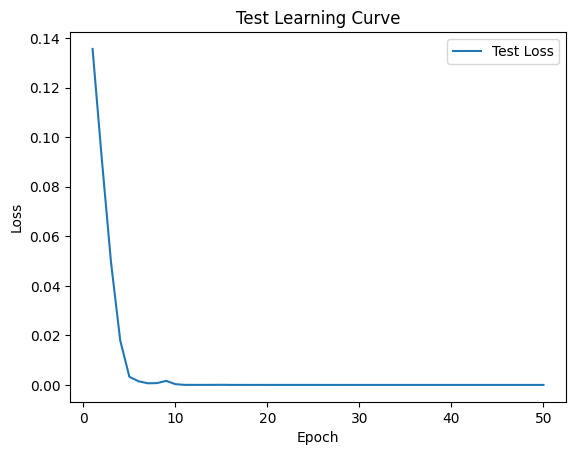

In [ ]:
# val the model and save weights
fit(50, model_res_test , test_dl )
torch.save(model_res_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds =model_res_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result = pd.DataFrame({
    'Image Path': df_test_food['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result)

                                        Image Path  True Value  \
0      /content/food/000000445557_preprocessed.jpg    0.923729   
1      /content/food/000000321324_preprocessed.jpg    0.860465   
2   /content/food/n07806221_23145_preprocessed.jpg    0.854545   
3   /content/food/n07863374_17253_preprocessed.jpg    0.892157   
4    /content/food/n07711569_4665_preprocessed.jpg    0.934579   
..                                             ...         ...   
95  /content/food/n07849336_29721_preprocessed.jpg    0.765957   
96    /content/food/n07680932_803_preprocessed.jpg    0.829787   
97  /content/food/n07654148_13056_preprocessed.jpg    0.871795   
98     /content/food/000000558809_preprocessed.jpg    0.925926   
99   /content/food/n07717556_4579_preprocessed.jpg    0.956522   

    Predicted Value  
0          0.925216  
1          0.860247  
2          0.855131  
3          0.892355  
4          0.935319  
..              ...  
95         0.766196  
96         0.829824  
97       

#Finetuning

##Train

In [ ]:
class Dataset_train_fine(Dataset):
    def __init__(self, df,res_fine_transform =None):
        self.labels = df_train_food["memoscore"]
        self.images = df_train_food["preprocessed_image_path"]
        self.res_fine_transform  = res_fine_transform

    def __len__(self):
        return len(self.labels)

    def __getitem__(self, idx):
        img_path = self.images[idx]
        image = Image.open(img_path)

        image_trans = self.res_fine_transform(image, return_tensors='pt')
        image_trans = image_trans['pixel_values'].squeeze()

        # แสดงขนาดรูปภาพหลังการ transform
        #print("Transformed image size:", image_trans.shape)

        label = self.labels[idx]

        return image_trans, label

# สร้างตัวแปรสำหรับ ViTFeatureExtractor
res_fine_transform   = ConvNextImageProcessor.from_pretrained("facebook/convnext-tiny-224")

# สร้าง Dataset และ DataLoader
train_ds_fine = Dataset_train_fine(df_train_food, res_fine_transform =res_fine_transform )
train_dl_fine = DataLoader(train_ds_fine, batch_size=32, shuffle=False)



In [ ]:
class Resmem_model_fine_food(torch.nn.Module):
    def __init__(self, arch="resnet50.a1_in1k"):
        super().__init__()
        self.arch = arch
        self.res = timm.create_model(self.arch, pretrained=True, num_classes=1)



    def forward(self, x):
        resfeat = self.res(x)

        out = torch.sigmoid(resfeat)
        return out



NORMALIZE_MEAN = (0.0, 0.0, 0.0)
NORMALIZE_STD = (1.0, 1.0, 1.0)

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(NORMALIZE_MEAN, NORMALIZE_STD)
])

model_res_fine =  Resmem_model_fine_food( arch="resnet50.a1_in1k")

In [ ]:
# Add data and model to GPU
device = get_default_device()
train_dl_fine = DeviceDataLoader(train_dl_fine, device)
model_res_fine = to_device(model_res_fine  , device)

In [ ]:
params = [param for param in list(model_res_fine.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_fine, train_dl_fine):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_fine.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in train_dl_fine:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_fine(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)

/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:1006: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)



 Epoch: (1/50) Loss = 0.02113044075667858

 Epoch: (1/50) Loss_rmse = 0.14536313712596893

 Epoch: (1/50) R^2 = -9.320230484008789

 Epoch: (1/50) MAE = 0.14206716418266296
Spearman correlation coefficient: SignificanceResult(statistic=0.017944451459046492, pvalue=0.44775925854501974)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021

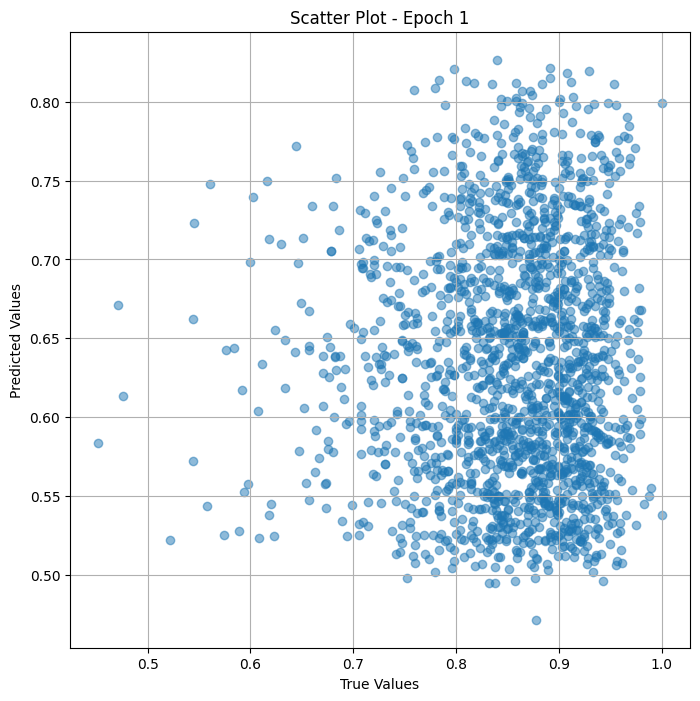

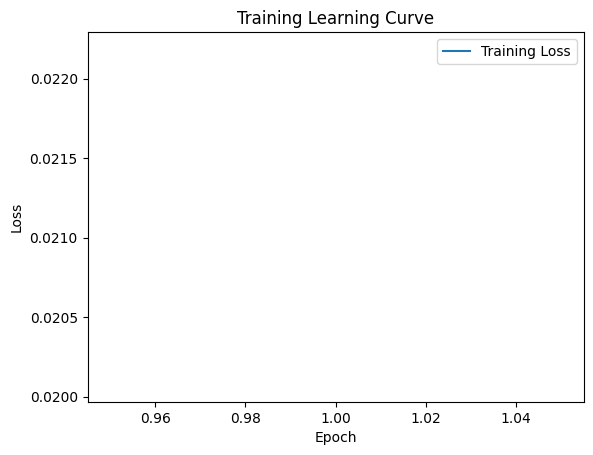


 Epoch: (2/50) Loss = 0.002097358461469412

 Epoch: (2/50) Loss_rmse = 0.04579692706465721

 Epoch: (2/50) R^2 = -0.02436208724975586

 Epoch: (2/50) MAE = 0.04385516047477722
Spearman correlation coefficient: SignificanceResult(statistic=0.34756952186793666, pvalue=4.8878346299479235e-52)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0

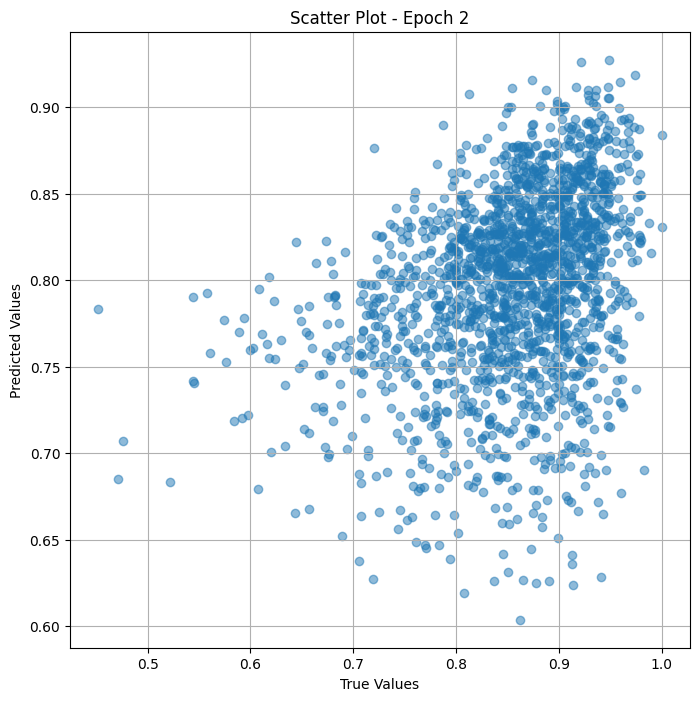

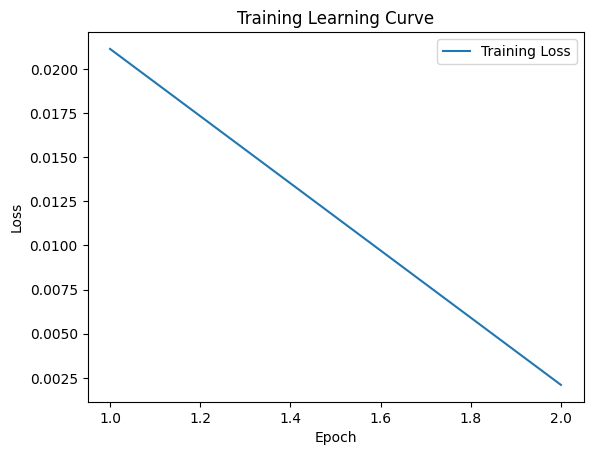


 Epoch: (3/50) Loss = 0.0005206001223996282

 Epoch: (3/50) Loss_rmse = 0.02281666360795498

 Epoch: (3/50) R^2 = 0.7457358837127686

 Epoch: (3/50) MAE = 0.017270073294639587
Spearman correlation coefficient: SignificanceResult(statistic=0.7848562447426604, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

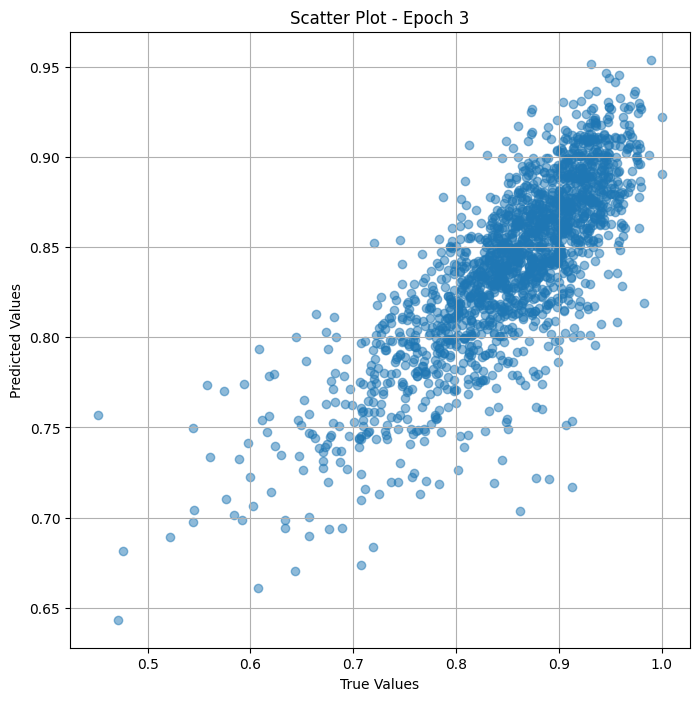

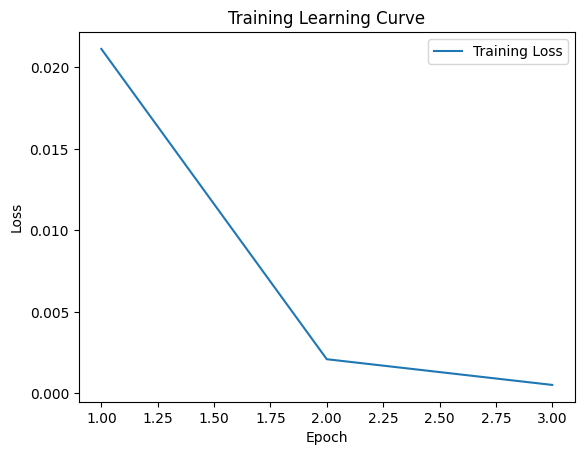


 Epoch: (4/50) Loss = 0.00044391618575900793

 Epoch: (4/50) Loss_rmse = 0.021069318056106567

 Epoch: (4/50) R^2 = 0.7831887602806091

 Epoch: (4/50) MAE = 0.017601922154426575
Spearman correlation coefficient: SignificanceResult(statistic=0.9050441484120466, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0

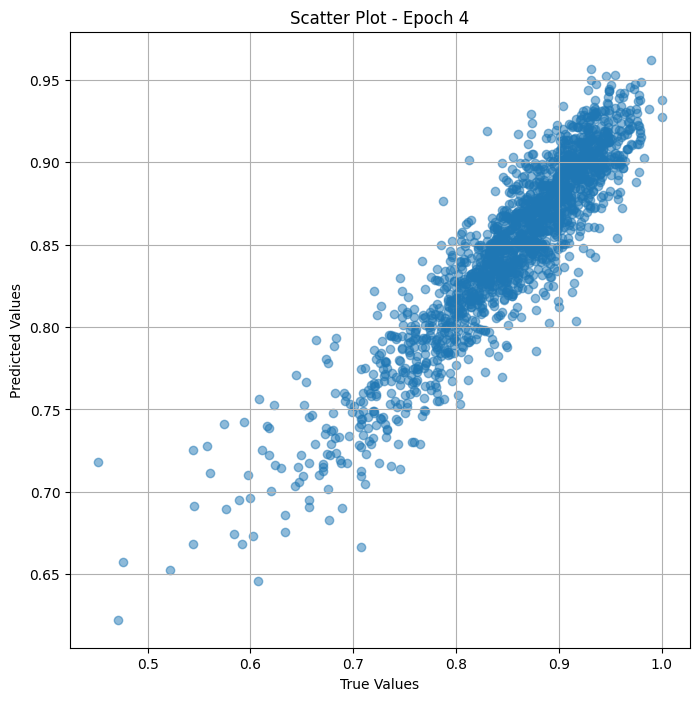

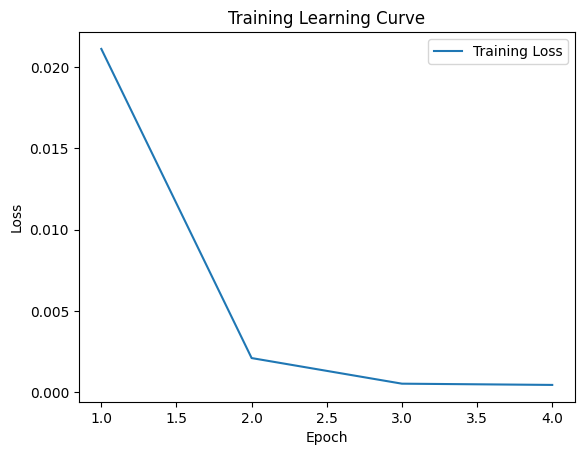


 Epoch: (5/50) Loss = 0.0005272016278468072

 Epoch: (5/50) Loss_rmse = 0.02296087145805359

 Epoch: (5/50) R^2 = 0.7425116300582886

 Epoch: (5/50) MAE = 0.018195949494838715
Spearman correlation coefficient: SignificanceResult(statistic=0.9541359032944629, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

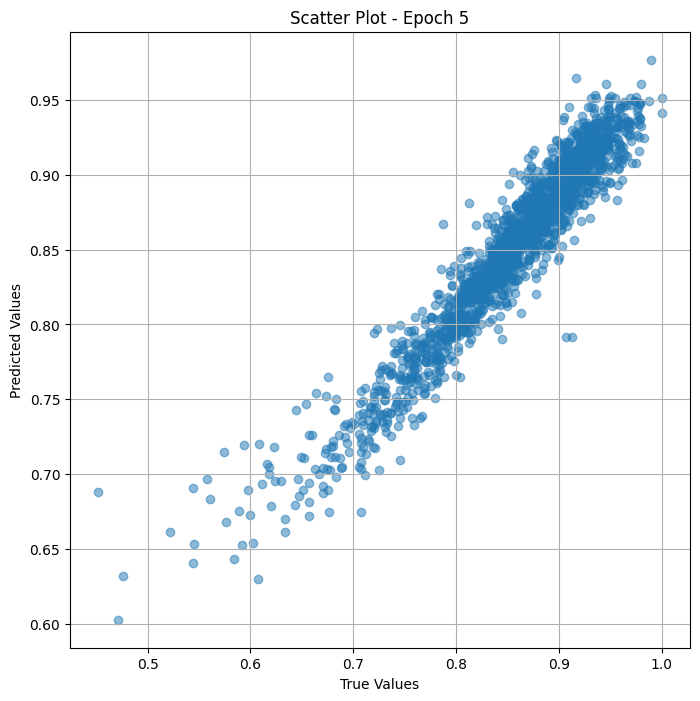

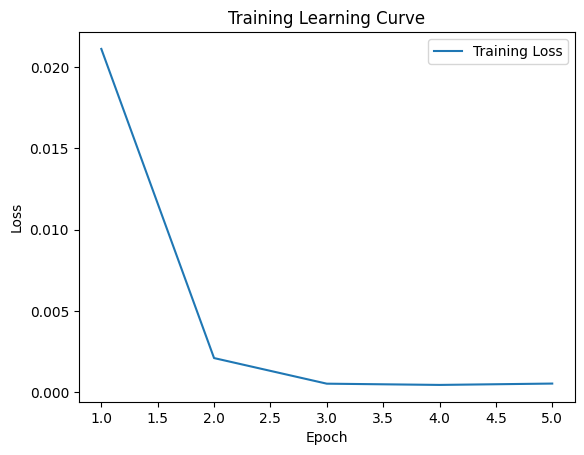


 Epoch: (6/50) Loss = 0.0011594253592193127

 Epoch: (6/50) Loss_rmse = 0.03405033424496651

 Epoch: (6/50) R^2 = 0.433729887008667

 Epoch: (6/50) MAE = 0.022991366684436798
Spearman correlation coefficient: SignificanceResult(statistic=0.974507151677364, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.877

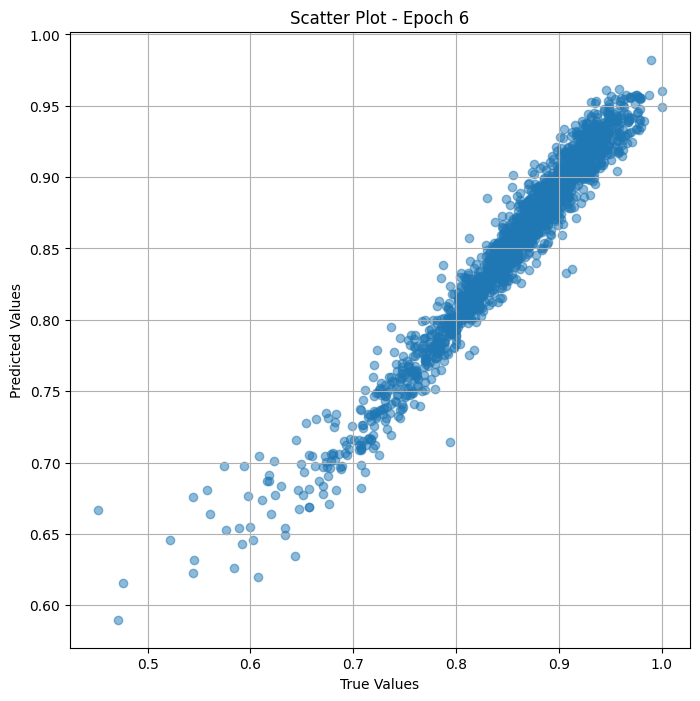

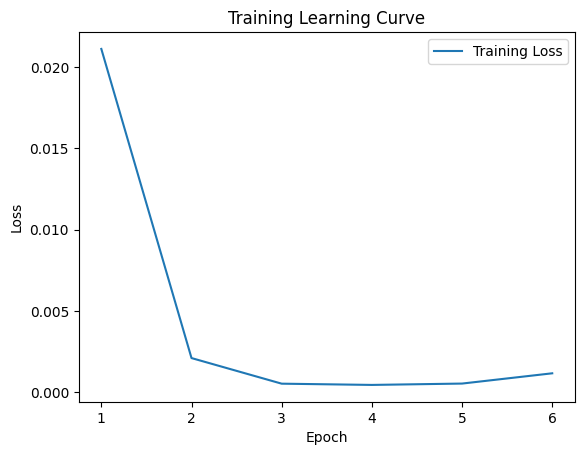

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (7/50) Loss = 0.0005670490209013224

 Epoch: (7/50) Loss_rmse = 0.0238127913326025

 Epoch: (7/50) R^2 = 0.7230499386787415

 Epoch: (7/50) MAE = 0.01994071900844574
Spearman correlation coefficient: SignificanceResult(statistic=0.9826651682340286, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.80722

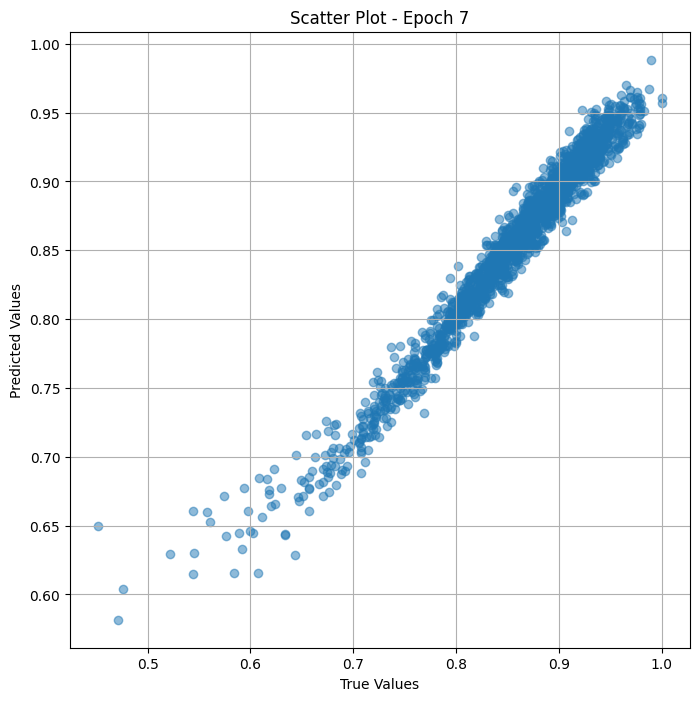

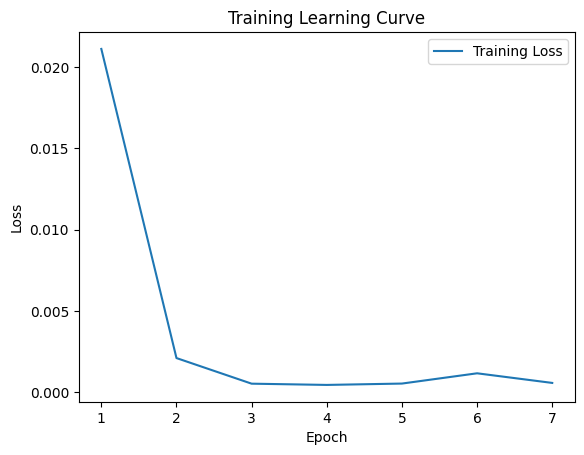


 Epoch: (8/50) Loss = 0.00012853836233261973

 Epoch: (8/50) Loss_rmse = 0.01133747585117817

 Epoch: (8/50) R^2 = 0.937221109867096

 Epoch: (8/50) MAE = 0.009223535656929016
Spearman correlation coefficient: SignificanceResult(statistic=0.9846488130177462, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

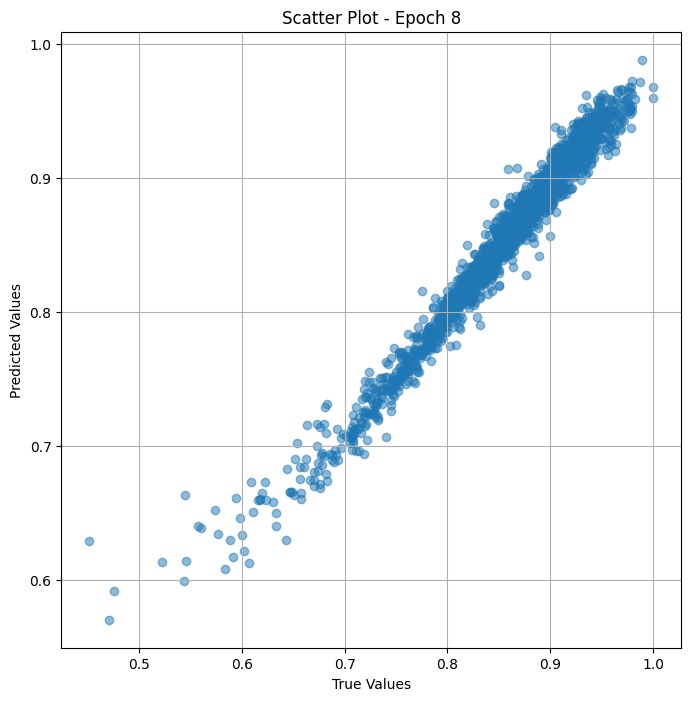

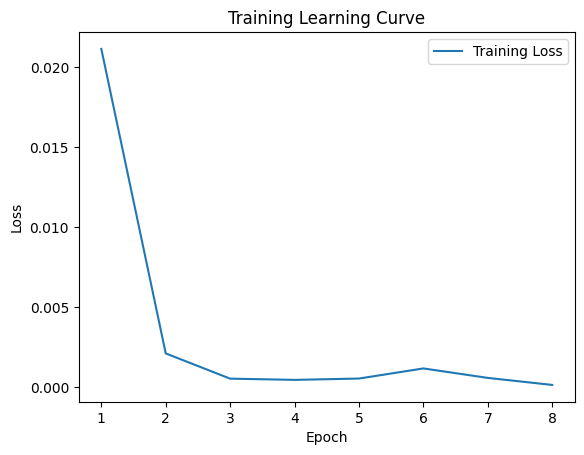


 Epoch: (9/50) Loss = 6.833010411355644e-05

 Epoch: (9/50) Loss_rmse = 0.008266202174127102

 Epoch: (9/50) R^2 = 0.9666271805763245

 Epoch: (9/50) MAE = 0.00661034882068634
Spearman correlation coefficient: SignificanceResult(statistic=0.9888956018054322, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975, 0.8

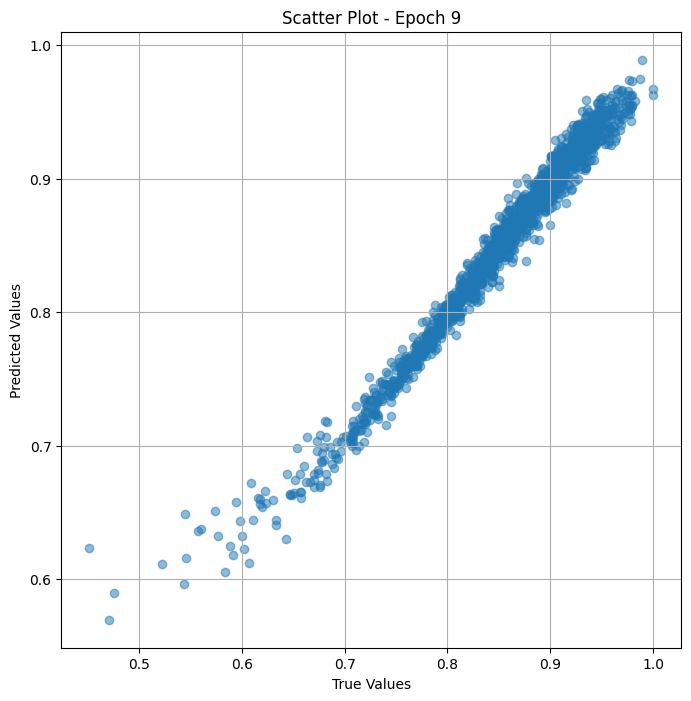

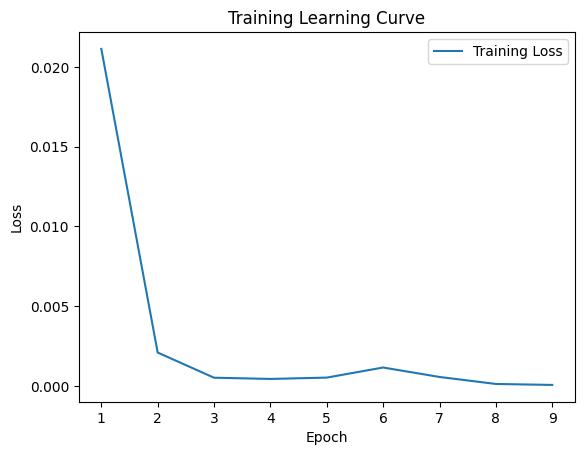


 Epoch: (10/50) Loss = 3.449275391176343e-05

 Epoch: (10/50) Loss_rmse = 0.0058730533346533775

 Epoch: (10/50) R^2 = 0.9831535220146179

 Epoch: (10/50) MAE = 0.0045368969440460205
Spearman correlation coefficient: SignificanceResult(statistic=0.9905946581532542, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

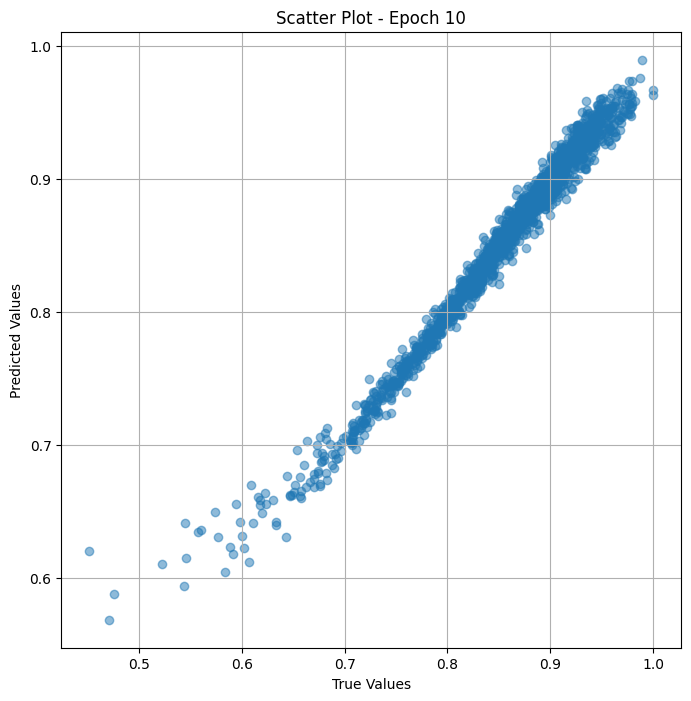

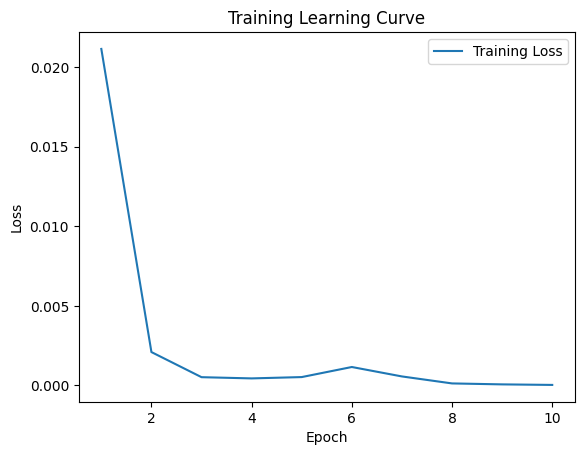


 Epoch: (11/50) Loss = 1.7648690118221566e-05

 Epoch: (11/50) Loss_rmse = 0.004201034549623728

 Epoch: (11/50) R^2 = 0.9913802742958069

 Epoch: (11/50) MAE = 0.0032891035079956055
Spearman correlation coefficient: SignificanceResult(statistic=0.9916812311842337, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

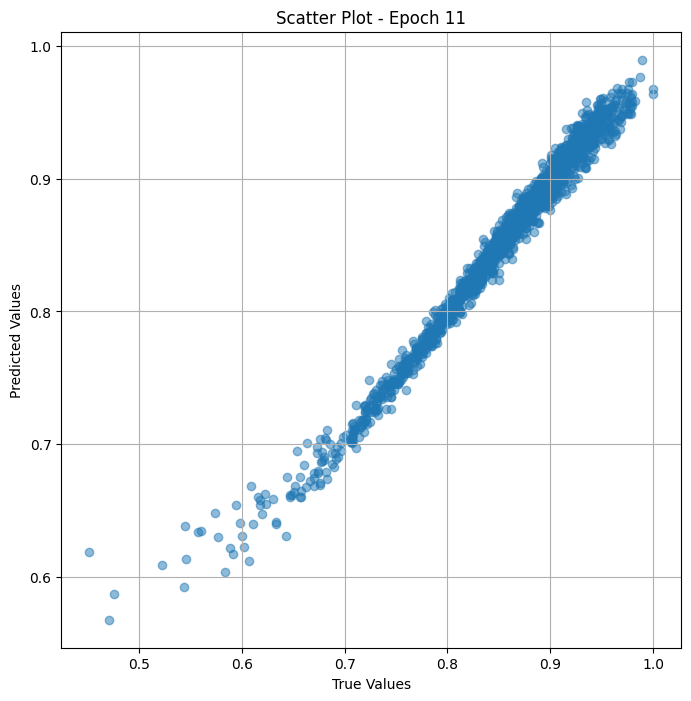

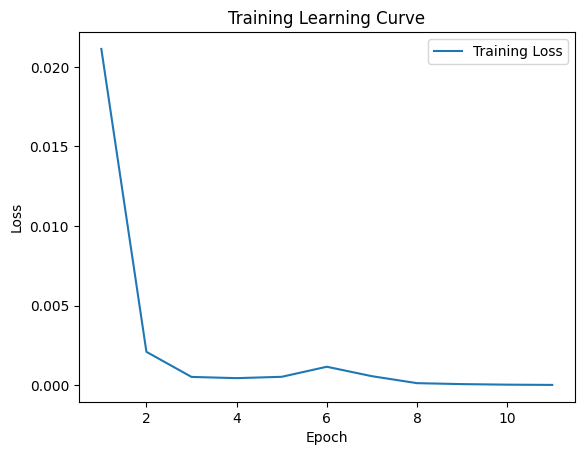


 Epoch: (12/50) Loss = 9.780676919035614e-06

 Epoch: (12/50) Loss_rmse = 0.003127407282590866

 Epoch: (12/50) R^2 = 0.9952230453491211

 Epoch: (12/50) MAE = 0.0024966076016426086
Spearman correlation coefficient: SignificanceResult(statistic=0.9925419352766709, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

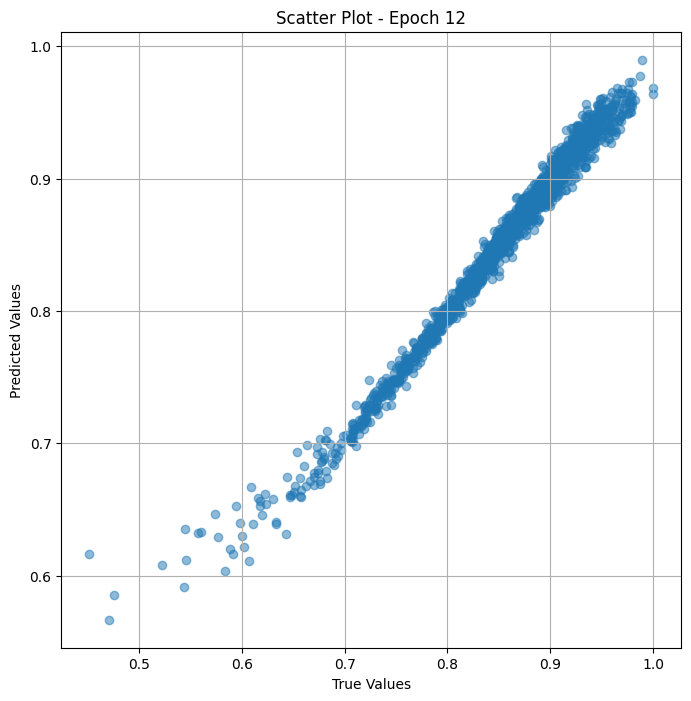

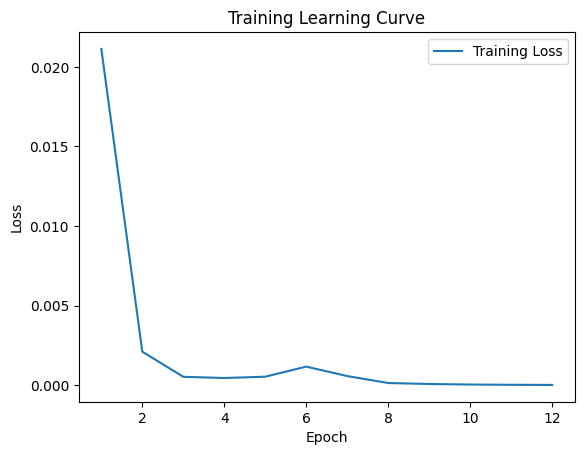


 Epoch: (13/50) Loss = 6.270941412367392e-06

 Epoch: (13/50) Loss_rmse = 0.00250418484210968

 Epoch: (13/50) R^2 = 0.9969372153282166

 Epoch: (13/50) MAE = 0.002056315541267395
Spearman correlation coefficient: SignificanceResult(statistic=0.9932530012494394, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975,

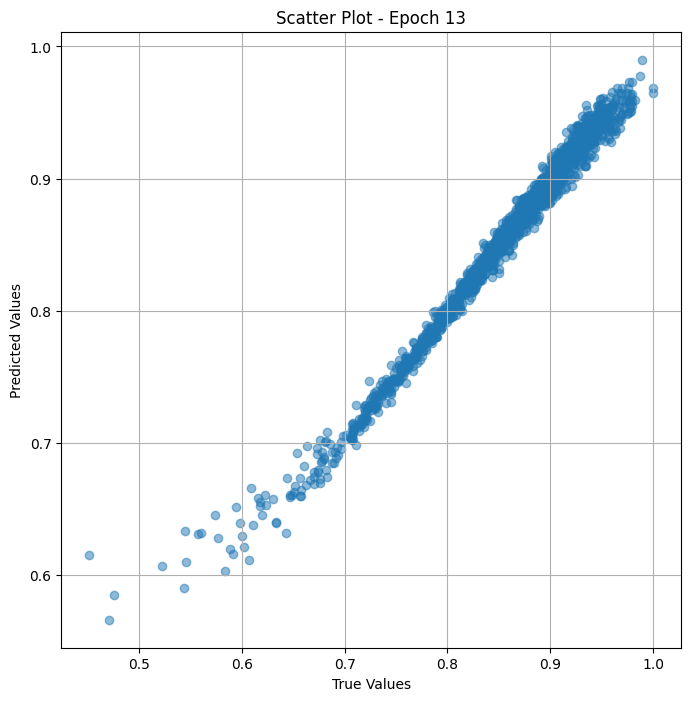

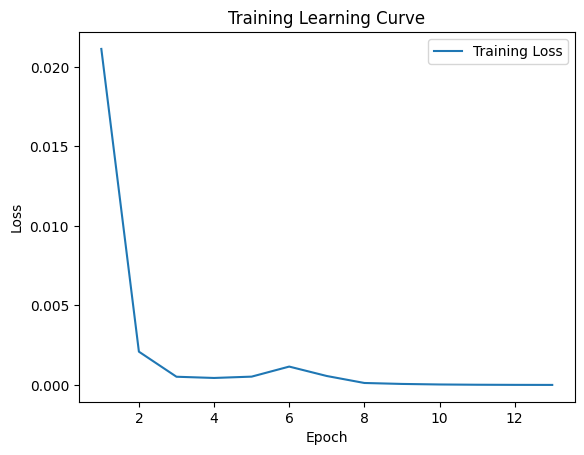


 Epoch: (14/50) Loss = 4.805340722668916e-06

 Epoch: (14/50) Loss_rmse = 0.0021921086590737104

 Epoch: (14/50) R^2 = 0.997653067111969

 Epoch: (14/50) MAE = 0.001844458281993866
Spearman correlation coefficient: SignificanceResult(statistic=0.9938521720200598, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975

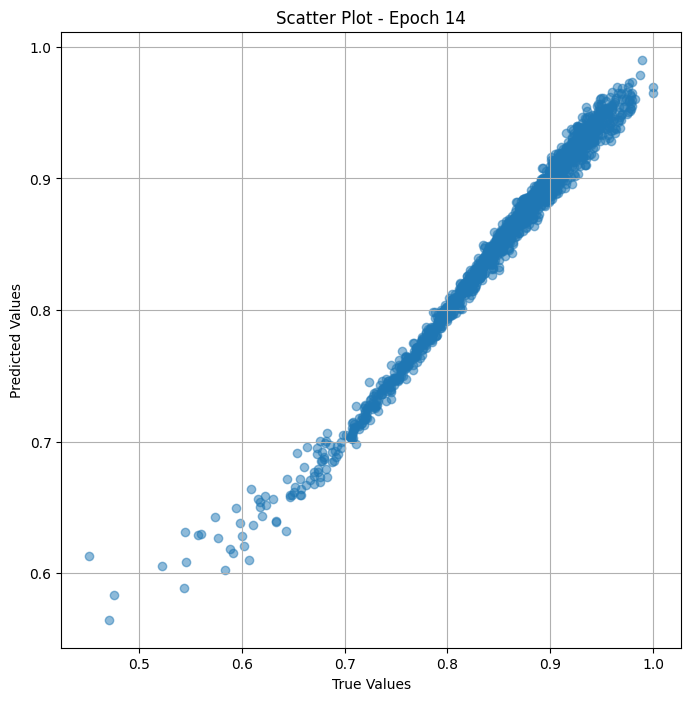

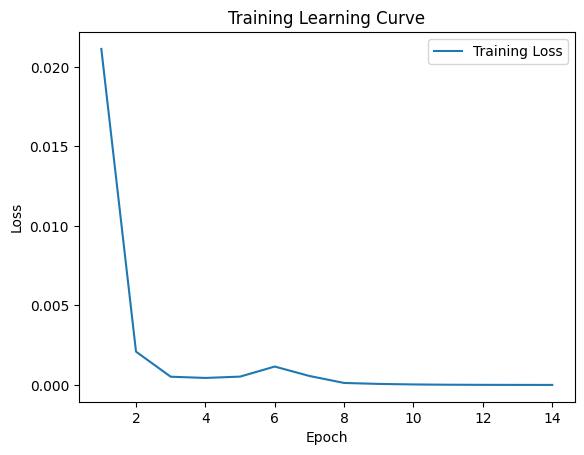


 Epoch: (15/50) Loss = 4.266127234586747e-06

 Epoch: (15/50) Loss_rmse = 0.002065460430458188

 Epoch: (15/50) R^2 = 0.9979164004325867

 Epoch: (15/50) MAE = 0.0018221661448478699
Spearman correlation coefficient: SignificanceResult(statistic=0.9943421386703337, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

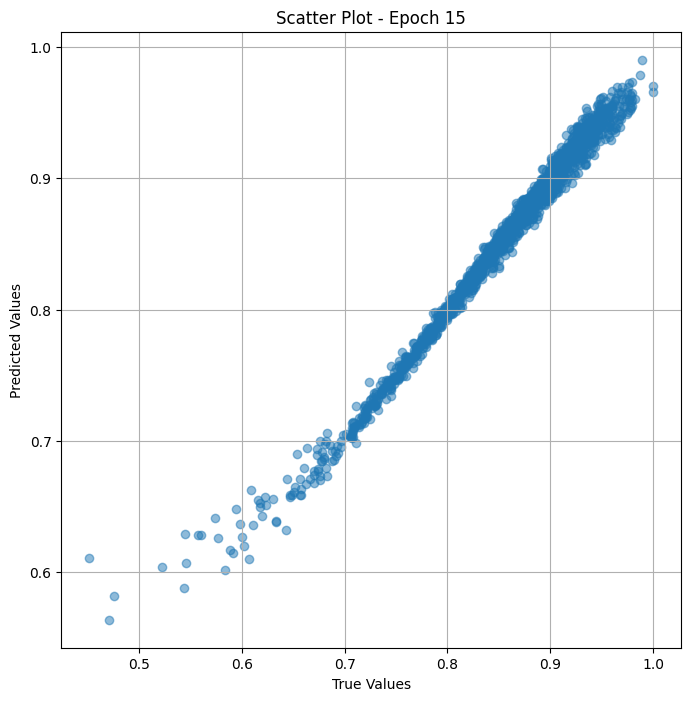

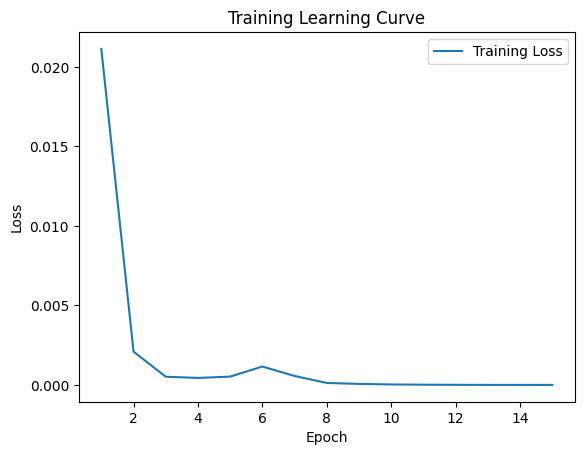


 Epoch: (16/50) Loss = 4.107747372472659e-06

 Epoch: (16/50) Loss_rmse = 0.00202675792388618

 Epoch: (16/50) R^2 = 0.9979937672615051

 Epoch: (16/50) MAE = 0.0018111690878868103
Spearman correlation coefficient: SignificanceResult(statistic=0.9947724985337066, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975

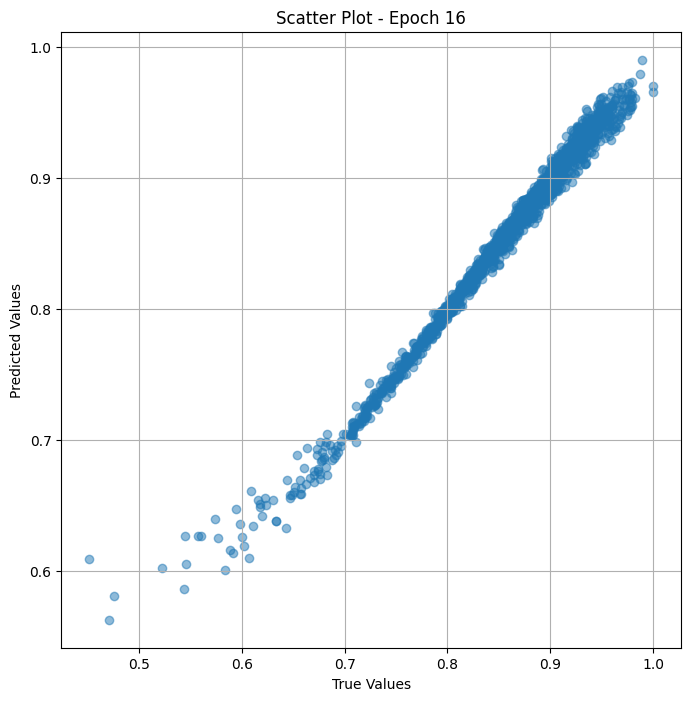

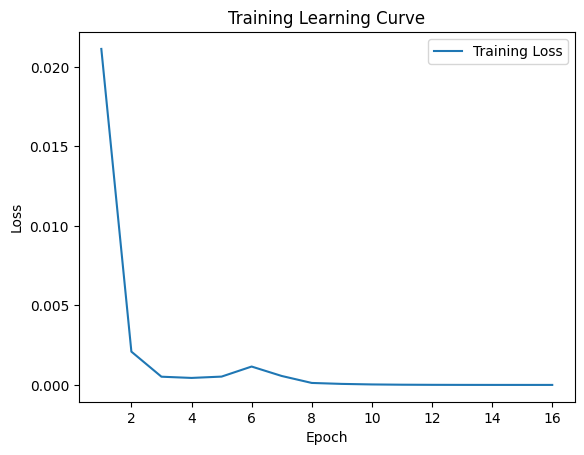


 Epoch: (17/50) Loss = 4.076136065123137e-06

 Epoch: (17/50) Loss_rmse = 0.0020189443603157997

 Epoch: (17/50) R^2 = 0.998009204864502

 Epoch: (17/50) MAE = 0.001804746687412262
Spearman correlation coefficient: SignificanceResult(statistic=0.9951456142600832, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975

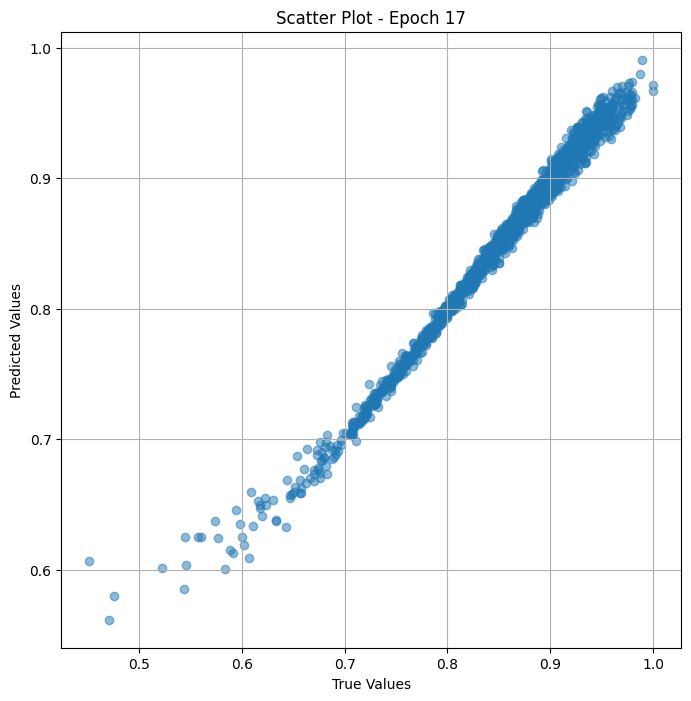

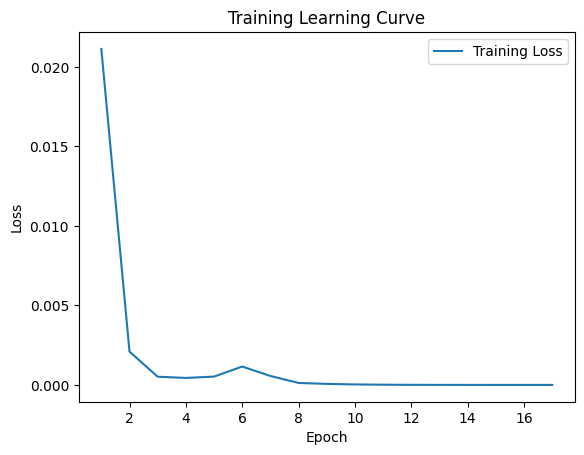


 Epoch: (18/50) Loss = 4.073743639310123e-06

 Epoch: (18/50) Loss_rmse = 0.0020183518063277006

 Epoch: (18/50) R^2 = 0.9980103373527527

 Epoch: (18/50) MAE = 0.001800350844860077
Spearman correlation coefficient: SignificanceResult(statistic=0.995486460471892, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975

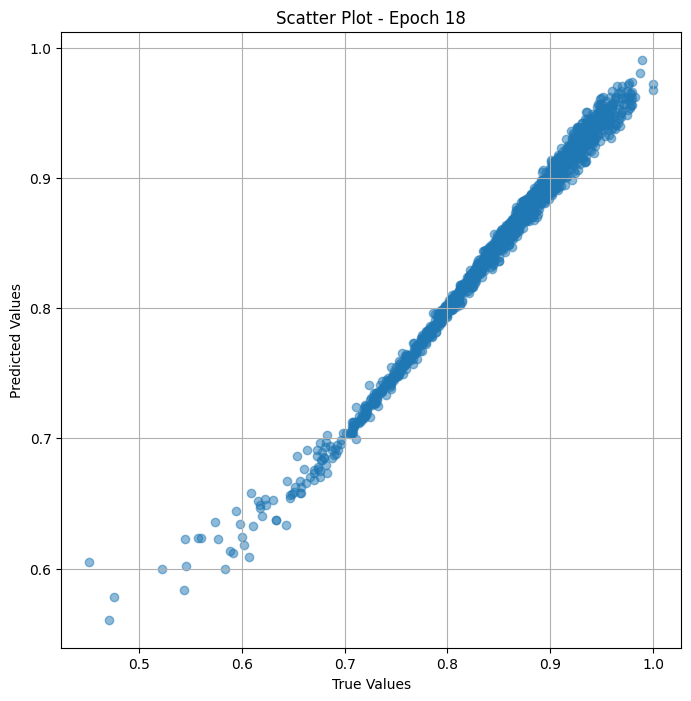

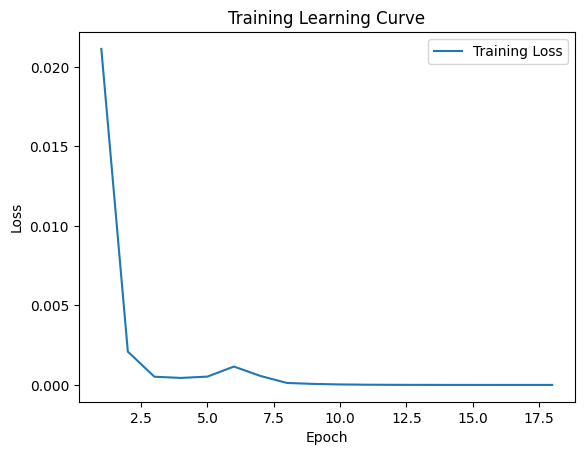


 Epoch: (19/50) Loss = 4.069409897056175e-06

 Epoch: (19/50) Loss_rmse = 0.0020172777585685253

 Epoch: (19/50) R^2 = 0.9980124831199646

 Epoch: (19/50) MAE = 0.0017969310283660889
Spearman correlation coefficient: SignificanceResult(statistic=0.995804413711232, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

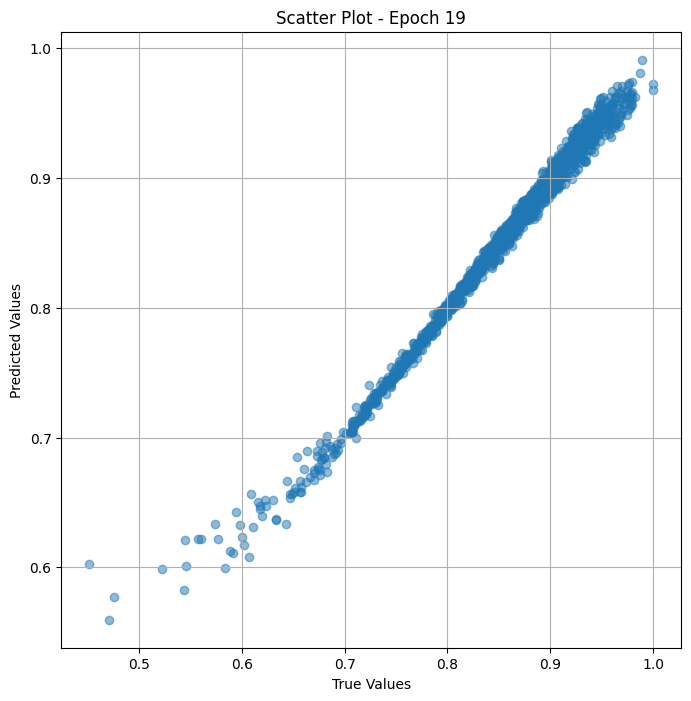

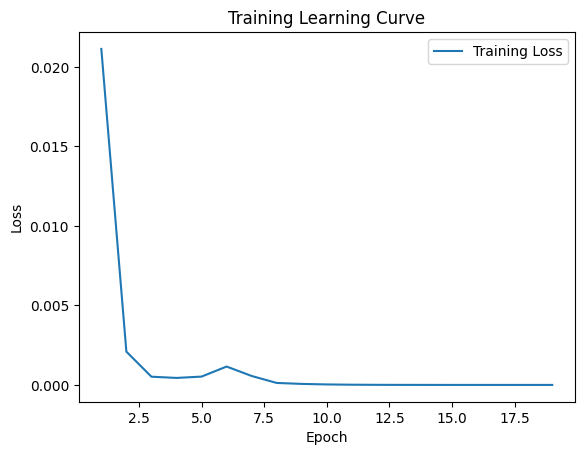


 Epoch: (20/50) Loss = 4.0497270674677566e-06

 Epoch: (20/50) Loss_rmse = 0.0020123934373259544

 Epoch: (20/50) R^2 = 0.9980220794677734

 Epoch: (20/50) MAE = 0.0017879977822303772
Spearman correlation coefficient: SignificanceResult(statistic=0.9961010864558173, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

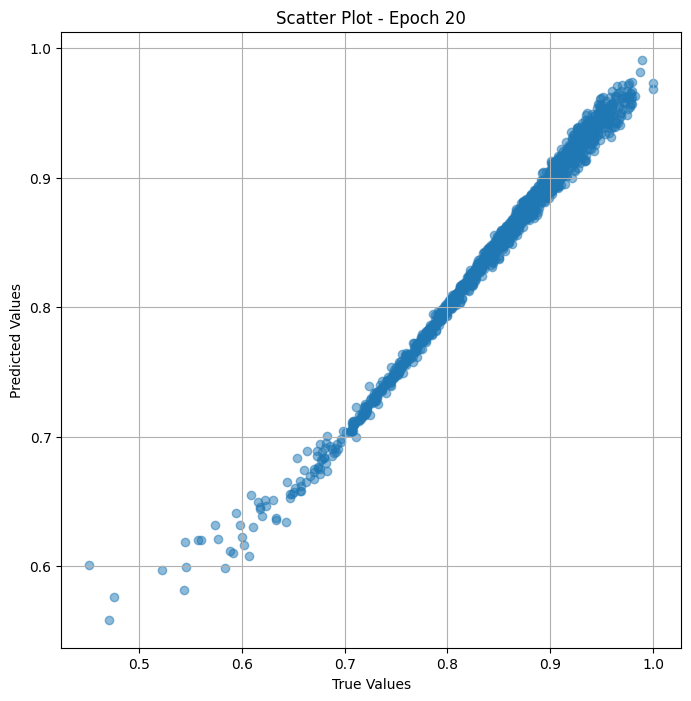

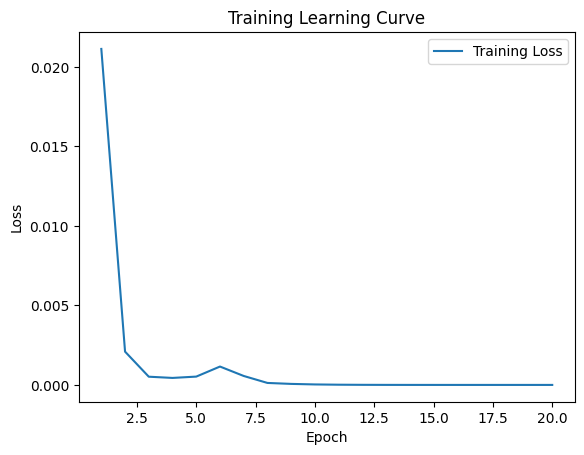


 Epoch: (21/50) Loss = 4.011798864667071e-06

 Epoch: (21/50) Loss_rmse = 0.002002947498112917

 Epoch: (21/50) R^2 = 0.9980406165122986

 Epoch: (21/50) MAE = 0.0017775222659111023
Spearman correlation coefficient: SignificanceResult(statistic=0.9963519279127584, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

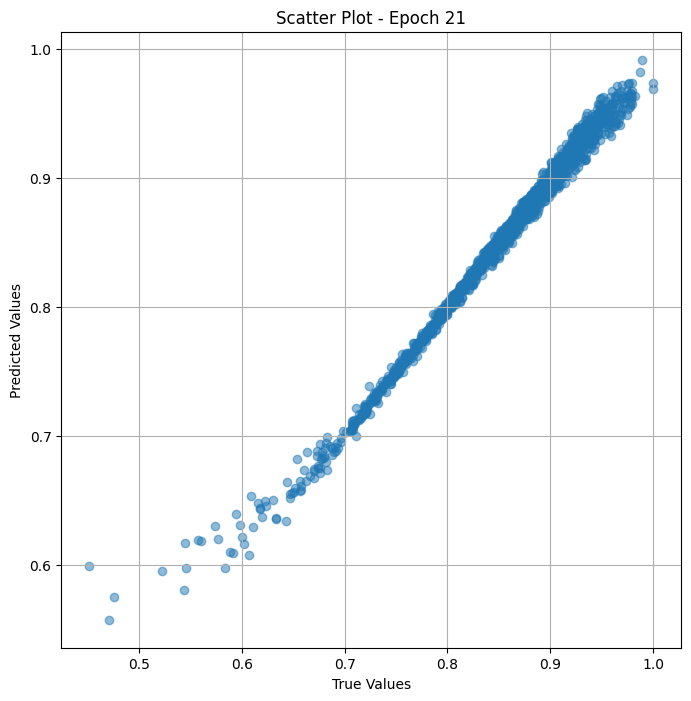

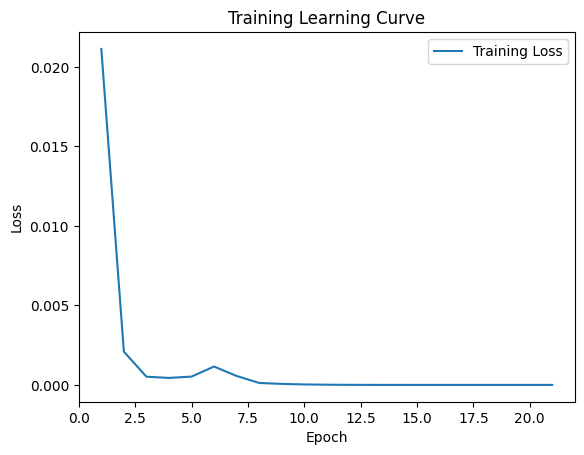


 Epoch: (22/50) Loss = 3.9709948396193795e-06

 Epoch: (22/50) Loss_rmse = 0.0019927355460822582

 Epoch: (22/50) R^2 = 0.9980605244636536

 Epoch: (22/50) MAE = 0.0017659664154052734
Spearman correlation coefficient: SignificanceResult(statistic=0.9965849786223352, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

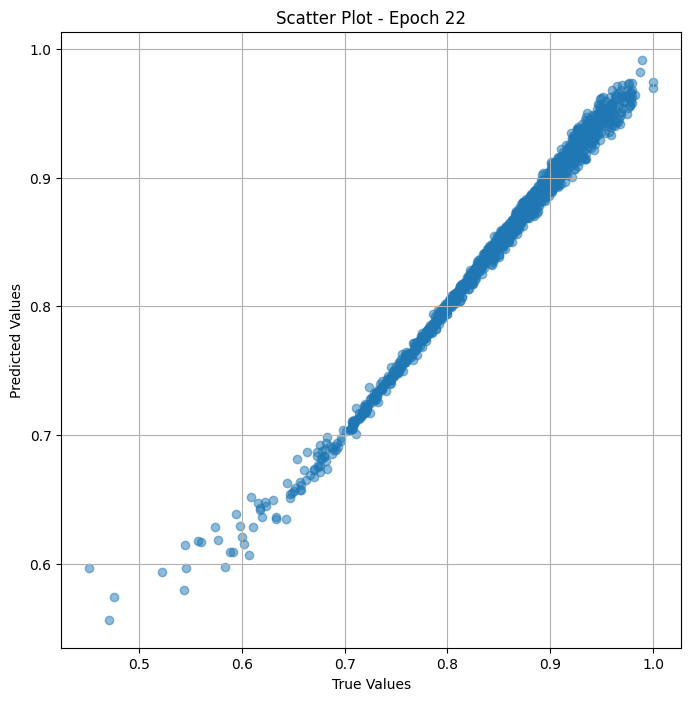

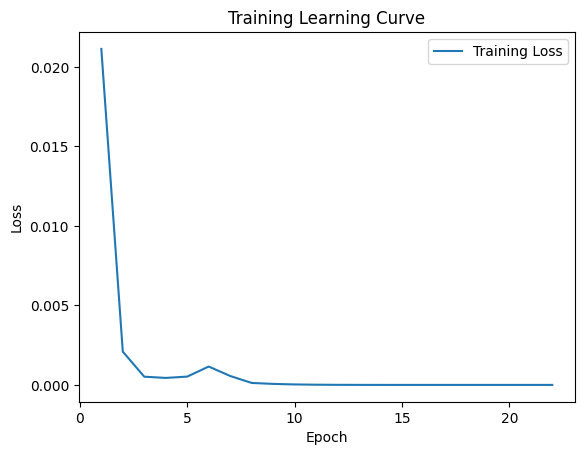


 Epoch: (23/50) Loss = 3.899153853126336e-06

 Epoch: (23/50) Loss_rmse = 0.001974627608433366

 Epoch: (23/50) R^2 = 0.9980956315994263

 Epoch: (23/50) MAE = 0.0017471835017204285
Spearman correlation coefficient: SignificanceResult(statistic=0.9968034608879012, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

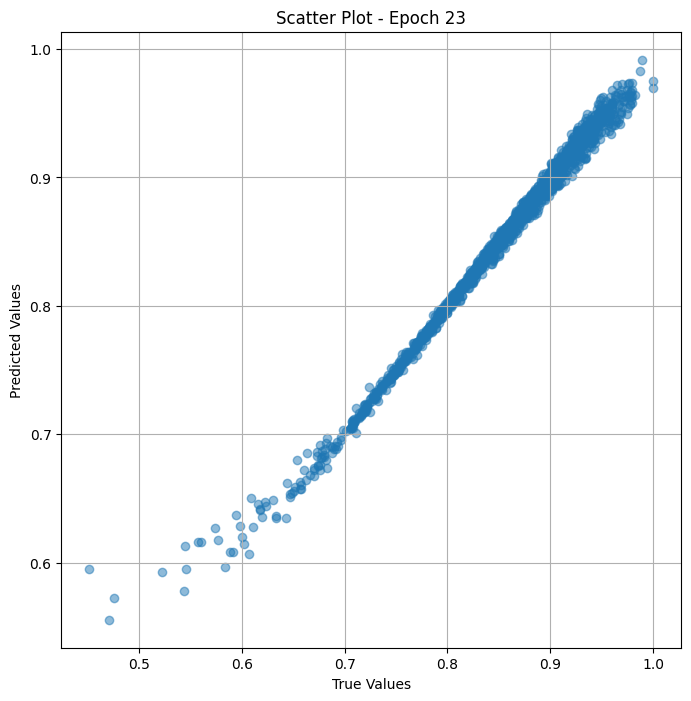

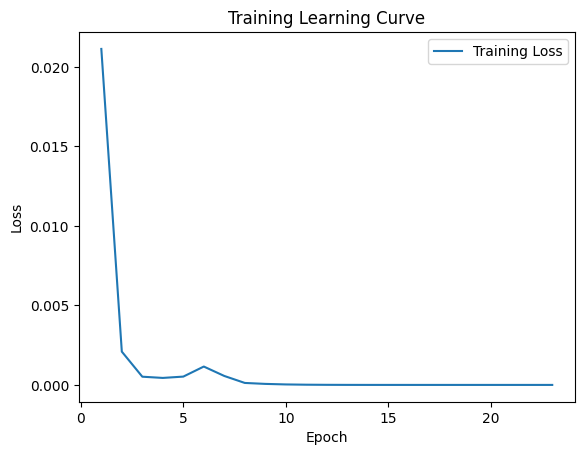


 Epoch: (24/50) Loss = 3.814183855865849e-06

 Epoch: (24/50) Loss_rmse = 0.0019529935671016574

 Epoch: (24/50) R^2 = 0.9981371164321899

 Epoch: (24/50) MAE = 0.0017299503087997437
Spearman correlation coefficient: SignificanceResult(statistic=0.9970028042614406, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

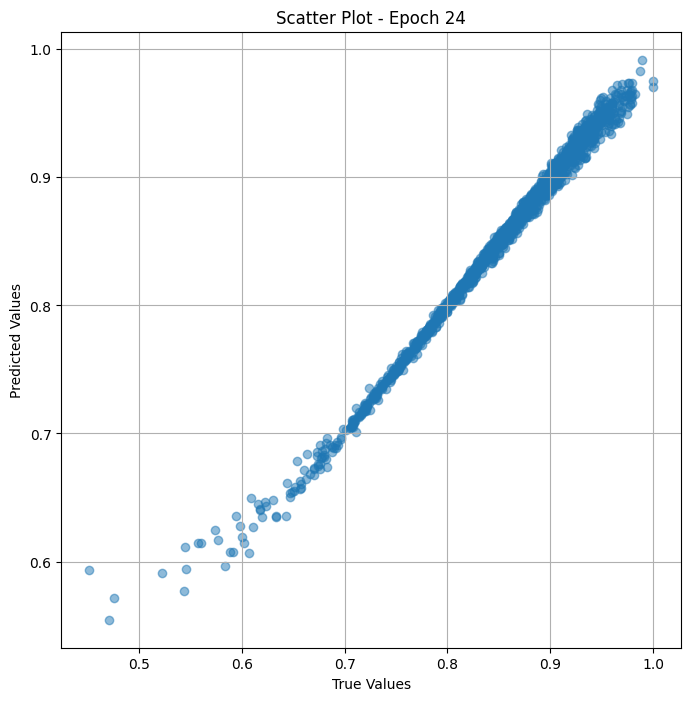

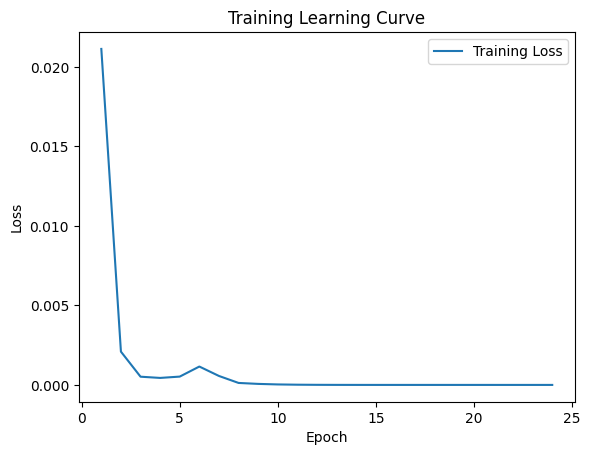


 Epoch: (25/50) Loss = 3.7096936011948856e-06

 Epoch: (25/50) Loss_rmse = 0.0019260564586147666

 Epoch: (25/50) R^2 = 0.9981881380081177

 Epoch: (25/50) MAE = 0.0017039254307746887
Spearman correlation coefficient: SignificanceResult(statistic=0.9972056571928902, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

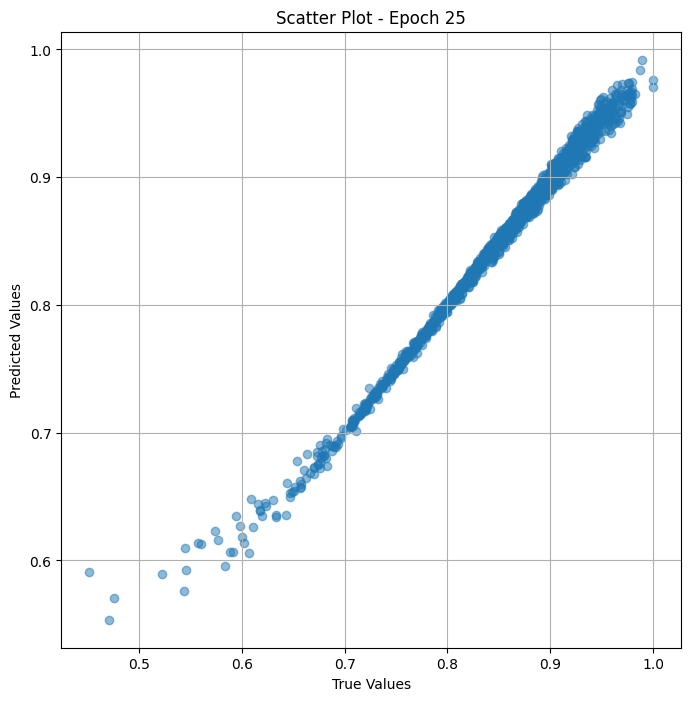

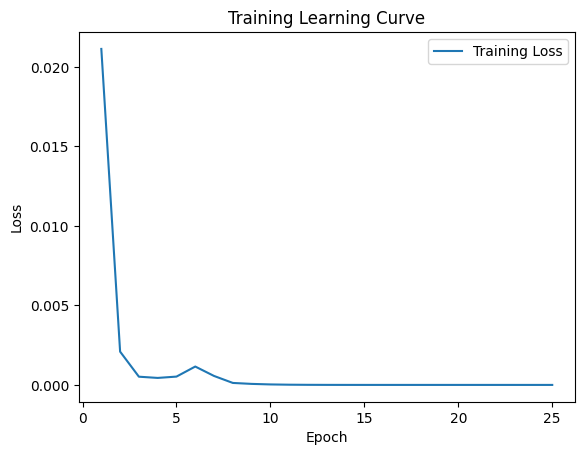


 Epoch: (26/50) Loss = 3.5959667457063915e-06

 Epoch: (26/50) Loss_rmse = 0.001896303496323526

 Epoch: (26/50) R^2 = 0.9982436895370483

 Epoch: (26/50) MAE = 0.0016795918345451355
Spearman correlation coefficient: SignificanceResult(statistic=0.9973915425475569, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

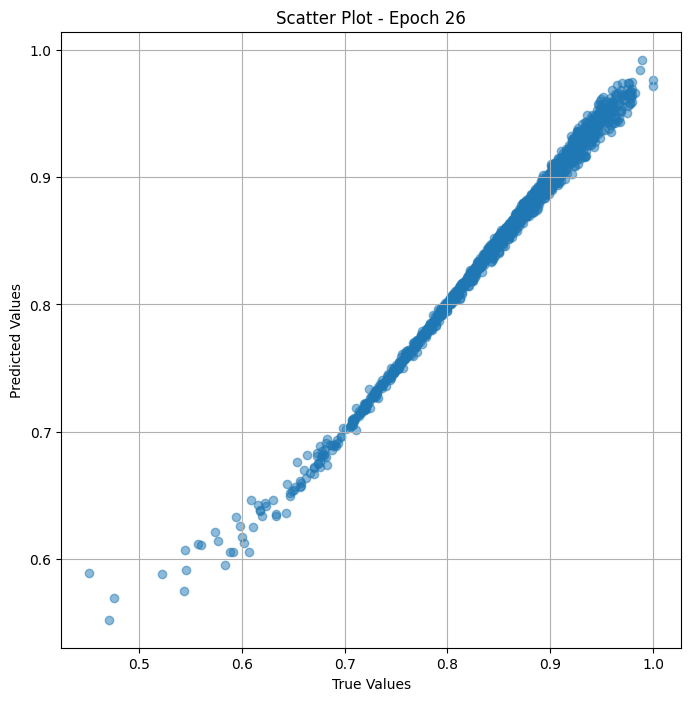

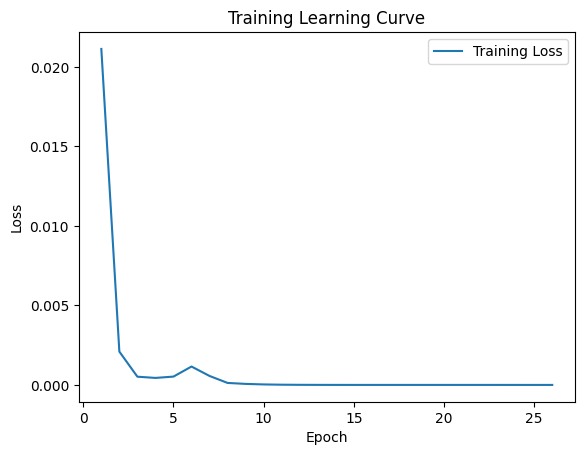


 Epoch: (27/50) Loss = 3.460019570411532e-06

 Epoch: (27/50) Loss_rmse = 0.0018601127667352557

 Epoch: (27/50) R^2 = 0.9983100891113281

 Epoch: (27/50) MAE = 0.0016460716724395752
Spearman correlation coefficient: SignificanceResult(statistic=0.9975665374155326, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

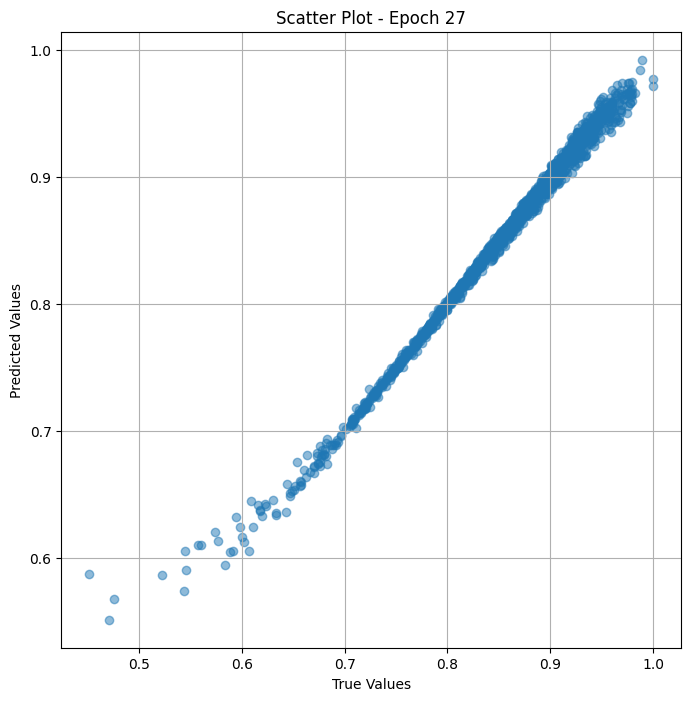

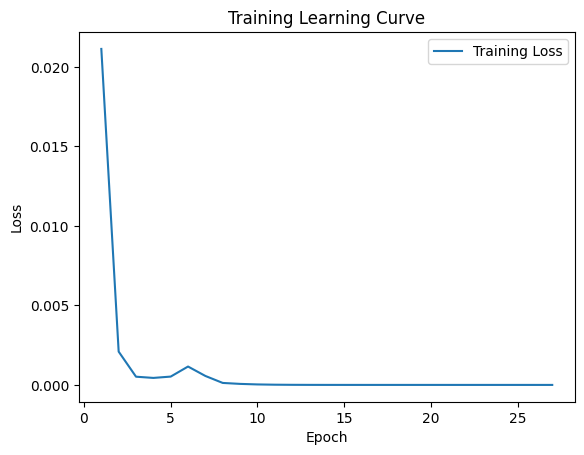


 Epoch: (28/50) Loss = 3.3191204238391947e-06

 Epoch: (28/50) Loss_rmse = 0.0018218453042209148

 Epoch: (28/50) R^2 = 0.9983789324760437

 Epoch: (28/50) MAE = 0.0016135051846504211
Spearman correlation coefficient: SignificanceResult(statistic=0.9977346341030493, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

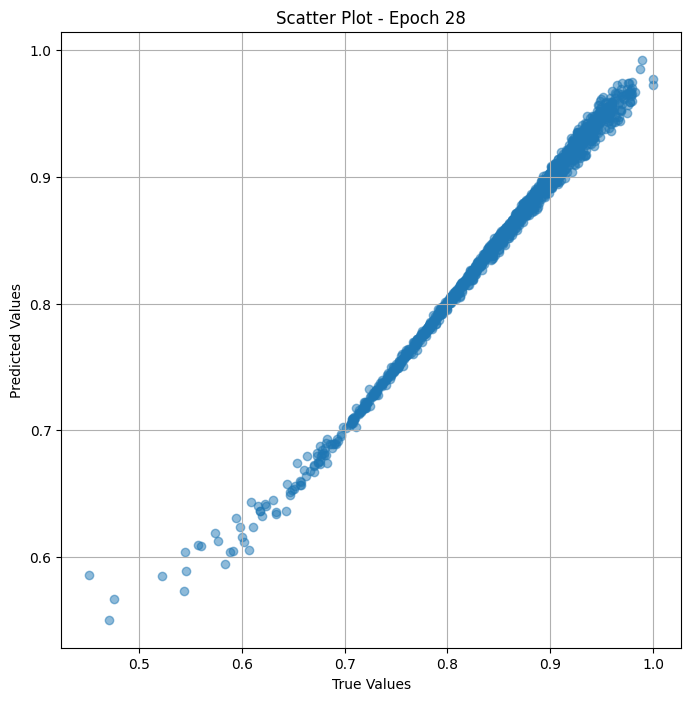

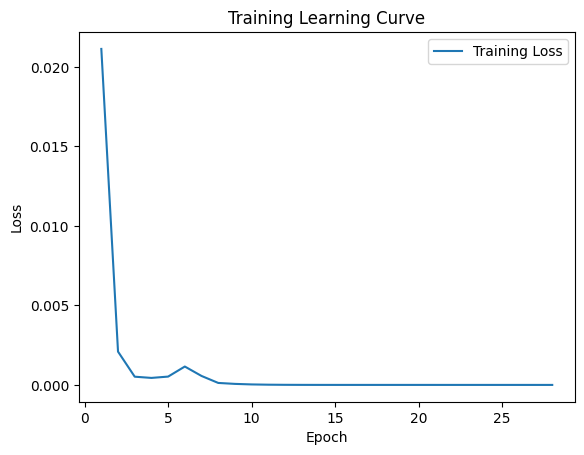


 Epoch: (29/50) Loss = 3.168984221701976e-06

 Epoch: (29/50) Loss_rmse = 0.001780164078809321

 Epoch: (29/50) R^2 = 0.9984522461891174

 Epoch: (29/50) MAE = 0.001573309302330017
Spearman correlation coefficient: SignificanceResult(statistic=0.9978835121292333, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975

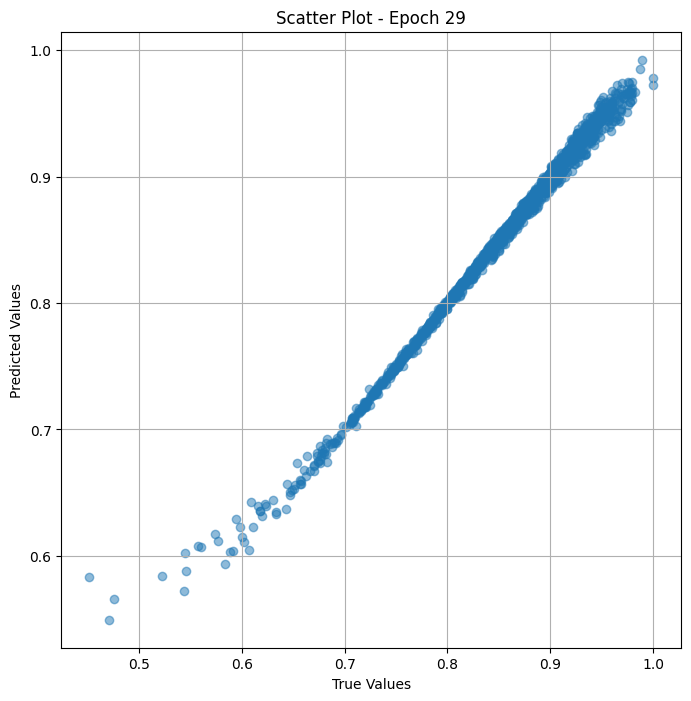

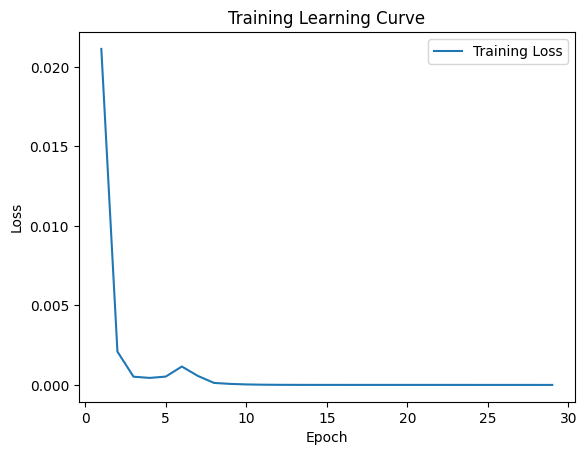


 Epoch: (30/50) Loss = 3.0198207241483033e-06

 Epoch: (30/50) Loss_rmse = 0.001737763173878193

 Epoch: (30/50) R^2 = 0.998525083065033

 Epoch: (30/50) MAE = 0.0015340521931648254
Spearman correlation coefficient: SignificanceResult(statistic=0.99803226816748, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.975,

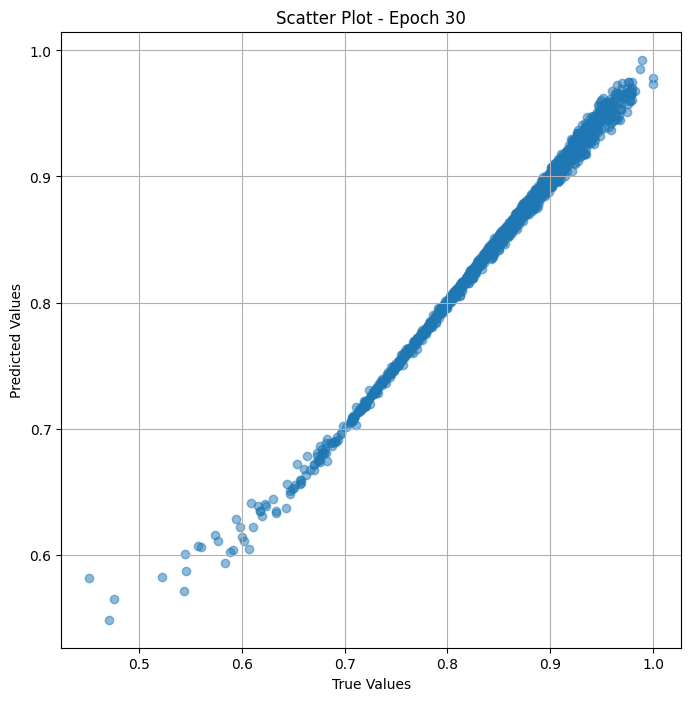

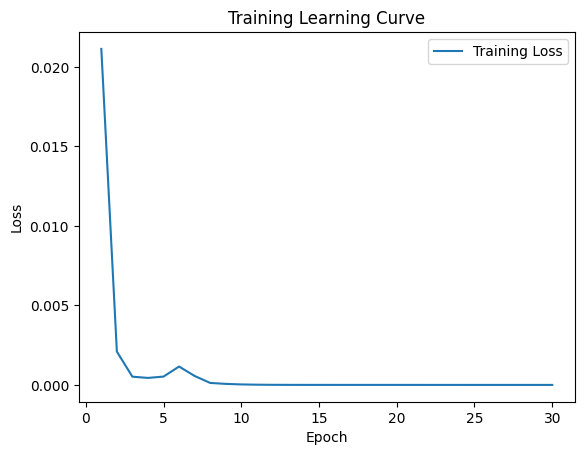


 Epoch: (31/50) Loss = 2.8586869120772462e-06

 Epoch: (31/50) Loss_rmse = 0.001690765144303441

 Epoch: (31/50) R^2 = 0.9986038208007812

 Epoch: (31/50) MAE = 0.001495465636253357
Spearman correlation coefficient: SignificanceResult(statistic=0.9981687151911568, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

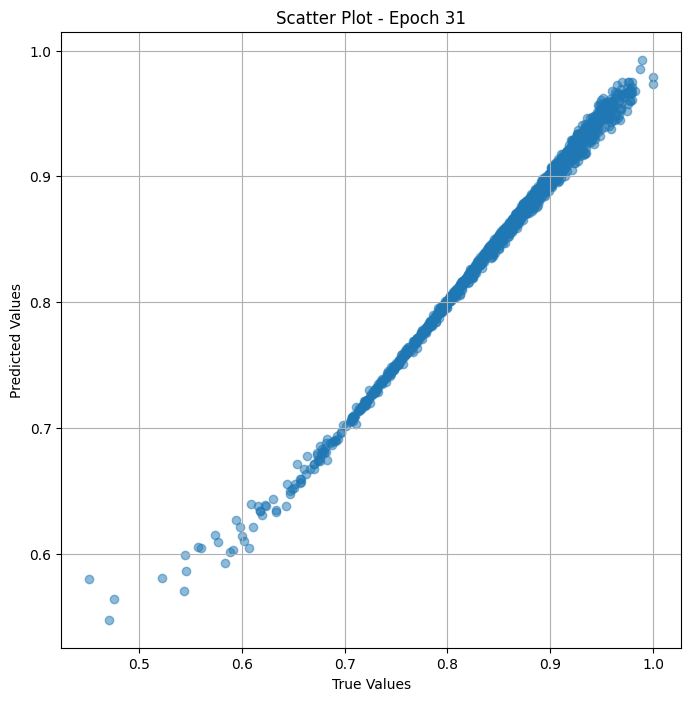

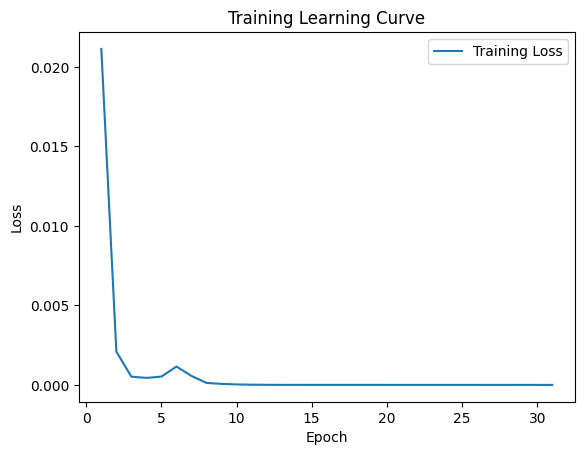


 Epoch: (32/50) Loss = 2.680605803107028e-06

 Epoch: (32/50) Loss_rmse = 0.0016372555401176214

 Epoch: (32/50) R^2 = 0.9986907839775085

 Epoch: (32/50) MAE = 0.001446351408958435
Spearman correlation coefficient: SignificanceResult(statistic=0.9982967011014025, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

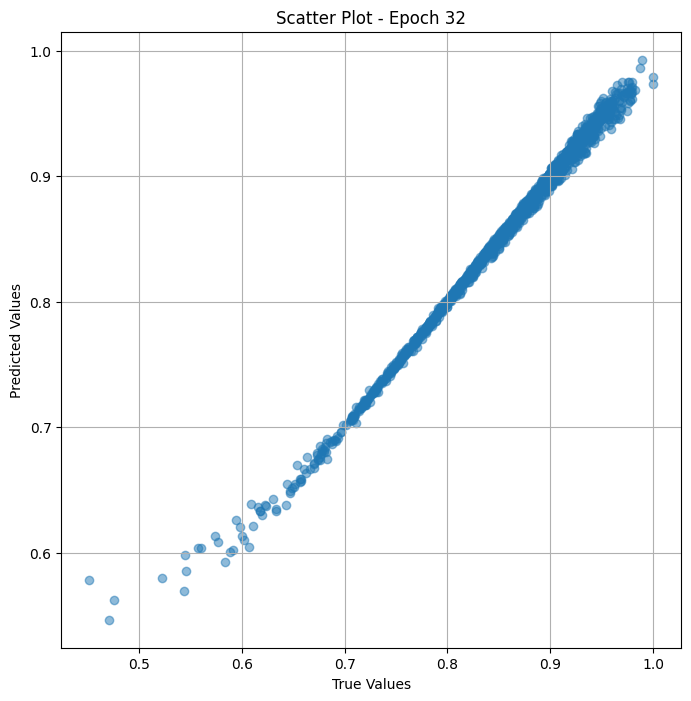

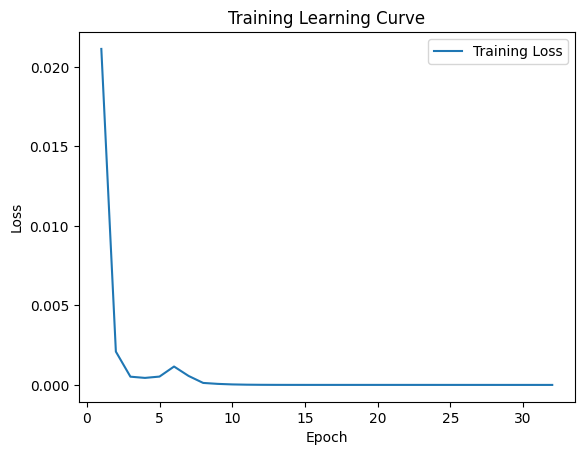


 Epoch: (33/50) Loss = 2.5107540295721265e-06

 Epoch: (33/50) Loss_rmse = 0.0015845359303057194

 Epoch: (33/50) R^2 = 0.9987737536430359

 Epoch: (33/50) MAE = 0.0014006644487380981
Spearman correlation coefficient: SignificanceResult(statistic=0.9984190092574882, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

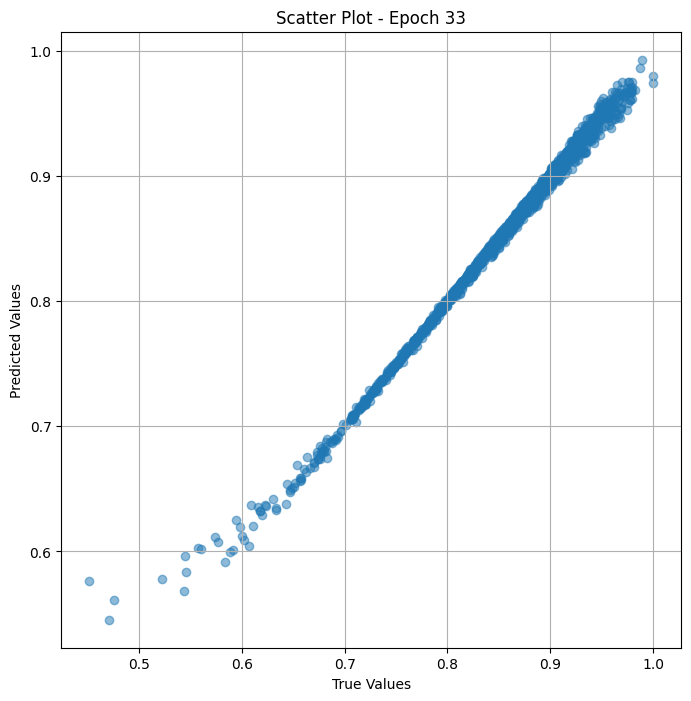

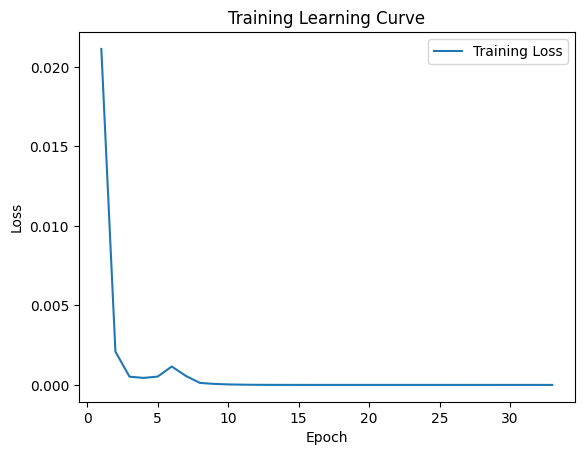


 Epoch: (34/50) Loss = 2.336178113182541e-06

 Epoch: (34/50) Loss_rmse = 0.0015284561086446047

 Epoch: (34/50) R^2 = 0.9988589882850647

 Epoch: (34/50) MAE = 0.0013506338000297546
Spearman correlation coefficient: SignificanceResult(statistic=0.9985429220524458, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

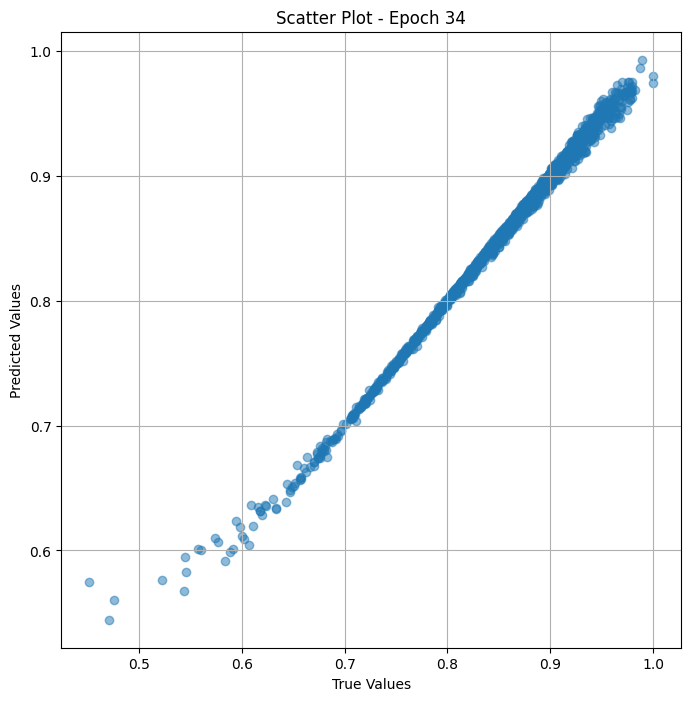

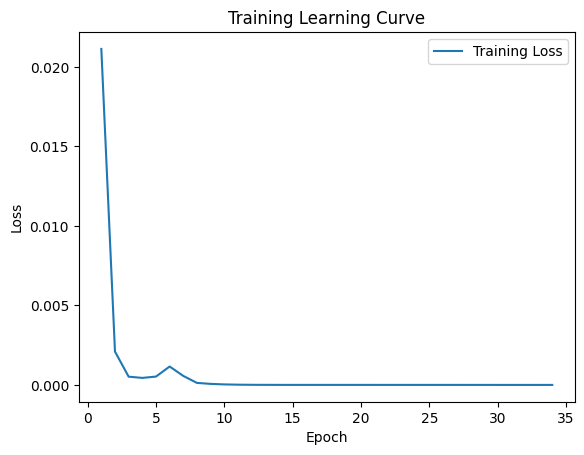


 Epoch: (35/50) Loss = 2.164194029319333e-06

 Epoch: (35/50) Loss_rmse = 0.0014711200492456555

 Epoch: (35/50) R^2 = 0.9989429712295532

 Epoch: (35/50) MAE = 0.001301102340221405
Spearman correlation coefficient: SignificanceResult(statistic=0.9986499611091539, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

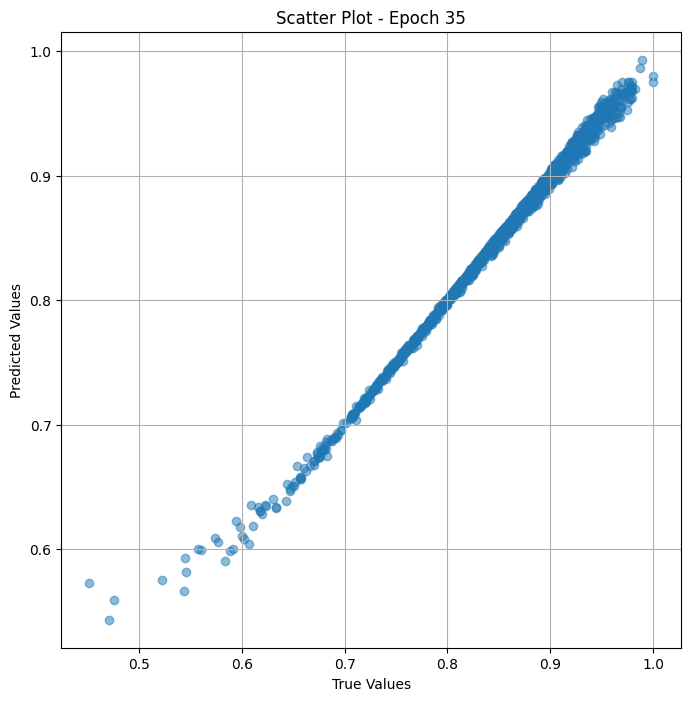

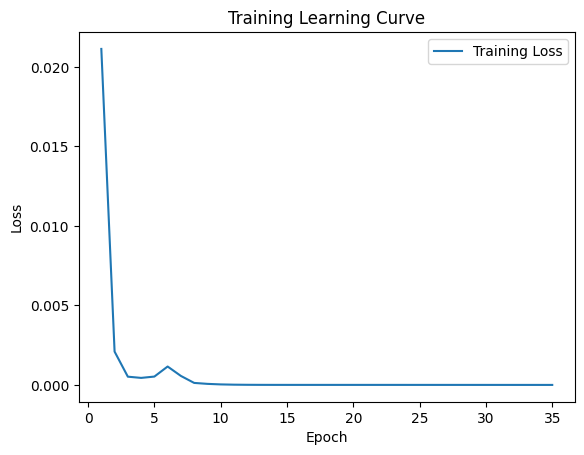


 Epoch: (36/50) Loss = 1.990763394132955e-06

 Epoch: (36/50) Loss_rmse = 0.0014109441544860601

 Epoch: (36/50) R^2 = 0.9990277290344238

 Epoch: (36/50) MAE = 0.0012494102120399475
Spearman correlation coefficient: SignificanceResult(statistic=0.9987502901856582, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

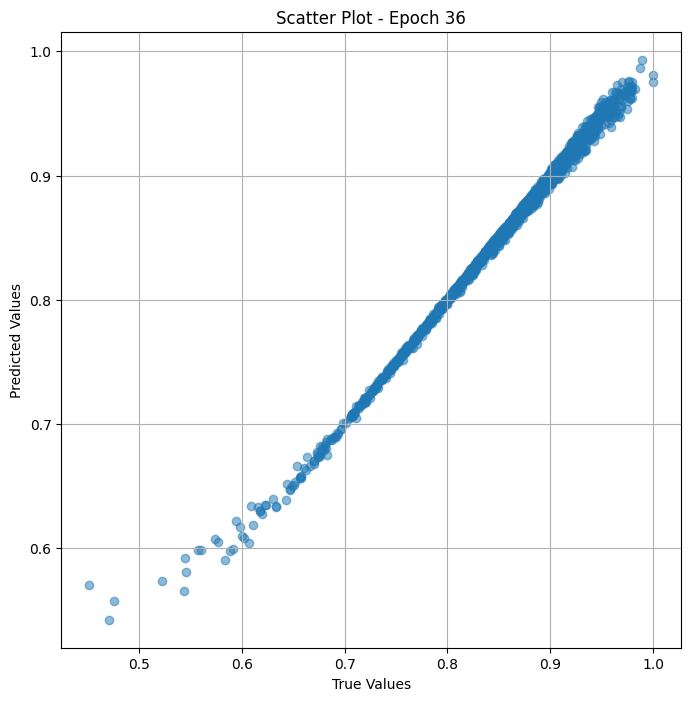

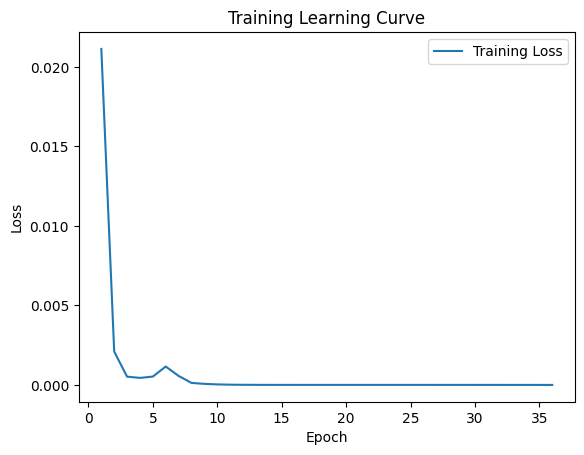


 Epoch: (37/50) Loss = 1.8312840666112606e-06

 Epoch: (37/50) Loss_rmse = 0.0013532494194805622

 Epoch: (37/50) R^2 = 0.9991055727005005

 Epoch: (37/50) MAE = 0.0011999383568763733
Spearman correlation coefficient: SignificanceResult(statistic=0.998844943071626, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

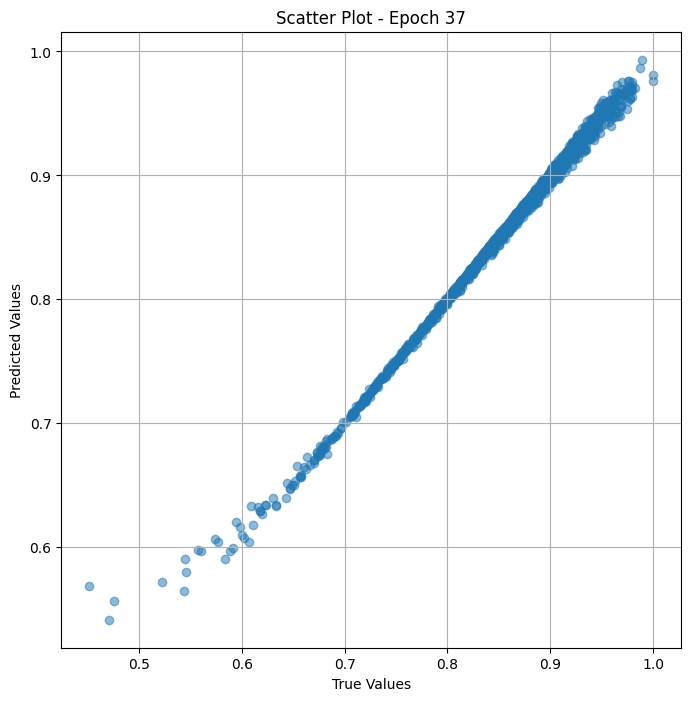

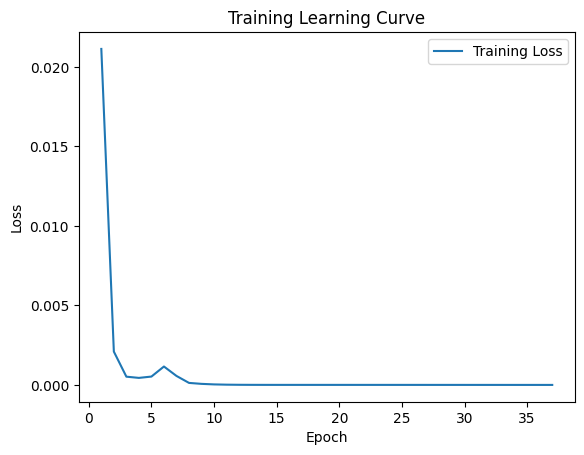


 Epoch: (38/50) Loss = 1.6774006326158997e-06

 Epoch: (38/50) Loss_rmse = 0.0012951450189575553

 Epoch: (38/50) R^2 = 0.9991807341575623

 Epoch: (38/50) MAE = 0.001142852008342743
Spearman correlation coefficient: SignificanceResult(statistic=0.998927445946778, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

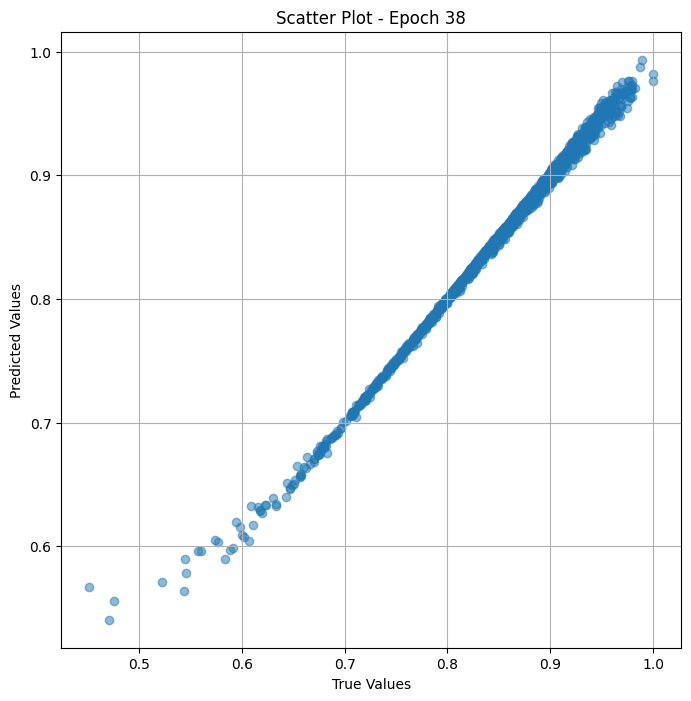

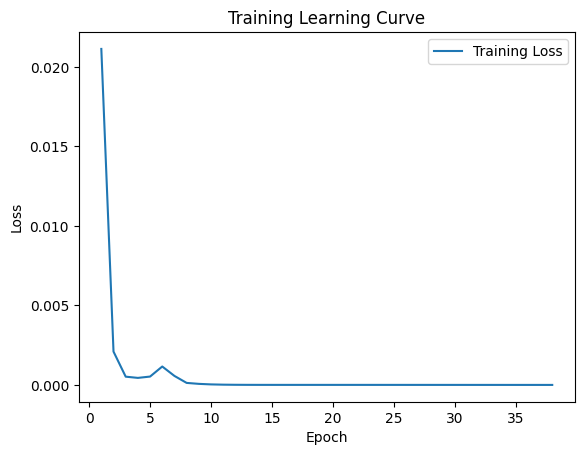


 Epoch: (39/50) Loss = 1.5319363910748507e-06

 Epoch: (39/50) Loss_rmse = 0.001237714197486639

 Epoch: (39/50) R^2 = 0.9992517828941345

 Epoch: (39/50) MAE = 0.001091398298740387
Spearman correlation coefficient: SignificanceResult(statistic=0.9990060513931142, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

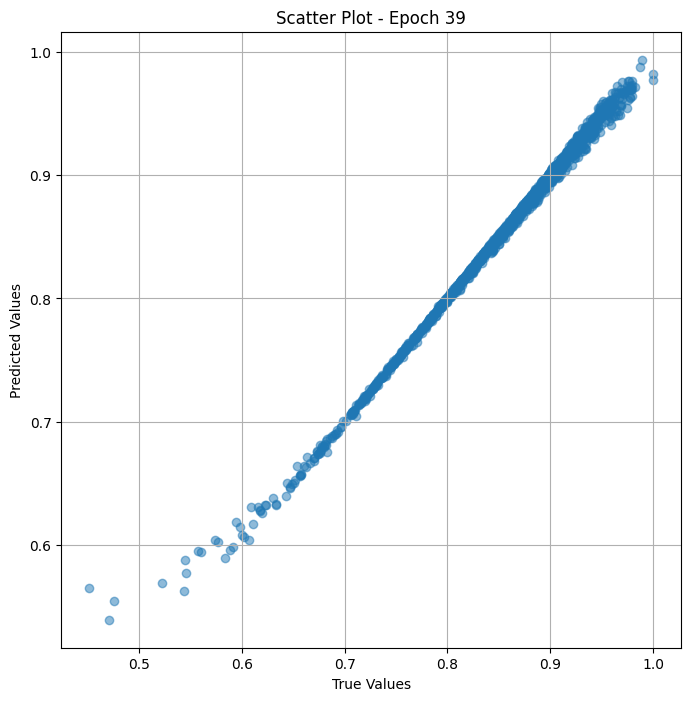

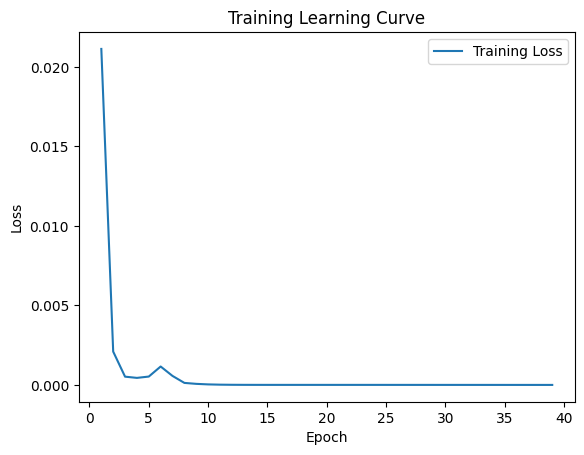


 Epoch: (40/50) Loss = 1.3972171473142225e-06

 Epoch: (40/50) Loss_rmse = 0.0011820393847301602

 Epoch: (40/50) R^2 = 0.9993175864219666

 Epoch: (40/50) MAE = 0.0010471269488334656
Spearman correlation coefficient: SignificanceResult(statistic=0.9990861551286984, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.

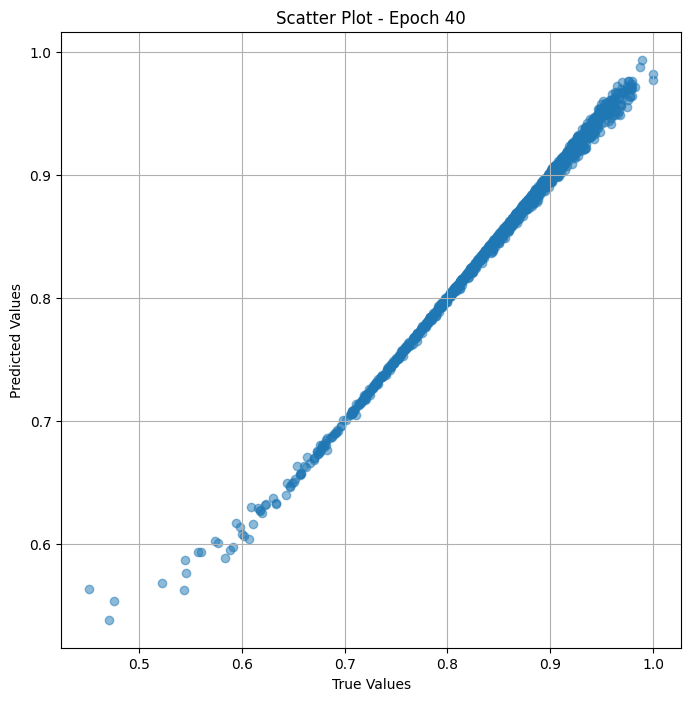

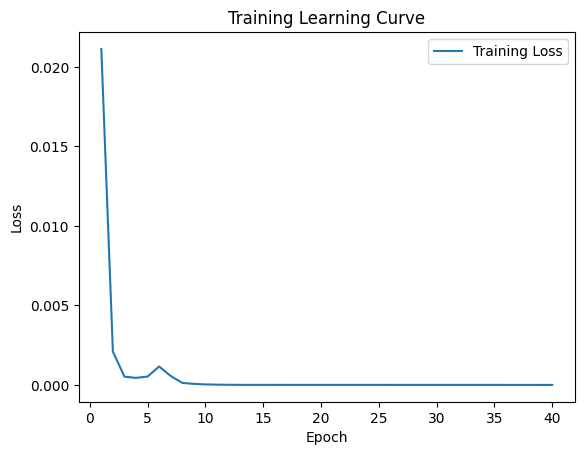


 Epoch: (41/50) Loss = 1.2735379186779028e-06

 Epoch: (41/50) Loss_rmse = 0.001128511386923492

 Epoch: (41/50) R^2 = 0.9993780255317688

 Epoch: (41/50) MAE = 0.0009936690330505371
Spearman correlation coefficient: SignificanceResult(statistic=0.9991589597866821, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

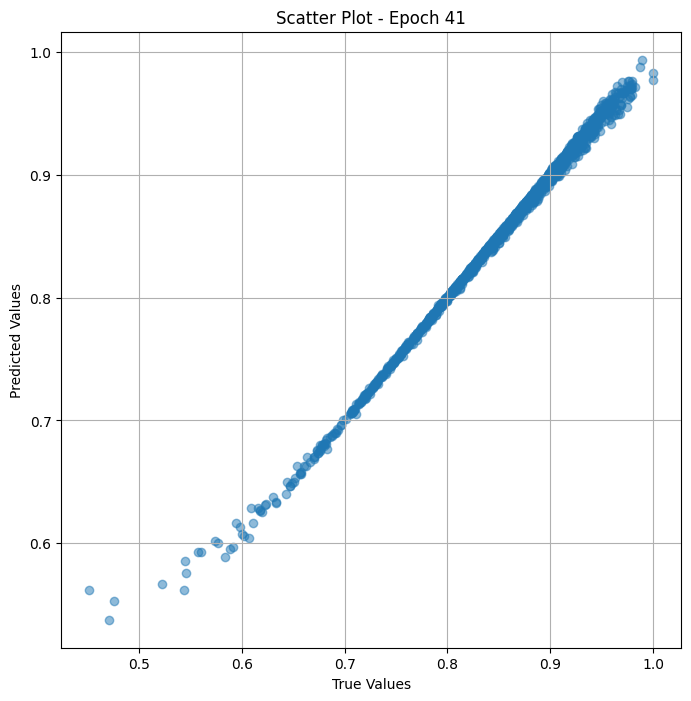

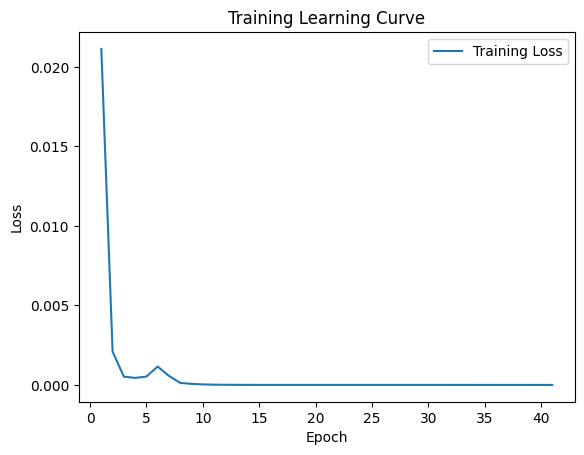


 Epoch: (42/50) Loss = 1.151166770796408e-06

 Epoch: (42/50) Loss_rmse = 0.0010729243513196707

 Epoch: (42/50) R^2 = 0.9994377493858337

 Epoch: (42/50) MAE = 0.0009508430957794189
Spearman correlation coefficient: SignificanceResult(statistic=0.9992256983017811, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

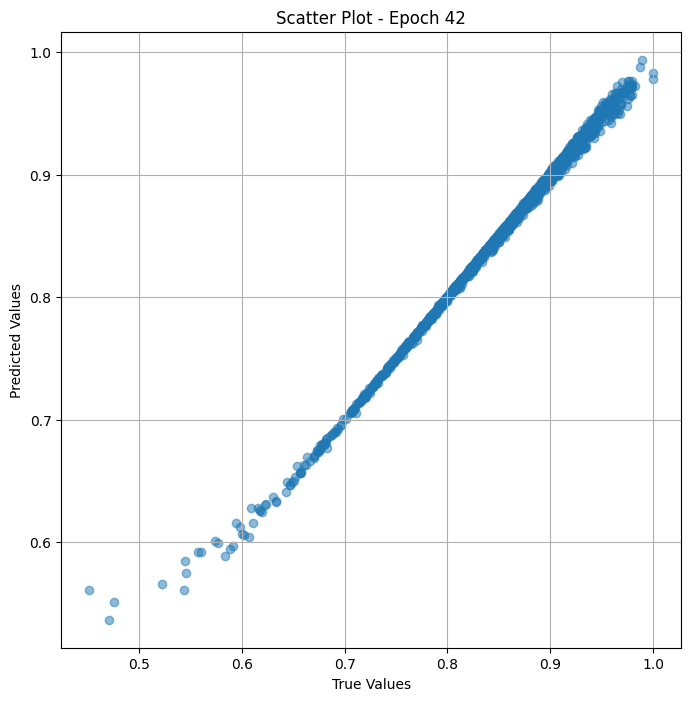

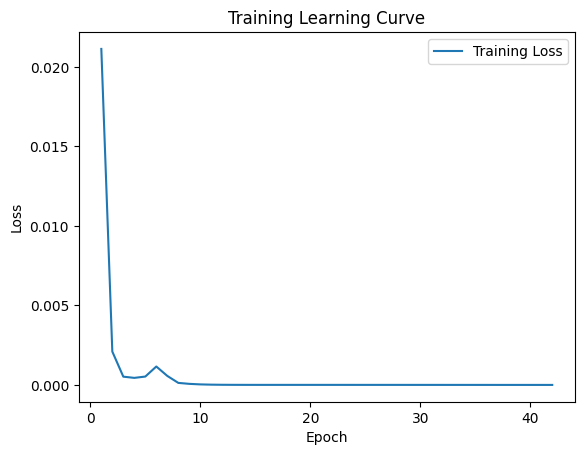


 Epoch: (43/50) Loss = 1.0416043778604944e-06

 Epoch: (43/50) Loss_rmse = 0.0010205901926383376

 Epoch: (43/50) R^2 = 0.999491274356842

 Epoch: (43/50) MAE = 0.0008977130055427551
Spearman correlation coefficient: SignificanceResult(statistic=0.9992880196286165, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

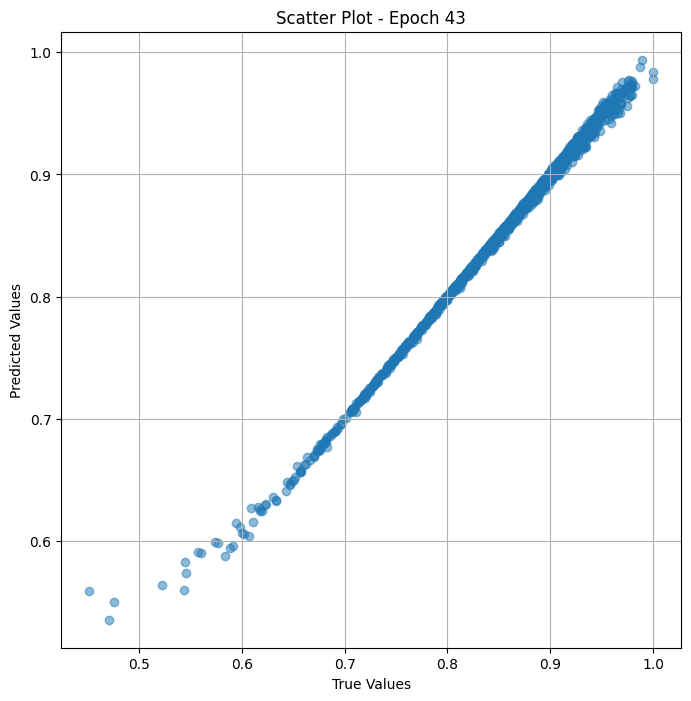

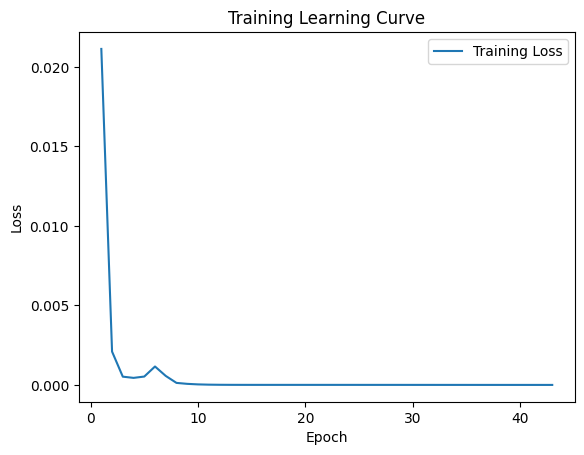


 Epoch: (44/50) Loss = 9.374842875331524e-07

 Epoch: (44/50) Loss_rmse = 0.0009682376985438168

 Epoch: (44/50) R^2 = 0.9995421171188354

 Epoch: (44/50) MAE = 0.0008594617247581482
Spearman correlation coefficient: SignificanceResult(statistic=0.9993475450849995, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

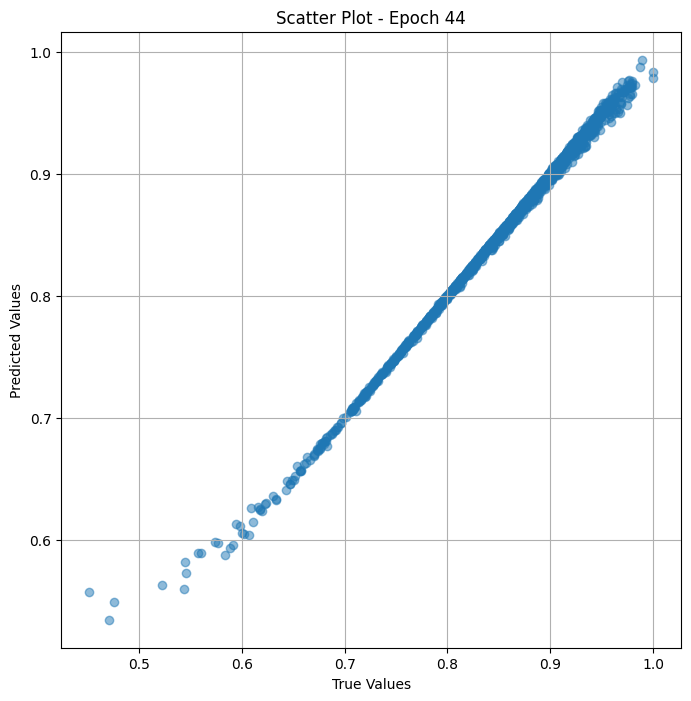

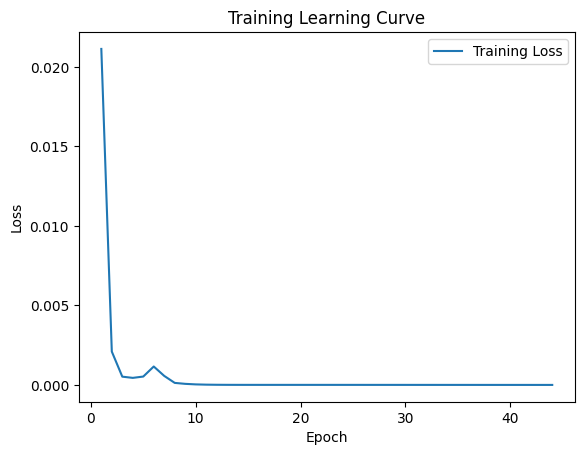


 Epoch: (45/50) Loss = 8.417578669650538e-07

 Epoch: (45/50) Loss_rmse = 0.0009174736333079636

 Epoch: (45/50) R^2 = 0.9995889067649841

 Epoch: (45/50) MAE = 0.0008053705096244812
Spearman correlation coefficient: SignificanceResult(statistic=0.9993987679148474, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

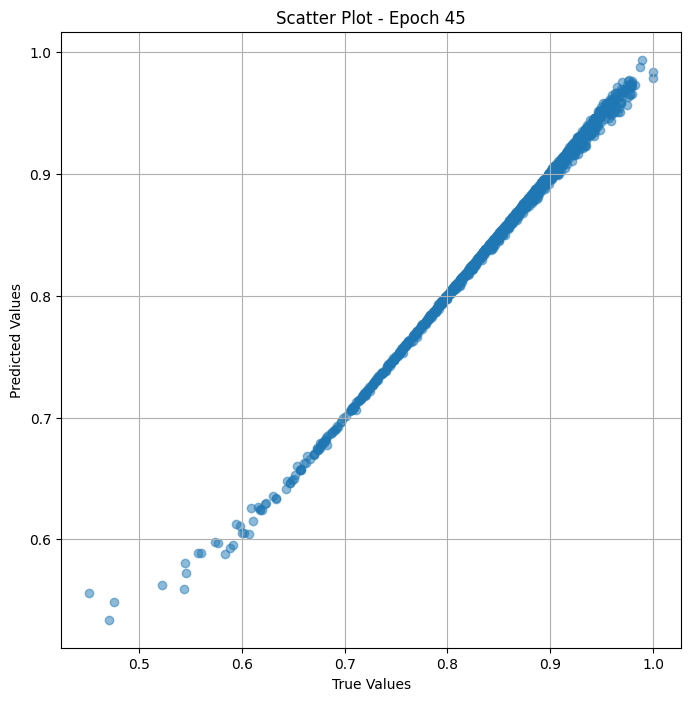

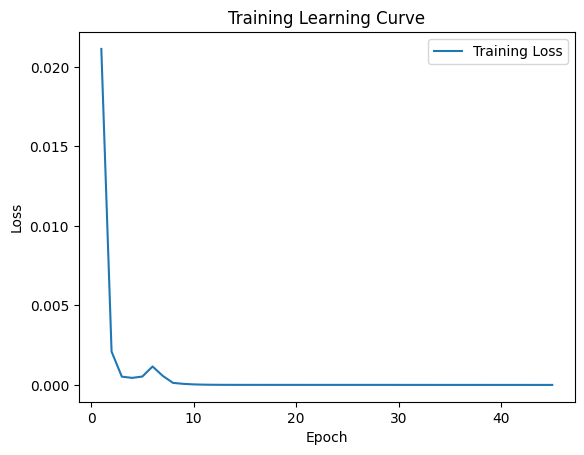


 Epoch: (46/50) Loss = 7.525013074882736e-07

 Epoch: (46/50) Loss_rmse = 0.0008674683049321175

 Epoch: (46/50) R^2 = 0.9996324777603149

 Epoch: (46/50) MAE = 0.0007700175046920776
Spearman correlation coefficient: SignificanceResult(statistic=0.999445374406813, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

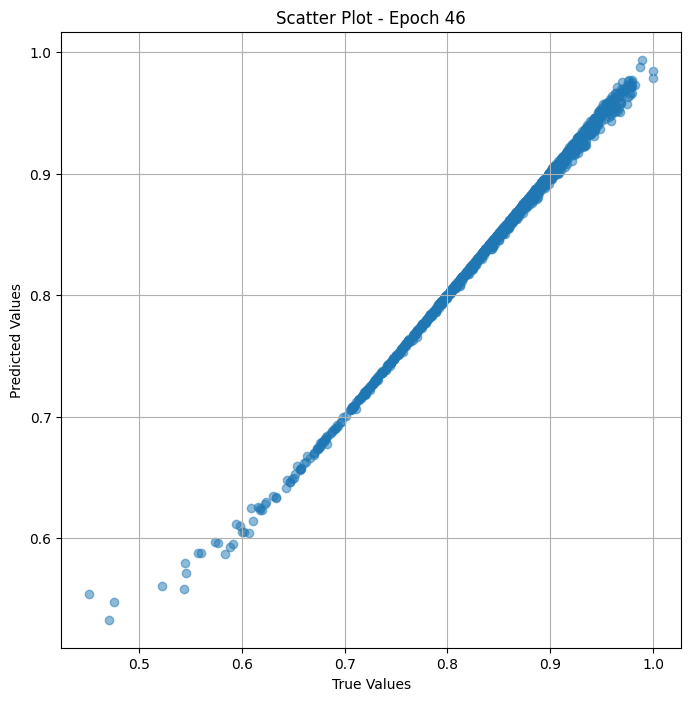

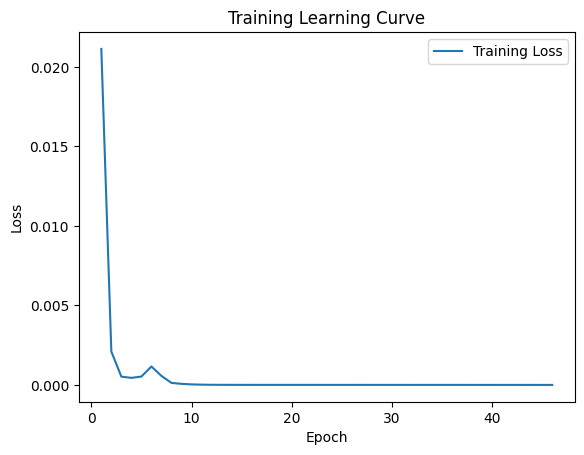


 Epoch: (47/50) Loss = 6.728648145326588e-07

 Epoch: (47/50) Loss_rmse = 0.0008202833705581725

 Epoch: (47/50) R^2 = 0.9996713399887085

 Epoch: (47/50) MAE = 0.0007252246141433716
Spearman correlation coefficient: SignificanceResult(statistic=0.9994967984672727, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

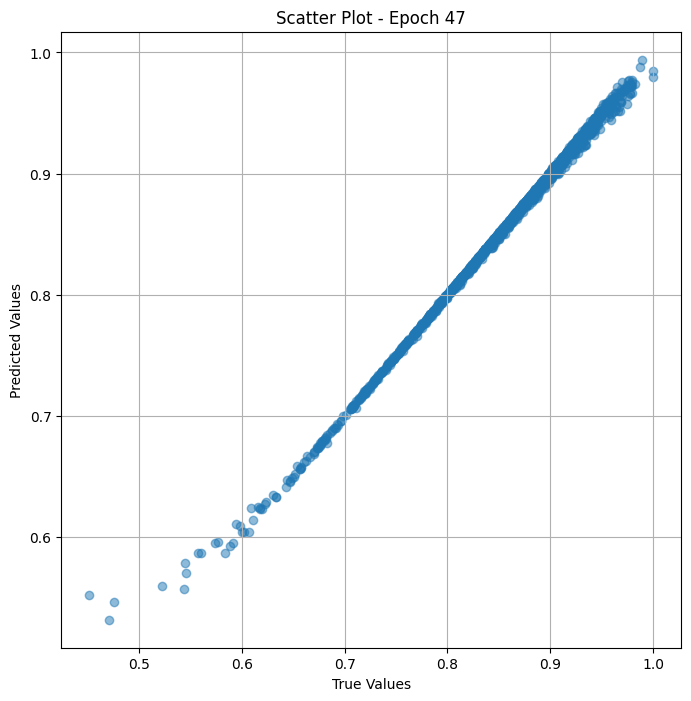

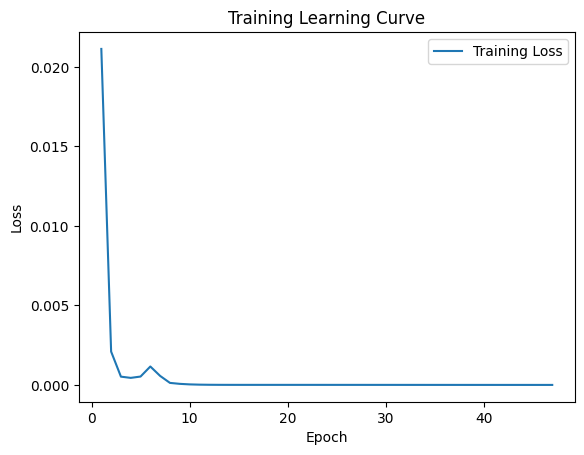


 Epoch: (48/50) Loss = 6.020479759172304e-07

 Epoch: (48/50) Loss_rmse = 0.0007759174914099276

 Epoch: (48/50) R^2 = 0.999705970287323

 Epoch: (48/50) MAE = 0.0006791278719902039
Spearman correlation coefficient: SignificanceResult(statistic=0.9995380014218491, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.97

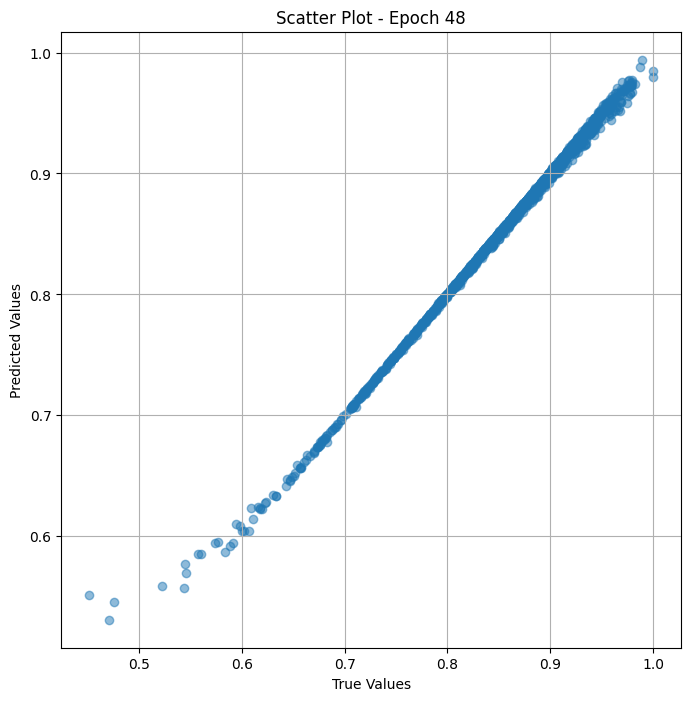

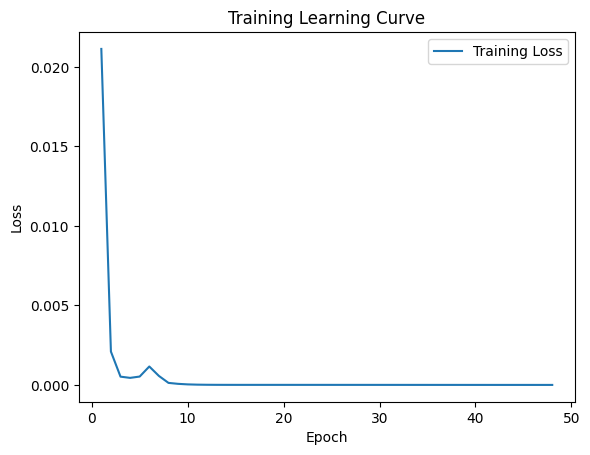


 Epoch: (49/50) Loss = 5.658099553329521e-07

 Epoch: (49/50) Loss_rmse = 0.0007522033993154764

 Epoch: (49/50) R^2 = 0.9997236728668213

 Epoch: (49/50) MAE = 0.0006539821624755859
Spearman correlation coefficient: SignificanceResult(statistic=0.9995759257606154, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

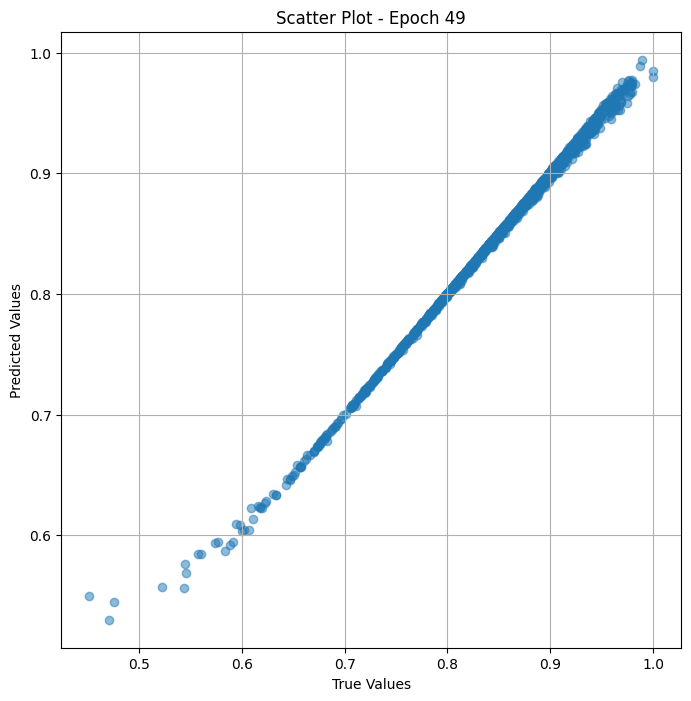

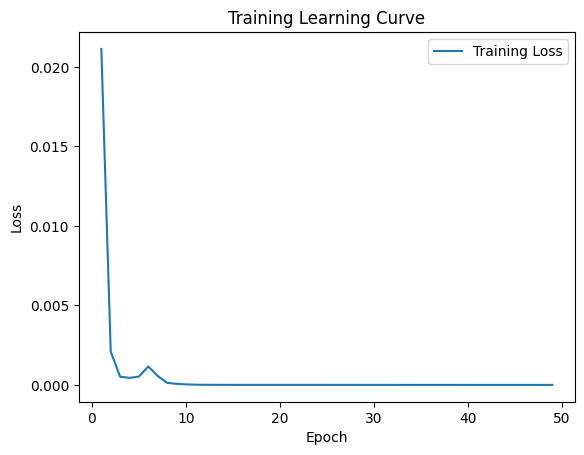


 Epoch: (50/50) Loss = 6.342770575429313e-07

 Epoch: (50/50) Loss_rmse = 0.0007964151445776224

 Epoch: (50/50) R^2 = 0.9996902346611023

 Epoch: (50/50) MAE = 0.0007395744323730469
Spearman correlation coefficient: SignificanceResult(statistic=0.9996085972244826, pvalue=0.0)

 true_values_list_val : 1800

 predicted_values_list_val : 1800

 true_values_list_val : [0.80733943, 0.74561405, 0.85858583, 0.74725276, 0.8131868, 0.8378378, 1.0, 0.8913044, 0.9550562, 0.6086956, 0.8761905, 0.57425743, 0.82, 0.77894735, 0.87096775, 0.7692308, 0.9, 0.88617885, 0.9411765, 0.8913044, 0.9339623, 0.9247312, 0.9148936, 0.8411215, 0.8791209, 0.9047619, 0.9607843, 0.9423077, 0.81578946, 0.9310345, 0.8181818, 0.83116883, 0.82474226, 0.93457943, 0.7837838, 0.84090906, 0.91150445, 0.9514563, 0.8045977, 0.95614034, 0.8969072, 0.9052632, 0.8469388, 0.6179775, 0.622807, 0.8317757, 0.92771083, 0.6938776, 0.81609195, 0.83838385, 0.9326923, 0.959596, 0.8072289, 0.9032258, 0.88785046, 0.7977528, 0.8021978, 0.9

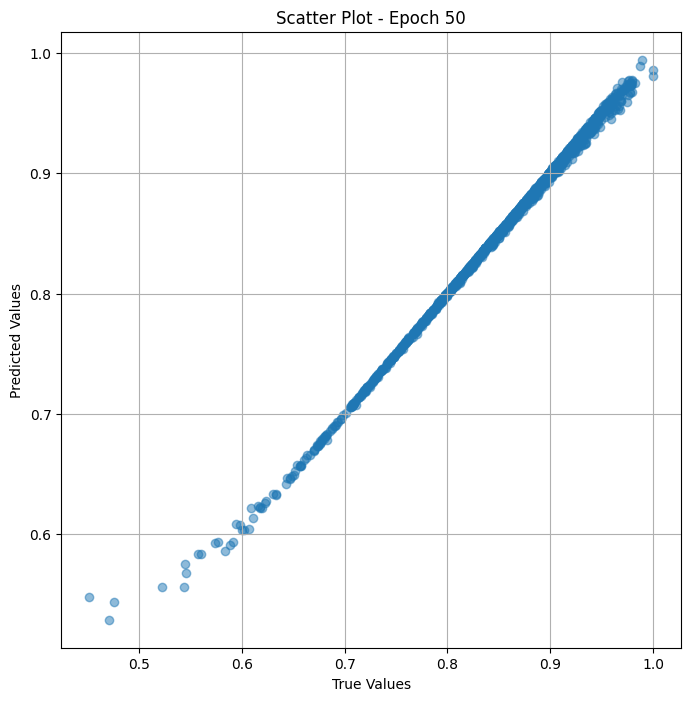

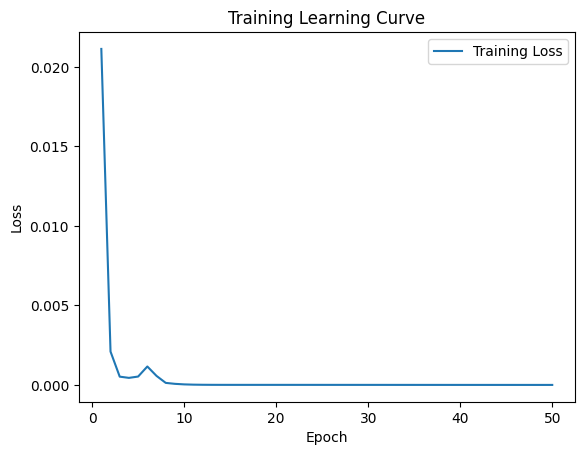

In [ ]:
# Training the model and save weights
fit(50,model_res_fine , train_dl)
torch.save(model_res_fine.state_dict(), "model_weights_fine")

## valid

In [ ]:
params = [param for param in list(model_res_val .parameters()) if param.requires_grad == True]
optimizer = torch.optim.Adam(params, lr=1e-4,weight_decay=1e-6)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Val Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Val Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_val, val_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_val.train()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in val_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_val(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.0002159432478947565

 Epoch: (1/50) Loss_rmse = 0.014695007354021072

 Epoch: (1/50) R^2 = 0.9102801084518433

 Epoch: (1/50) MAE = 0.014659062027931213
Spearman correlation coefficient: SignificanceResult(statistic=0.9890187418308815, pvalue=7.338234198677212e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89898

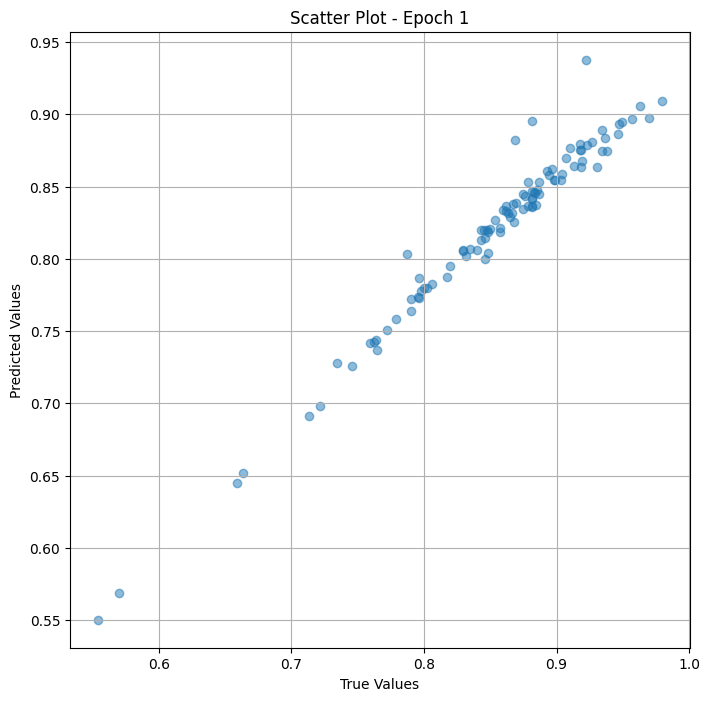

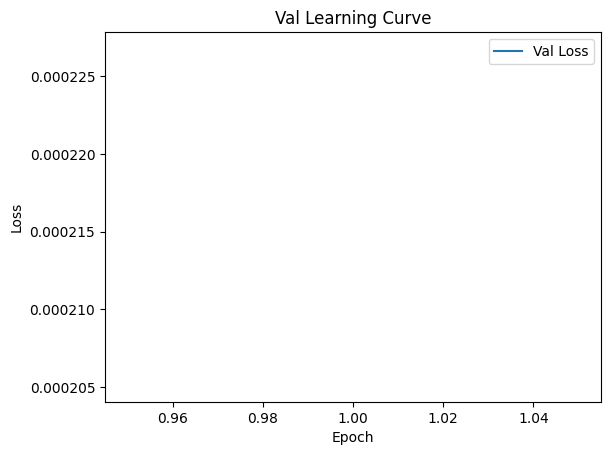


 Epoch: (2/50) Loss = 0.0010823123157024384

 Epoch: (2/50) Loss_rmse = 0.032898515462875366

 Epoch: (2/50) R^2 = 0.5503220558166504

 Epoch: (2/50) MAE = 0.022883445024490356
Spearman correlation coefficient: SignificanceResult(statistic=0.9659777672605419, pvalue=5.247793340137938e-57)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89898

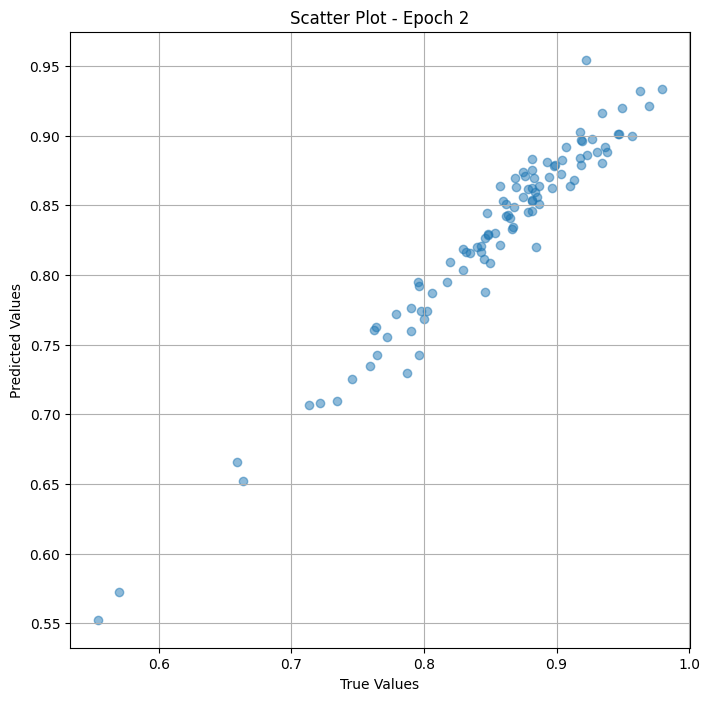

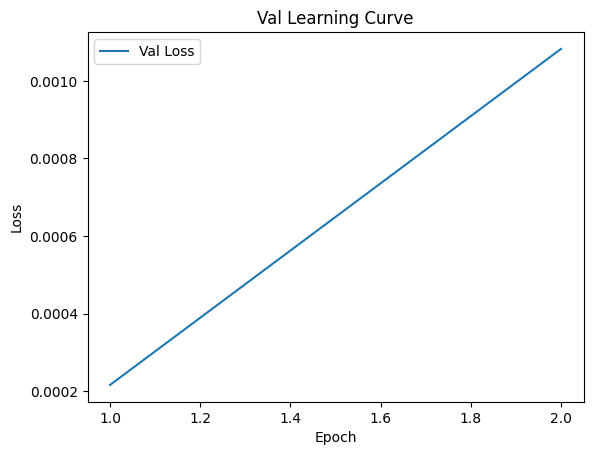


 Epoch: (3/50) Loss = 0.0008484830032102764

 Epoch: (3/50) Loss_rmse = 0.029128732159733772

 Epoch: (3/50) R^2 = 0.6474732160568237

 Epoch: (3/50) MAE = 0.023517847061157227
Spearman correlation coefficient: SignificanceResult(statistic=0.9730250361974223, pvalue=1.1278103989602542e-61)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989

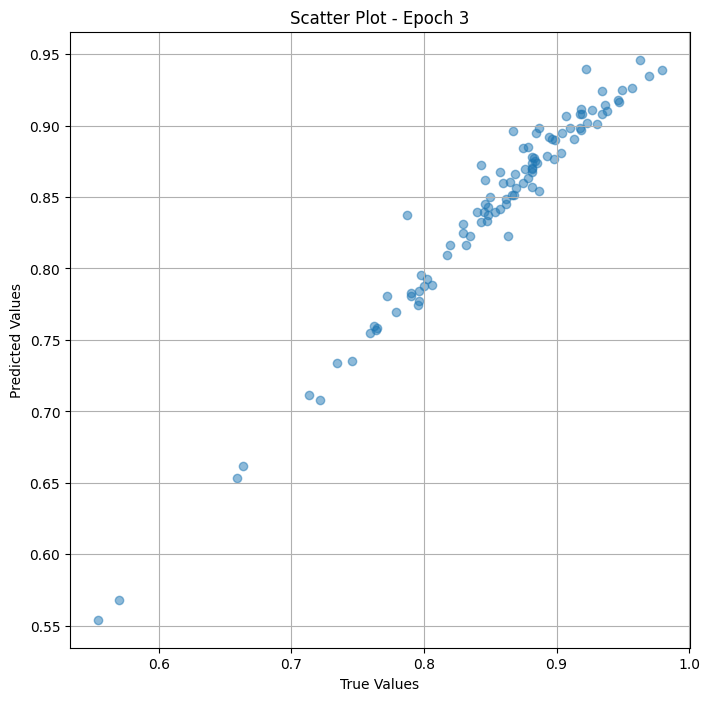

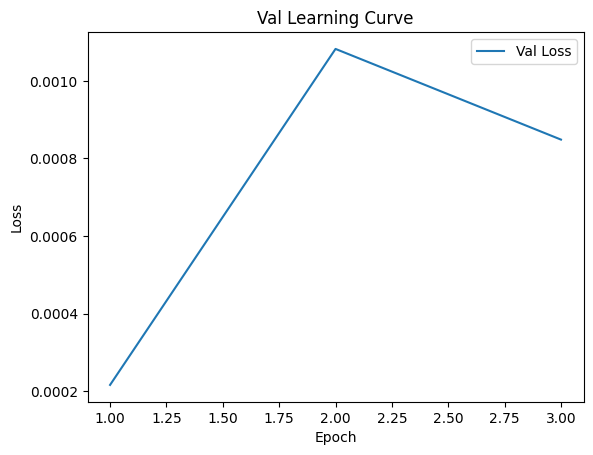

Epoch 0.02: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (4/50) Loss = 0.00041125176358036697

 Epoch: (4/50) Loss_rmse = 0.02027934417128563

 Epoch: (4/50) R^2 = 0.8291335701942444

 Epoch: (4/50) MAE = 0.015598267316818237
Spearman correlation coefficient: SignificanceResult(statistic=0.9846710042095722, pvalue=4.2785137160584235e-73)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8

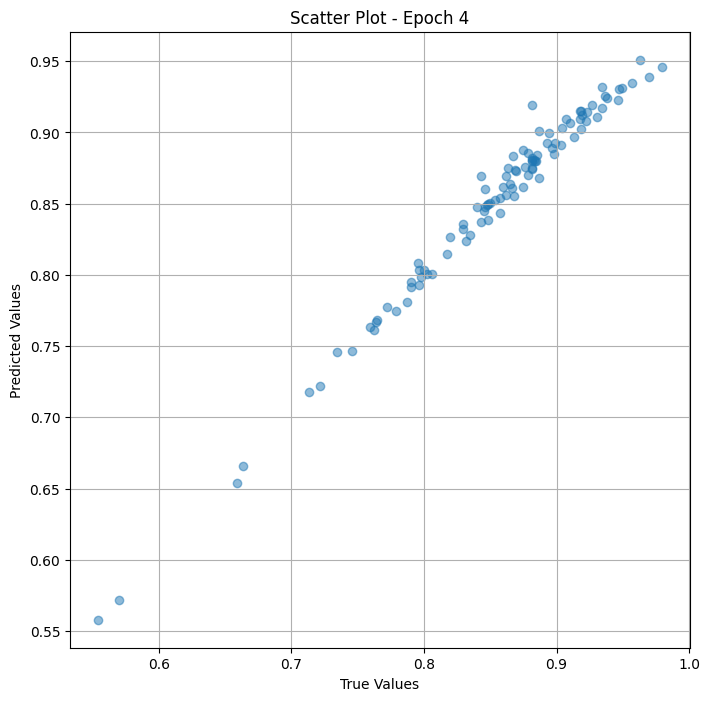

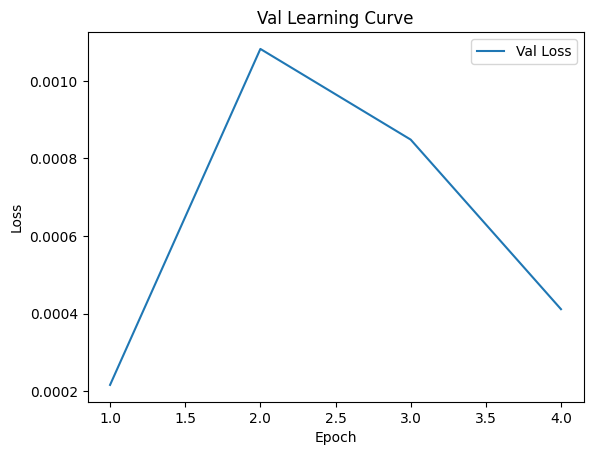


 Epoch: (5/50) Loss = 0.00010100885992869735

 Epoch: (5/50) Loss_rmse = 0.010050316341221333

 Epoch: (5/50) R^2 = 0.9580329656600952

 Epoch: (5/50) MAE = 0.007556602358818054
Spearman correlation coefficient: SignificanceResult(statistic=0.9890933519928696, pvalue=5.335404372338008e-80)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989

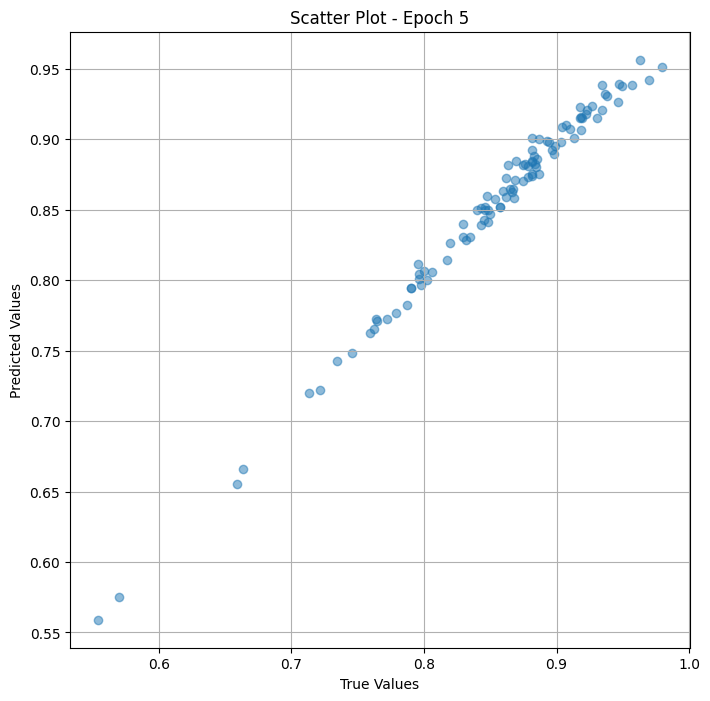

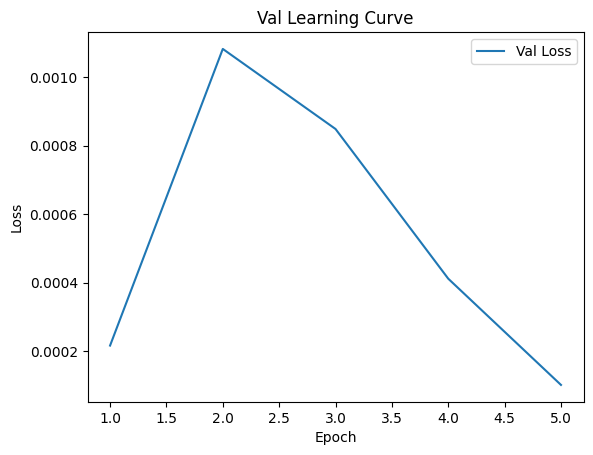


 Epoch: (6/50) Loss = 3.910128361894749e-05

 Epoch: (6/50) Loss_rmse = 0.006253101862967014

 Epoch: (6/50) R^2 = 0.9837542176246643

 Epoch: (6/50) MAE = 0.004449337720870972
Spearman correlation coefficient: SignificanceResult(statistic=0.9899004982907414, pvalue=1.4645638433584907e-81)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8989

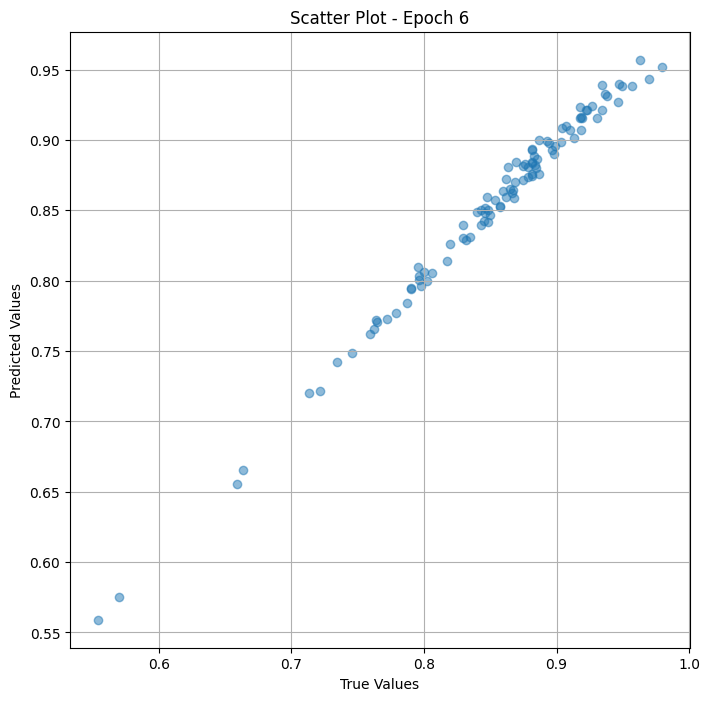

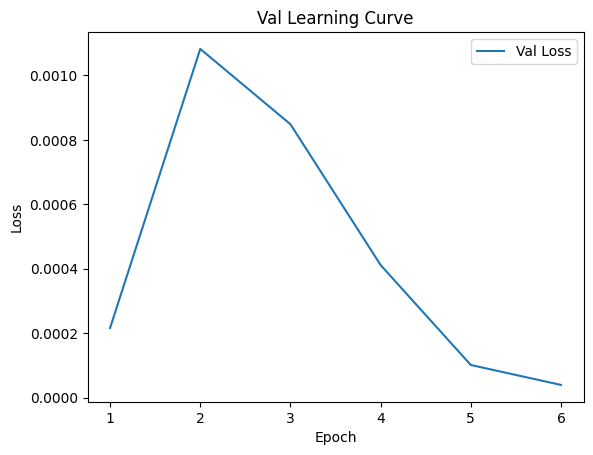


 Epoch: (7/50) Loss = 7.002278834988829e-06

 Epoch: (7/50) Loss_rmse = 0.0026461819652467966

 Epoch: (7/50) R^2 = 0.9970906972885132

 Epoch: (7/50) MAE = 0.001976326107978821
Spearman correlation coefficient: SignificanceResult(statistic=0.9907551237826057, pvalue=2.3407785176086427e-83)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.898

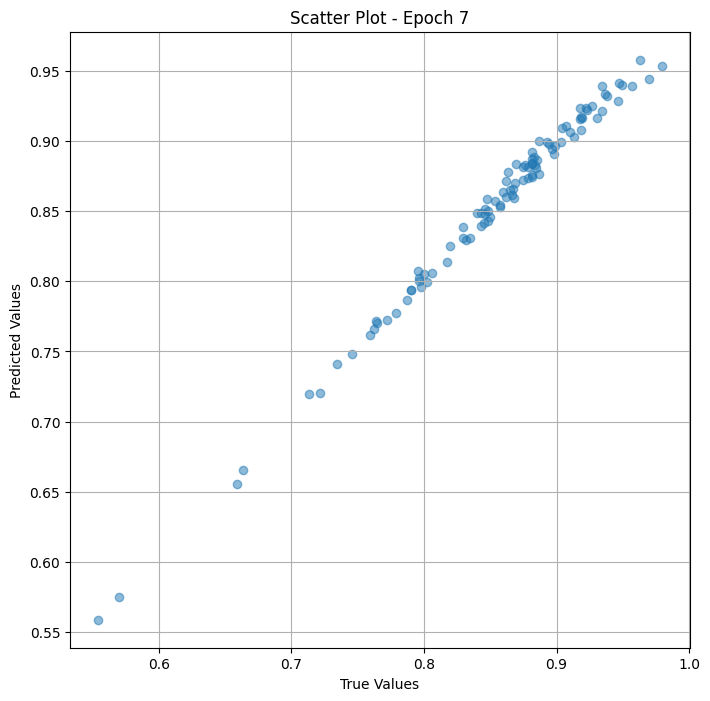

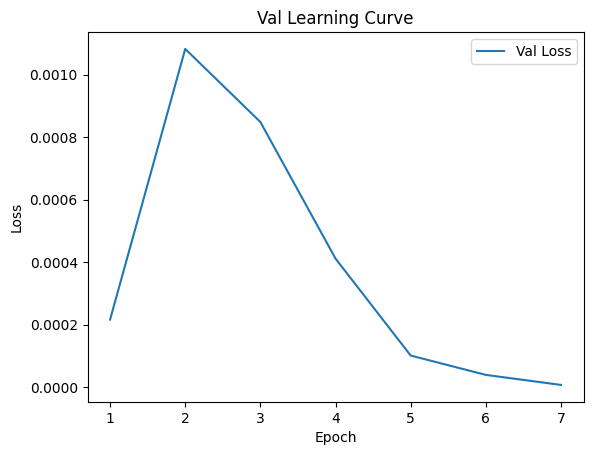


 Epoch: (8/50) Loss = 2.800516767820227e-06

 Epoch: (8/50) Loss_rmse = 0.0016734744422137737

 Epoch: (8/50) R^2 = 0.9988364577293396

 Epoch: (8/50) MAE = 0.0015058517456054688
Spearman correlation coefficient: SignificanceResult(statistic=0.9923151544423578, pvalue=4.094310262468059e-87)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.898

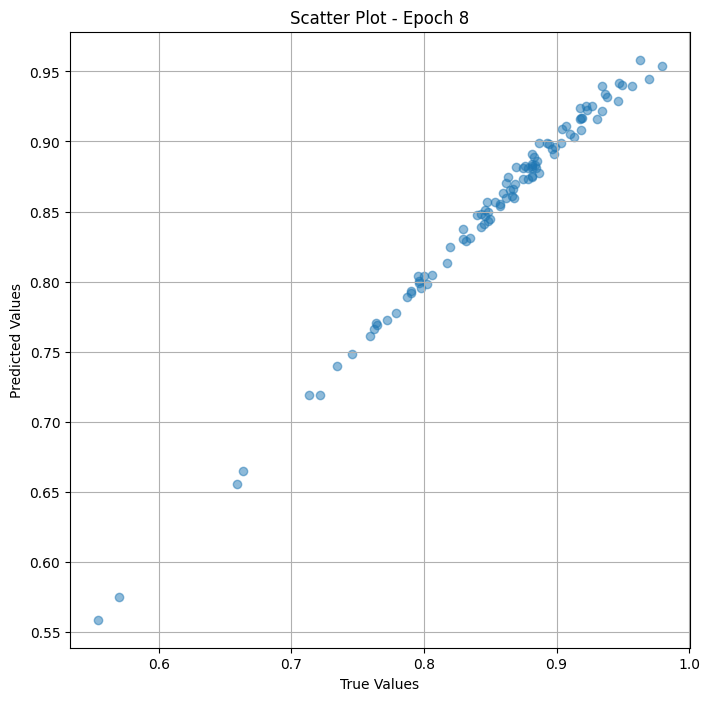

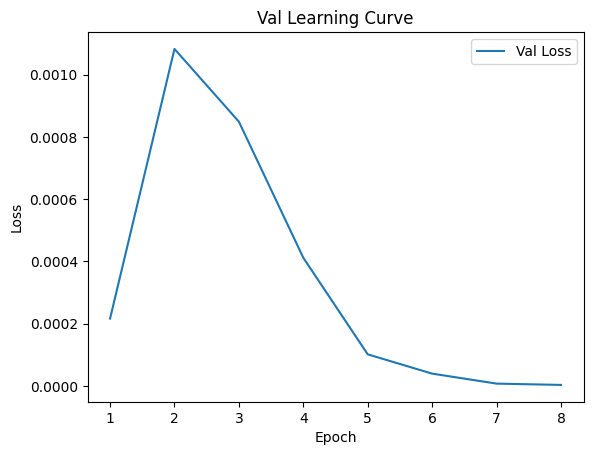


 Epoch: (9/50) Loss = 8.248411177191883e-06

 Epoch: (9/50) Loss_rmse = 0.0028720046393573284

 Epoch: (9/50) R^2 = 0.9965729713439941

 Epoch: (9/50) MAE = 0.0025826990604400635
Spearman correlation coefficient: SignificanceResult(statistic=0.9933800449361887, pvalue=3.7841396818287497e-90)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.89

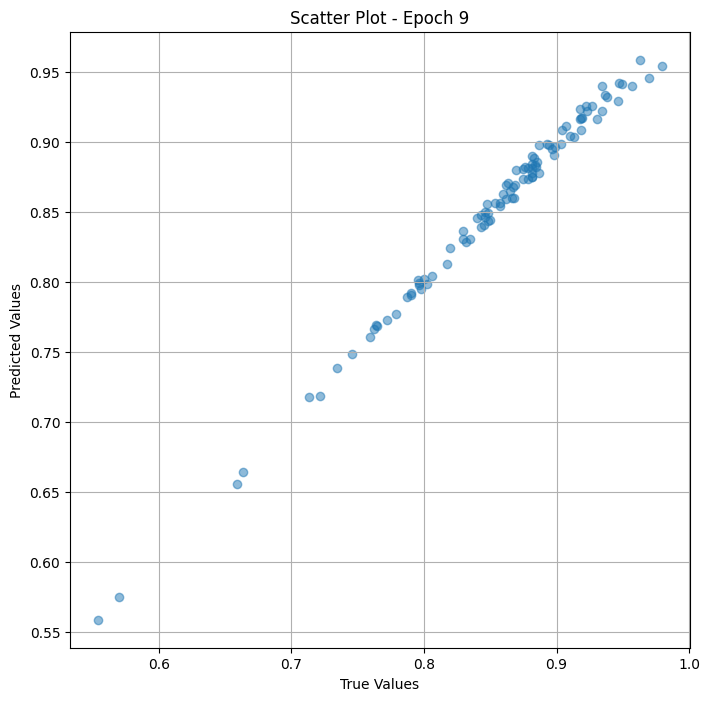

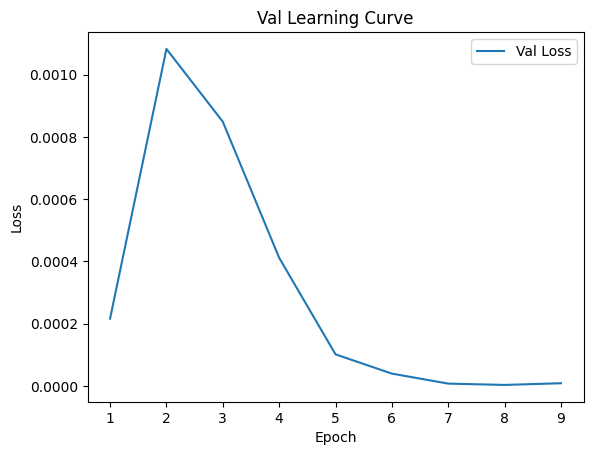


 Epoch: (10/50) Loss = 8.895615792425815e-06

 Epoch: (10/50) Loss_rmse = 0.0029825519304722548

 Epoch: (10/50) R^2 = 0.9963040351867676

 Epoch: (10/50) MAE = 0.002477511763572693
Spearman correlation coefficient: SignificanceResult(statistic=0.9939701434900948, pvalue=4.764280134272531e-92)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

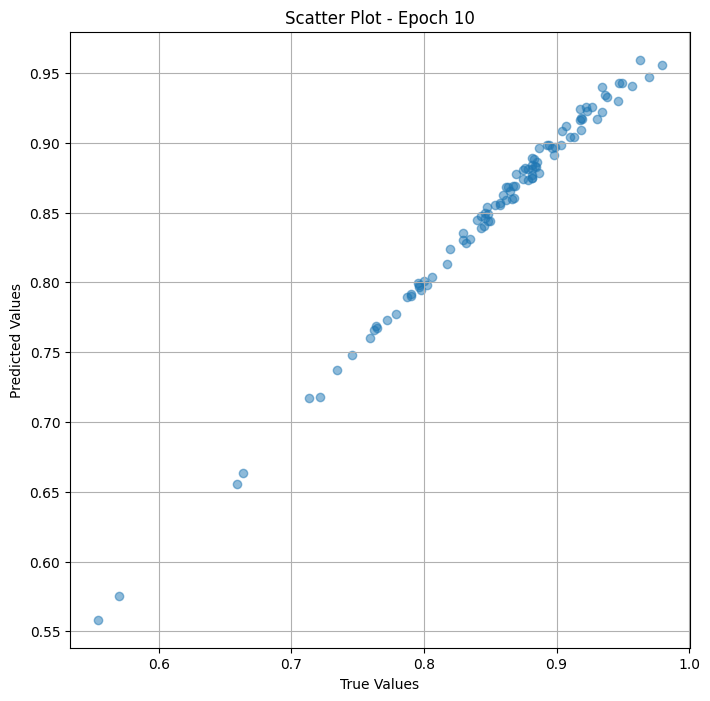

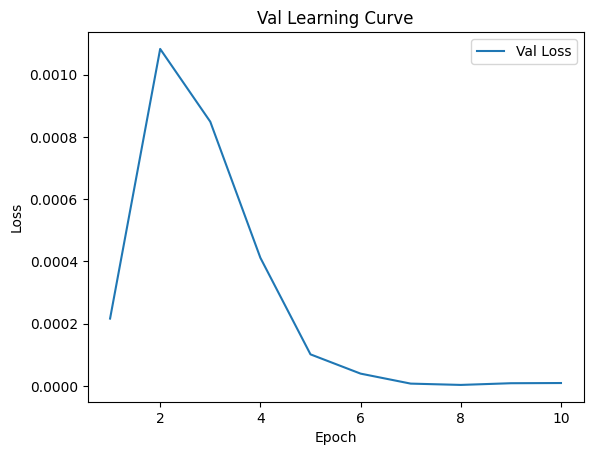

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (11/50) Loss = 4.614333647623425e-06

 Epoch: (11/50) Loss_rmse = 0.0021480999421328306

 Epoch: (11/50) R^2 = 0.9980828166007996

 Epoch: (11/50) MAE = 0.0017712563276290894
Spearman correlation coefficient: SignificanceResult(statistic=0.9943364115580368, pvalue=2.5262193337359597e-93)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.745762

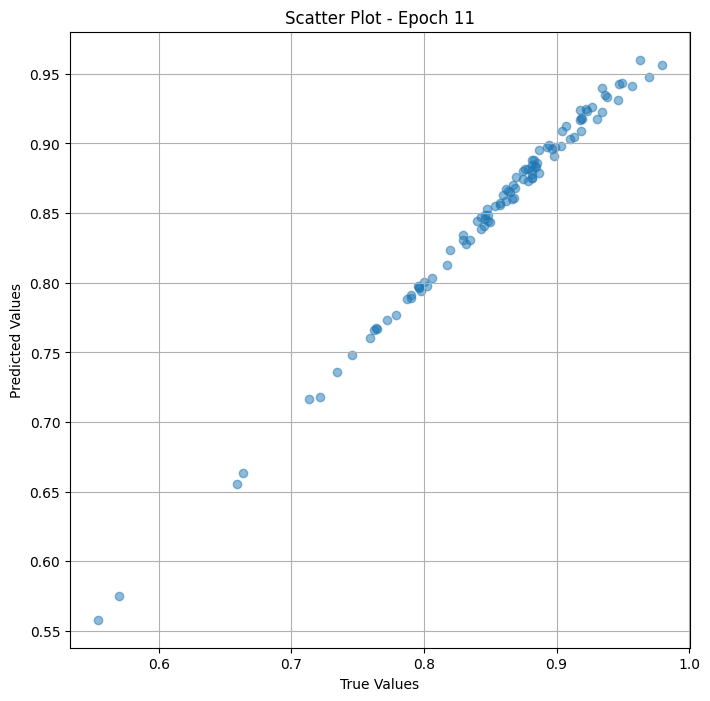

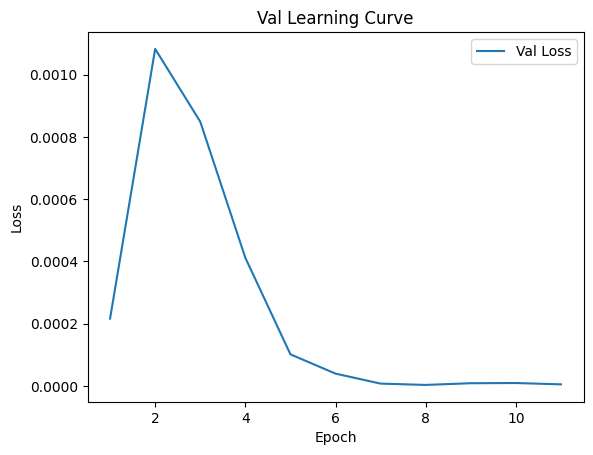


 Epoch: (12/50) Loss = 2.981556690428988e-06

 Epoch: (12/50) Loss_rmse = 0.0017267185030505061

 Epoch: (12/50) R^2 = 0.9987612366676331

 Epoch: (12/50) MAE = 0.0014133602380752563
Spearman correlation coefficient: SignificanceResult(statistic=0.9949400755959409, pvalue=1.2818894935685157e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

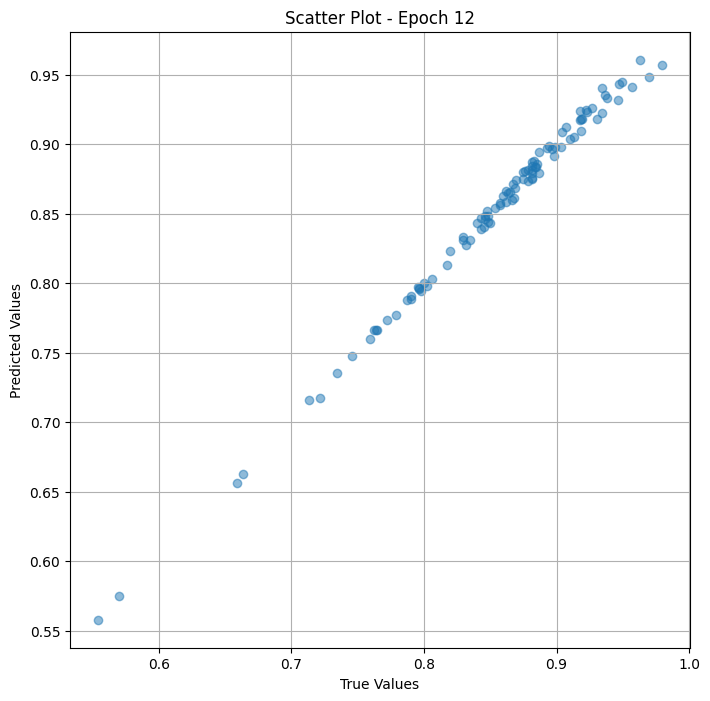

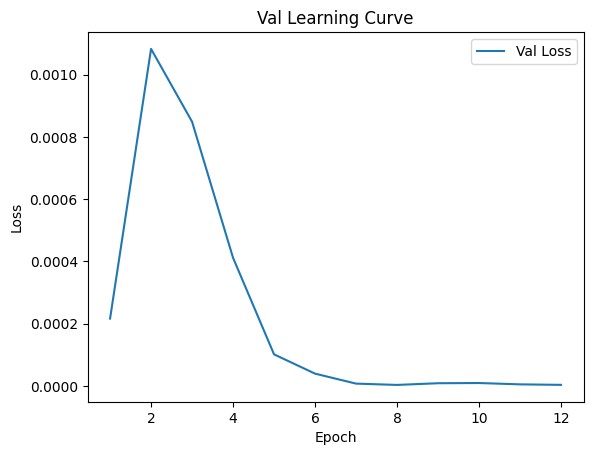


 Epoch: (13/50) Loss = 2.543459913795232e-06

 Epoch: (13/50) Loss_rmse = 0.0015948228538036346

 Epoch: (13/50) R^2 = 0.9989432692527771

 Epoch: (13/50) MAE = 0.0012988150119781494
Spearman correlation coefficient: SignificanceResult(statistic=0.9949400755959409, pvalue=1.2818894935685157e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

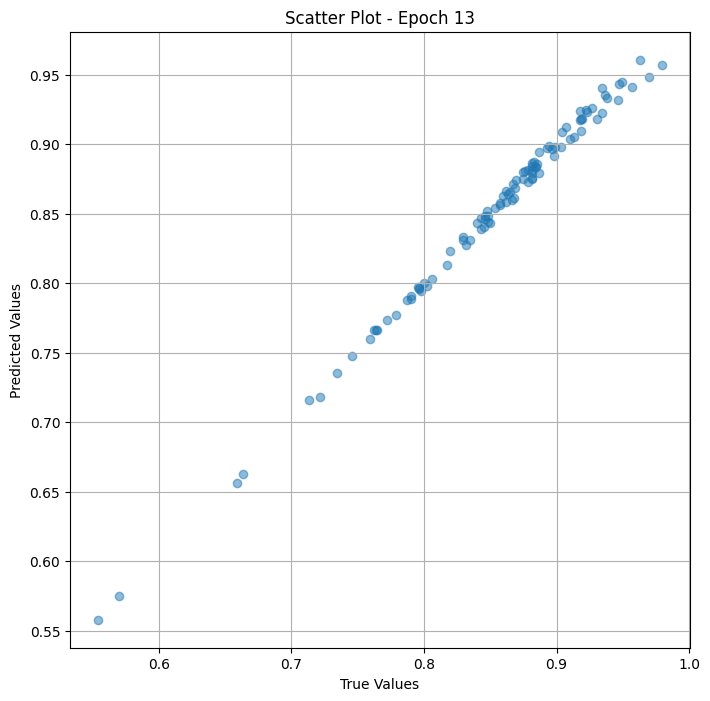

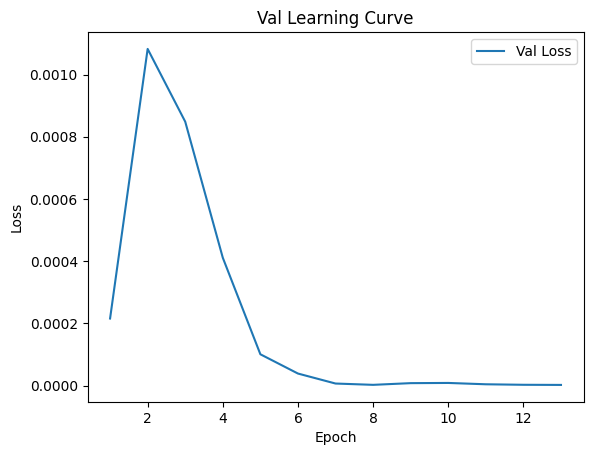


 Epoch: (14/50) Loss = 2.118004886142444e-06

 Epoch: (14/50) Loss_rmse = 0.0014553366927430034

 Epoch: (14/50) R^2 = 0.9991199970245361

 Epoch: (14/50) MAE = 0.0011770427227020264
Spearman correlation coefficient: SignificanceResult(statistic=0.9949400755959409, pvalue=1.2818894935685157e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

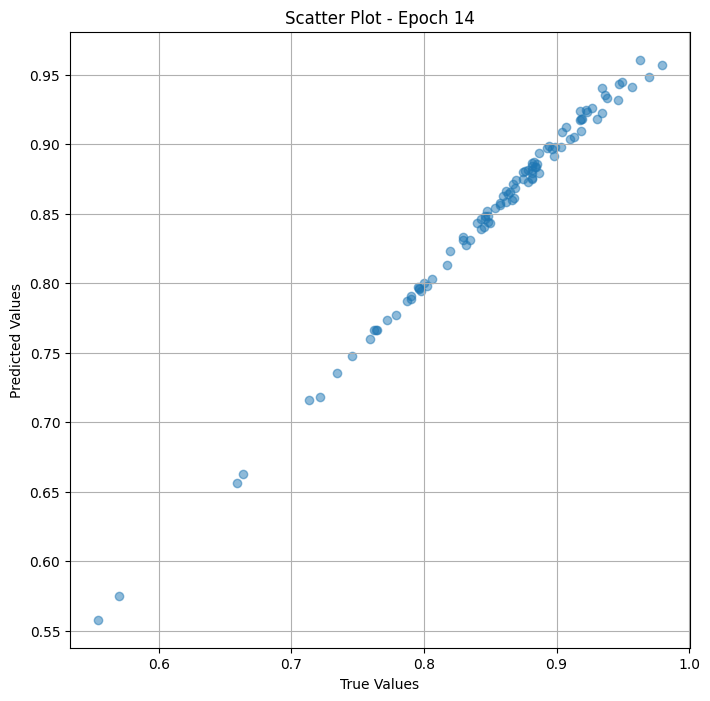

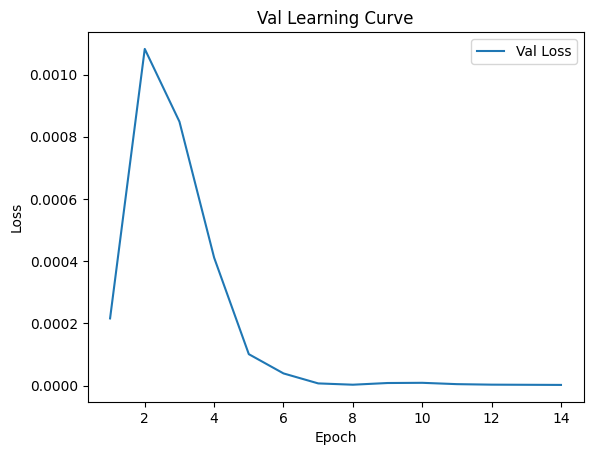


 Epoch: (15/50) Loss = 1.728150436974829e-06

 Epoch: (15/50) Loss_rmse = 0.001314591383561492

 Epoch: (15/50) R^2 = 0.9992820024490356

 Epoch: (15/50) MAE = 0.0010536909103393555
Spearman correlation coefficient: SignificanceResult(statistic=0.9949400755959409, pvalue=1.2818894935685157e-95)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

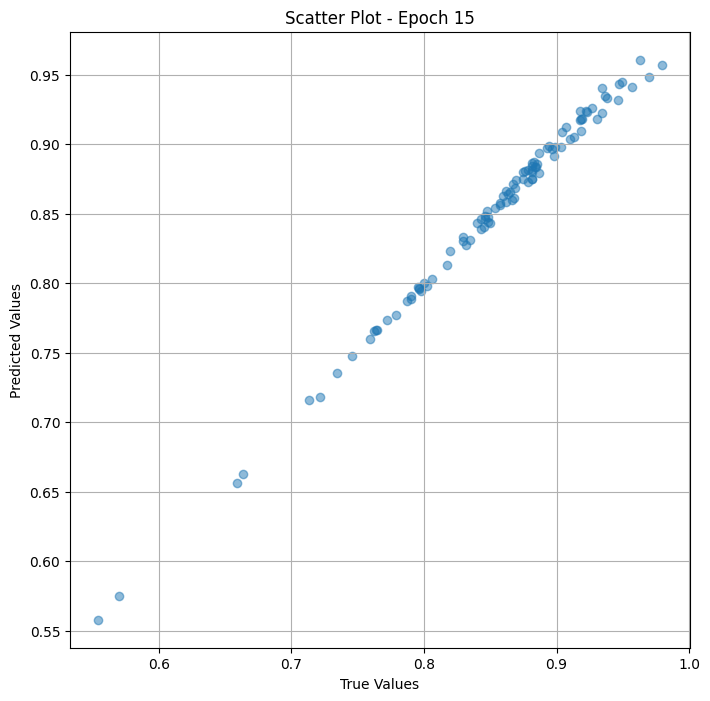

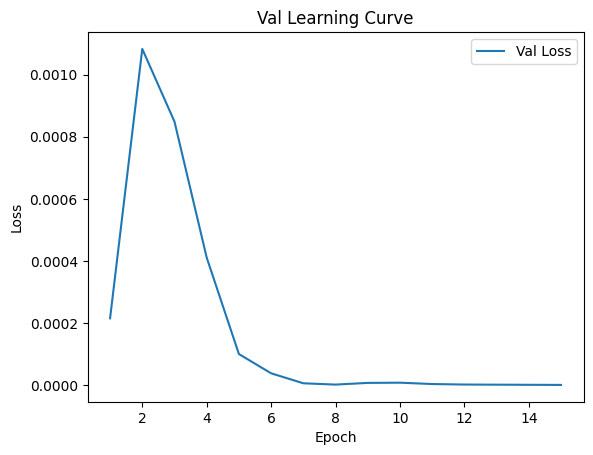


 Epoch: (16/50) Loss = 1.3866297194908839e-06

 Epoch: (16/50) Loss_rmse = 0.0011775523889809847

 Epoch: (16/50) R^2 = 0.9994238615036011

 Epoch: (16/50) MAE = 0.0009330511093139648
Spearman correlation coefficient: SignificanceResult(statistic=0.9950011202739312, pvalue=7.255979942246527e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

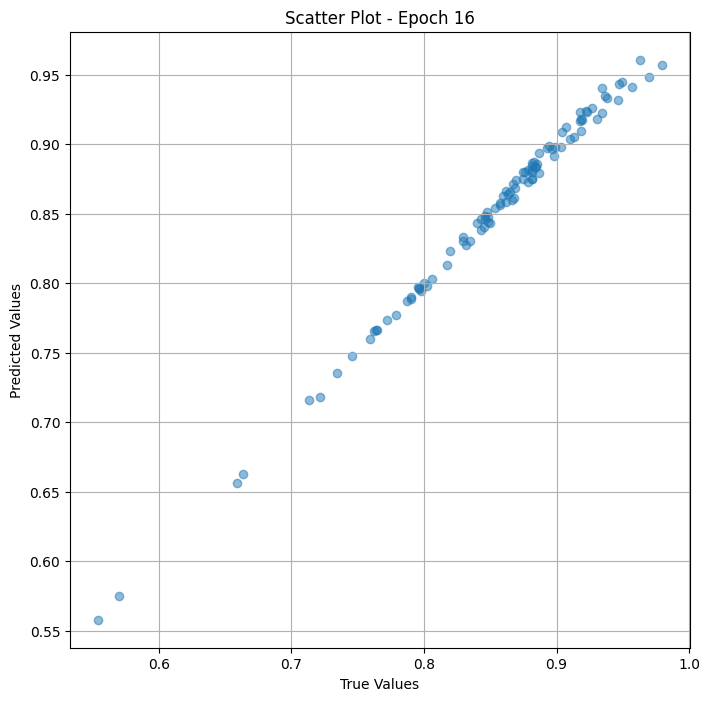

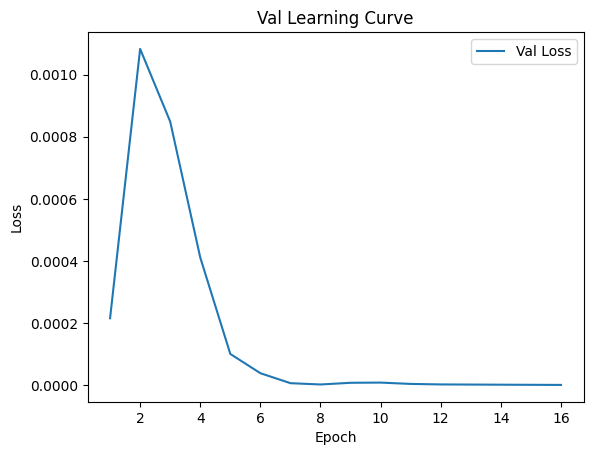


 Epoch: (17/50) Loss = 1.098021243706171e-06

 Epoch: (17/50) Loss_rmse = 0.0010478651383891702

 Epoch: (17/50) R^2 = 0.9995437860488892

 Epoch: (17/50) MAE = 0.0008182376623153687
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

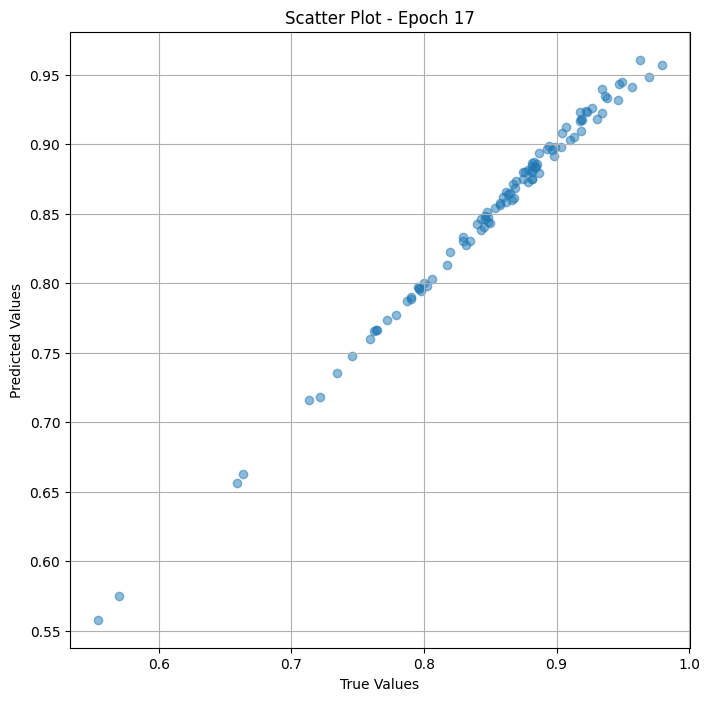

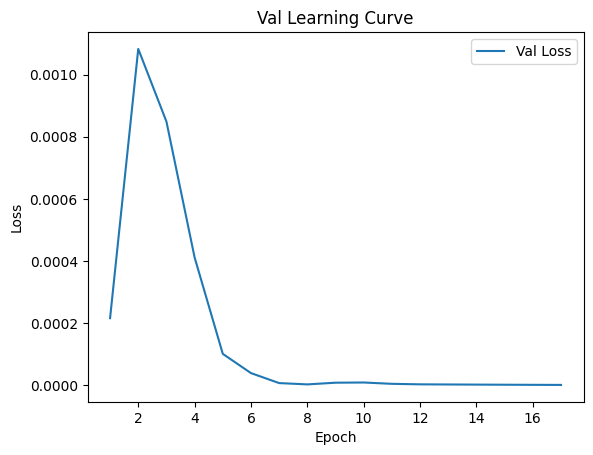


 Epoch: (18/50) Loss = 8.603949481766904e-07

 Epoch: (18/50) Loss_rmse = 0.0009275747579522431

 Epoch: (18/50) R^2 = 0.999642550945282

 Epoch: (18/50) MAE = 0.0007110089063644409
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.8

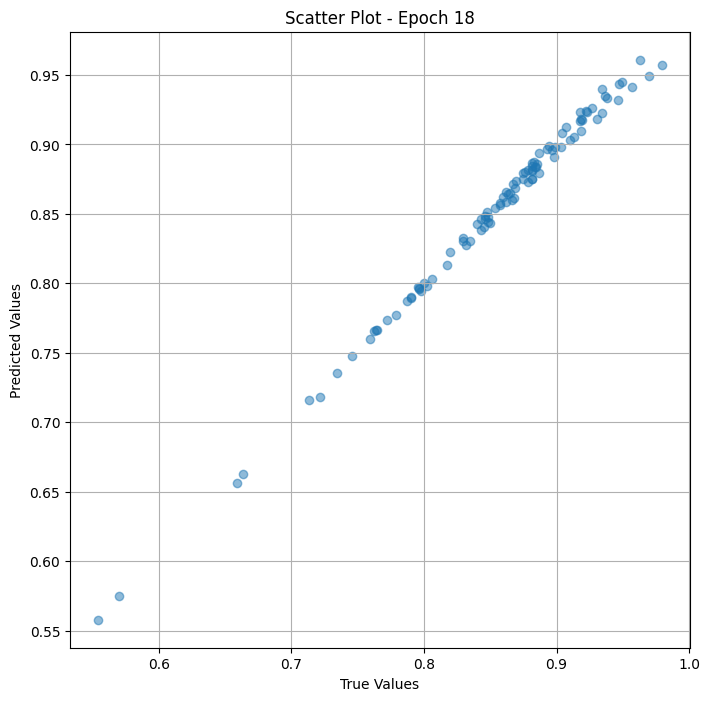

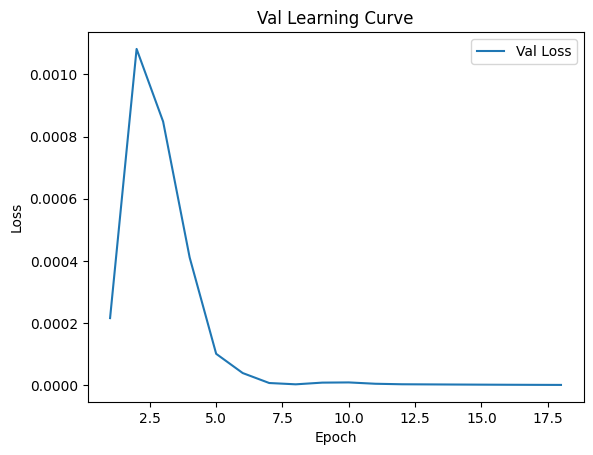


 Epoch: (19/50) Loss = 6.6939634280061e-07

 Epoch: (19/50) Loss_rmse = 0.0008181664743460715

 Epoch: (19/50) R^2 = 0.999721884727478

 Epoch: (19/50) MAE = 0.0006126463413238525
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.898

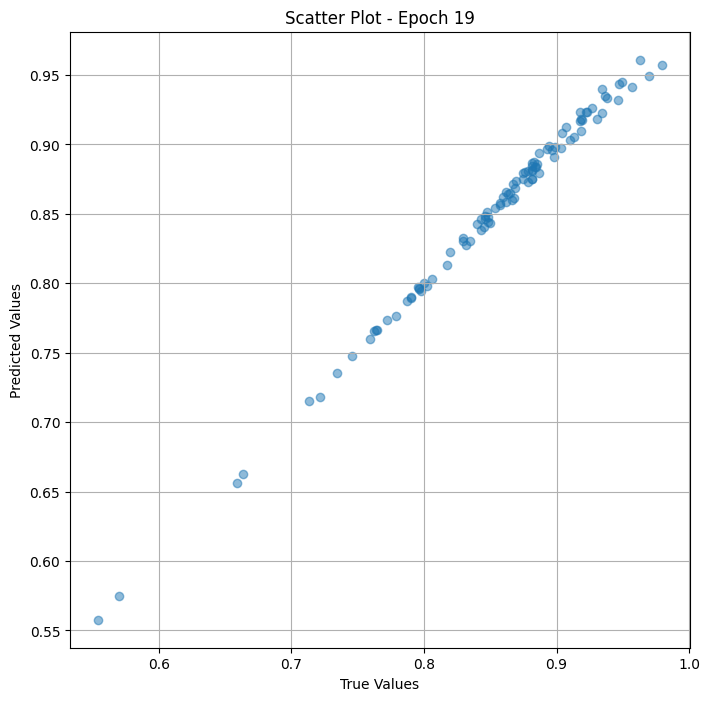

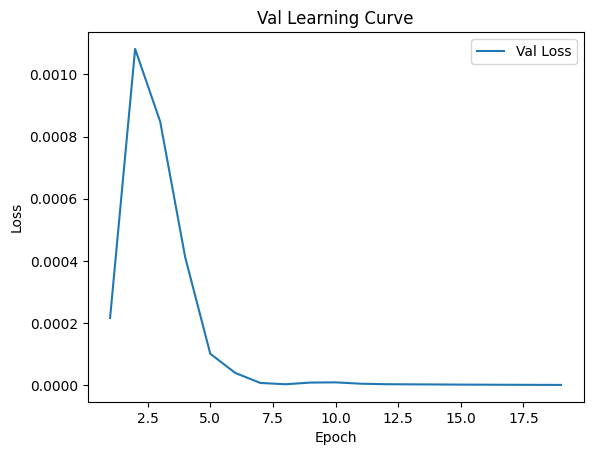


 Epoch: (20/50) Loss = 5.190311753722199e-07

 Epoch: (20/50) Loss_rmse = 0.0007204381981864572

 Epoch: (20/50) R^2 = 0.9997843503952026

 Epoch: (20/50) MAE = 0.0005237609148025513
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

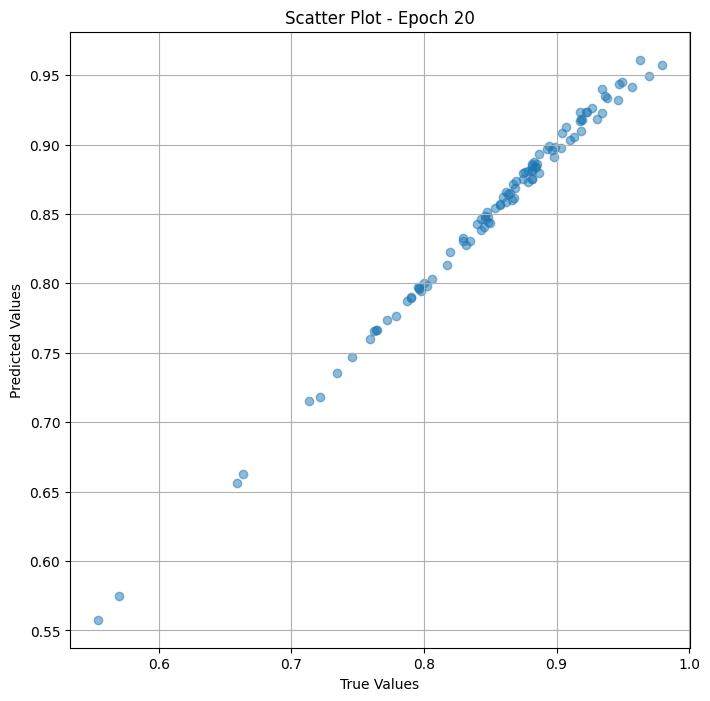

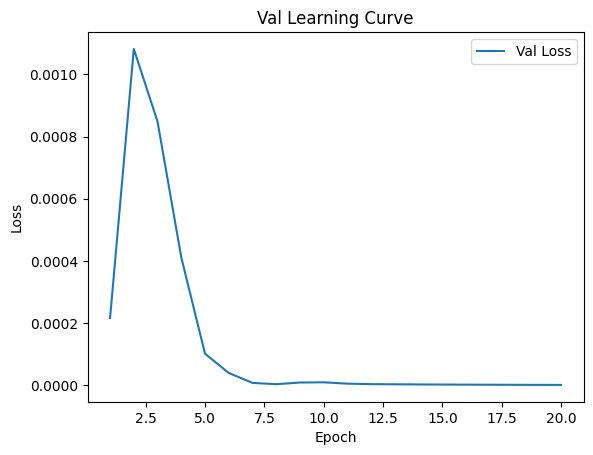


 Epoch: (21/50) Loss = 4.028323701277259e-07

 Epoch: (21/50) Loss_rmse = 0.0006346907466650009

 Epoch: (21/50) R^2 = 0.9998326301574707

 Epoch: (21/50) MAE = 0.0004440397024154663
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

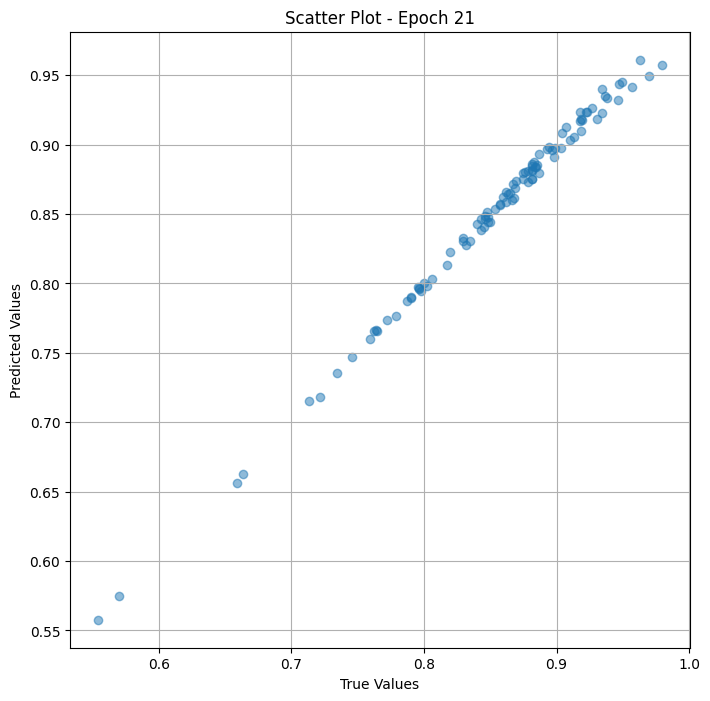

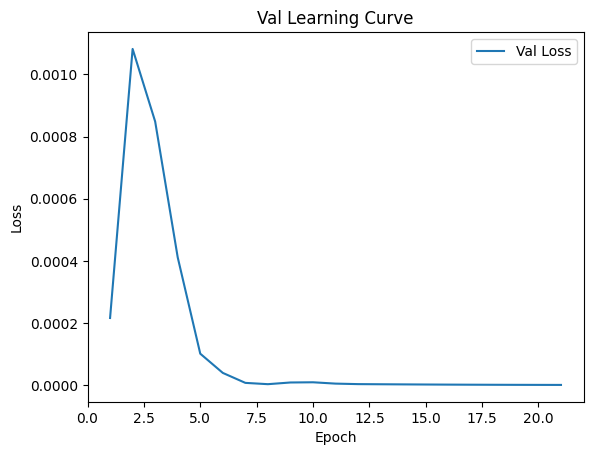


 Epoch: (22/50) Loss = 3.154802641347487e-07

 Epoch: (22/50) Loss_rmse = 0.0005616762791760266

 Epoch: (22/50) R^2 = 0.9998689293861389

 Epoch: (22/50) MAE = 0.0003768503665924072
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0.

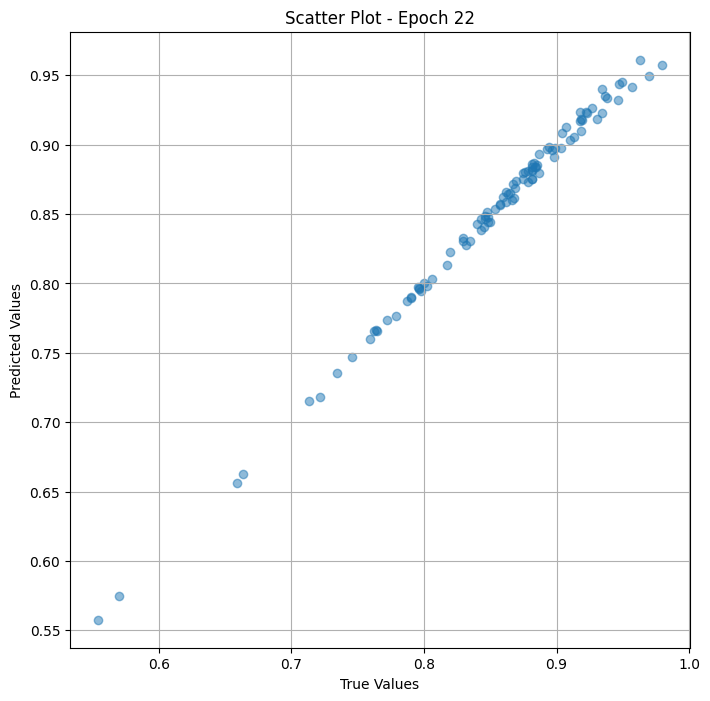

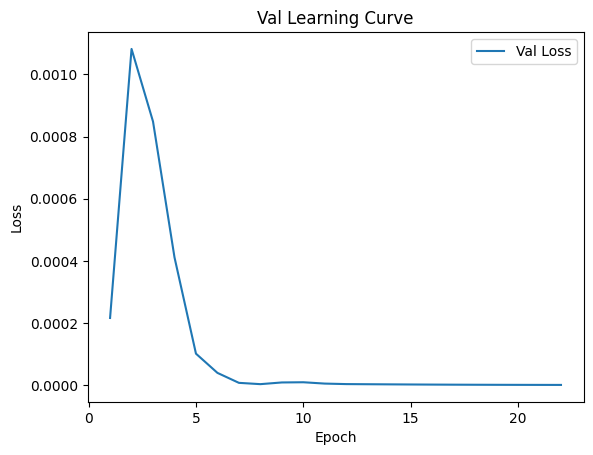


 Epoch: (23/50) Loss = 2.508078580376605e-07

 Epoch: (23/50) Loss_rmse = 0.0005008071893826127

 Epoch: (23/50) R^2 = 0.9998958110809326

 Epoch: (23/50) MAE = 0.00033451616764068604
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

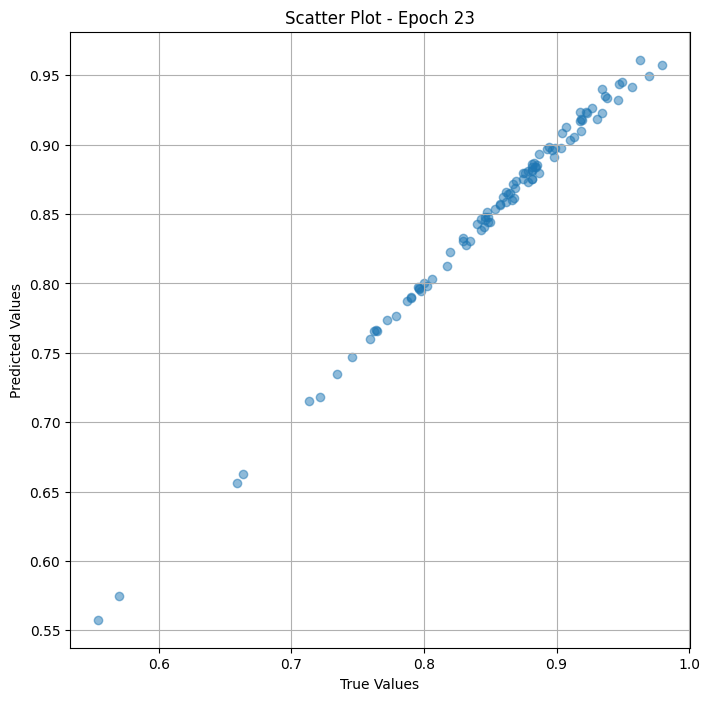

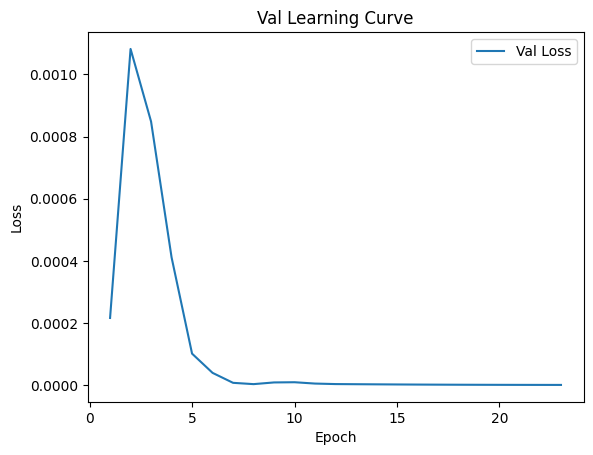


 Epoch: (24/50) Loss = 2.0338649164841627e-07

 Epoch: (24/50) Loss_rmse = 0.0004509839054662734

 Epoch: (24/50) R^2 = 0.9999154806137085

 Epoch: (24/50) MAE = 0.0002985745668411255
Spearman correlation coefficient: SignificanceResult(statistic=0.9949672065639364, pvalue=9.96265804226341e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

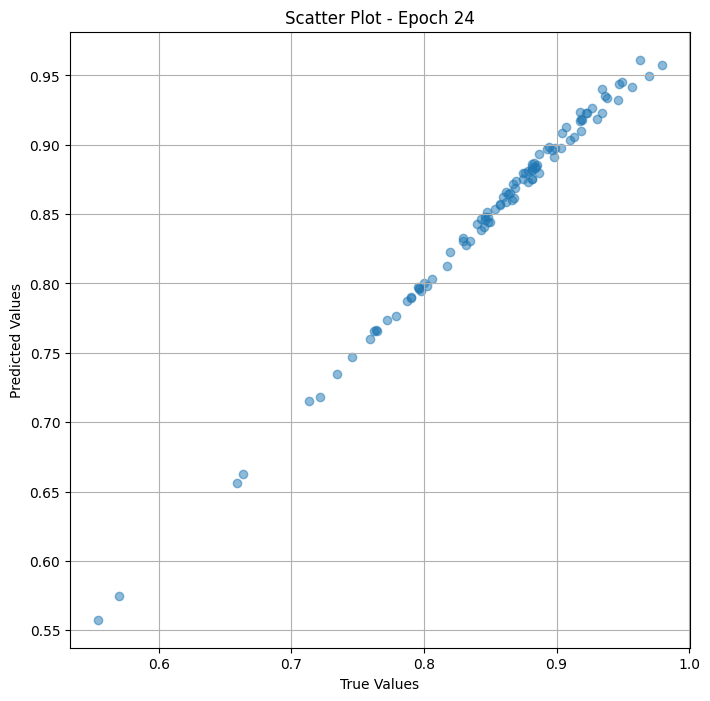

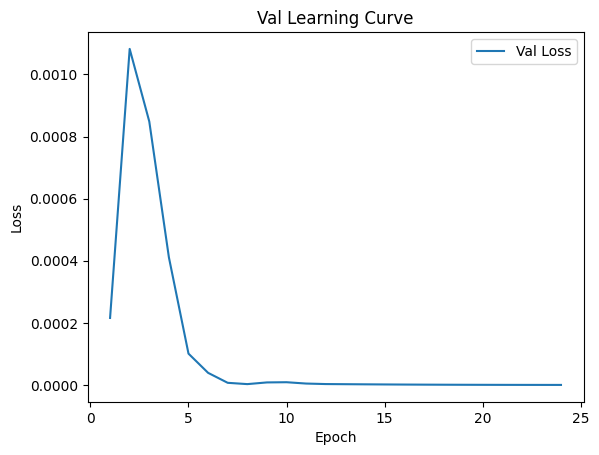


 Epoch: (25/50) Loss = 1.6964911253580794e-07

 Epoch: (25/50) Loss_rmse = 0.00041188483010046184

 Epoch: (25/50) R^2 = 0.9999294877052307

 Epoch: (25/50) MAE = 0.0002686828374862671
Spearman correlation coefficient: SignificanceResult(statistic=0.9951571233399064, pvalue=1.6408518717470375e-96)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

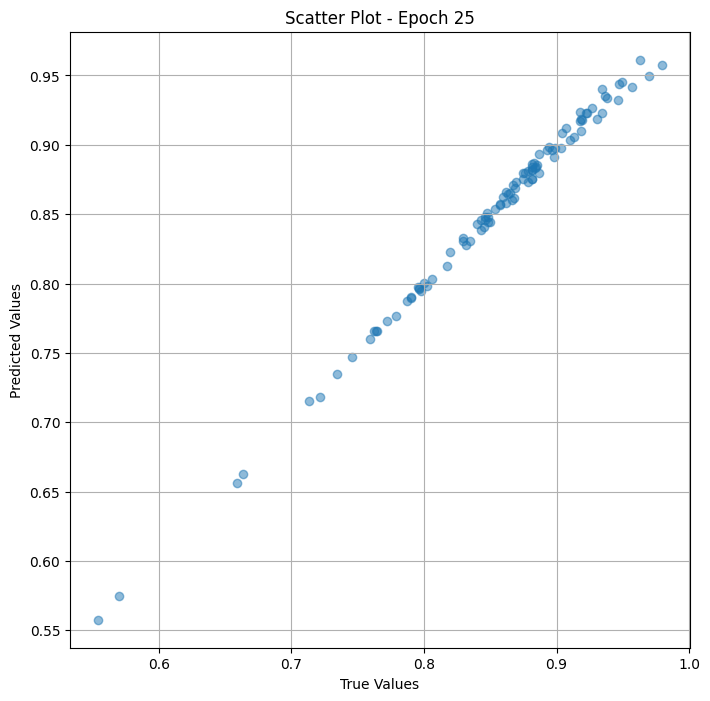

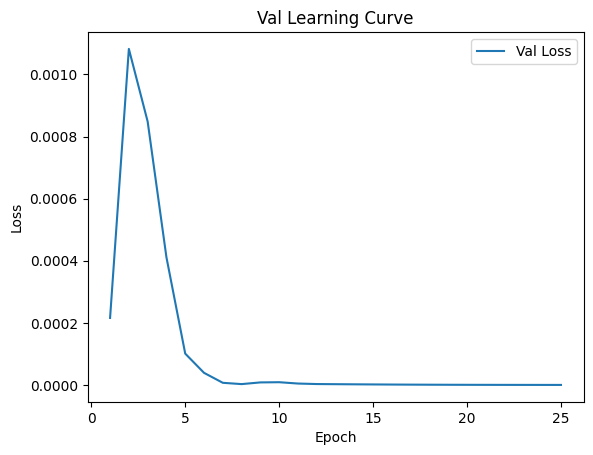


 Epoch: (26/50) Loss = 1.4597902975310717e-07

 Epoch: (26/50) Loss_rmse = 0.0003820720303338021

 Epoch: (26/50) R^2 = 0.9999393224716187

 Epoch: (26/50) MAE = 0.00024369359016418457
Spearman correlation coefficient: SignificanceResult(statistic=0.9952927781798849, pvalue=4.3299037390900953e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

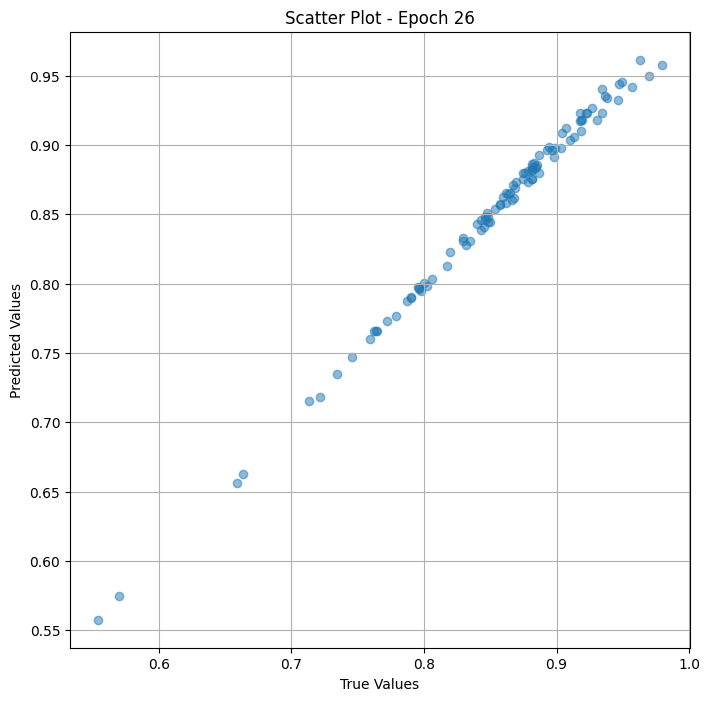

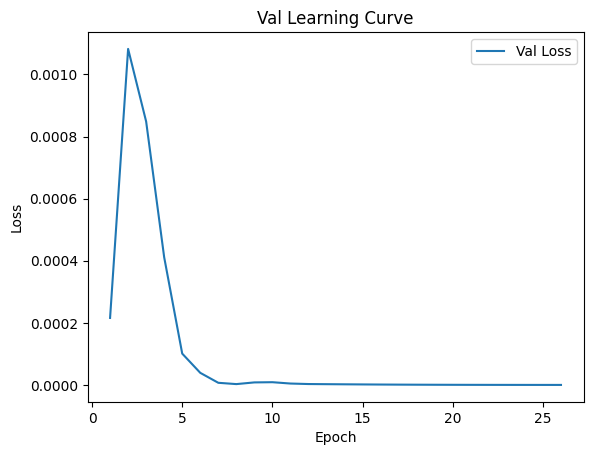


 Epoch: (27/50) Loss = 1.297551079915138e-07

 Epoch: (27/50) Loss_rmse = 0.0003602153738029301

 Epoch: (27/50) R^2 = 0.999946117401123

 Epoch: (27/50) MAE = 0.00023092329502105713
Spearman correlation coefficient: SignificanceResult(statistic=0.9953063436638826, pvalue=3.781834635187115e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

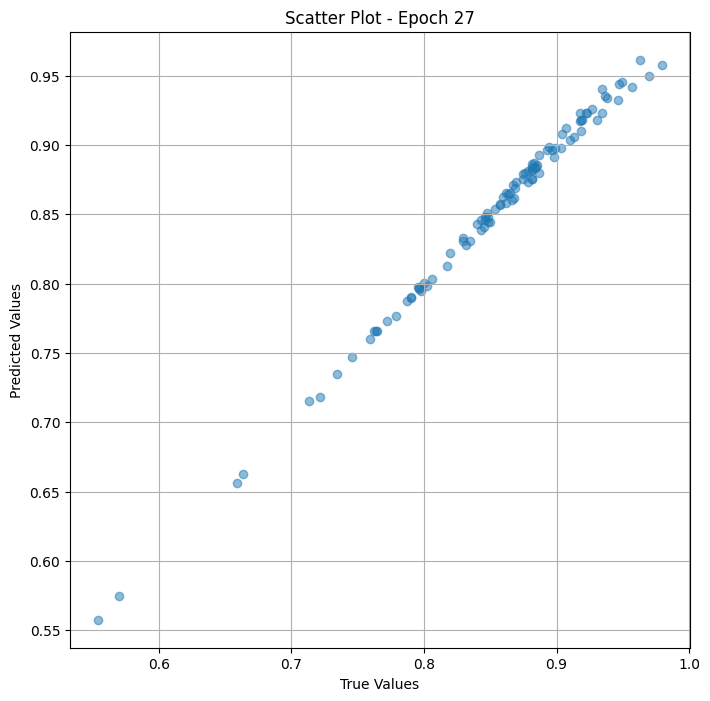

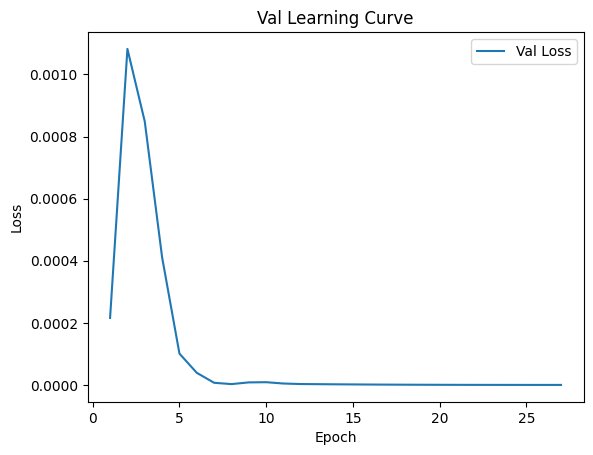


 Epoch: (28/50) Loss = 1.1882222850090329e-07

 Epoch: (28/50) Loss_rmse = 0.00034470600076019764

 Epoch: (28/50) R^2 = 0.999950647354126

 Epoch: (28/50) MAE = 0.00024327635765075684
Spearman correlation coefficient: SignificanceResult(statistic=0.9953063436638826, pvalue=3.781834635187115e-97)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835,

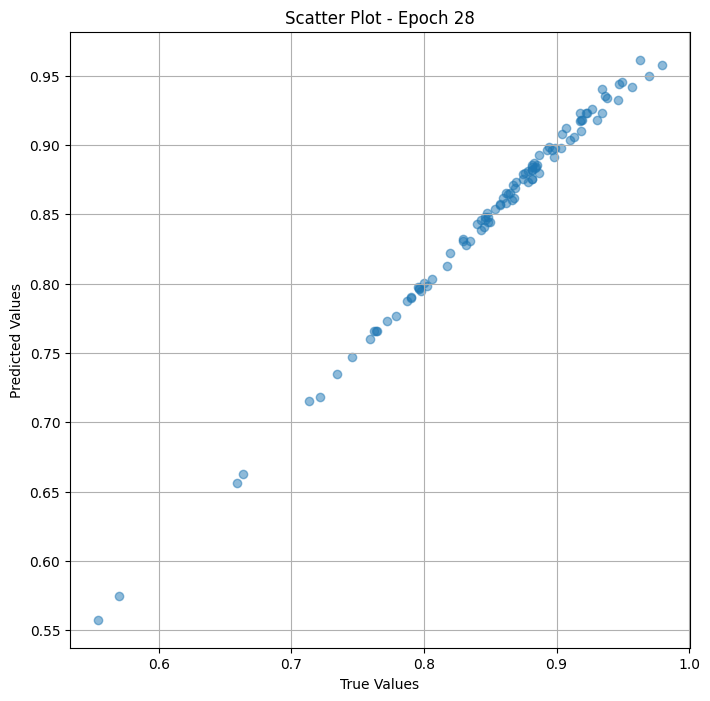

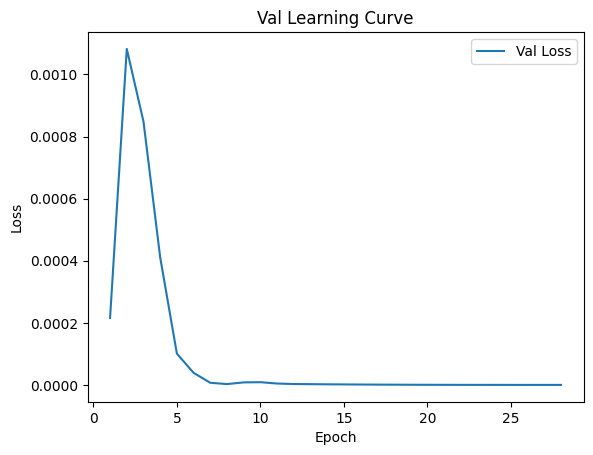


 Epoch: (29/50) Loss = 1.118670738264882e-07

 Epoch: (29/50) Loss_rmse = 0.0003344653523527086

 Epoch: (29/50) R^2 = 0.9999535083770752

 Epoch: (29/50) MAE = 0.00025428831577301025
Spearman correlation coefficient: SignificanceResult(statistic=0.9954419985038611, pvalue=9.558759421319948e-98)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

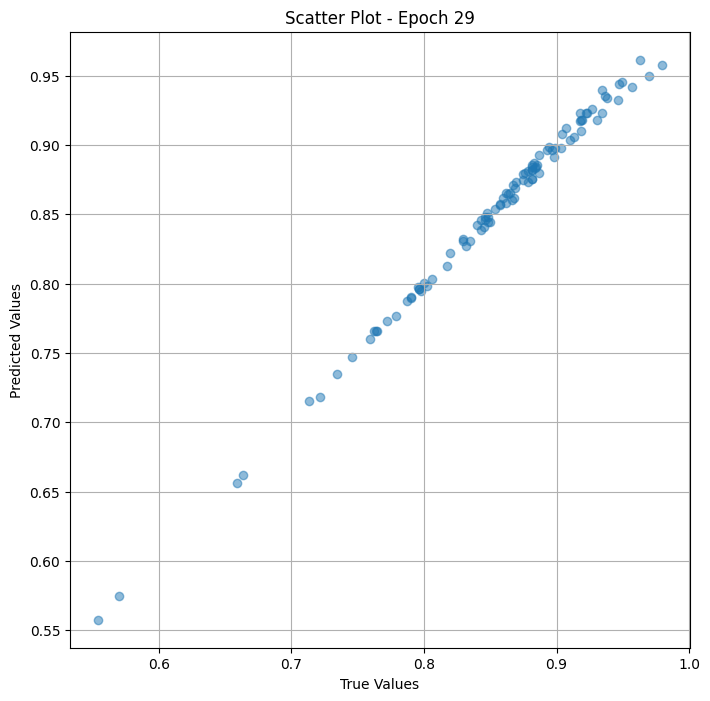

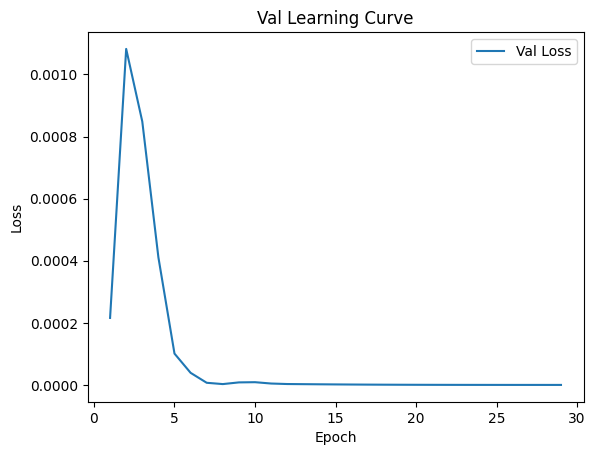


 Epoch: (30/50) Loss = 1.0757838708741474e-07

 Epoch: (30/50) Loss_rmse = 0.0003279914380982518

 Epoch: (30/50) R^2 = 0.9999552965164185

 Epoch: (30/50) MAE = 0.00026363134384155273
Spearman correlation coefficient: SignificanceResult(statistic=0.9957472218938126, pvalue=3.703491656755634e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835,

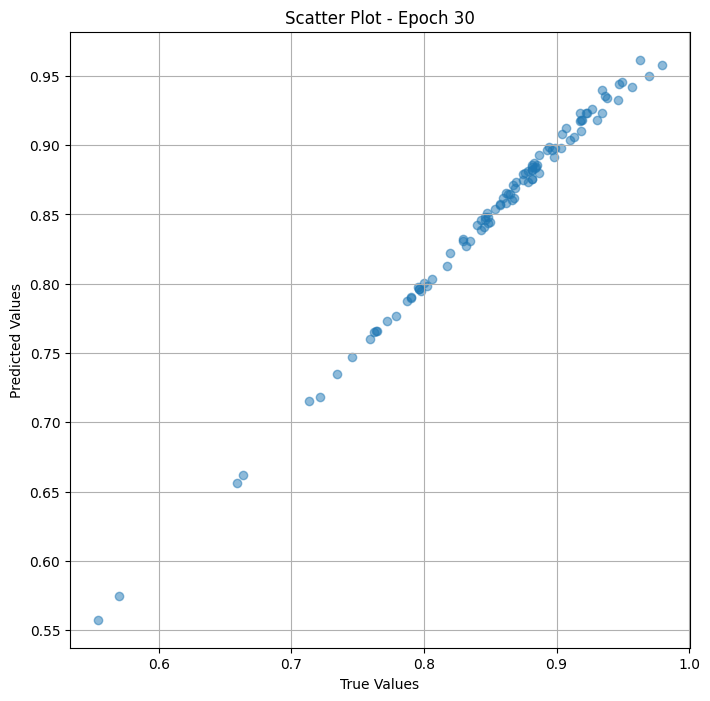

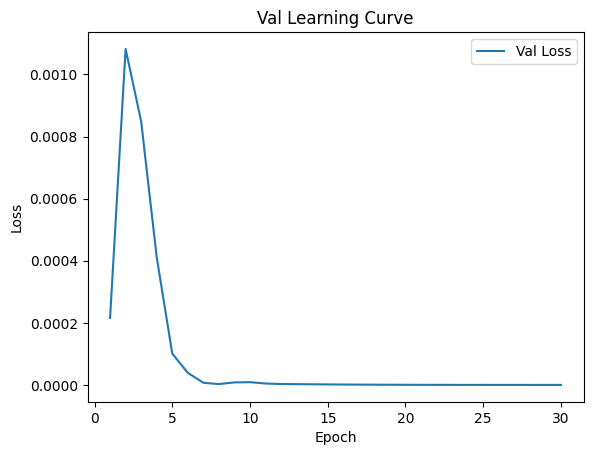


 Epoch: (31/50) Loss = 1.0519636362005258e-07

 Epoch: (31/50) Loss_rmse = 0.00032433989690616727

 Epoch: (31/50) R^2 = 0.9999563097953796

 Epoch: (31/50) MAE = 0.0002716332674026489
Spearman correlation coefficient: SignificanceResult(statistic=0.9957472218938126, pvalue=3.703491656755634e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835,

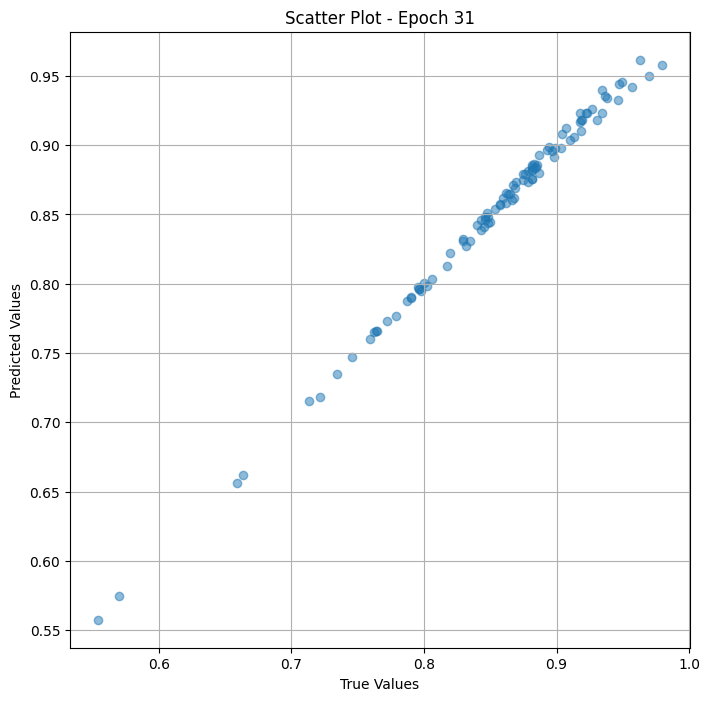

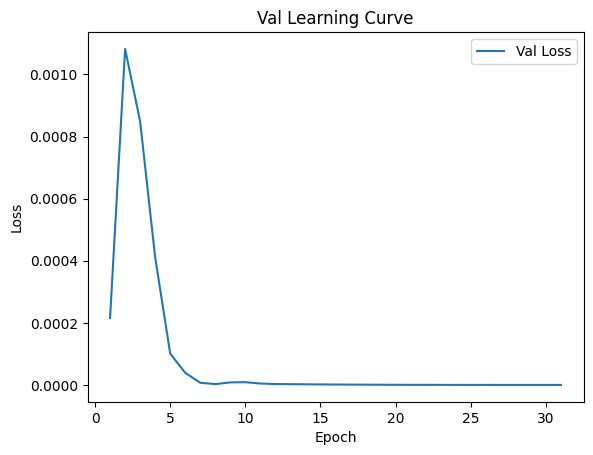


 Epoch: (32/50) Loss = 1.0405305772565043e-07

 Epoch: (32/50) Loss_rmse = 0.0003225725668016821

 Epoch: (32/50) R^2 = 0.9999567866325378

 Epoch: (32/50) MAE = 0.0002785623073577881
Spearman correlation coefficient: SignificanceResult(statistic=0.9957472218938126, pvalue=3.703491656755634e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

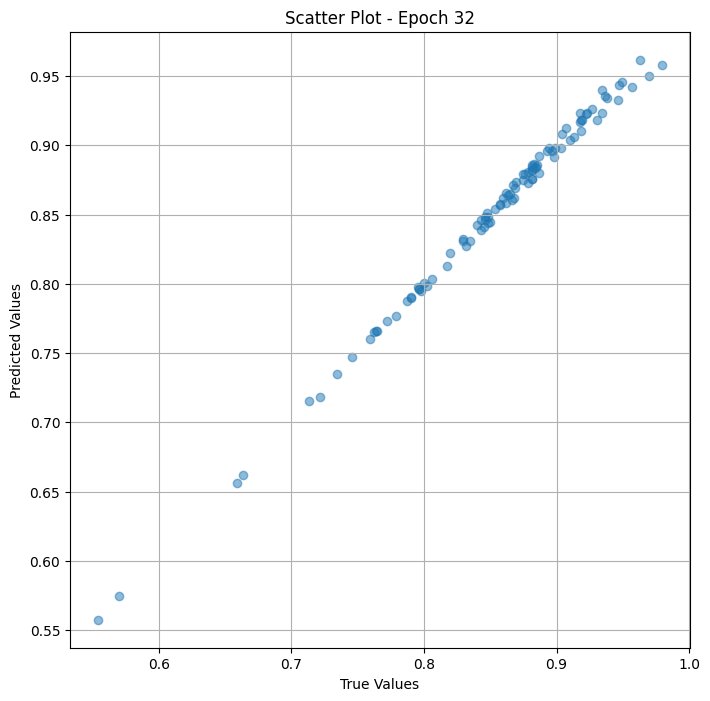

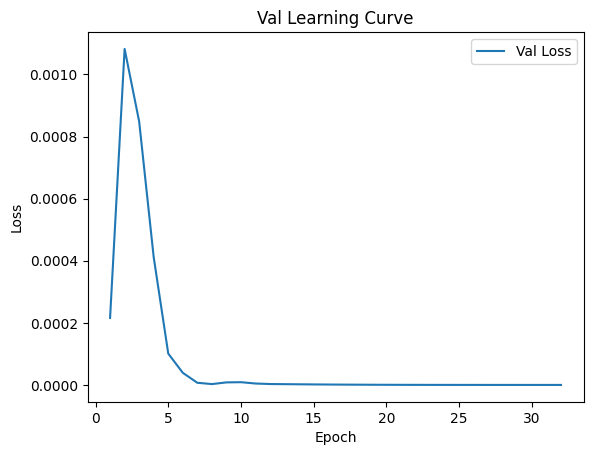


 Epoch: (33/50) Loss = 1.0360711399926004e-07

 Epoch: (33/50) Loss_rmse = 0.0003218805941287428

 Epoch: (33/50) R^2 = 0.9999569654464722

 Epoch: (33/50) MAE = 0.000284045934677124
Spearman correlation coefficient: SignificanceResult(statistic=0.9957472218938126, pvalue=3.703491656755634e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 0

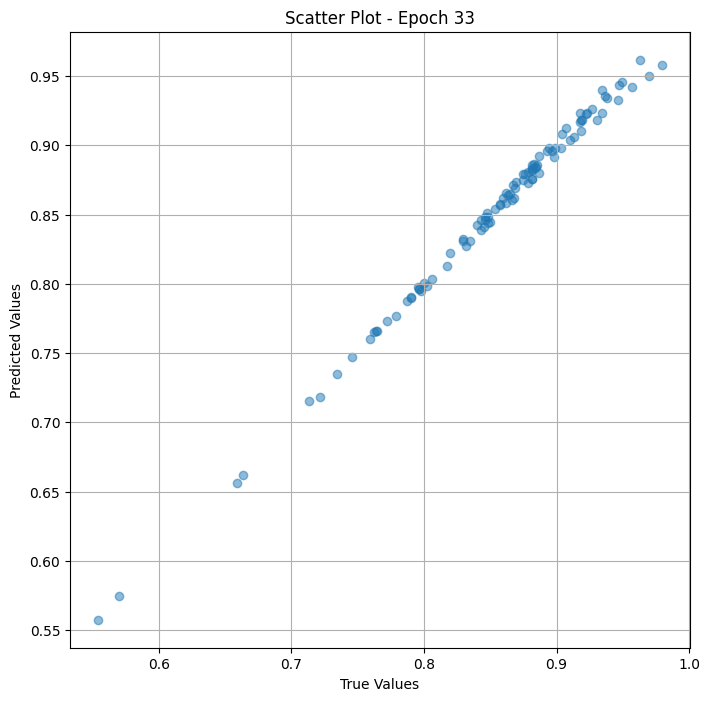

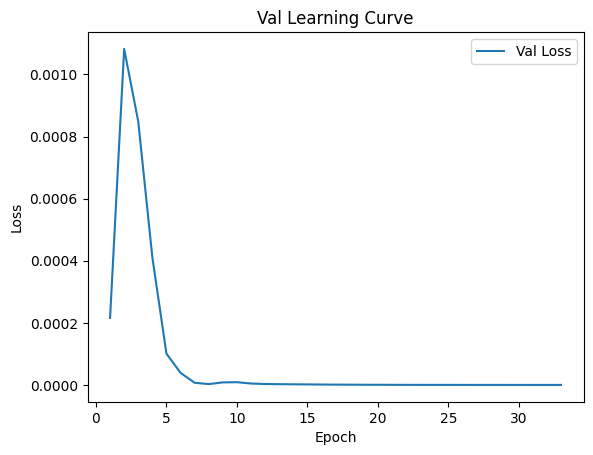


 Epoch: (34/50) Loss = 1.0365575064952282e-07

 Epoch: (34/50) Loss_rmse = 0.00032195611856877804

 Epoch: (34/50) R^2 = 0.9999569058418274

 Epoch: (34/50) MAE = 0.0002887994050979614
Spearman correlation coefficient: SignificanceResult(statistic=0.9957743528618083, pvalue=2.7430960198164233e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

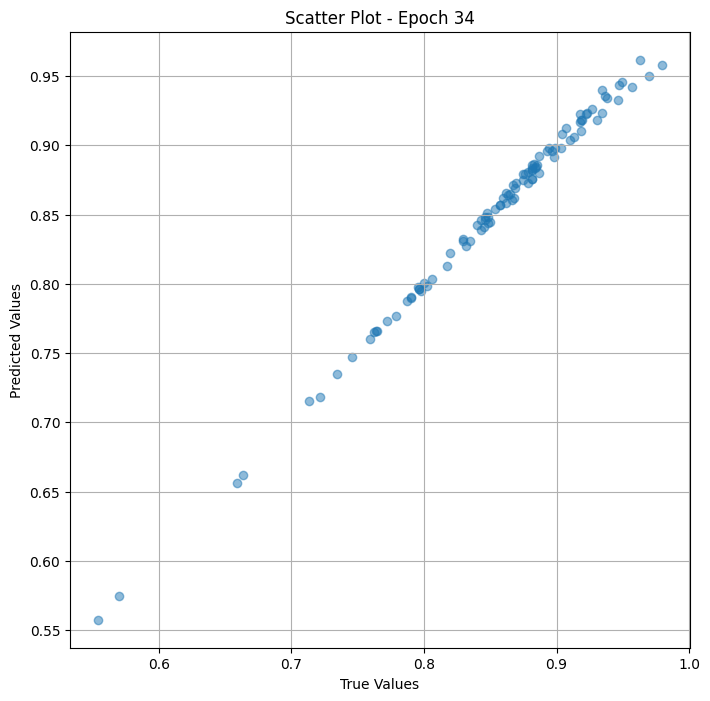

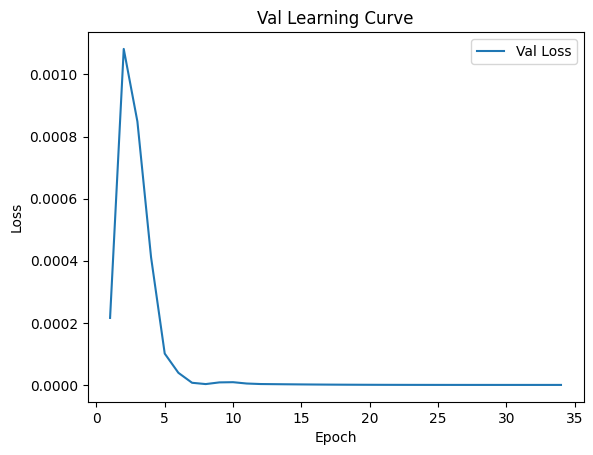


 Epoch: (35/50) Loss = 1.0373665304541646e-07

 Epoch: (35/50) Loss_rmse = 0.00032208175980485976

 Epoch: (35/50) R^2 = 0.9999569058418274

 Epoch: (35/50) MAE = 0.0002921968698501587
Spearman correlation coefficient: SignificanceResult(statistic=0.9958421802817975, pvalue=1.284132287682421e-99)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835,

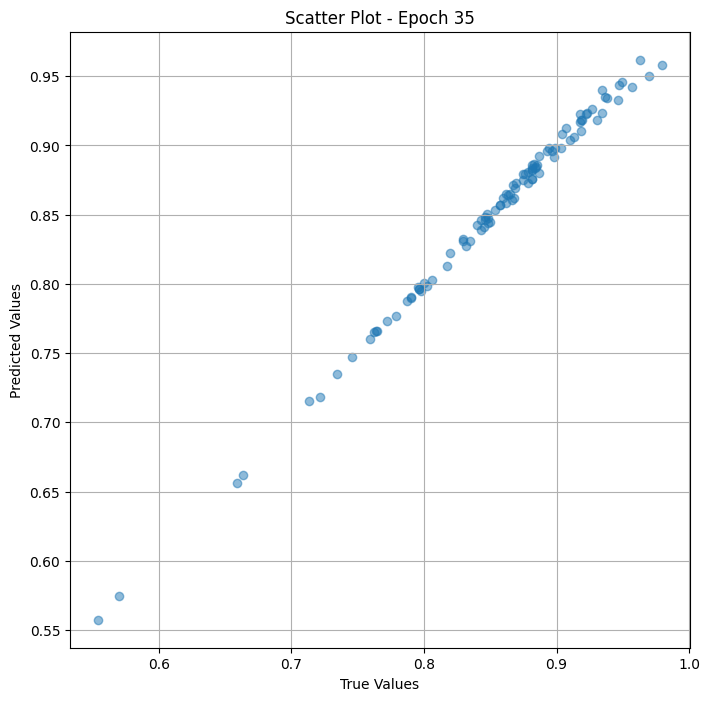

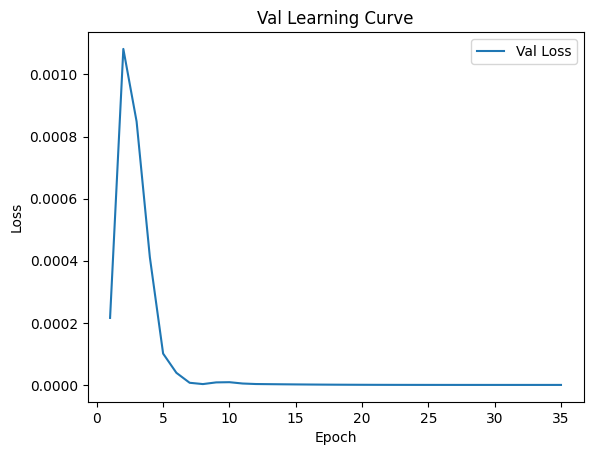

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (36/50) Loss = 1.0393407023912005e-07

 Epoch: (36/50) Loss_rmse = 0.0003223880776204169

 Epoch: (36/50) R^2 = 0.9999568462371826

 Epoch: (36/50) MAE = 0.00029487907886505127
Spearman correlation coefficient: SignificanceResult(statistic=0.9960320970577674, pvalue=1.4326959984380634e-100)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.745

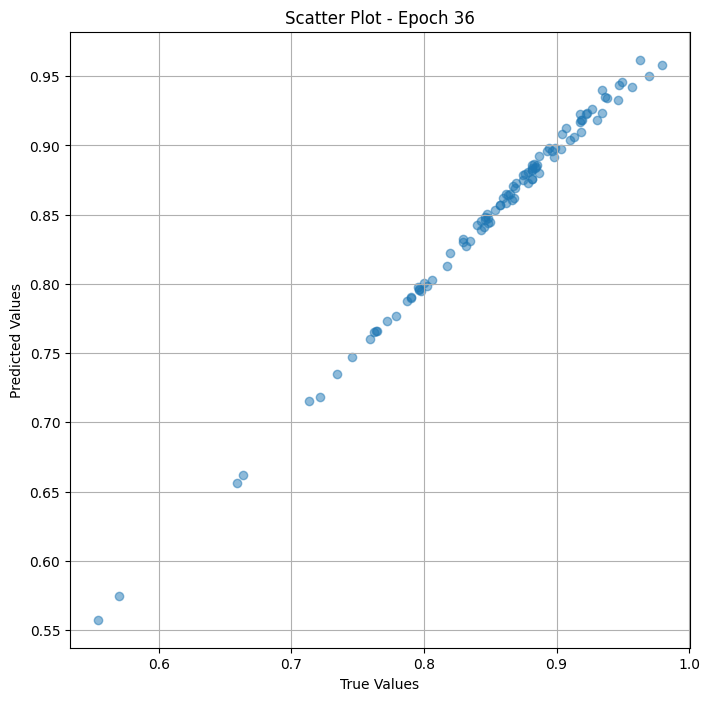

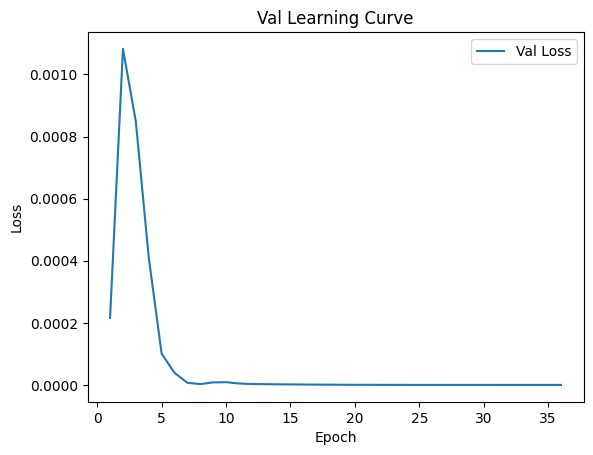


 Epoch: (37/50) Loss = 1.0398157712643297e-07

 Epoch: (37/50) Loss_rmse = 0.00032246173941530287

 Epoch: (37/50) R^2 = 0.9999567866325378

 Epoch: (37/50) MAE = 0.0002956986427307129
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

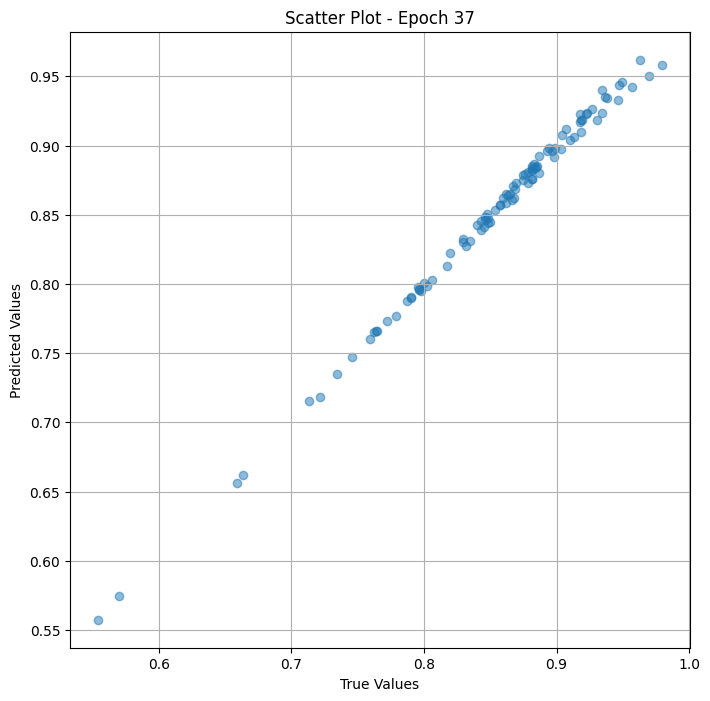

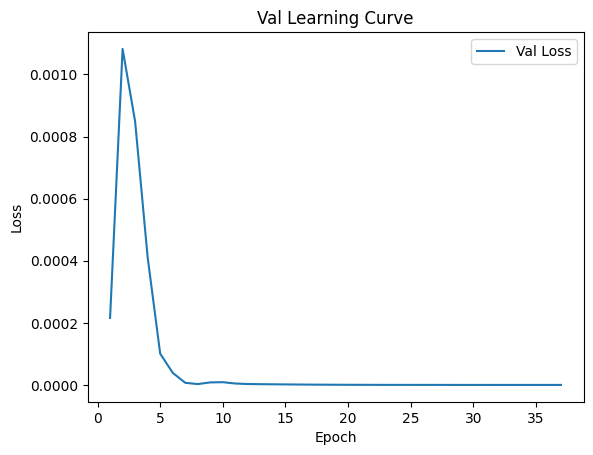


 Epoch: (38/50) Loss = 1.0400117389508523e-07

 Epoch: (38/50) Loss_rmse = 0.0003224921238142997

 Epoch: (38/50) R^2 = 0.9999567866325378

 Epoch: (38/50) MAE = 0.00029587745666503906
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

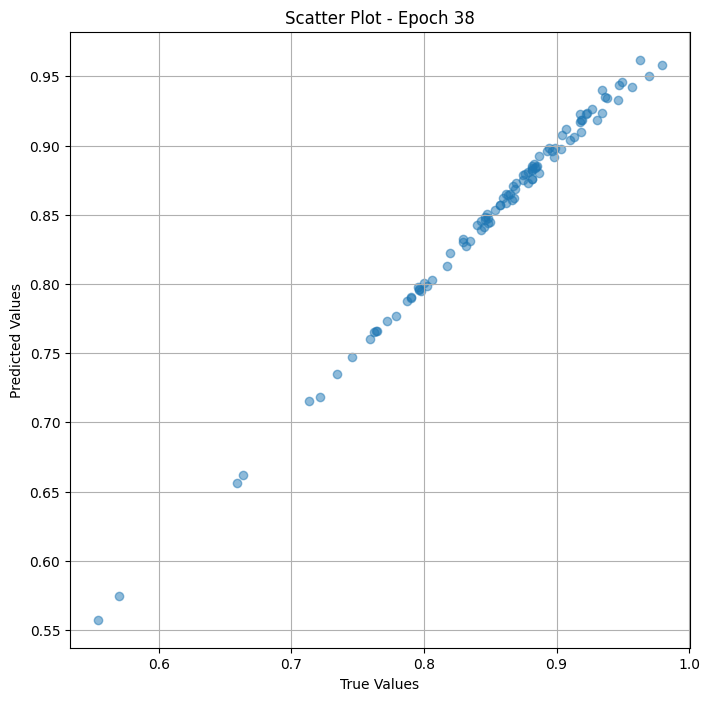

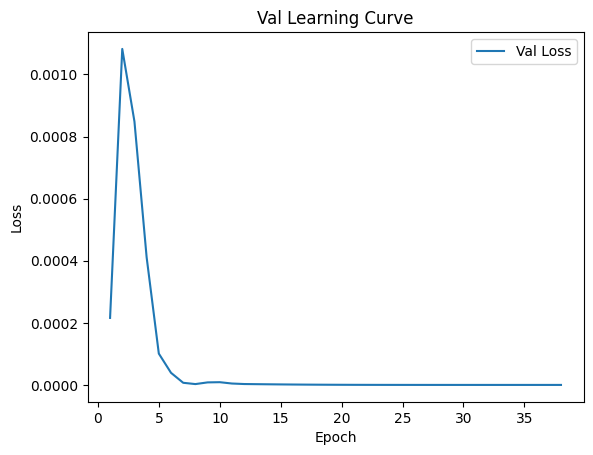

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (39/50) Loss = 1.0391876514859177e-07

 Epoch: (39/50) Loss_rmse = 0.0003223643288947642

 Epoch: (39/50) R^2 = 0.9999568462371826

 Epoch: (39/50) MAE = 0.0002958327531814575
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.74576

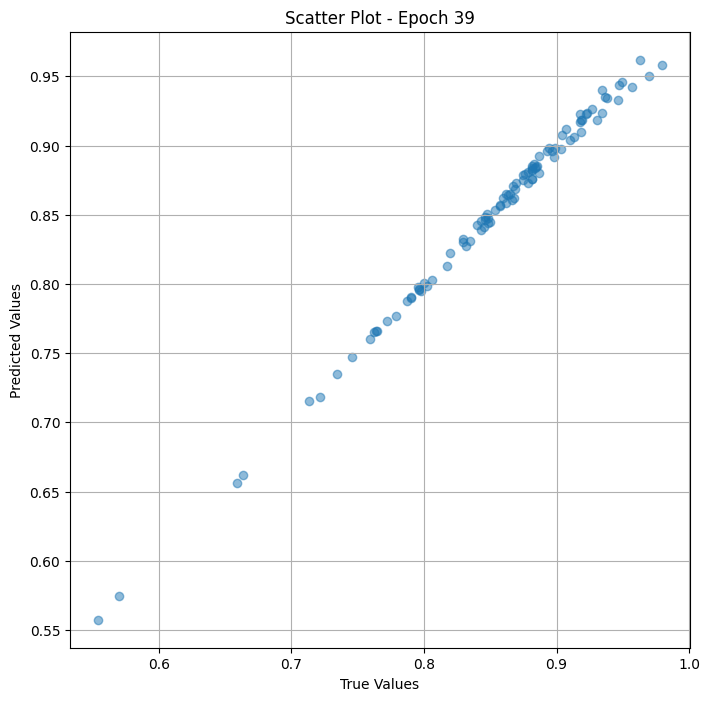

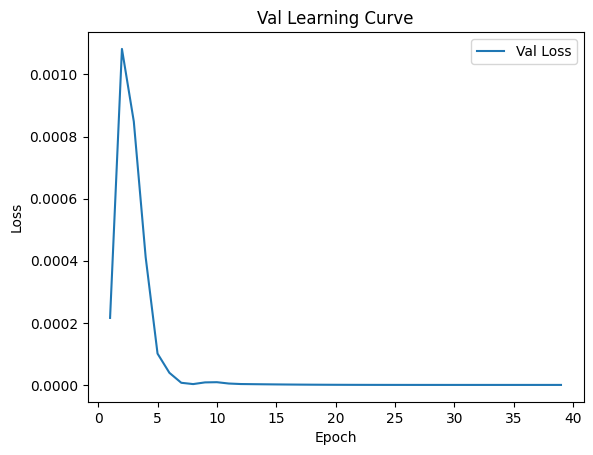


 Epoch: (40/50) Loss = 1.0391955385102847e-07

 Epoch: (40/50) Loss_rmse = 0.00032236555125564337

 Epoch: (40/50) R^2 = 0.9999568462371826

 Epoch: (40/50) MAE = 0.0002958923578262329
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

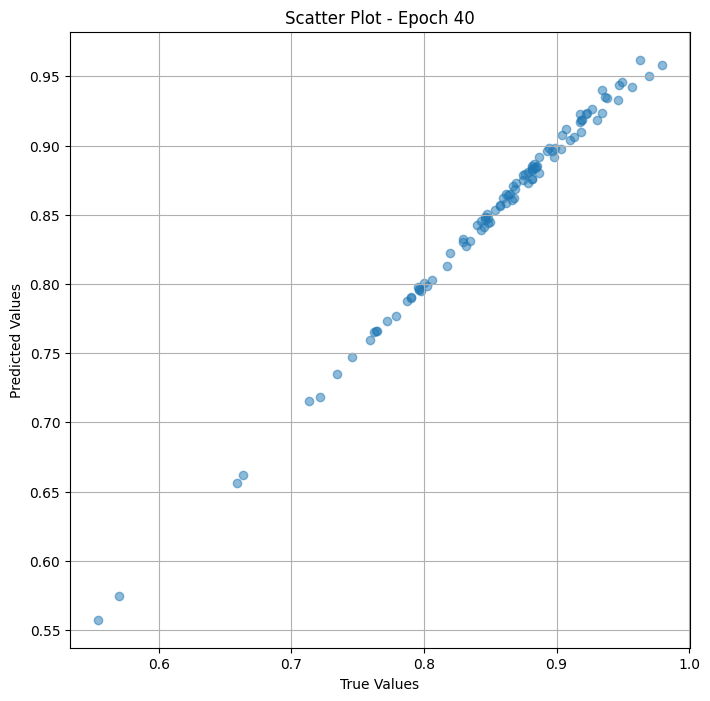

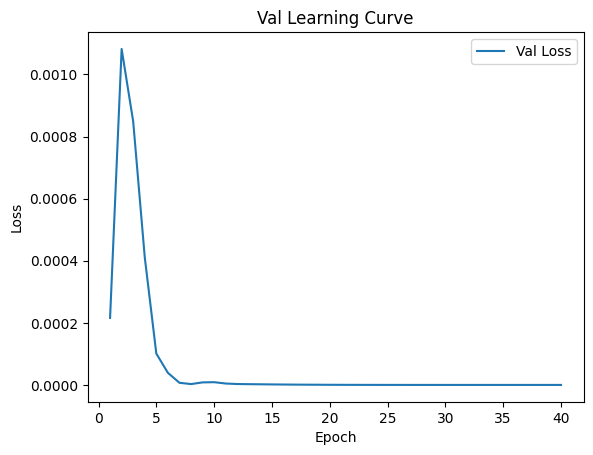


 Epoch: (41/50) Loss = 1.0393490867954824e-07

 Epoch: (41/50) Loss_rmse = 0.00032238938729278743

 Epoch: (41/50) R^2 = 0.9999568462371826

 Epoch: (41/50) MAE = 0.00029593706130981445
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.7959183

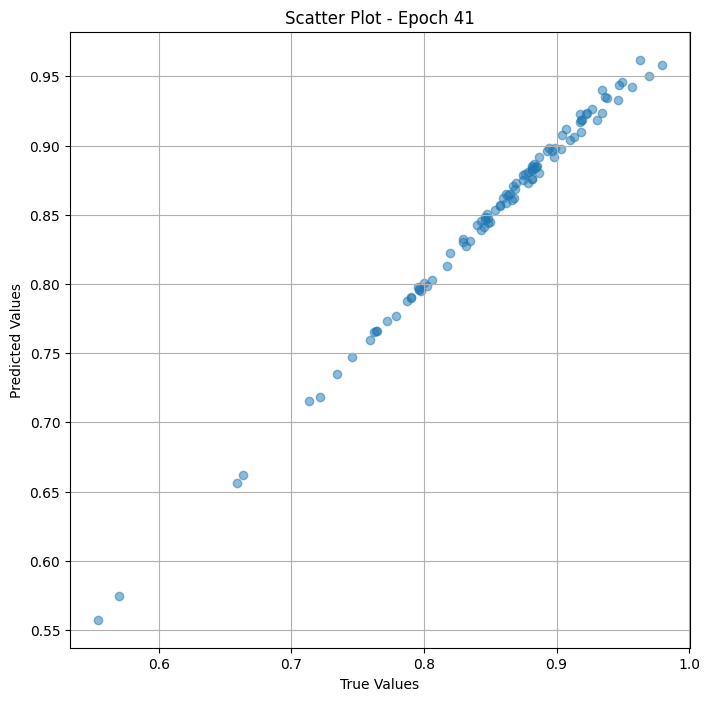

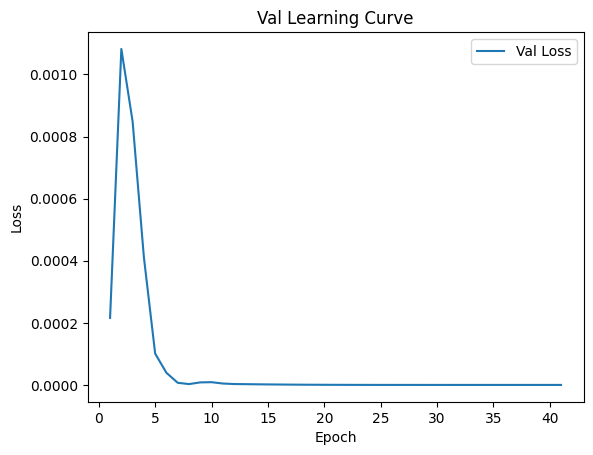


 Epoch: (42/50) Loss = 1.0394967375759734e-07

 Epoch: (42/50) Loss_rmse = 0.0003224122629035264

 Epoch: (42/50) R^2 = 0.9999567866325378

 Epoch: (42/50) MAE = 0.0002959519624710083
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835,

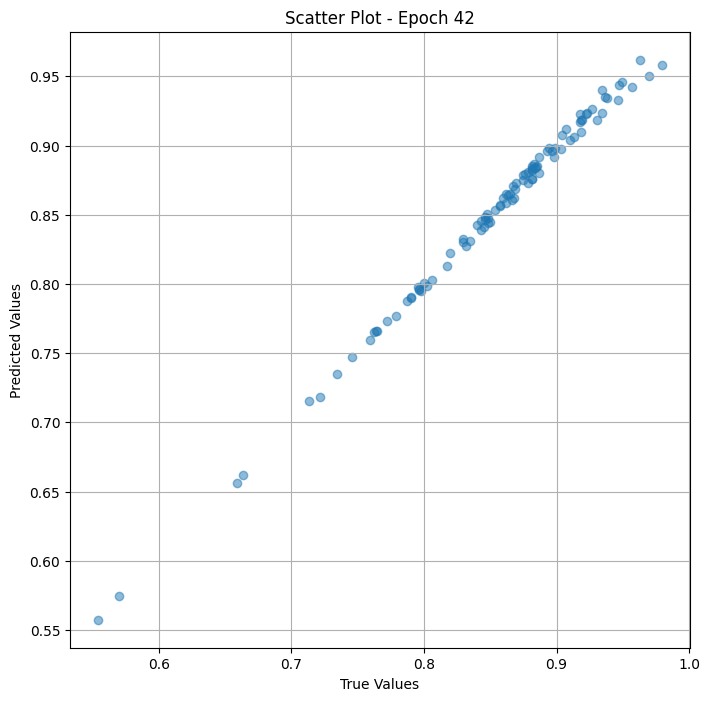

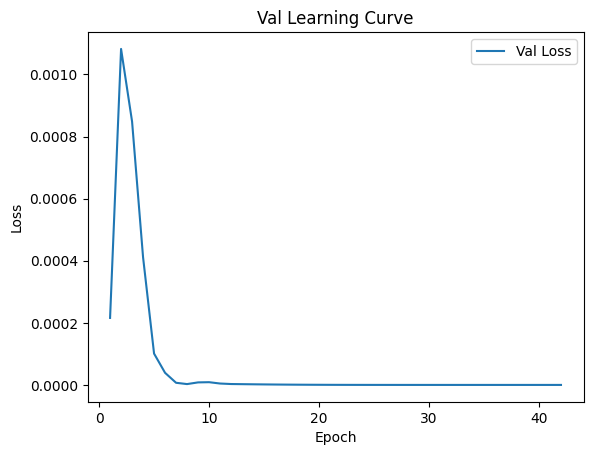


 Epoch: (43/50) Loss = 1.0395267224794225e-07

 Epoch: (43/50) Loss_rmse = 0.0003224169195163995

 Epoch: (43/50) R^2 = 0.9999567866325378

 Epoch: (43/50) MAE = 0.000295981764793396
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

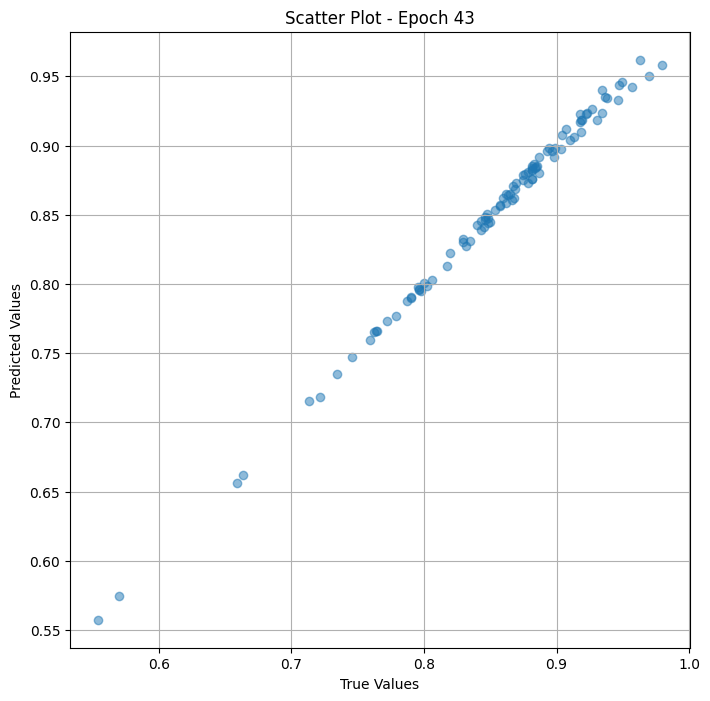

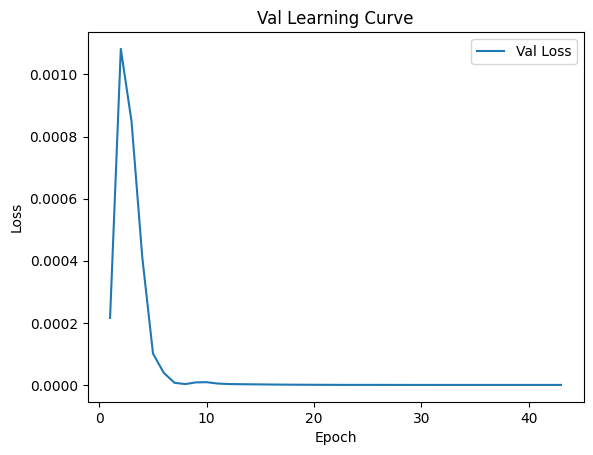


 Epoch: (44/50) Loss = 1.0398041183634632e-07

 Epoch: (44/50) Loss_rmse = 0.00032245993497781456

 Epoch: (44/50) R^2 = 0.9999567866325378

 Epoch: (44/50) MAE = 0.0002960413694381714
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

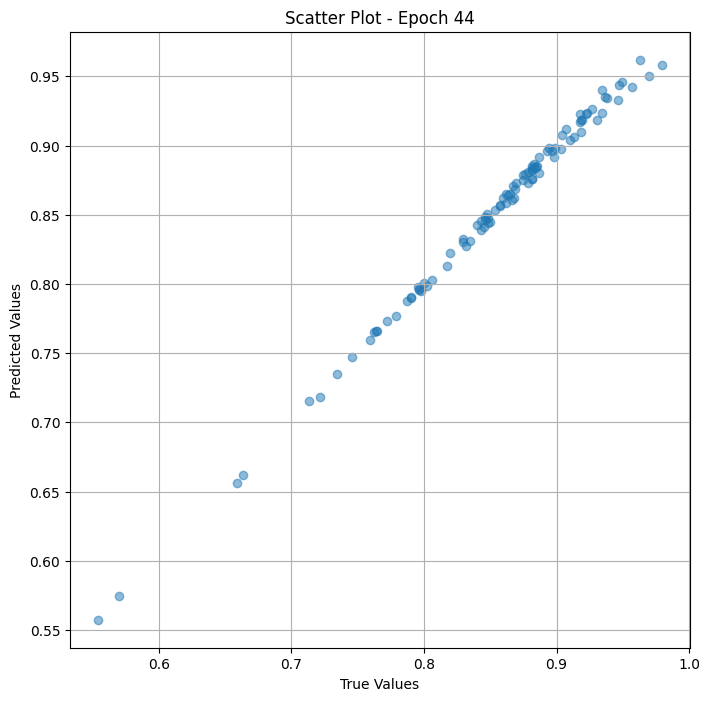

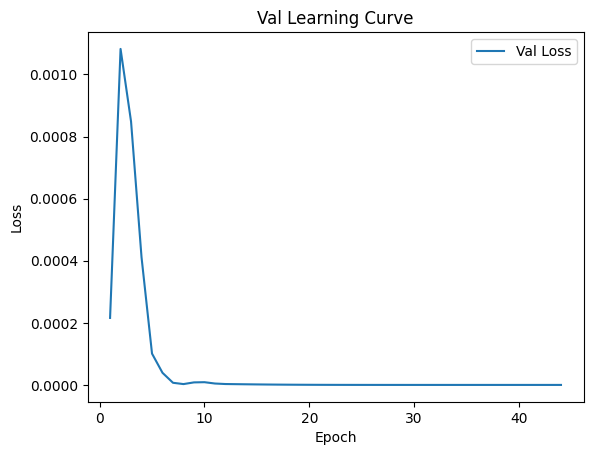


 Epoch: (45/50) Loss = 1.0396368566034653e-07

 Epoch: (45/50) Loss_rmse = 0.0003224340034648776

 Epoch: (45/50) R^2 = 0.9999567866325378

 Epoch: (45/50) MAE = 0.000295981764793396
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

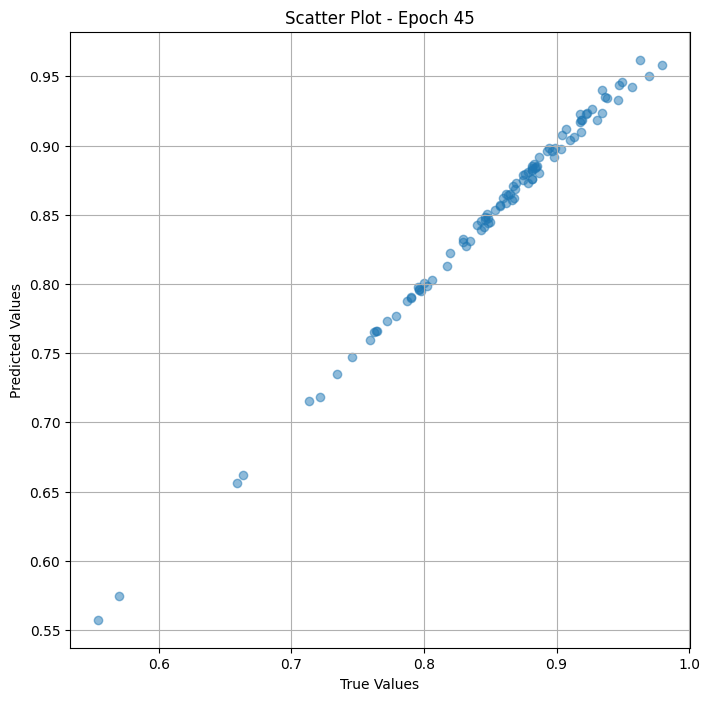

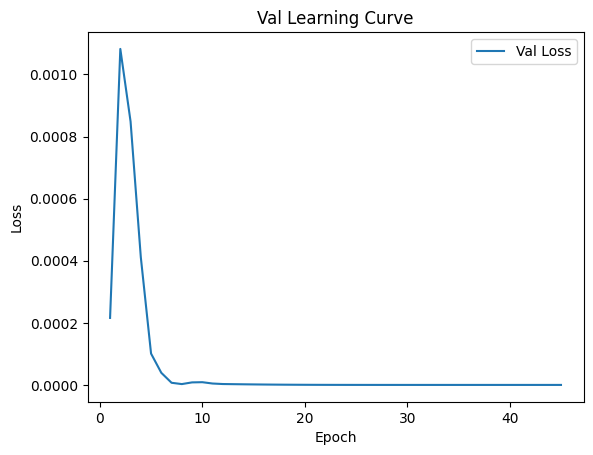


 Epoch: (46/50) Loss = 1.0395718419431432e-07

 Epoch: (46/50) Loss_rmse = 0.0003224239335395396

 Epoch: (46/50) R^2 = 0.9999567866325378

 Epoch: (46/50) MAE = 0.00029596686363220215
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

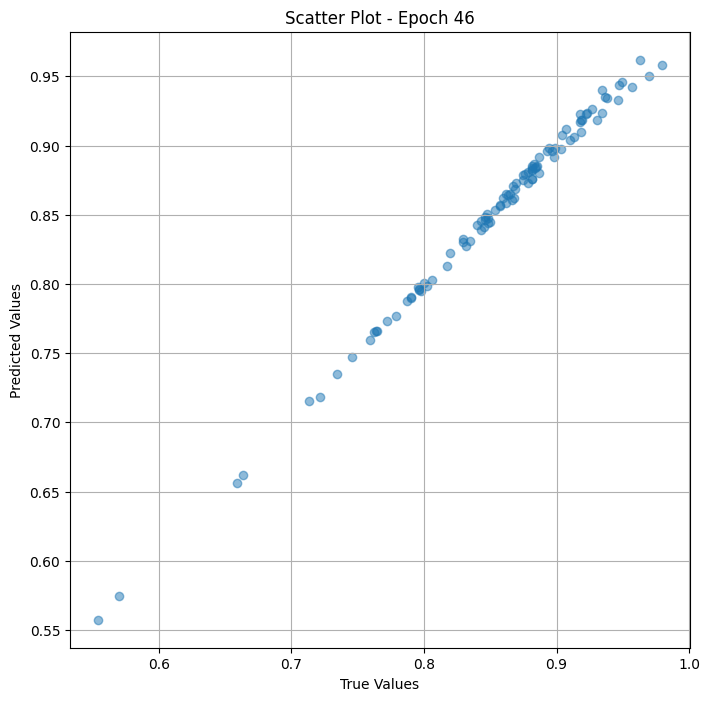

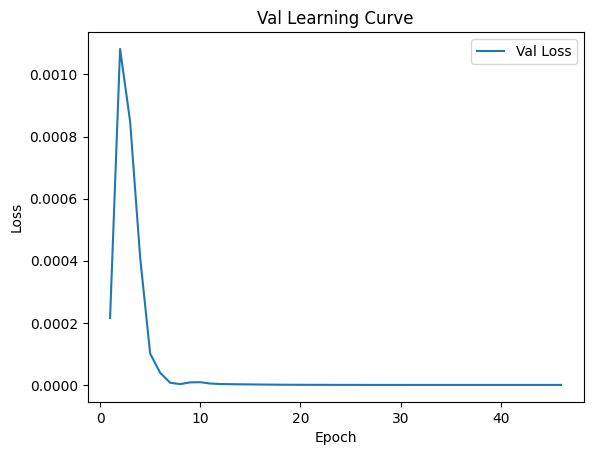


 Epoch: (47/50) Loss = 1.0398601091310411e-07

 Epoch: (47/50) Loss_rmse = 0.00032246860791929066

 Epoch: (47/50) R^2 = 0.9999567866325378

 Epoch: (47/50) MAE = 0.00029599666595458984
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.7959183

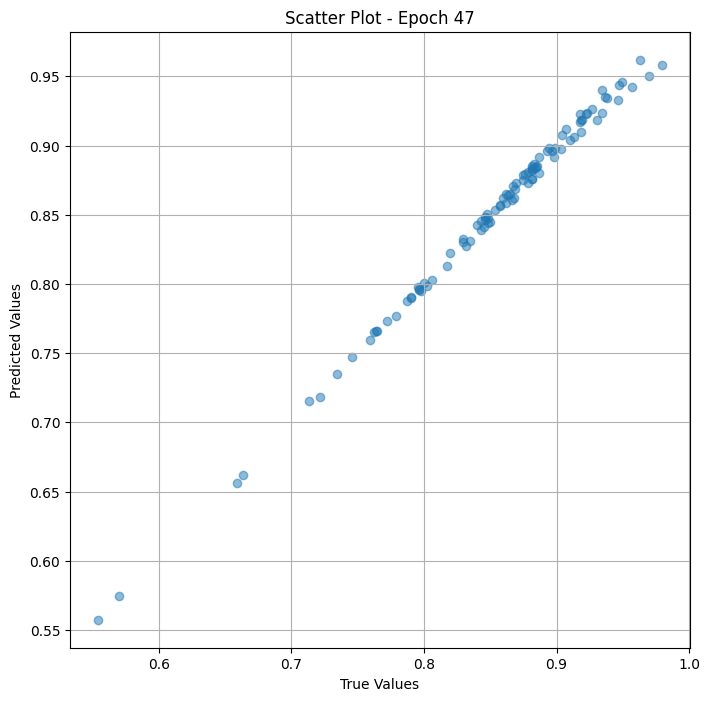

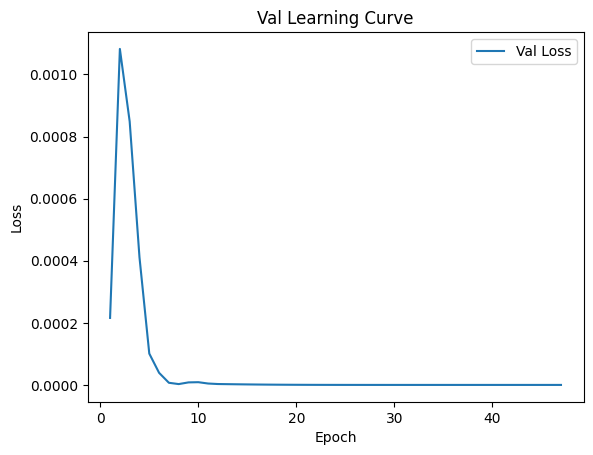


 Epoch: (48/50) Loss = 1.0399350003353902e-07

 Epoch: (48/50) Loss_rmse = 0.0003224802203476429

 Epoch: (48/50) R^2 = 0.9999567866325378

 Epoch: (48/50) MAE = 0.00029602646827697754
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

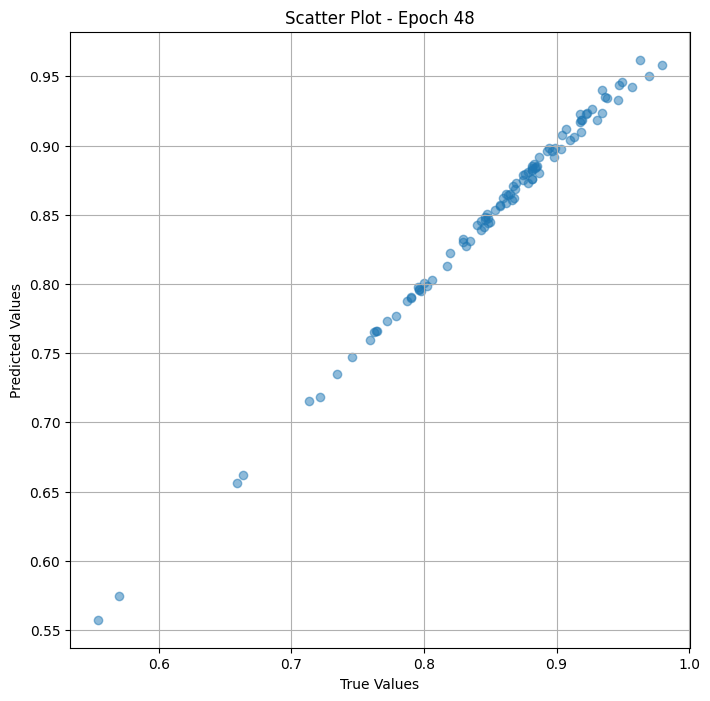

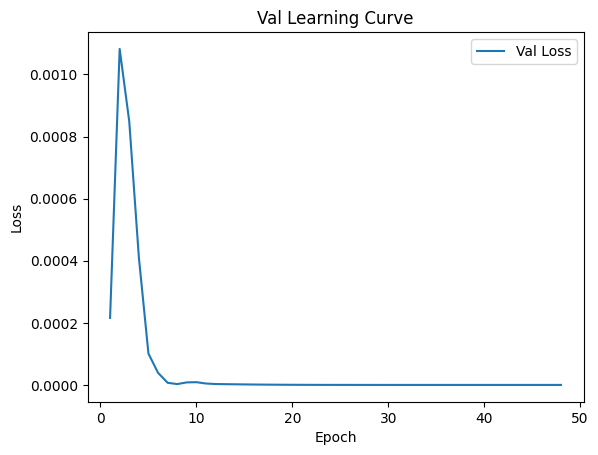


 Epoch: (49/50) Loss = 1.040329706825105e-07

 Epoch: (49/50) Loss_rmse = 0.0003225414257030934

 Epoch: (49/50) R^2 = 0.9999567866325378

 Epoch: (49/50) MAE = 0.0002960711717605591
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835, 

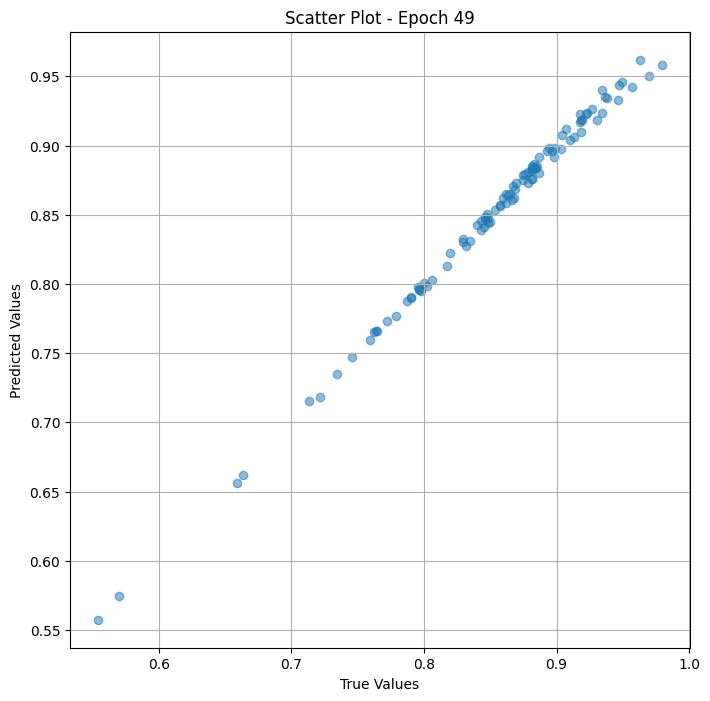

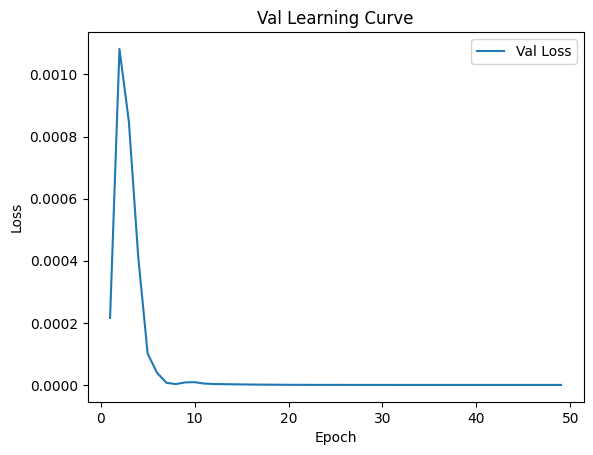


 Epoch: (50/50) Loss = 1.0398800043276424e-07

 Epoch: (50/50) Loss_rmse = 0.0003224716929253191

 Epoch: (50/50) R^2 = 0.9999567866325378

 Epoch: (50/50) MAE = 0.00029602646827697754
Spearman correlation coefficient: SignificanceResult(statistic=0.9960727935097609, pvalue=8.833230665253634e-101)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.7638889, 0.8192771, 0.8598131, 0.89285713, 0.79569894, 0.875, 0.76237625, 0.84, 0.87628865, 0.90425533, 0.7719298, 0.86170214, 0.8943089, 0.8817204, 0.9072165, 0.84313726, 0.8818182, 0.86915886, 0.82954544, 0.84761906, 0.84615386, 0.9626168, 0.8817204, 0.91752577, 0.82954544, 0.88659793, 0.712963, 0.8828829, 0.86734694, 0.87826085, 0.56989247, 0.93457943, 0.8651685, 0.875, 0.79, 0.84821427, 0.85714287, 0.8636364, 0.88505745, 0.84615386, 0.9174312, 0.7340425, 0.9493671, 0.5543478, 0.9468085, 0.75961536, 0.9381443, 0.7647059, 0.85714287, 0.7457627, 0.8962264, 0.79591835, 0.79, 0.8, 0.88349515, 0.79591835

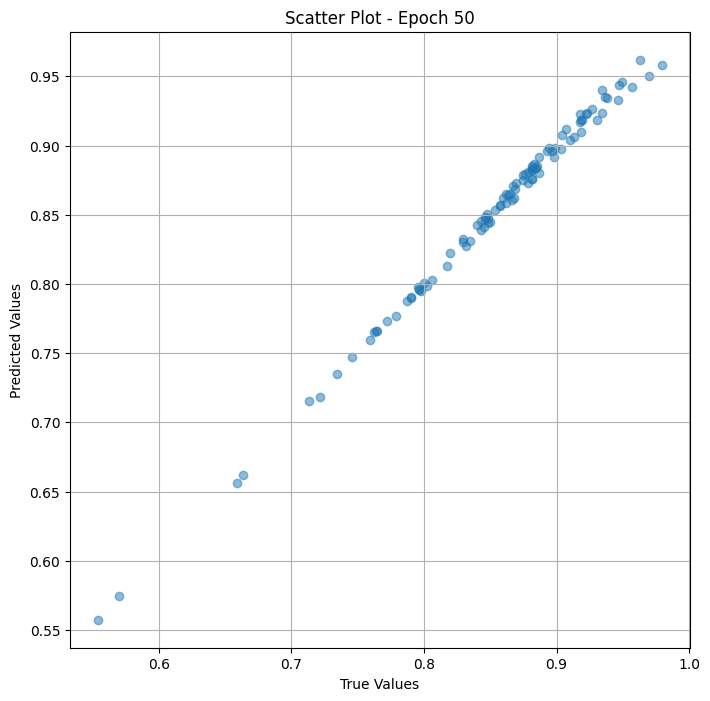

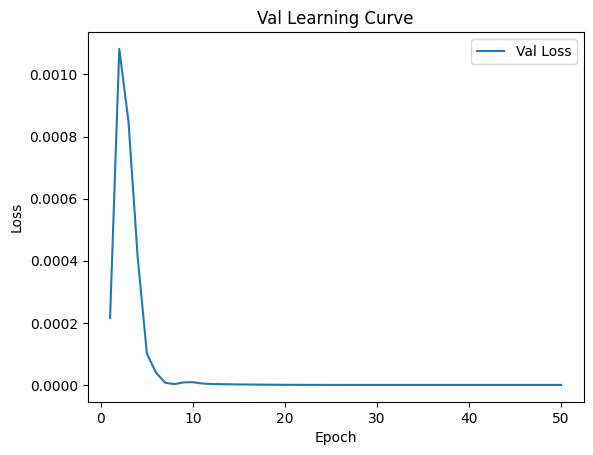

In [ ]:
# val the model and save weights
fit(50, model_res_val  , val_dl )
torch.save(model_res_val.state_dict(), "model_weights_s")

## Test

In [ ]:
params = [param for param in list(model_res_test.parameters()) if param.requires_grad == True ]
optimizer = torch.optim.Adam(params, lr=1e-4 ,weight_decay=1e-7)

lr_scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
    optimizer,
    mode='min',
    factor=0.1,
    patience=2,
    verbose=True)

In [ ]:
# Define the plot_scatter function
def plot_scatter(true_values, predicted_values, epoch):
    plt.figure(figsize=(8, 8))
    plt.scatter(true_values, predicted_values, alpha=0.5)
    plt.title(f'Scatter Plot - Epoch {epoch+1}')
    plt.xlabel('True Values')
    plt.ylabel('Predicted Values')
    plt.grid(True)
    plt.show()

def plot_learning_curve(loss_list):
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Test Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Test Learning Curve')
    plt.legend()
    plt.show()

def fit(epochs,model_res_test, test_dl):
    opt = optimizer
    sched = lr_scheduler
    loss_func = nn.MSELoss()
    mae_func = nn.L1Loss()
    total_loss_list = []


    for epoch in range(epochs):
        model_res_test.eval()
        batch_num = 32
        true_values_list = []
        predicted_values_list = []

        for x_trans, yb in test_dl:
            total_loss = 0
            total_loss_rmse = 0
            total_r2 = 0
            total_mae = 0
            total_spearman =0
            #total_spearman = 0

            yb = yb.float()

            # Pass the optimizer so that the model will get trained
            preds = model_res_test(x_trans)
            loss = loss_func(preds.squeeze(), yb)
            loss_rmse = torch.sqrt(loss)
            mae = mae_func(preds.squeeze(), yb)

            # Calculate R-squared
            mean_y = torch.mean(yb)
            ss_total = torch.sum((yb - mean_y)**2)
            ss_residual = torch.sum((yb - preds.squeeze())**2)
            r2 = 1 - (ss_residual / ss_total)

            #calculate  spearman
            spearman_corr = spearmanr(true_values_list, predicted_values_list)

             # Accumulate true and predicted values for scatter plot
            true_values_list.extend(yb.cpu().detach().numpy())
            predicted_values_list.extend(preds.squeeze().cpu().detach().numpy())



            # Backpropagation
            loss.backward()
            opt.step()
            opt.zero_grad()

            # Print batch information
            #print('\nBatch:', batch_num)
            #print('True Values:', yb.cpu().detach().numpy())
            #print('Predicted Values:', preds.squeeze().cpu().detach().numpy())

            # Accumulate losses, R-squared, MAE, and Spearman values for the epoch
            total_loss = loss.item()
            total_loss_rmse = loss_rmse.item()
            total_r2 = r2.item()
            total_mae = mae.item()

            # Increment batch number
            batch_num += 10
        # Adjust learning rate scheduler based on total_loss
        sched.step(total_loss, total_loss_rmse)

        # Calculate mean R-squared, MAE, and Spearman for the epoch
        mean_r2 = total_r2 / batch_num
        mean_mae = total_mae / batch_num
        #mean_spearman = total_spearman / len(train_dl)

        # Print epoch information
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss = {total_loss}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) Loss_rmse = {total_loss_rmse}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) R^2 = {total_r2}')
        print('\n', f'Epoch: ({epoch+1}/{epochs}) MAE = {total_mae}')
        print("Spearman correlation coefficient:", spearman_corr)
        print('\n', f"true_values_list_val : { len(true_values_list)}")
        print('\n', f"predicted_values_list_val : {len(predicted_values_list)}")
        print('\n', f"true_values_list_val : { true_values_list}")
        print('\n', f"predicted_values_list_val : {predicted_values_list}")
        total_loss_list.append(total_loss)
        plot_scatter(true_values_list, predicted_values_list, epoch)
        plot_learning_curve(total_loss_list)


 Epoch: (1/50) Loss = 0.00011052608897443861

 Epoch: (1/50) Loss_rmse = 0.010513138957321644

 Epoch: (1/50) R^2 = 0.9536017179489136

 Epoch: (1/50) MAE = 0.009991511702537537
Spearman correlation coefficient: SignificanceResult(statistic=0.9736633275888525, pvalue=3.713311272458506e-62)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606

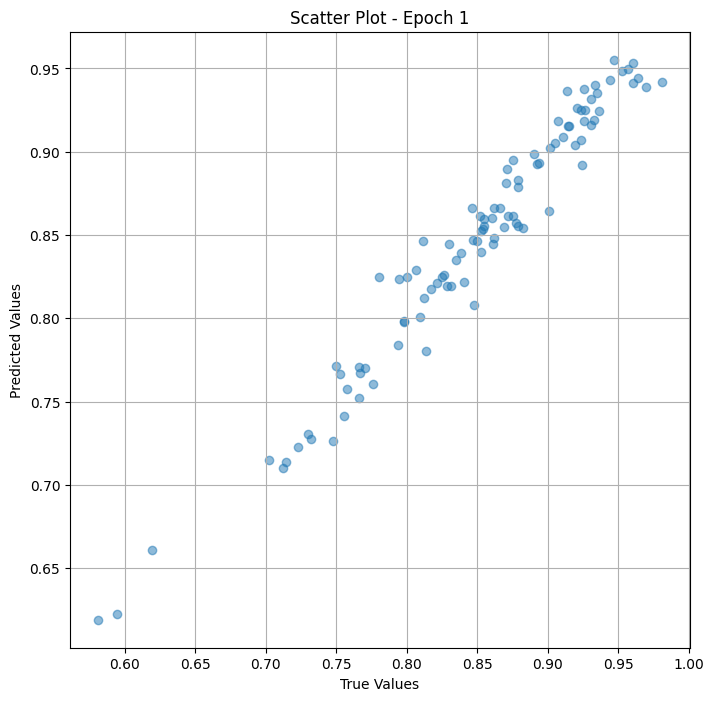

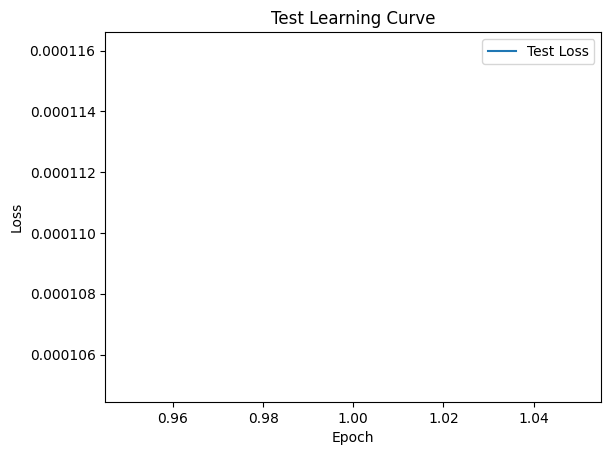


 Epoch: (2/50) Loss = 0.0017922731349244714

 Epoch: (2/50) Loss_rmse = 0.04233524575829506

 Epoch: (2/50) R^2 = 0.24761253595352173

 Epoch: (2/50) MAE = 0.033797308802604675
Spearman correlation coefficient: SignificanceResult(statistic=0.9569782349695695, pvalue=2.6350717716571377e-52)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606

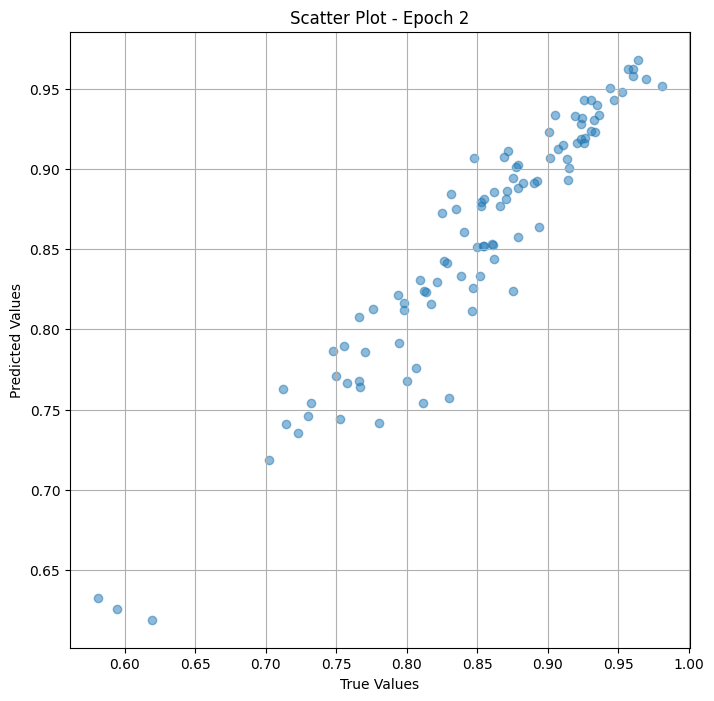

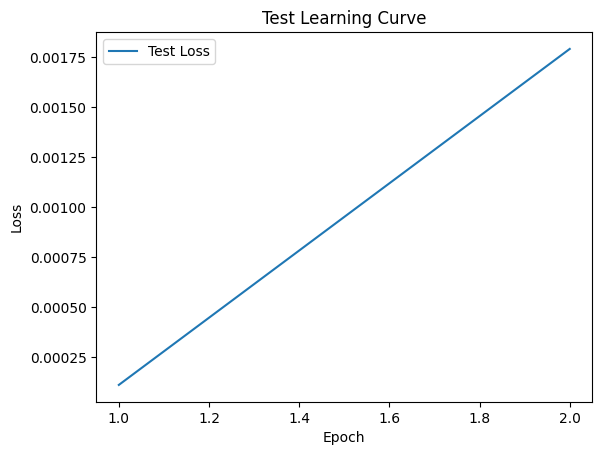


 Epoch: (3/50) Loss = 0.00010942188964691013

 Epoch: (3/50) Loss_rmse = 0.010460492223501205

 Epoch: (3/50) R^2 = 0.954065203666687

 Epoch: (3/50) MAE = 0.010071605443954468
Spearman correlation coefficient: SignificanceResult(statistic=0.9479506503044207, pvalue=1.6542819903942257e-48)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606

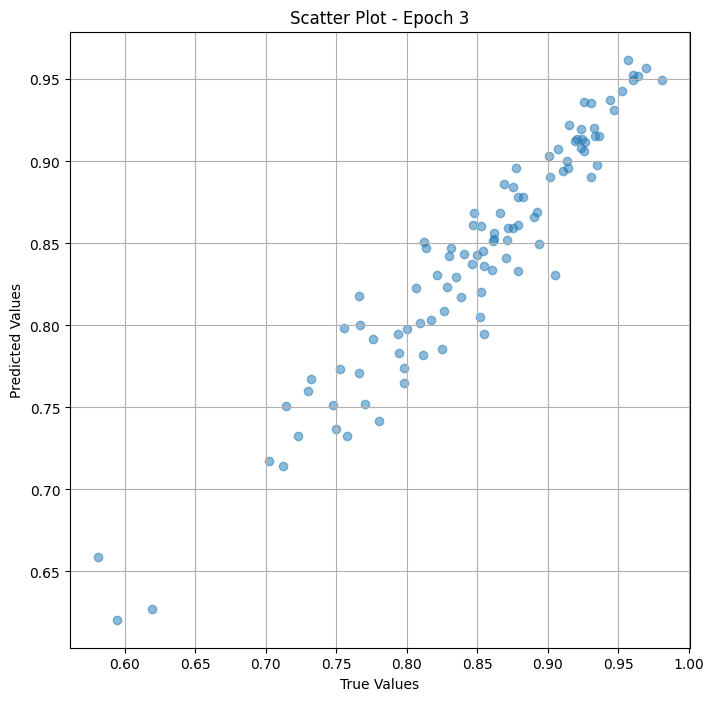

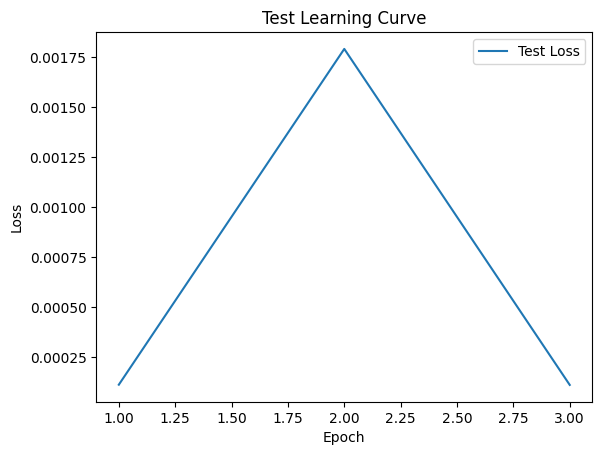


 Epoch: (4/50) Loss = 0.00022043542412575334

 Epoch: (4/50) Loss_rmse = 0.01484706811606884

 Epoch: (4/50) R^2 = 0.9074622988700867

 Epoch: (4/50) MAE = 0.012927070260047913
Spearman correlation coefficient: SignificanceResult(statistic=0.9587823953910042, pvalue=3.6672866170383895e-53)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606

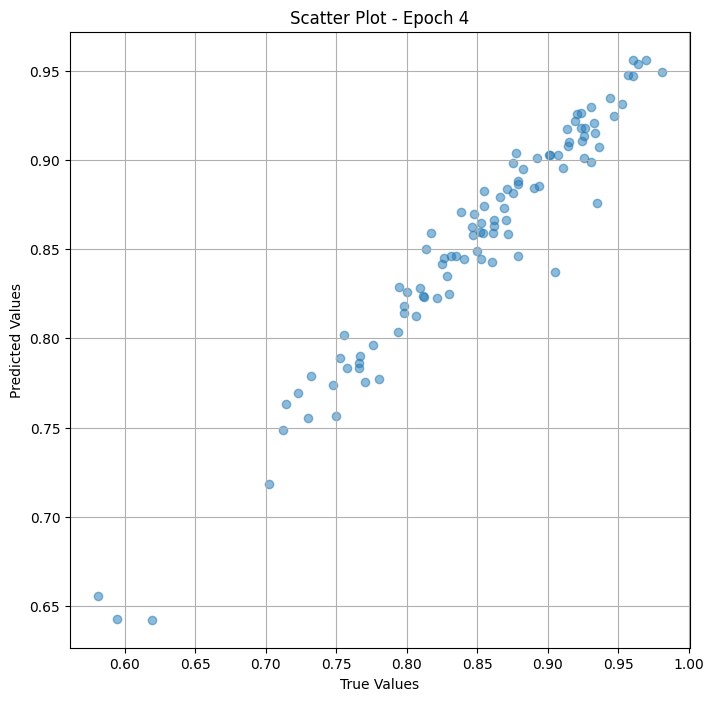

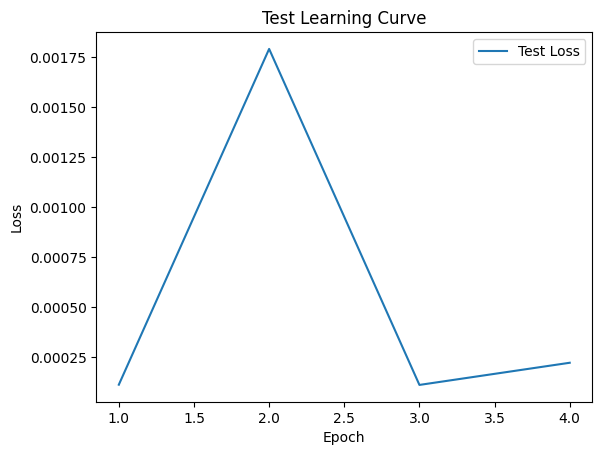


 Epoch: (5/50) Loss = 0.00023312398116104305

 Epoch: (5/50) Loss_rmse = 0.015268398448824883

 Epoch: (5/50) R^2 = 0.9021356701850891

 Epoch: (5/50) MAE = 0.010581716895103455
Spearman correlation coefficient: SignificanceResult(statistic=0.983131778522397, pvalue=3.708803042716353e-71)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606,

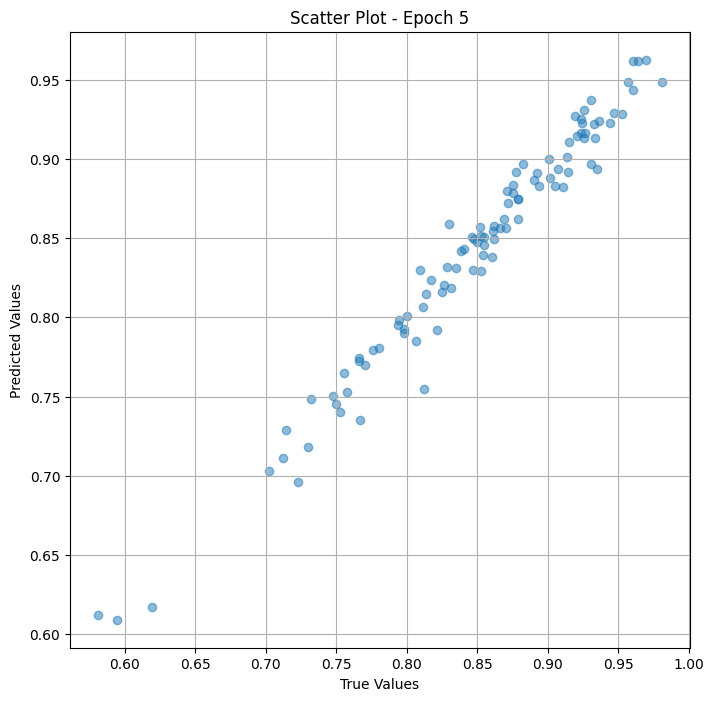

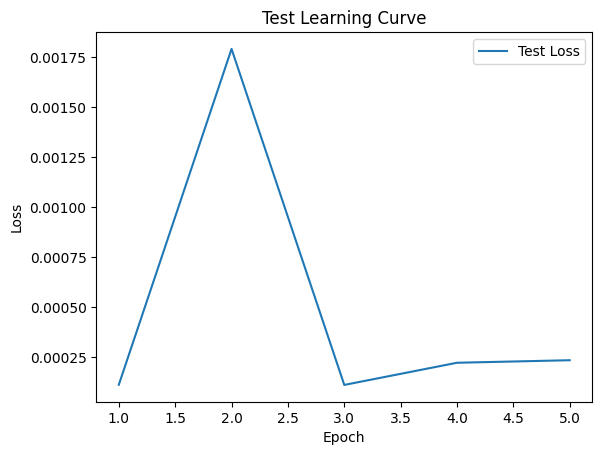


 Epoch: (6/50) Loss = 4.16960938309785e-05

 Epoch: (6/50) Loss_rmse = 0.006457251030951738

 Epoch: (6/50) R^2 = 0.9824962019920349

 Epoch: (6/50) MAE = 0.005712911486625671
Spearman correlation coefficient: SignificanceResult(statistic=0.9880626981704536, pvalue=3.6318720579391447e-78)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606,

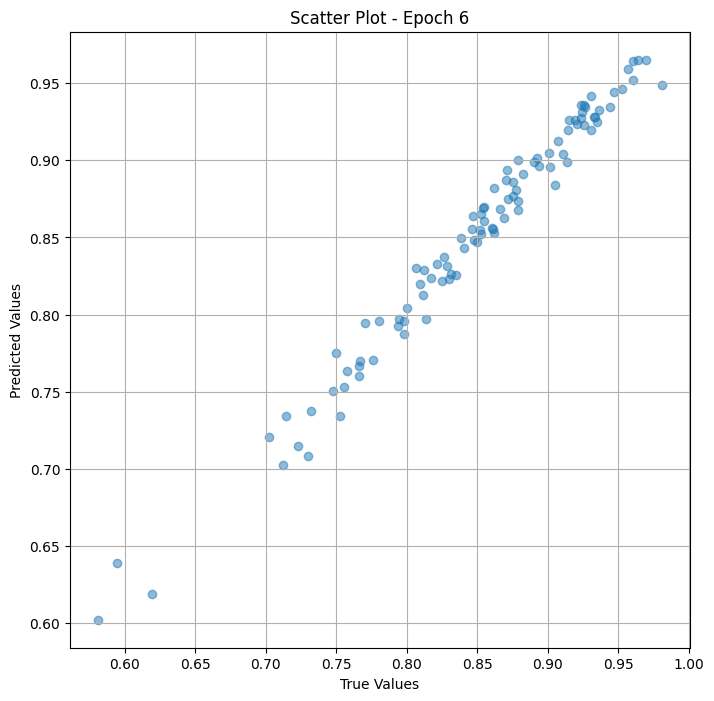

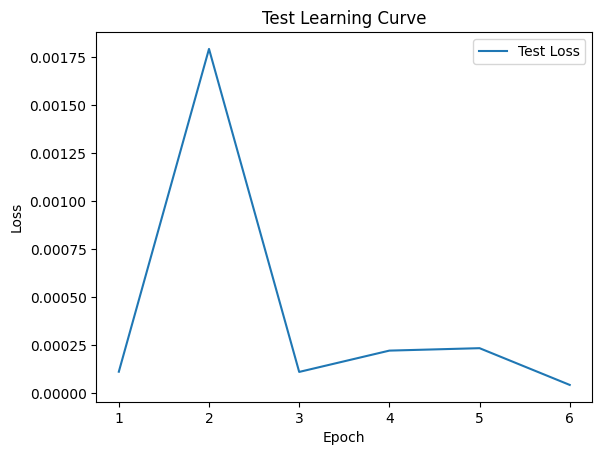


 Epoch: (7/50) Loss = 3.566525629139505e-05

 Epoch: (7/50) Loss_rmse = 0.005972039420157671

 Epoch: (7/50) R^2 = 0.9850279092788696

 Epoch: (7/50) MAE = 0.004369854927062988
Spearman correlation coefficient: SignificanceResult(statistic=0.9927697934053245, pvalue=2.3543707858556572e-88)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606

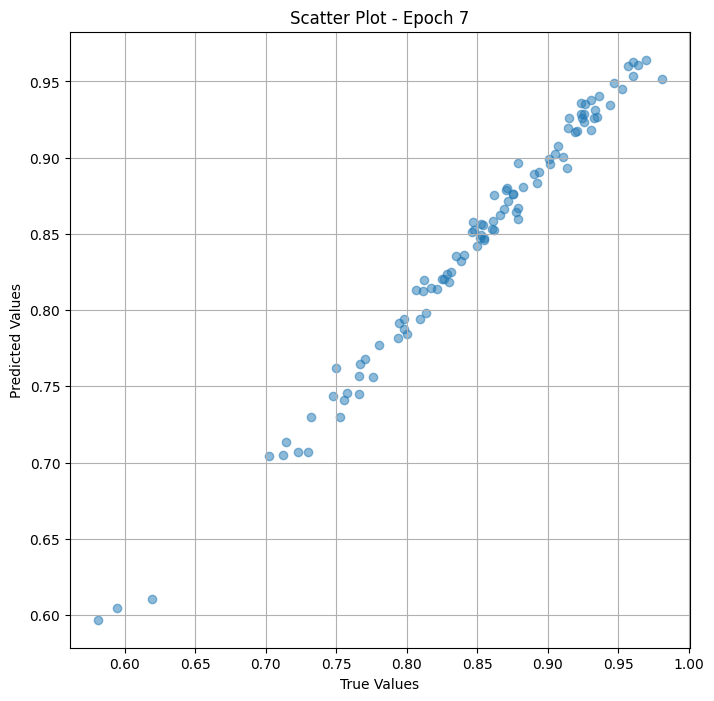

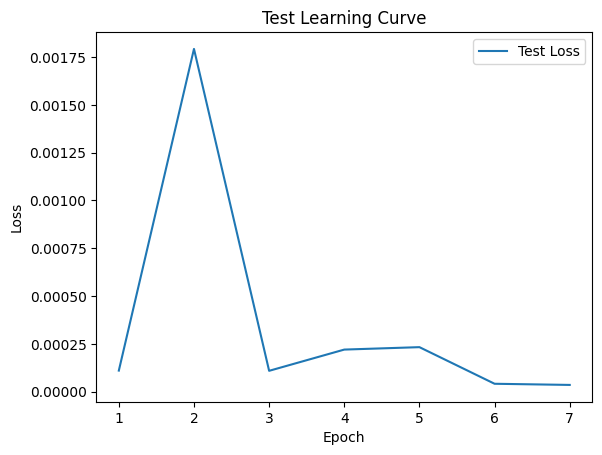


 Epoch: (8/50) Loss = 7.153225305955857e-05

 Epoch: (8/50) Loss_rmse = 0.008457674644887447

 Epoch: (8/50) R^2 = 0.9699711203575134

 Epoch: (8/50) MAE = 0.005811974406242371
Spearman correlation coefficient: SignificanceResult(statistic=0.9946146491746111, pvalue=2.382036328499293e-94)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84782606,

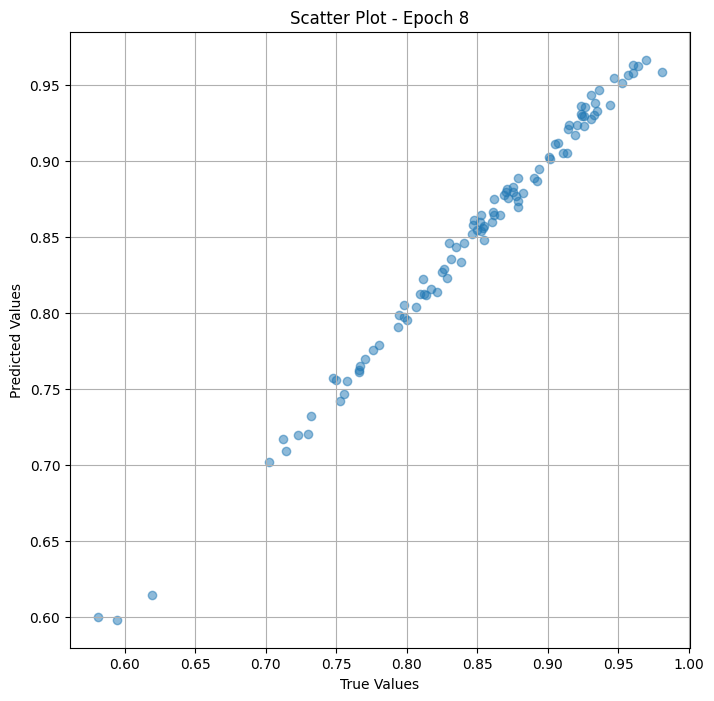

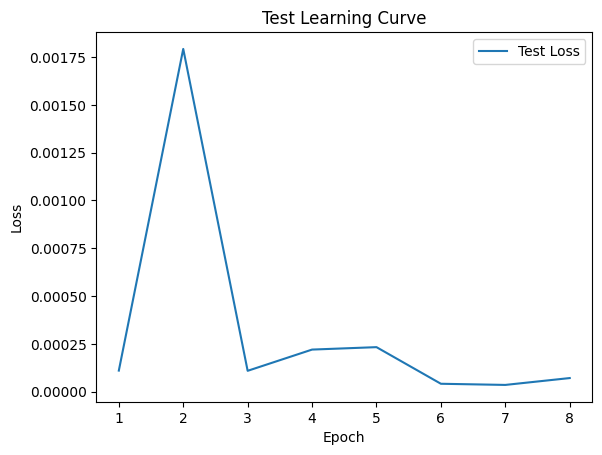


 Epoch: (9/50) Loss = 6.116891745477915e-05

 Epoch: (9/50) Loss_rmse = 0.007821056060492992

 Epoch: (9/50) R^2 = 0.9743216037750244

 Epoch: (9/50) MAE = 0.007183000445365906
Spearman correlation coefficient: SignificanceResult(statistic=0.9967172421469598, pvalue=1.9666356511320478e-104)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8478260

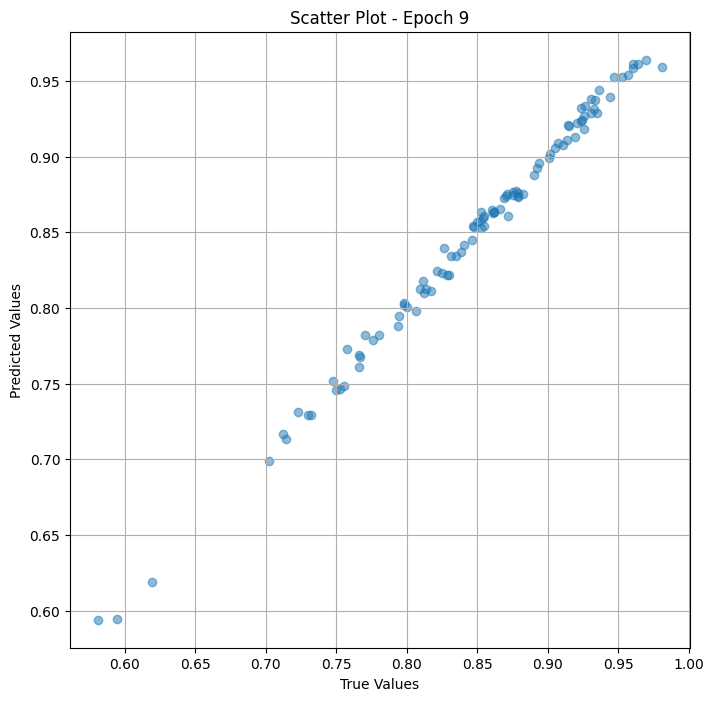

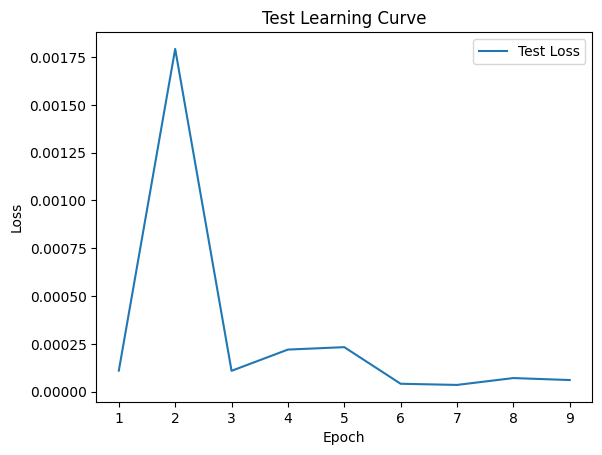

Epoch 0.01: reducing learning rate of group 0 to 1.0000e-05.

 Epoch: (10/50) Loss = 0.00014093519712332636

 Epoch: (10/50) Loss_rmse = 0.011871612630784512

 Epoch: (10/50) R^2 = 0.9408360719680786

 Epoch: (10/50) MAE = 0.009029224514961243
Spearman correlation coefficient: SignificanceResult(statistic=0.9968054154006389, pvalue=5.4807279658336015e-105)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0

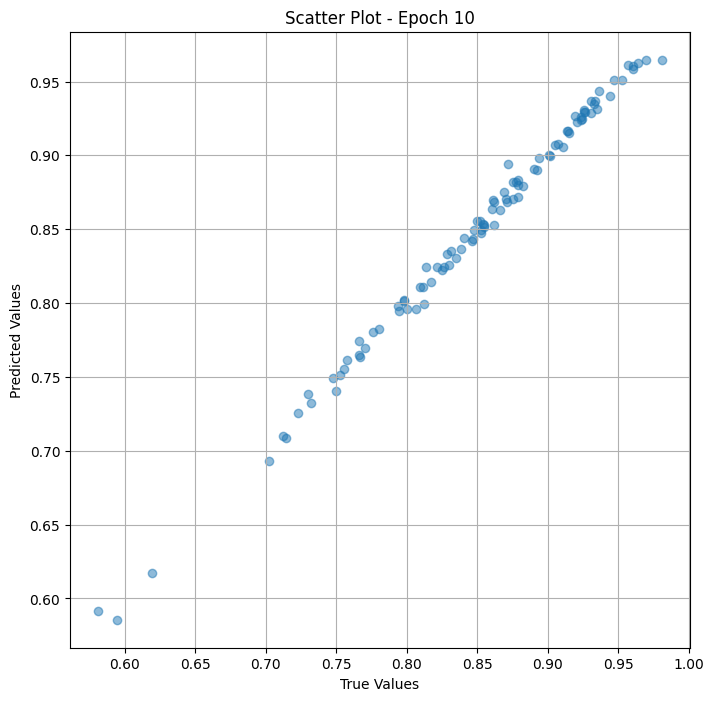

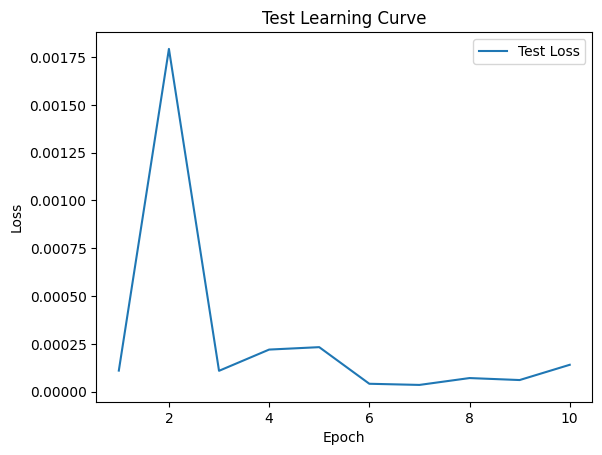


 Epoch: (11/50) Loss = 3.825638486887328e-06

 Epoch: (11/50) Loss_rmse = 0.001955923857167363

 Epoch: (11/50) R^2 = 0.9983940124511719

 Epoch: (11/50) MAE = 0.0017362982034683228
Spearman correlation coefficient: SignificanceResult(statistic=0.9986163583800489, pvalue=4.7555798220922957e-122)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

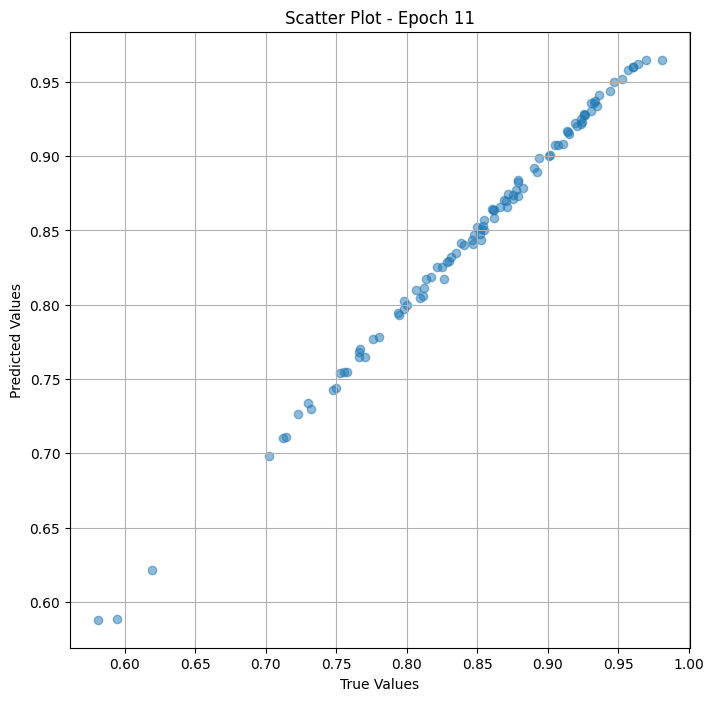

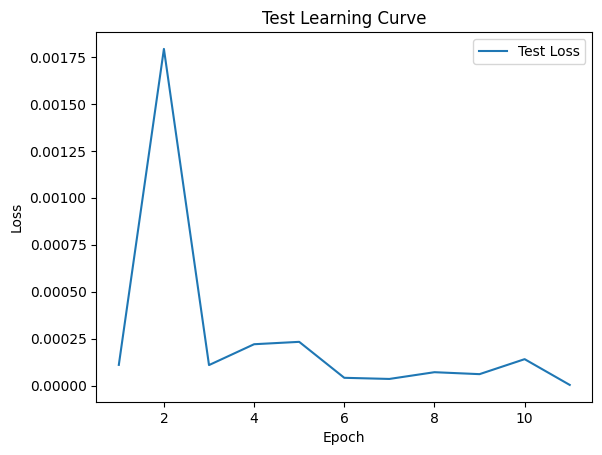


 Epoch: (12/50) Loss = 1.1677570910251234e-06

 Epoch: (12/50) Loss_rmse = 0.001080628135241568

 Epoch: (12/50) R^2 = 0.9995097517967224

 Epoch: (12/50) MAE = 0.0009520053863525391
Spearman correlation coefficient: SignificanceResult(statistic=0.998684183959802, pvalue=4.4867365117659346e-123)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

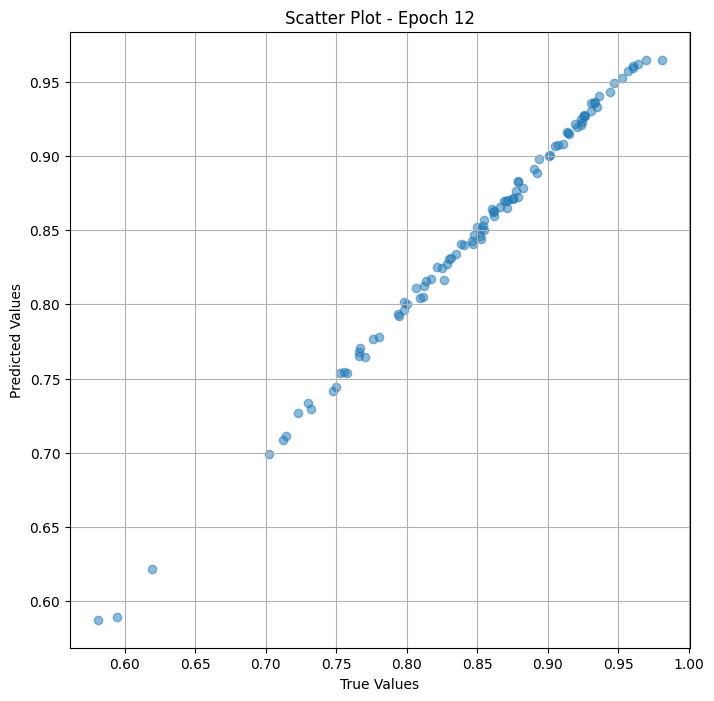

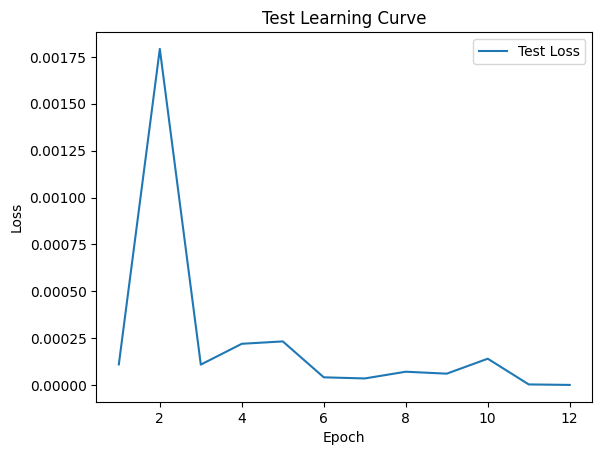


 Epoch: (13/50) Loss = 3.152289536956232e-06

 Epoch: (13/50) Loss_rmse = 0.001775468816049397

 Epoch: (13/50) R^2 = 0.9986766576766968

 Epoch: (13/50) MAE = 0.0014211088418960571
Spearman correlation coefficient: SignificanceResult(statistic=0.9989215734889383, pvalue=3.919553166619907e-127)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

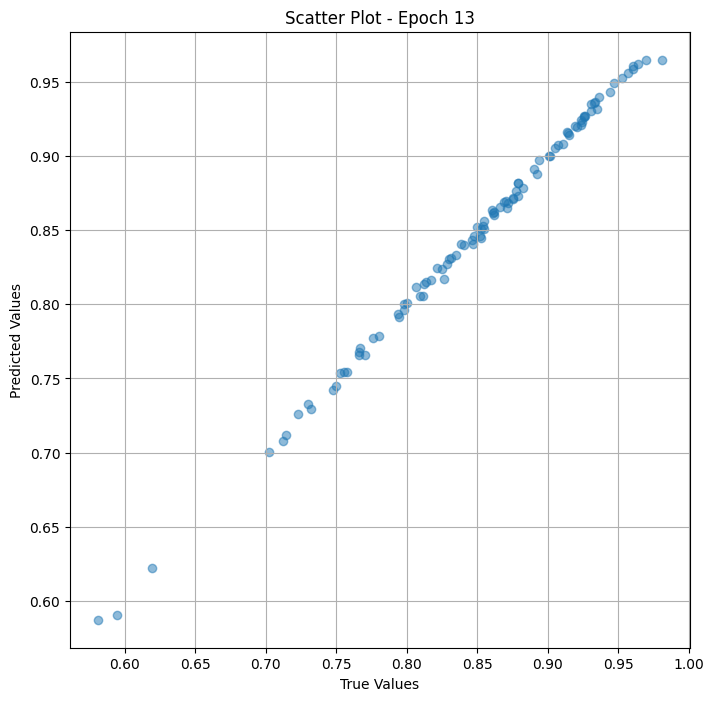

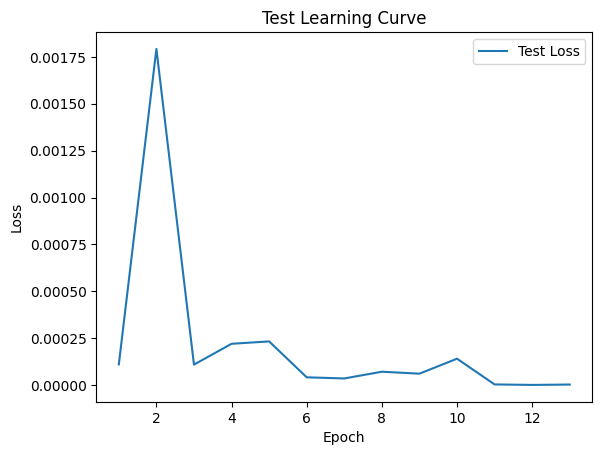


 Epoch: (14/50) Loss = 2.689518623810727e-06

 Epoch: (14/50) Loss_rmse = 0.0016399752348661423

 Epoch: (14/50) R^2 = 0.9988709688186646

 Epoch: (14/50) MAE = 0.0014043301343917847
Spearman correlation coefficient: SignificanceResult(statistic=0.9990165293005927, pvalue=5.161746061657885e-129)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

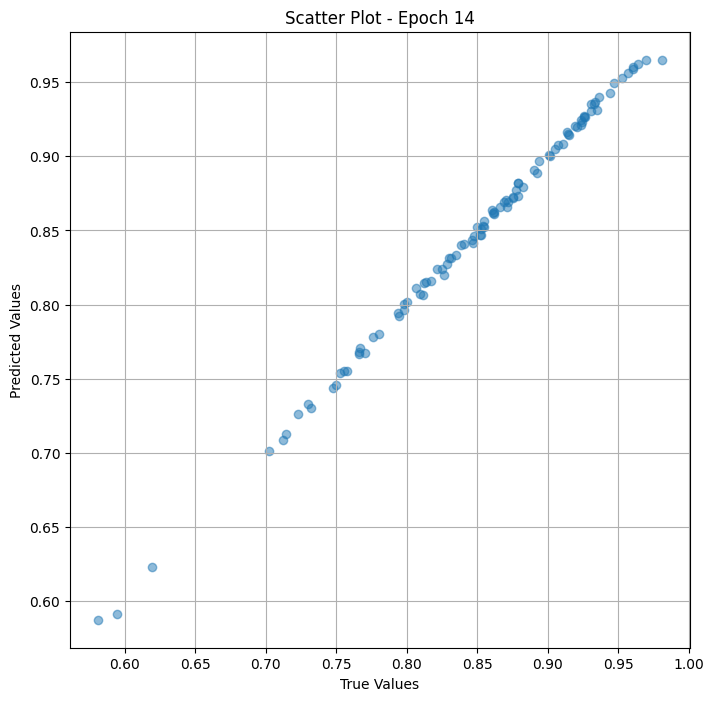

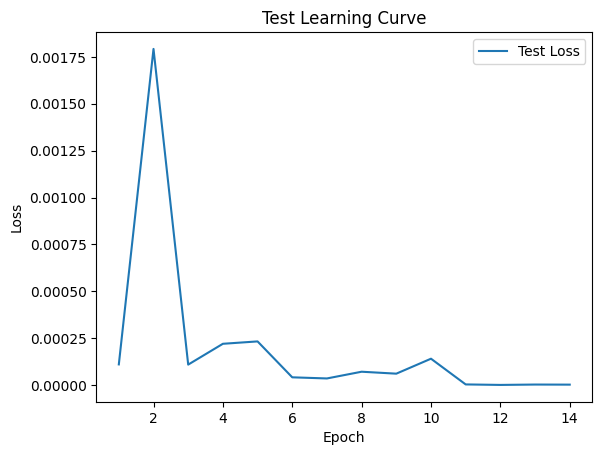


 Epoch: (15/50) Loss = 1.0701946848712396e-06

 Epoch: (15/50) Loss_rmse = 0.0010345021728426218

 Epoch: (15/50) R^2 = 0.9995507597923279

 Epoch: (15/50) MAE = 0.0009660422801971436
Spearman correlation coefficient: SignificanceResult(statistic=0.9991793106920003, pvalue=1.0495542318639044e-132)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.

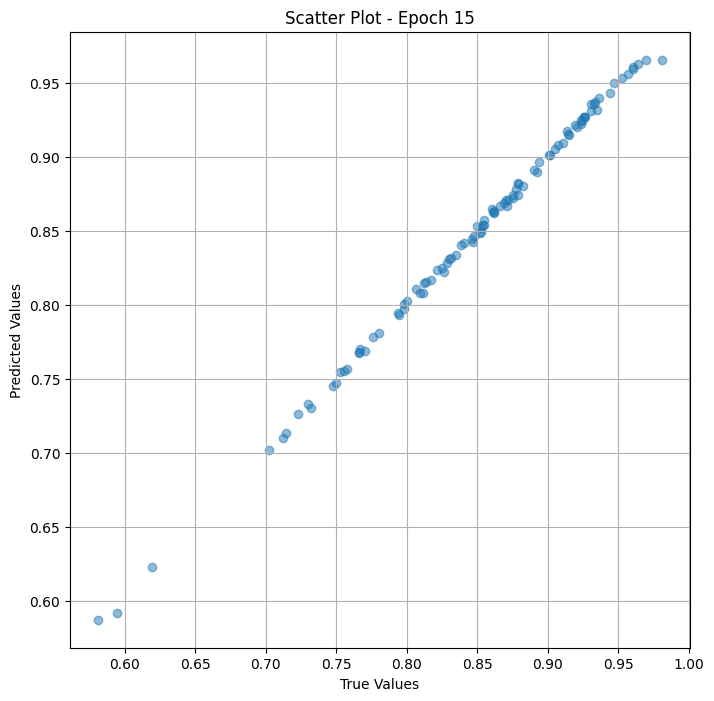

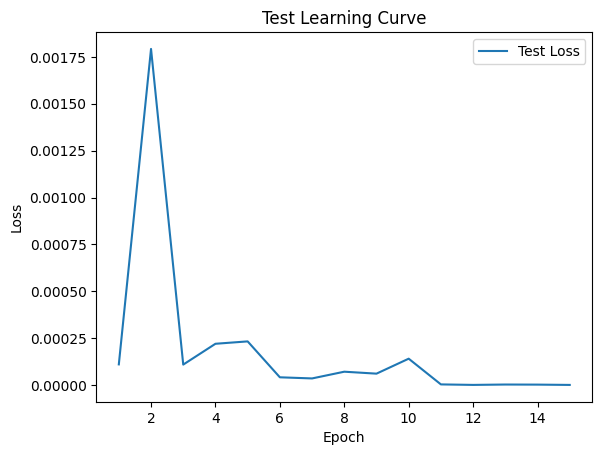


 Epoch: (16/50) Loss = 3.560085701792559e-07

 Epoch: (16/50) Loss_rmse = 0.0005966645549051464

 Epoch: (16/50) R^2 = 0.9998505711555481

 Epoch: (16/50) MAE = 0.0004981756210327148
Spearman correlation coefficient: SignificanceResult(statistic=0.9991657455760496, pvalue=2.2672534523923553e-132)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

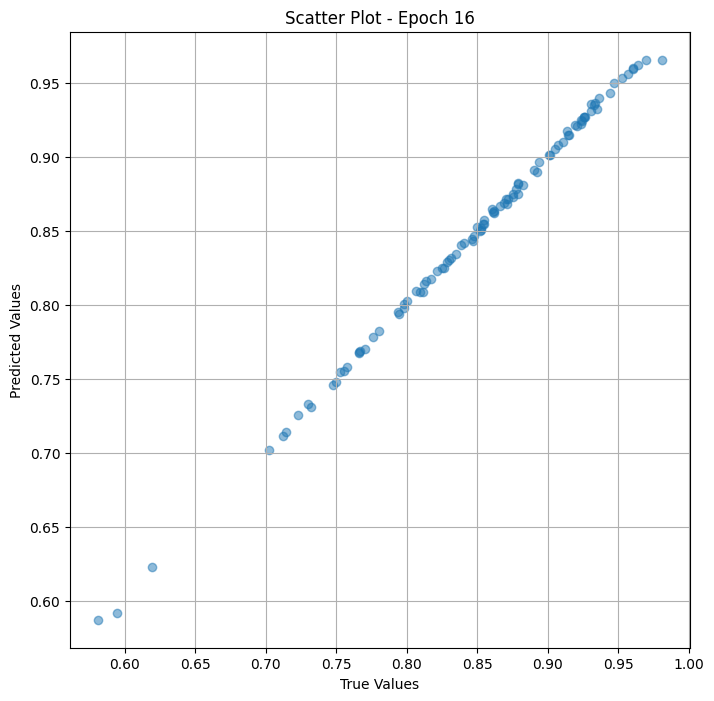

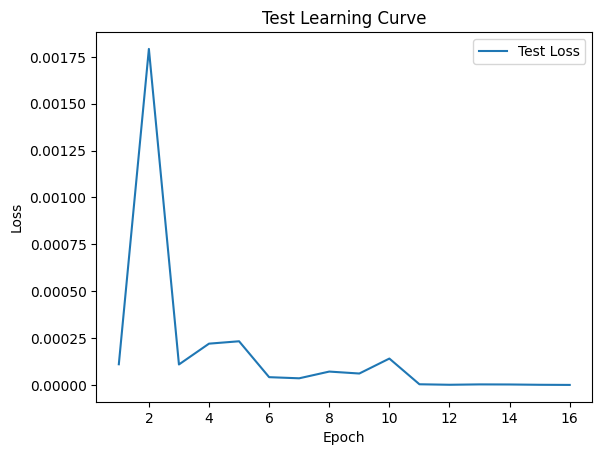


 Epoch: (17/50) Loss = 2.214360392827075e-07

 Epoch: (17/50) Loss_rmse = 0.0004705699102487415

 Epoch: (17/50) R^2 = 0.9999070167541504

 Epoch: (17/50) MAE = 0.00042594969272613525
Spearman correlation coefficient: SignificanceResult(statistic=0.9993624397573339, pvalue=7.394211558969839e-138)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

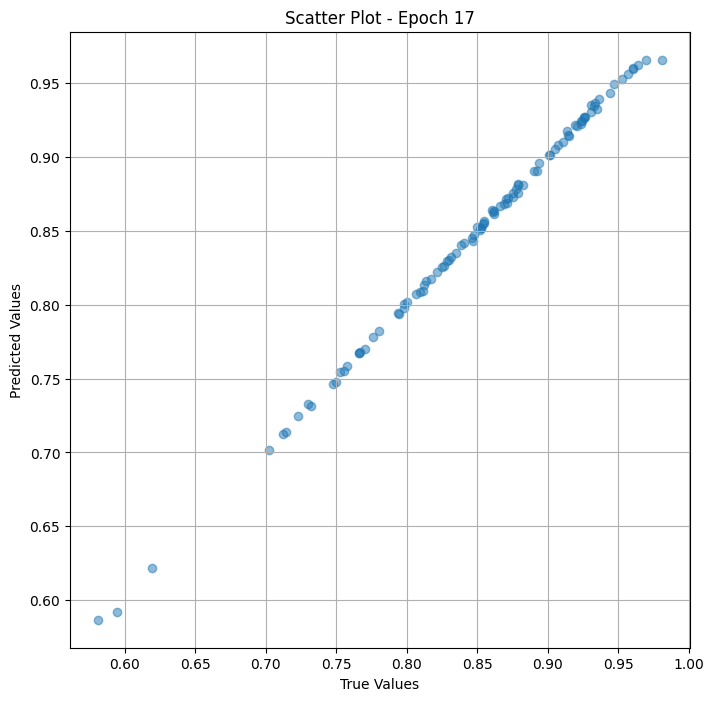

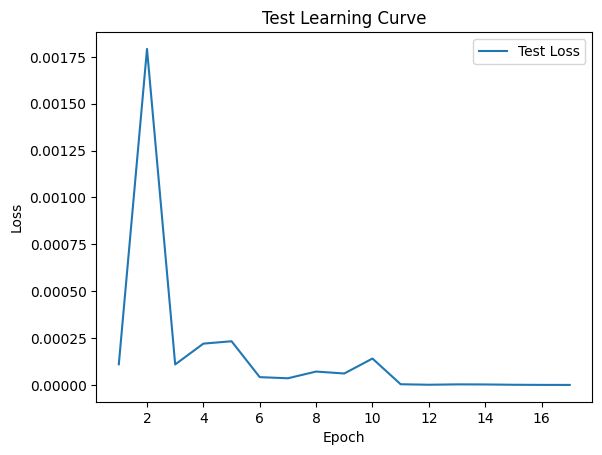


 Epoch: (18/50) Loss = 1.4045387786154606e-07

 Epoch: (18/50) Loss_rmse = 0.0003747717710211873

 Epoch: (18/50) R^2 = 0.9999410510063171

 Epoch: (18/50) MAE = 0.00030991435050964355
Spearman correlation coefficient: SignificanceResult(statistic=0.9994641781269636, pvalue=2.0958014444834862e-141)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0

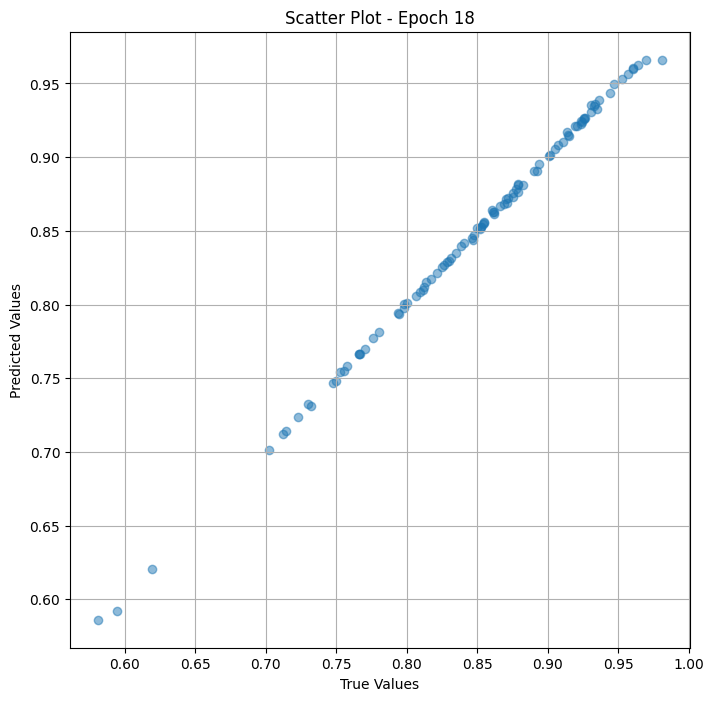

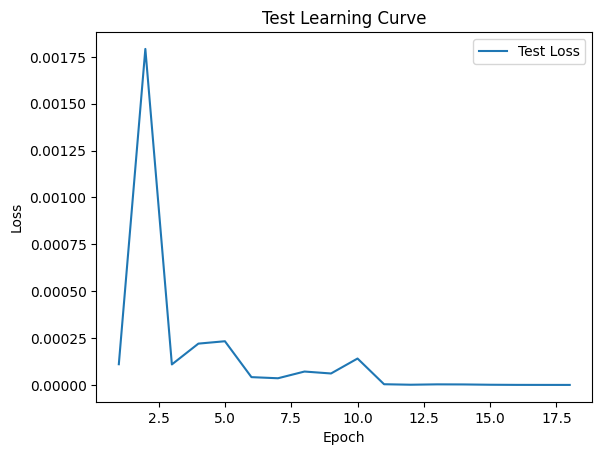


 Epoch: (19/50) Loss = 1.3312799751474813e-07

 Epoch: (19/50) Loss_rmse = 0.0003648670972324908

 Epoch: (19/50) R^2 = 0.9999440908432007

 Epoch: (19/50) MAE = 0.0003462880849838257
Spearman correlation coefficient: SignificanceResult(statistic=0.9994777432429144, pvalue=6.281645629790134e-142)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

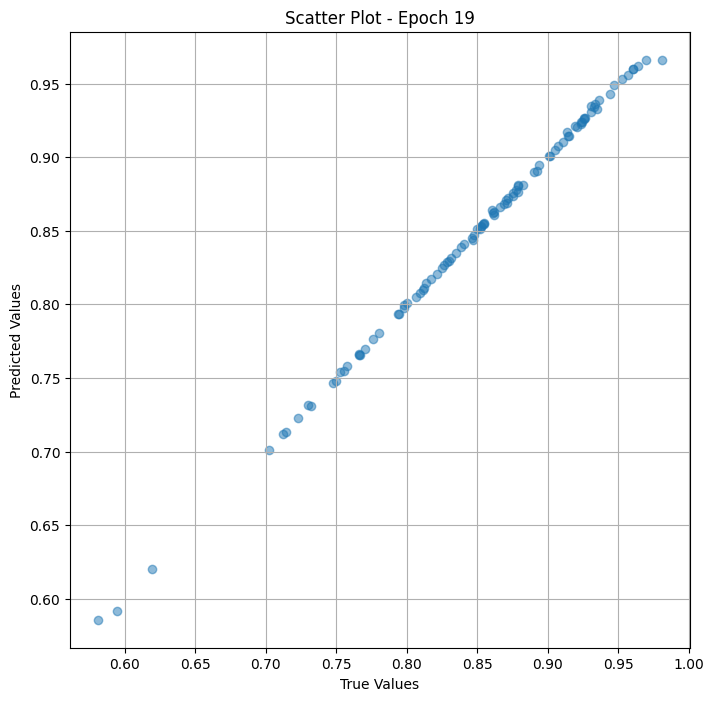

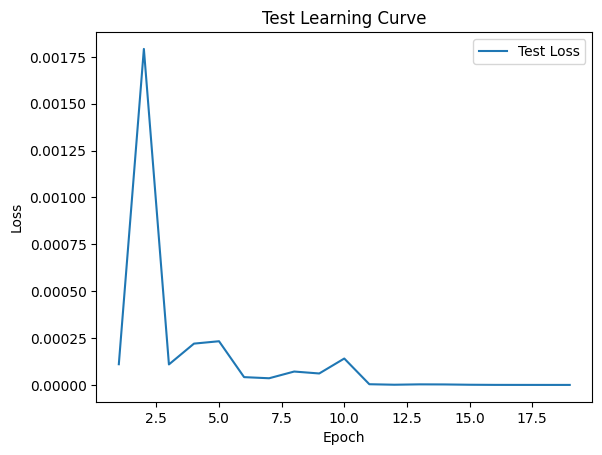


 Epoch: (20/50) Loss = 1.4564693628926761e-07

 Epoch: (20/50) Loss_rmse = 0.00038163719000294805

 Epoch: (20/50) R^2 = 0.9999388456344604

 Epoch: (20/50) MAE = 0.0003605186939239502
Spearman correlation coefficient: SignificanceResult(statistic=0.9995116560327908, pvalue=2.678970247250995e-143)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.

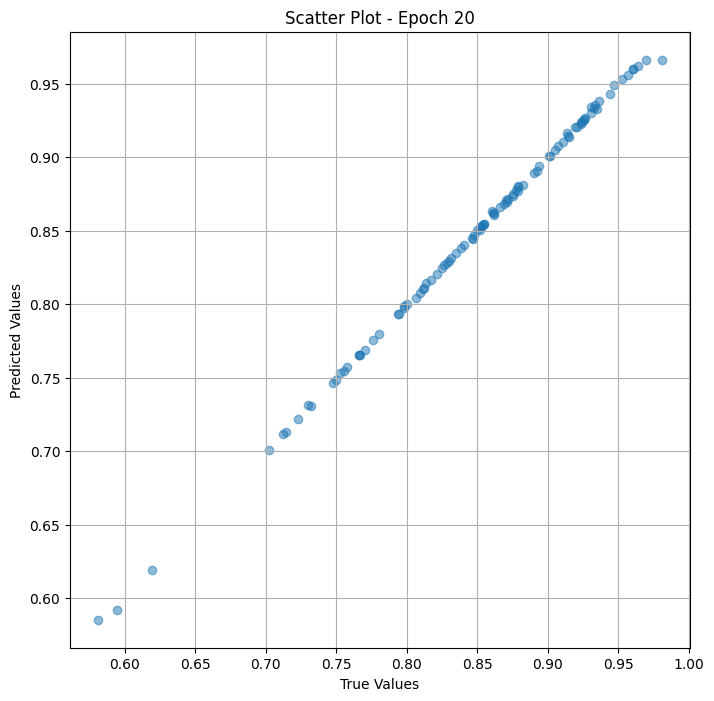

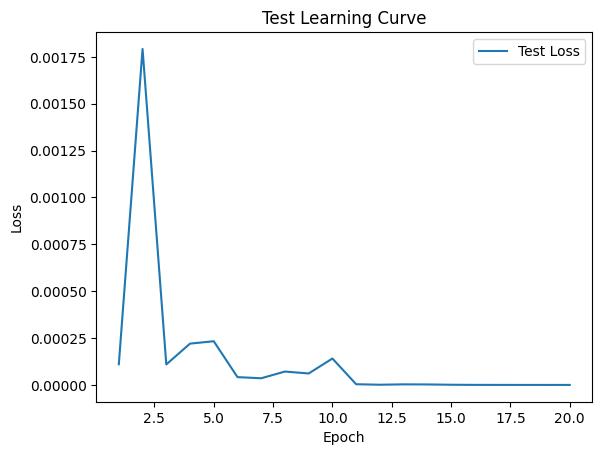


 Epoch: (21/50) Loss = 8.158824726933744e-08

 Epoch: (21/50) Loss_rmse = 0.00028563657542690635

 Epoch: (21/50) R^2 = 0.9999657273292542

 Epoch: (21/50) MAE = 0.00027370452880859375
Spearman correlation coefficient: SignificanceResult(statistic=0.9995862641705194, pvalue=1.1080800072508644e-146)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0

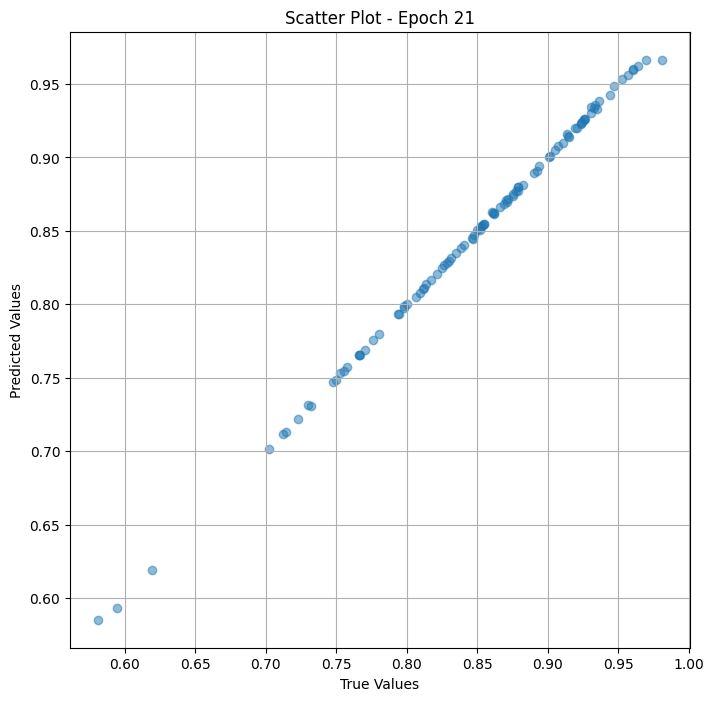

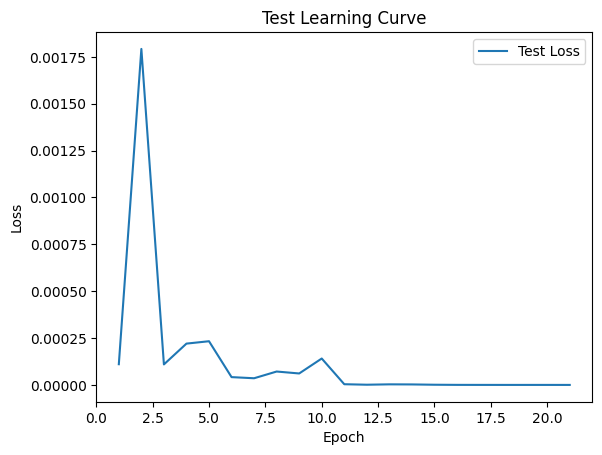


 Epoch: (22/50) Loss = 1.7535958463099632e-08

 Epoch: (22/50) Loss_rmse = 0.00013242340355645865

 Epoch: (22/50) R^2 = 0.9999926090240479

 Epoch: (22/50) MAE = 0.00011247396469116211
Spearman correlation coefficient: SignificanceResult(statistic=0.9995930467284947, pvalue=5.096169008890948e-147)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0

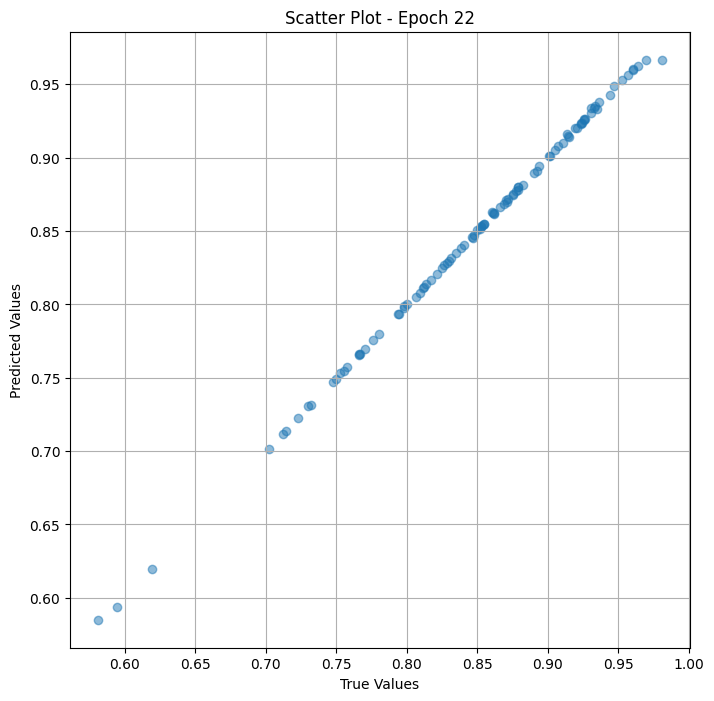

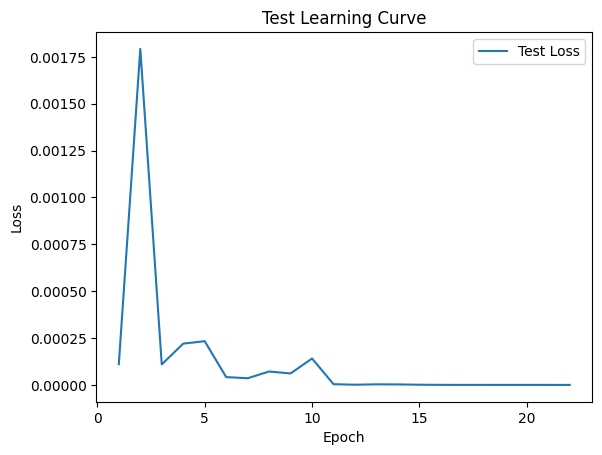


 Epoch: (23/50) Loss = 8.536125584157617e-09

 Epoch: (23/50) Loss_rmse = 9.239115752279758e-05

 Epoch: (23/50) R^2 = 0.9999964237213135

 Epoch: (23/50) MAE = 8.009374141693115e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9996473071922973, pvalue=6.120986314577907e-150)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

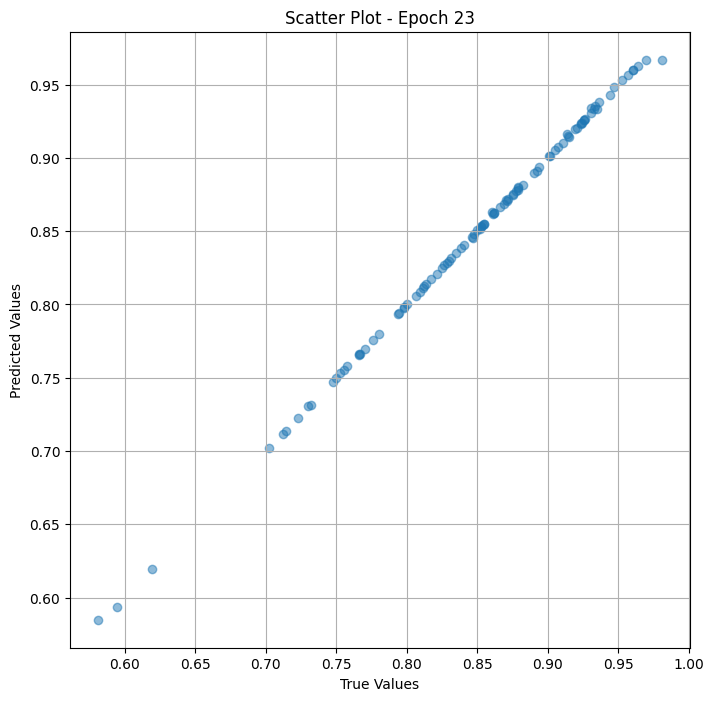

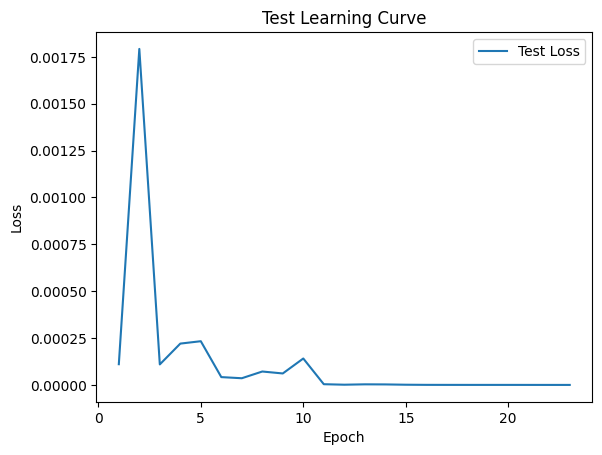


 Epoch: (24/50) Loss = 1.0649718440447487e-08

 Epoch: (24/50) Loss_rmse = 0.00010319747525500134

 Epoch: (24/50) R^2 = 0.9999955296516418

 Epoch: (24/50) MAE = 8.596479892730713e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999660872308248, pvalue=9.691403600455382e-151)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

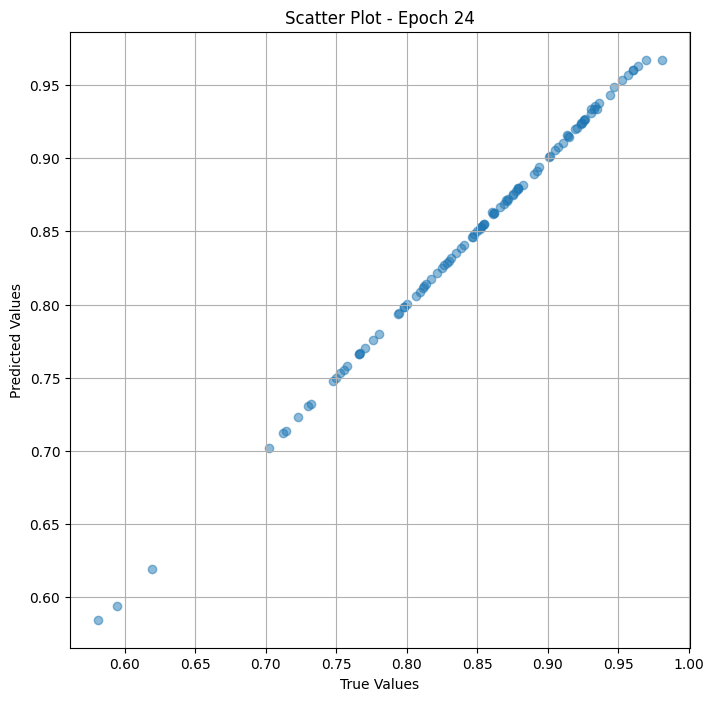

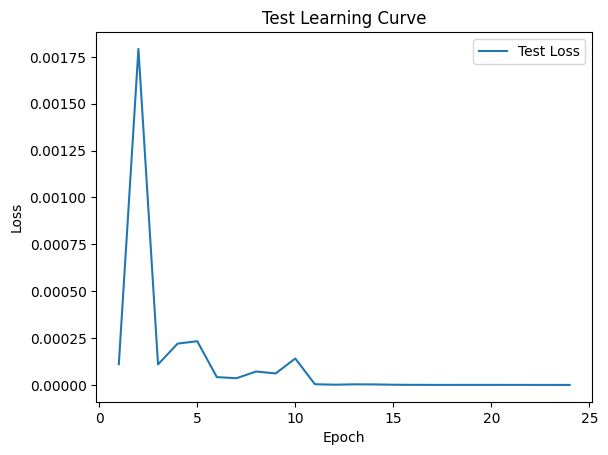


 Epoch: (25/50) Loss = 4.02640143448707e-09

 Epoch: (25/50) Loss_rmse = 6.345393194351345e-05

 Epoch: (25/50) R^2 = 0.9999983310699463

 Epoch: (25/50) MAE = 5.1394104957580566e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997219153300257, pvalue=8.634399471596904e-155)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

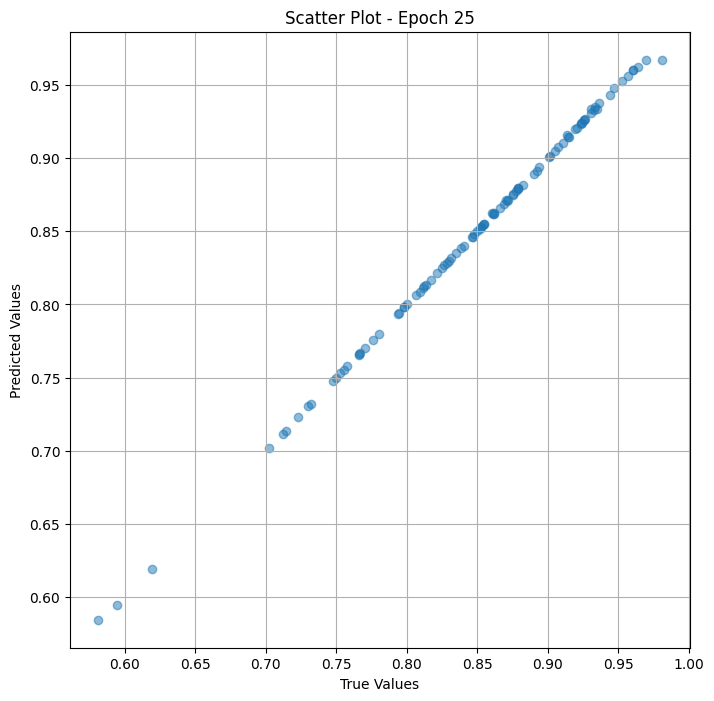

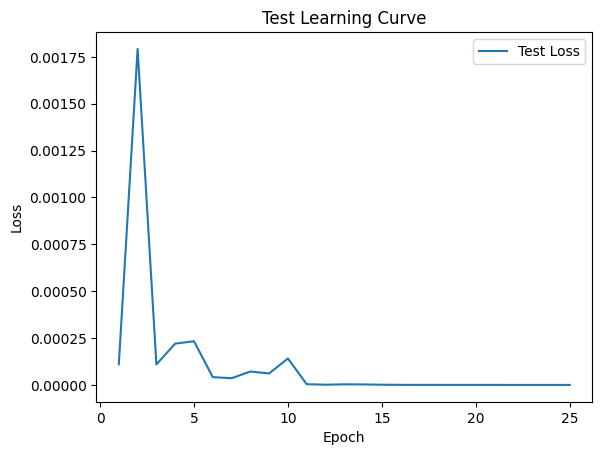


 Epoch: (26/50) Loss = 8.907701243288102e-10

 Epoch: (26/50) Loss_rmse = 2.9845772587577812e-05

 Epoch: (26/50) R^2 = 0.9999996423721313

 Epoch: (26/50) MAE = 2.682209014892578e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997354804459765, pvalue=8.233022757906401e-156)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

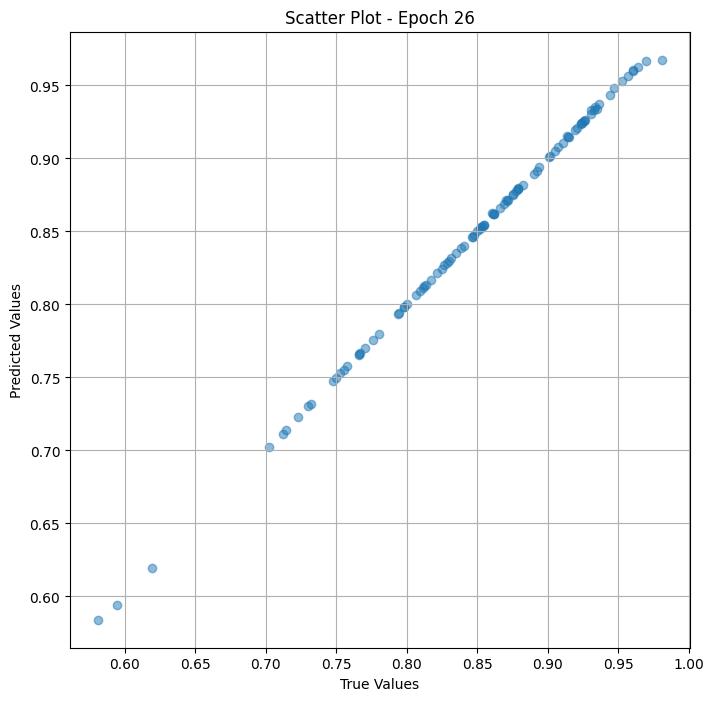

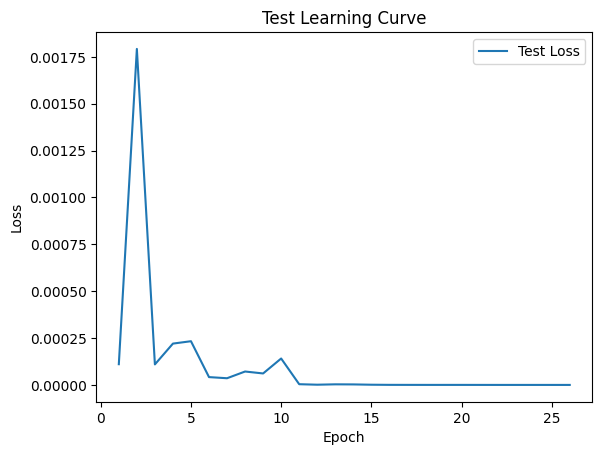


 Epoch: (27/50) Loss = 1.5155920962683922e-09

 Epoch: (27/50) Loss_rmse = 3.893060784321278e-05

 Epoch: (27/50) R^2 = 0.9999993443489075

 Epoch: (27/50) MAE = 2.588331699371338e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997354804459765, pvalue=8.233022757906401e-156)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

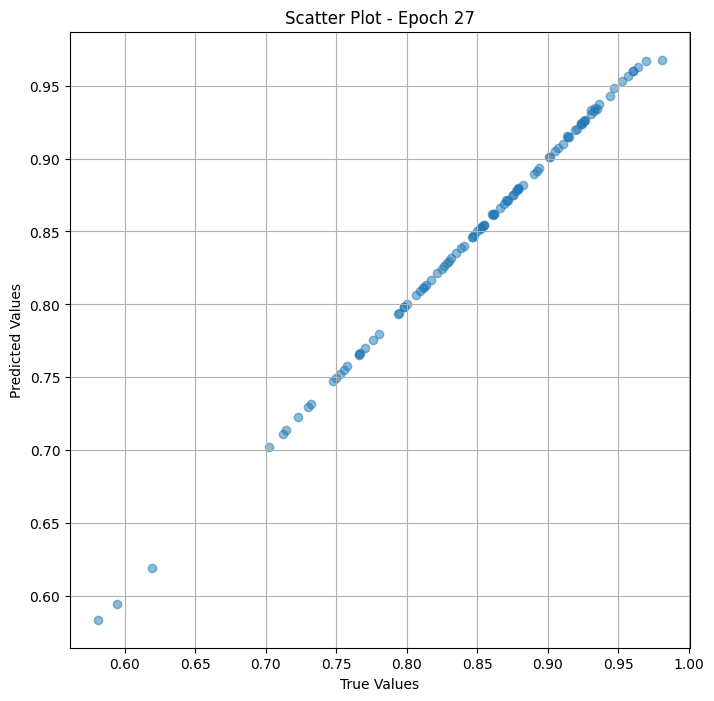

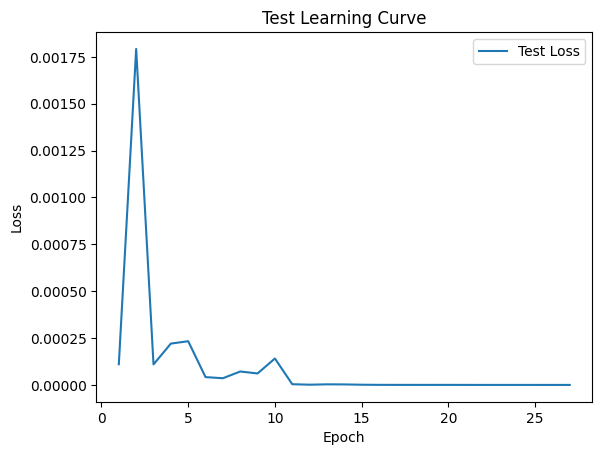


 Epoch: (28/50) Loss = 4.954959997860442e-09

 Epoch: (28/50) Loss_rmse = 7.03914774931036e-05

 Epoch: (28/50) R^2 = 0.9999979138374329

 Epoch: (28/50) MAE = 6.498396396636963e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9997354804459765, pvalue=8.233022757906401e-156)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

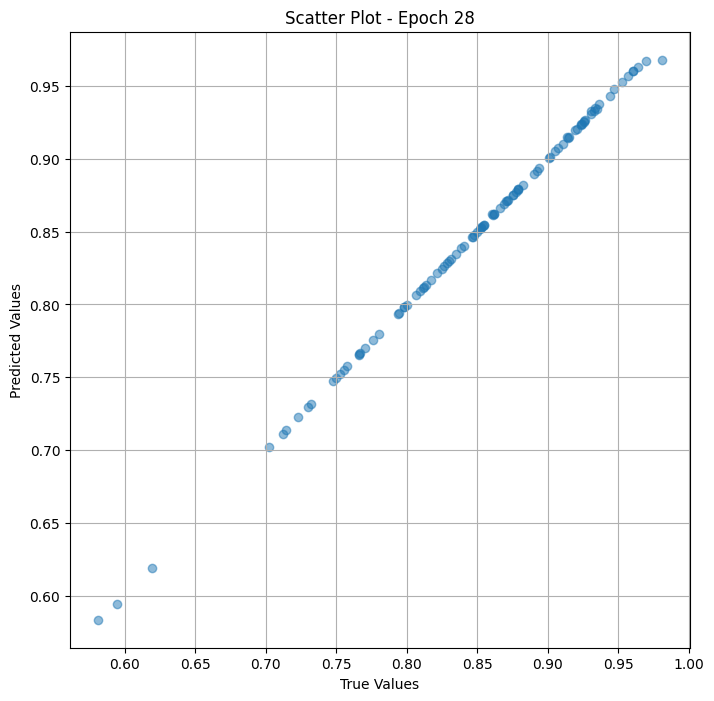

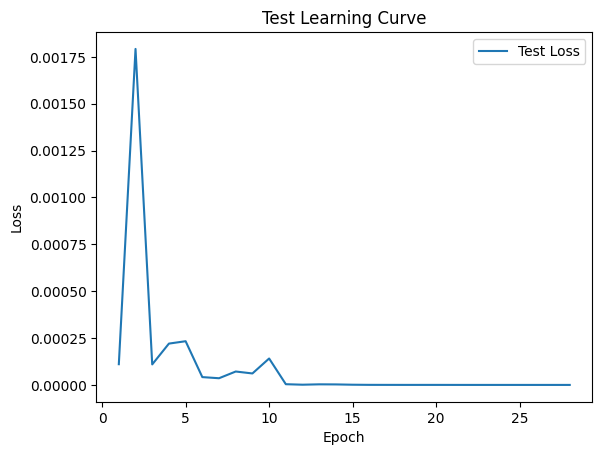

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-06.

 Epoch: (29/50) Loss = 8.497249126548923e-09

 Epoch: (29/50) Loss_rmse = 9.218052582582459e-05

 Epoch: (29/50) R^2 = 0.9999964237213135

 Epoch: (29/50) MAE = 8.946657180786133e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.999789740909779, pvalue=1.6984354183385646e-160)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0

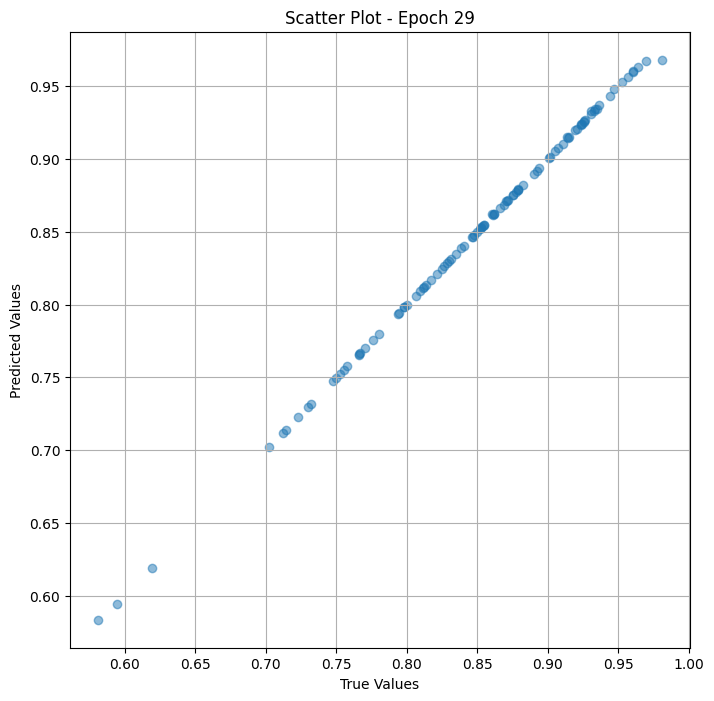

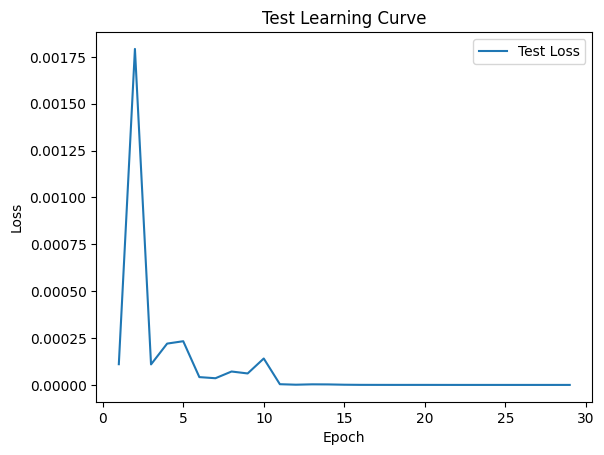


 Epoch: (30/50) Loss = 7.667268597799648e-09

 Epoch: (30/50) Loss_rmse = 8.756294118938968e-05

 Epoch: (30/50) R^2 = 0.9999967813491821

 Epoch: (30/50) MAE = 8.569657802581787e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

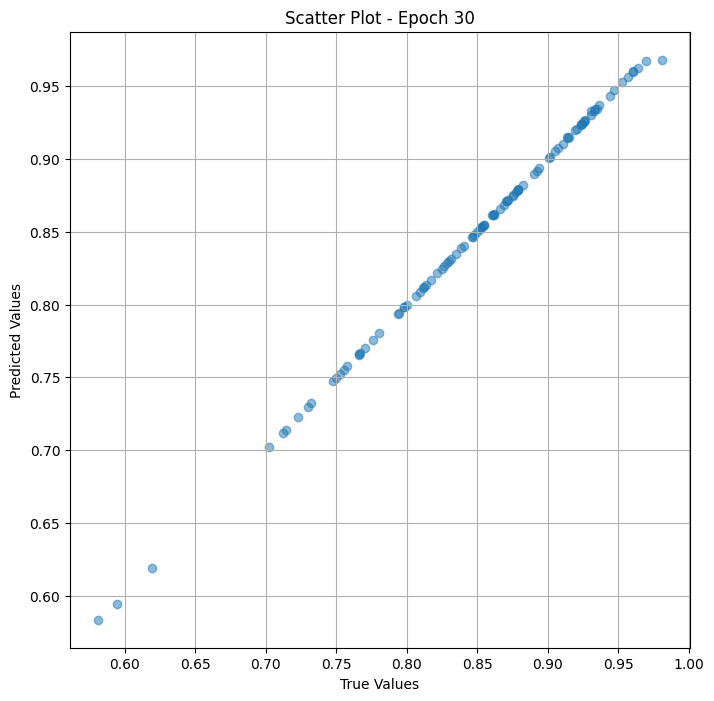

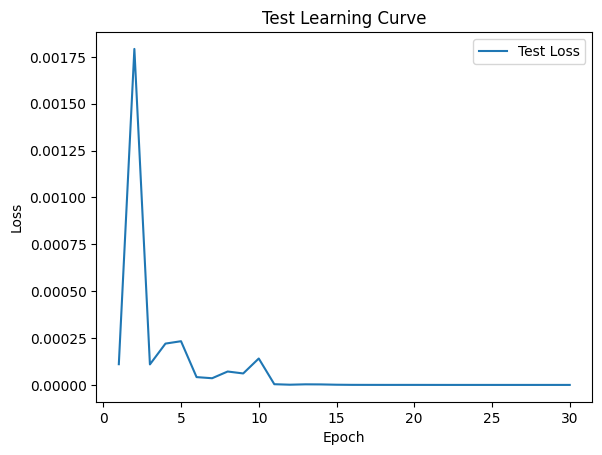


 Epoch: (31/50) Loss = 6.97229918245057e-09

 Epoch: (31/50) Loss_rmse = 8.350029384018853e-05

 Epoch: (31/50) R^2 = 0.999997079372406

 Epoch: (31/50) MAE = 8.203089237213135e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.847

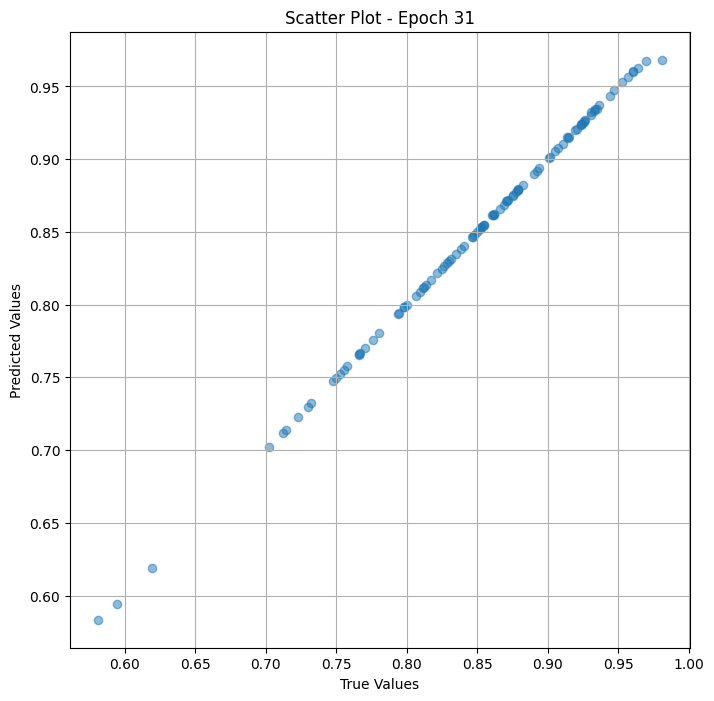

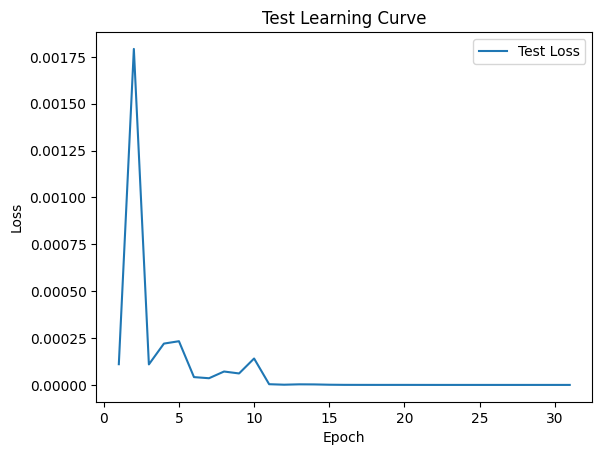

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-07.

 Epoch: (32/50) Loss = 6.050774992161223e-09

 Epoch: (32/50) Loss_rmse = 7.778672443237156e-05

 Epoch: (32/50) R^2 = 0.9999974370002747

 Epoch: (32/50) MAE = 7.678568363189697e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 

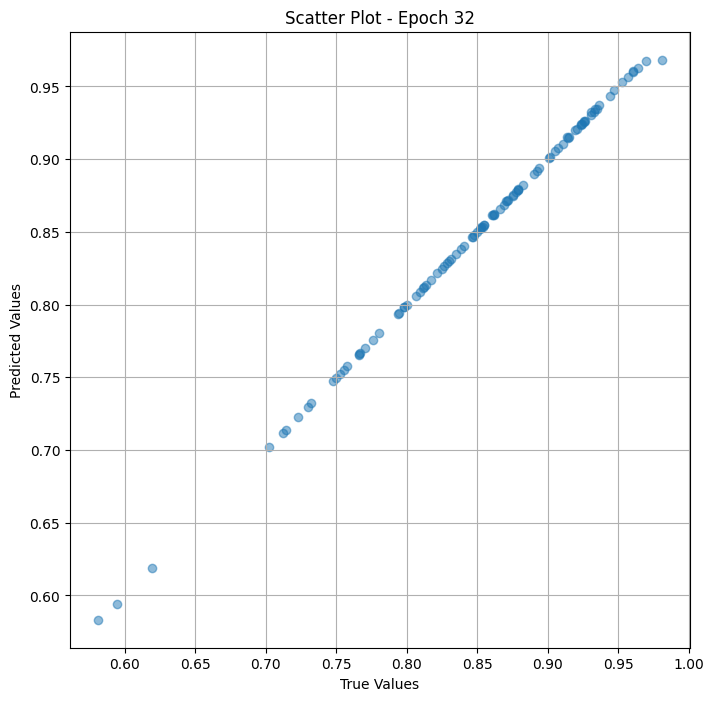

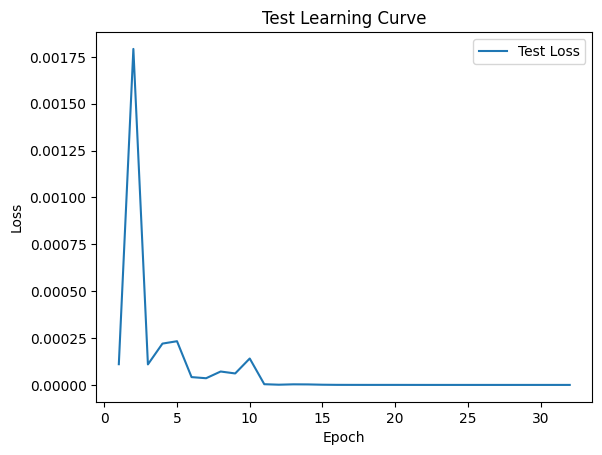


 Epoch: (33/50) Loss = 5.739055453091169e-09

 Epoch: (33/50) Loss_rmse = 7.575655035907403e-05

 Epoch: (33/50) R^2 = 0.999997615814209

 Epoch: (33/50) MAE = 7.489323616027832e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

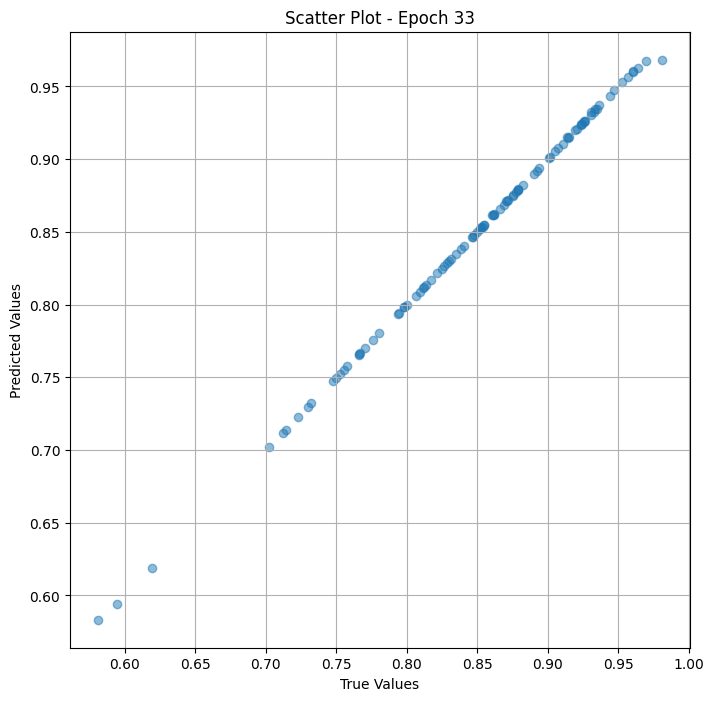

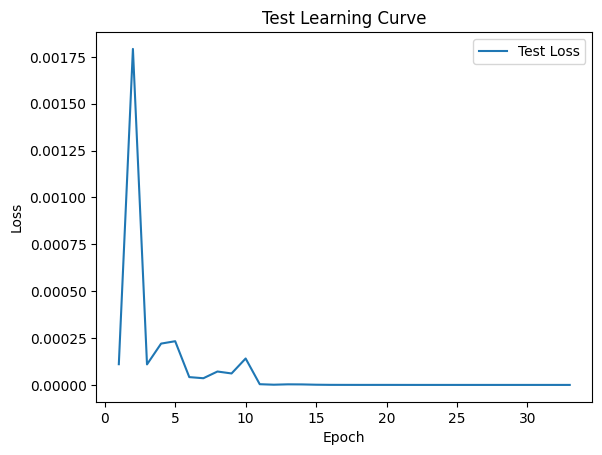


 Epoch: (34/50) Loss = 5.678725933933038e-09

 Epoch: (34/50) Loss_rmse = 7.535731856478378e-05

 Epoch: (34/50) R^2 = 0.999997615814209

 Epoch: (34/50) MAE = 7.452070713043213e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

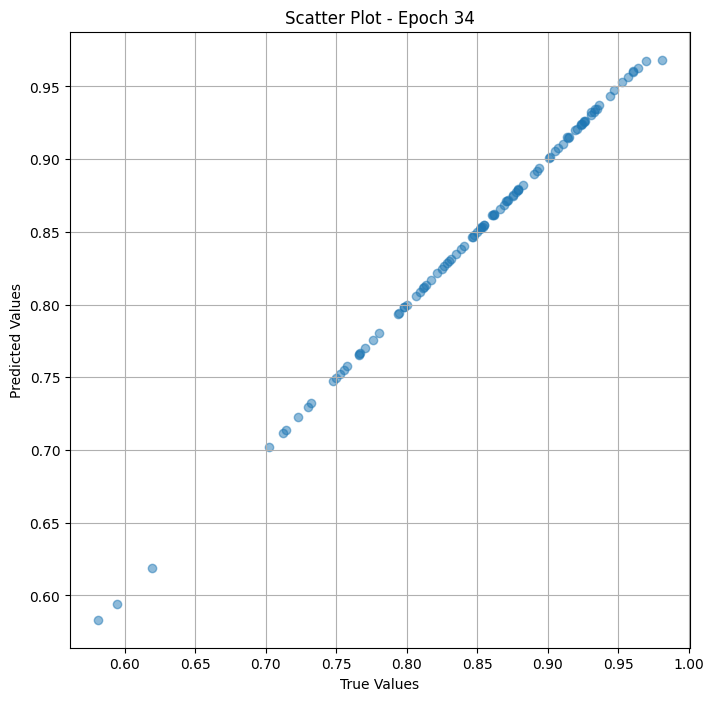

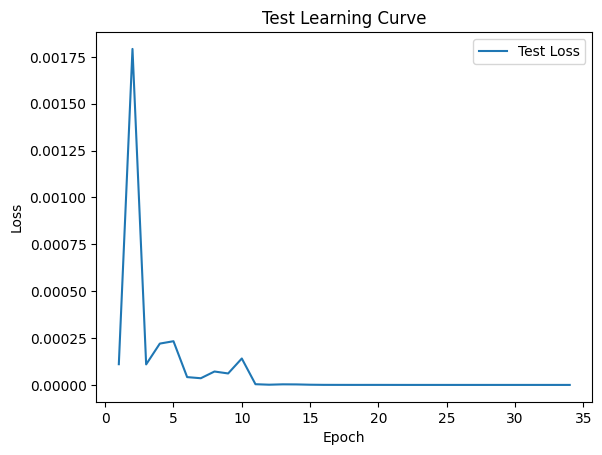

Epoch 0.00: reducing learning rate of group 0 to 1.0000e-08.

 Epoch: (35/50) Loss = 5.6293938399676335e-09

 Epoch: (35/50) Loss_rmse = 7.502928929170594e-05

 Epoch: (35/50) R^2 = 0.999997615814209

 Epoch: (35/50) MAE = 7.420778274536133e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 

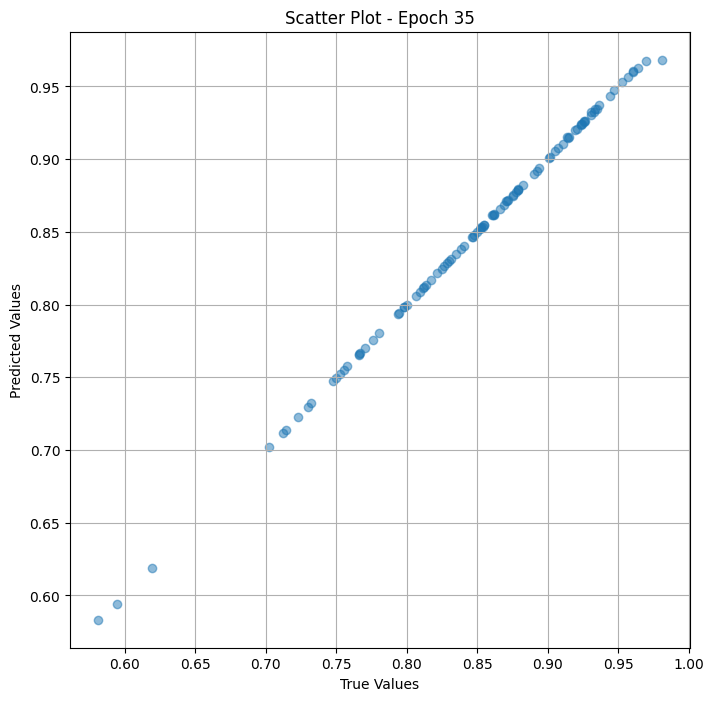

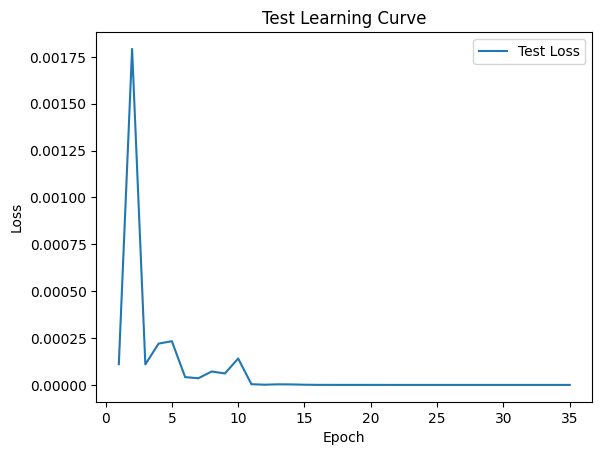


 Epoch: (36/50) Loss = 5.610830910995901e-09

 Epoch: (36/50) Loss_rmse = 7.490548159694299e-05

 Epoch: (36/50) R^2 = 0.999997615814209

 Epoch: (36/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

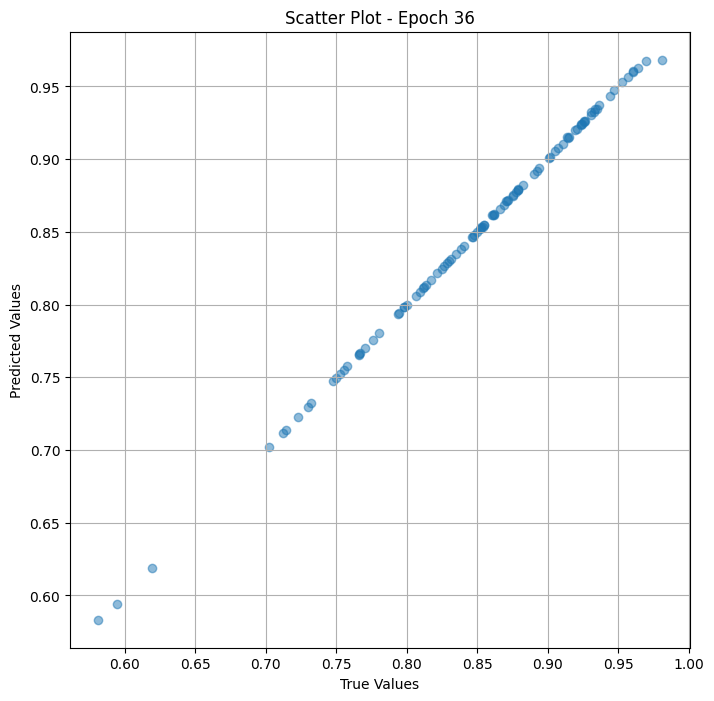

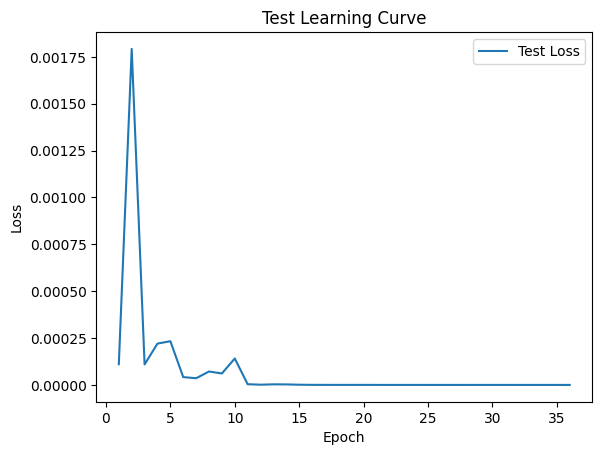


 Epoch: (37/50) Loss = 5.610830910995901e-09

 Epoch: (37/50) Loss_rmse = 7.490548159694299e-05

 Epoch: (37/50) R^2 = 0.999997615814209

 Epoch: (37/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

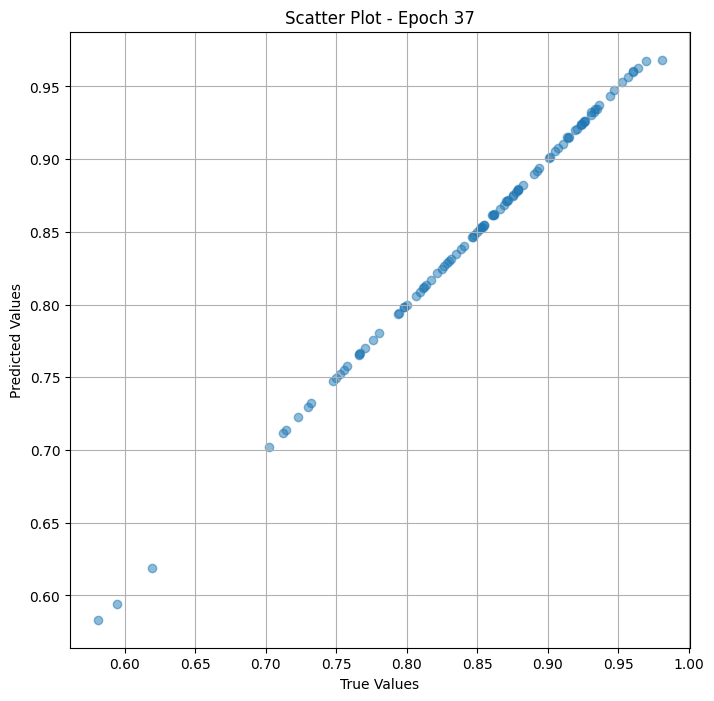

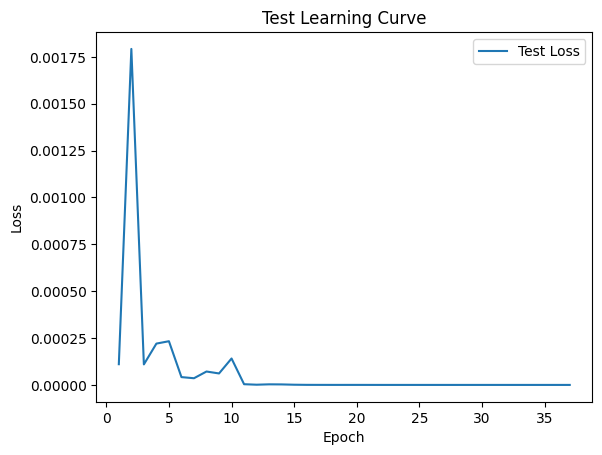


 Epoch: (38/50) Loss = 5.605466313340912e-09

 Epoch: (38/50) Loss_rmse = 7.486966205760837e-05

 Epoch: (38/50) R^2 = 0.9999976754188538

 Epoch: (38/50) MAE = 7.405877113342285e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

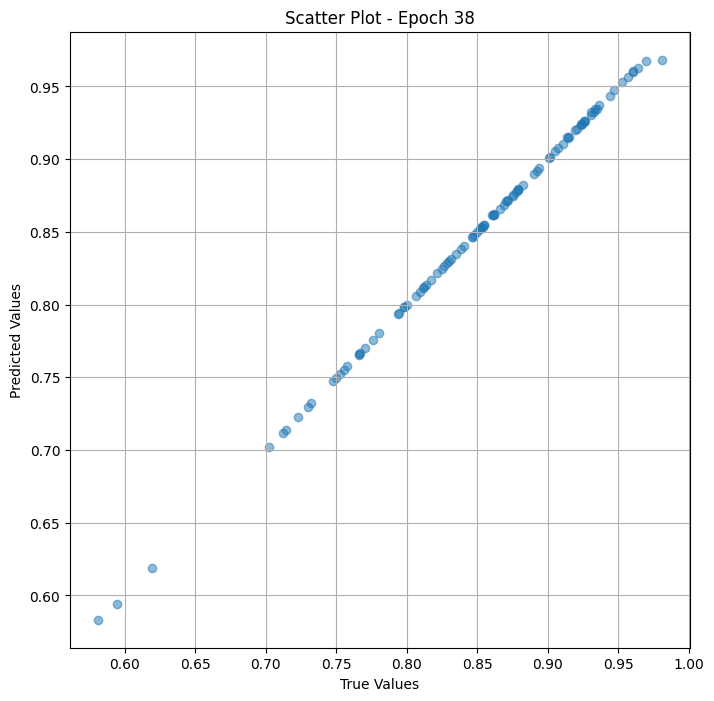

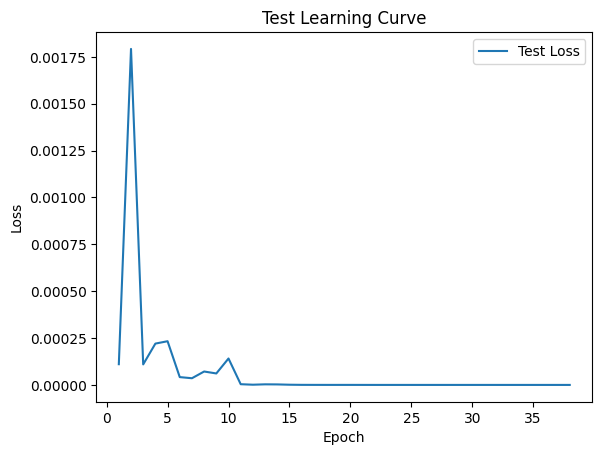


 Epoch: (39/50) Loss = 5.615456544205699e-09

 Epoch: (39/50) Loss_rmse = 7.493635348509997e-05

 Epoch: (39/50) R^2 = 0.999997615814209

 Epoch: (39/50) MAE = 7.411837577819824e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

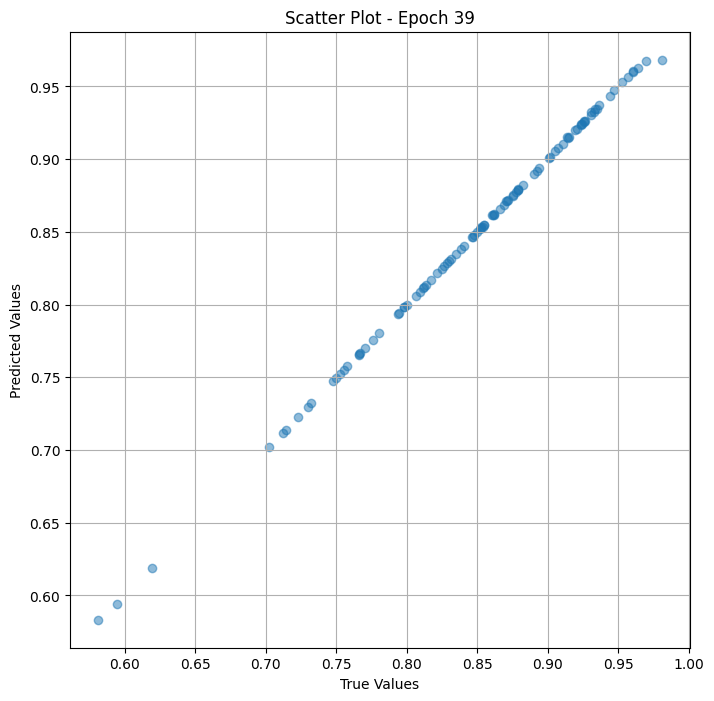

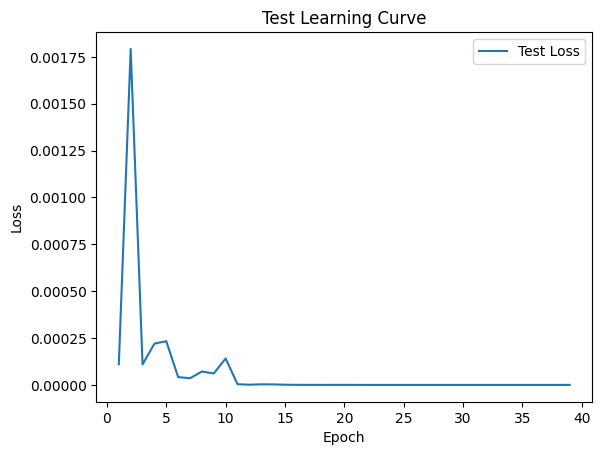


 Epoch: (40/50) Loss = 5.6100919465507104e-09

 Epoch: (40/50) Loss_rmse = 7.490054849768057e-05

 Epoch: (40/50) R^2 = 0.999997615814209

 Epoch: (40/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

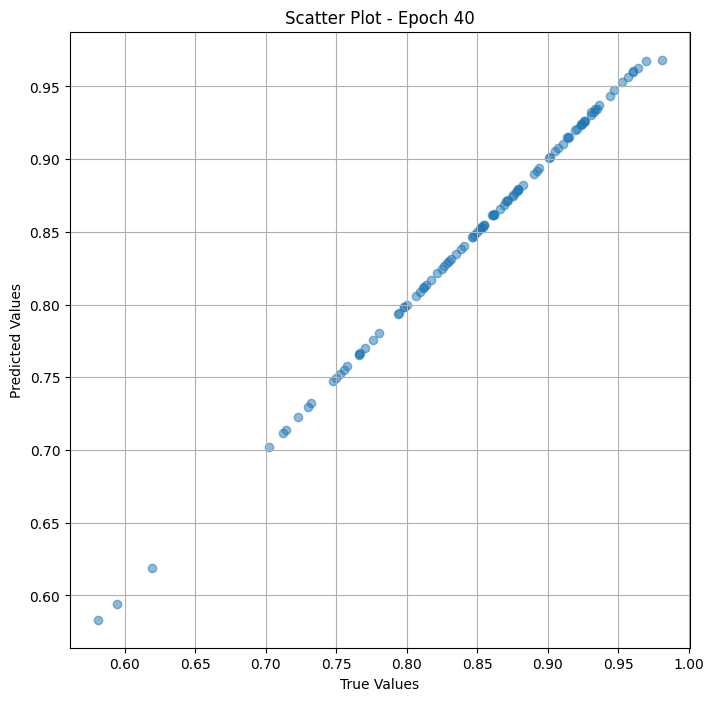

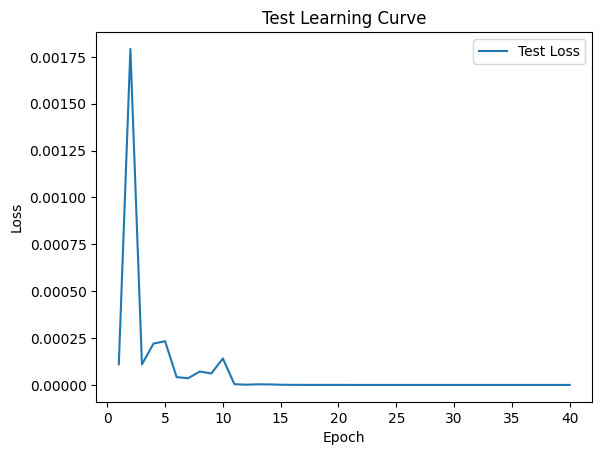


 Epoch: (41/50) Loss = 5.6100919465507104e-09

 Epoch: (41/50) Loss_rmse = 7.490054849768057e-05

 Epoch: (41/50) R^2 = 0.999997615814209

 Epoch: (41/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

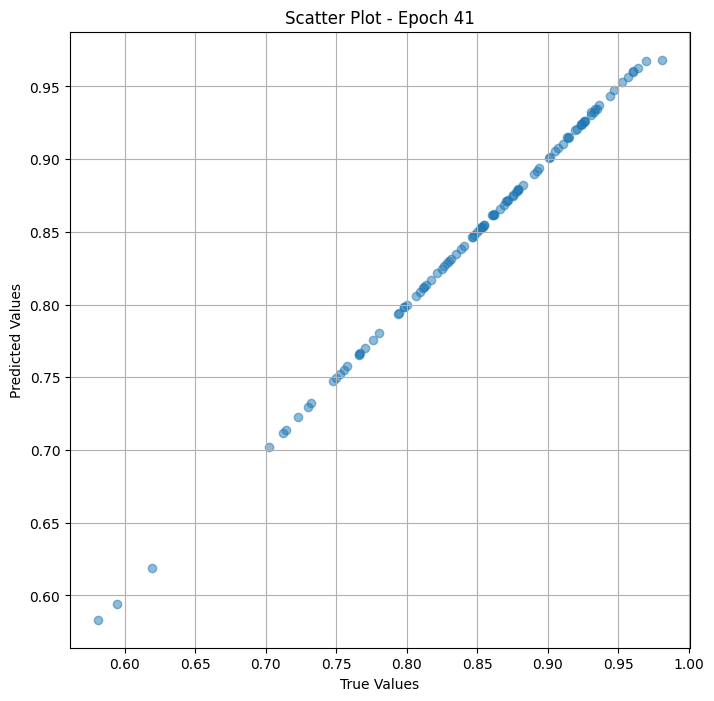

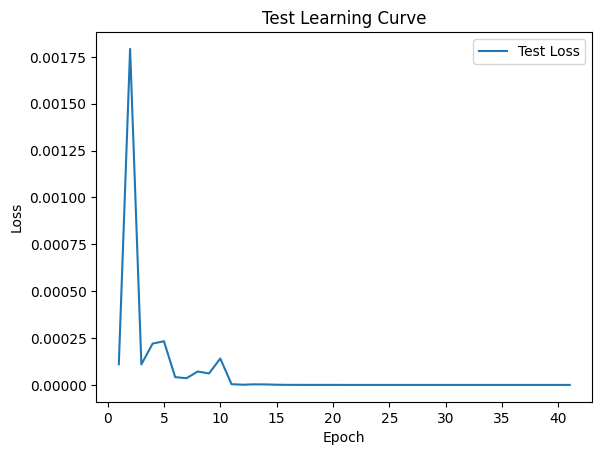


 Epoch: (42/50) Loss = 5.607268427354484e-09

 Epoch: (42/50) Loss_rmse = 7.488169649150223e-05

 Epoch: (42/50) R^2 = 0.9999976754188538

 Epoch: (42/50) MAE = 7.40736722946167e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

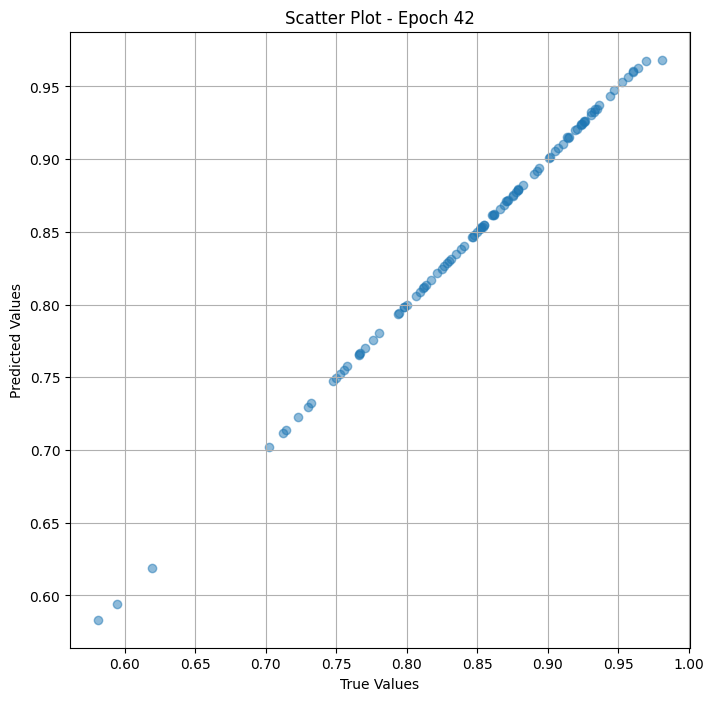

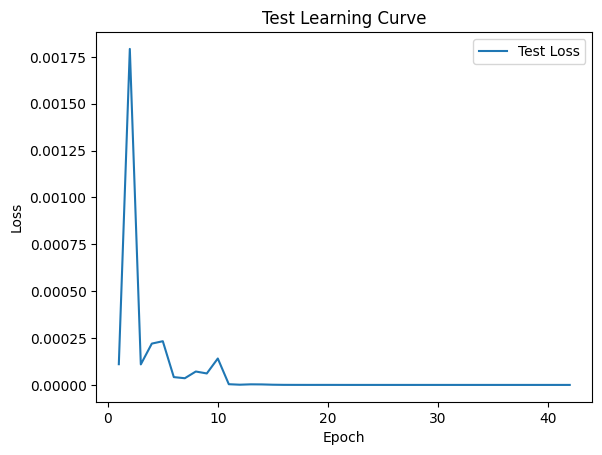


 Epoch: (43/50) Loss = 5.610830910995901e-09

 Epoch: (43/50) Loss_rmse = 7.490548159694299e-05

 Epoch: (43/50) R^2 = 0.999997615814209

 Epoch: (43/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

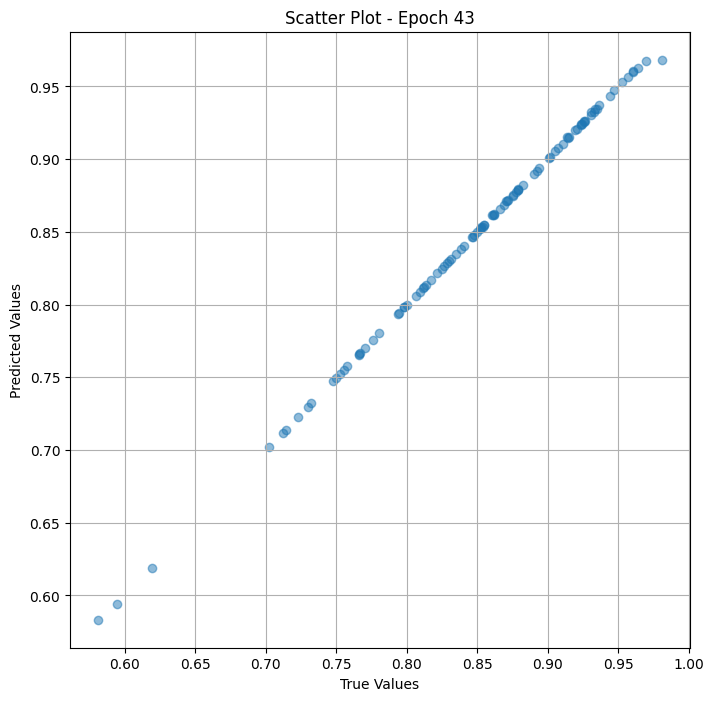

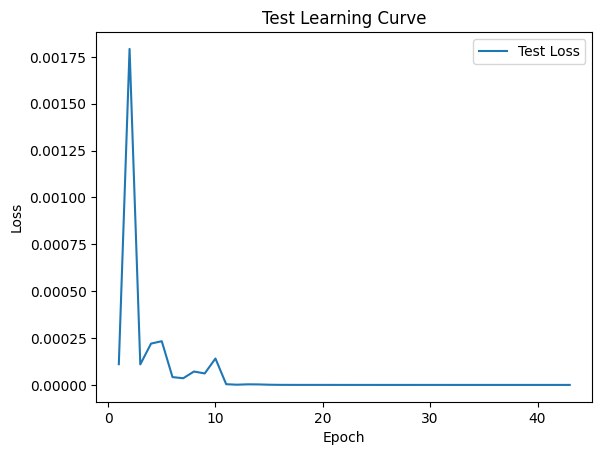


 Epoch: (44/50) Loss = 5.605466313340912e-09

 Epoch: (44/50) Loss_rmse = 7.486966205760837e-05

 Epoch: (44/50) R^2 = 0.9999976754188538

 Epoch: (44/50) MAE = 7.405877113342285e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

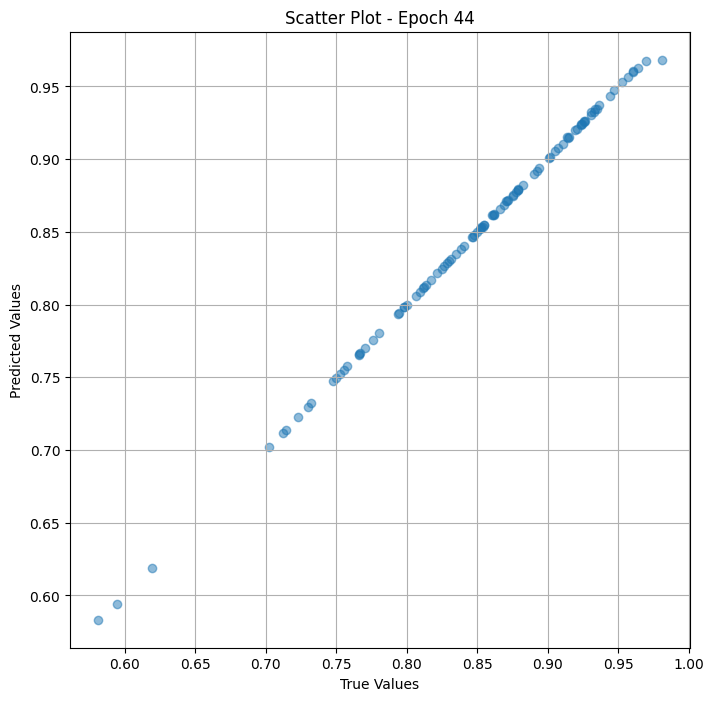

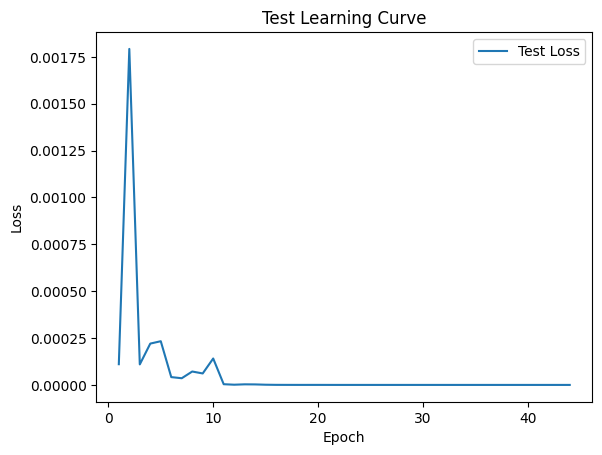


 Epoch: (45/50) Loss = 5.610830910995901e-09

 Epoch: (45/50) Loss_rmse = 7.490548159694299e-05

 Epoch: (45/50) R^2 = 0.999997615814209

 Epoch: (45/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

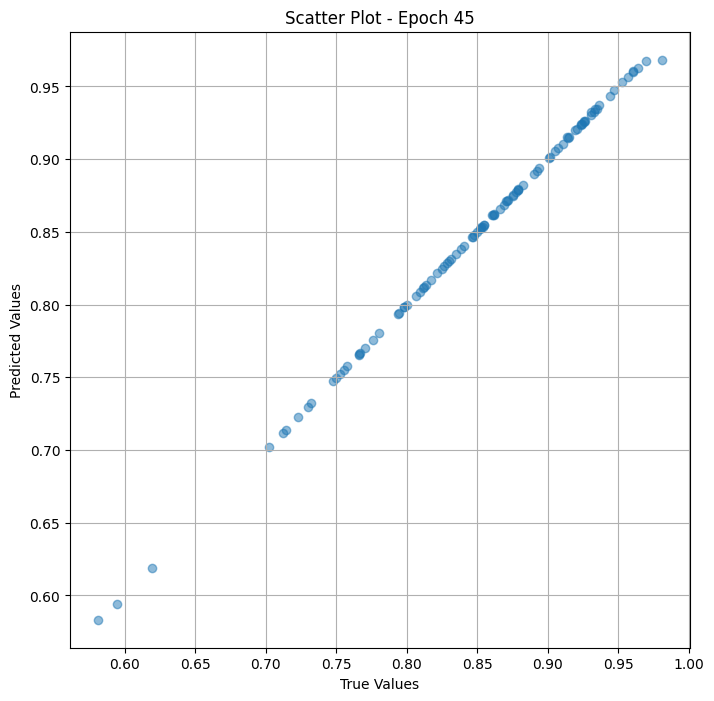

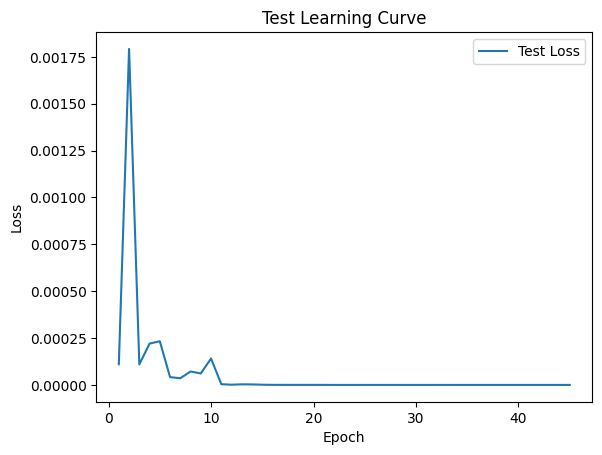


 Epoch: (46/50) Loss = 5.605466313340912e-09

 Epoch: (46/50) Loss_rmse = 7.486966205760837e-05

 Epoch: (46/50) R^2 = 0.9999976754188538

 Epoch: (46/50) MAE = 7.405877113342285e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

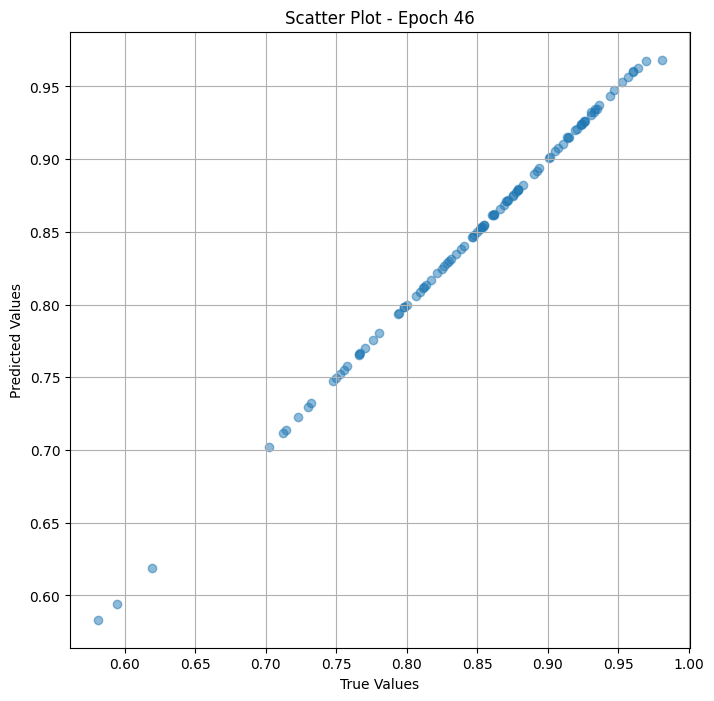

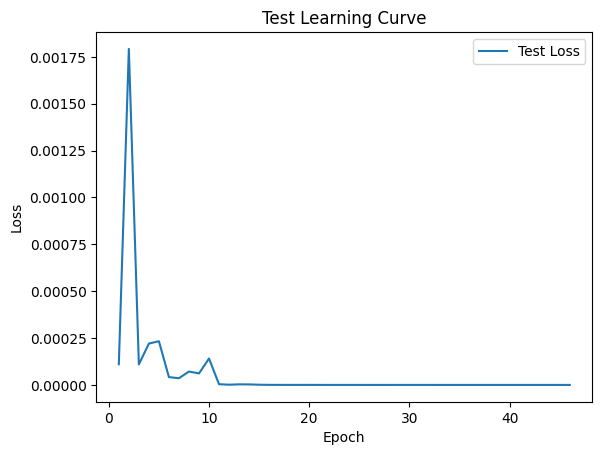


 Epoch: (47/50) Loss = 5.610830910995901e-09

 Epoch: (47/50) Loss_rmse = 7.490548159694299e-05

 Epoch: (47/50) R^2 = 0.999997615814209

 Epoch: (47/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.84

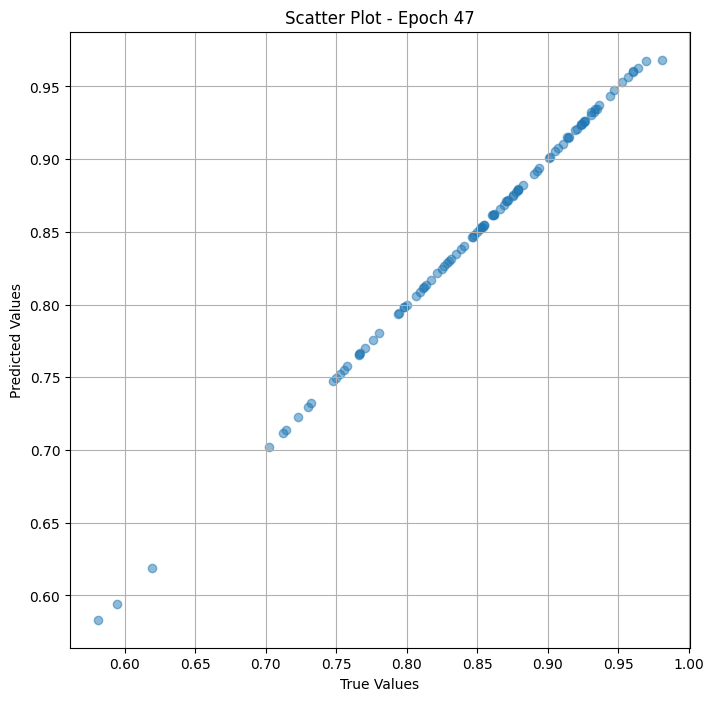

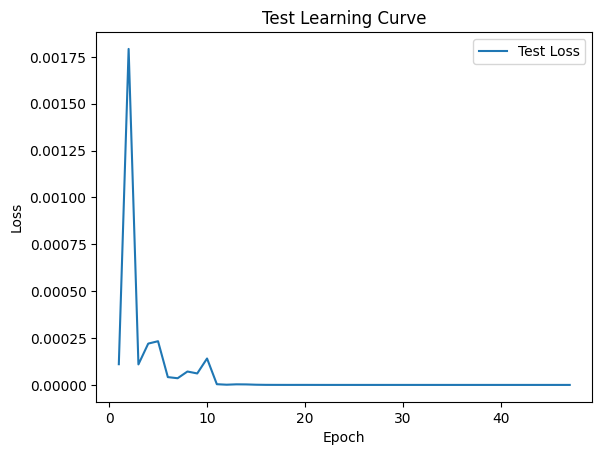


 Epoch: (48/50) Loss = 5.605466313340912e-09

 Epoch: (48/50) Loss_rmse = 7.486966205760837e-05

 Epoch: (48/50) R^2 = 0.9999976754188538

 Epoch: (48/50) MAE = 7.405877113342285e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

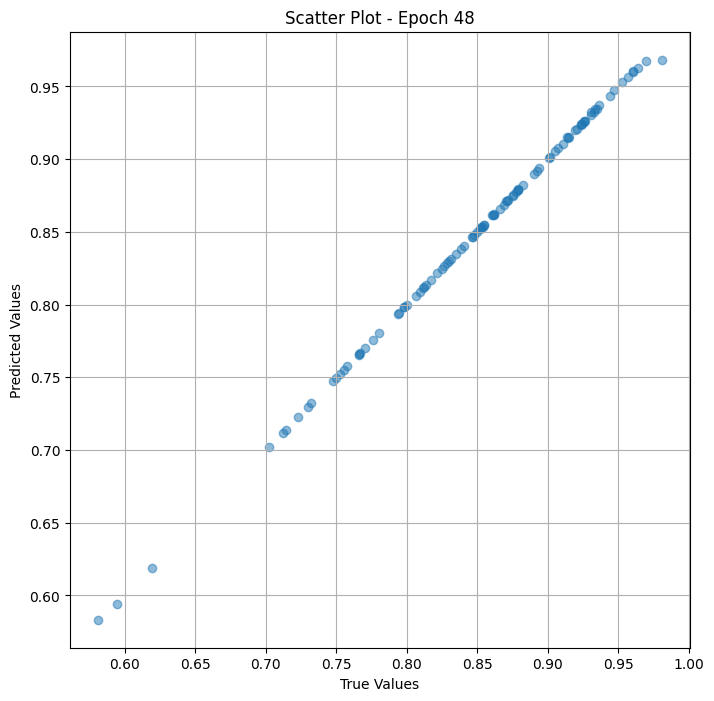

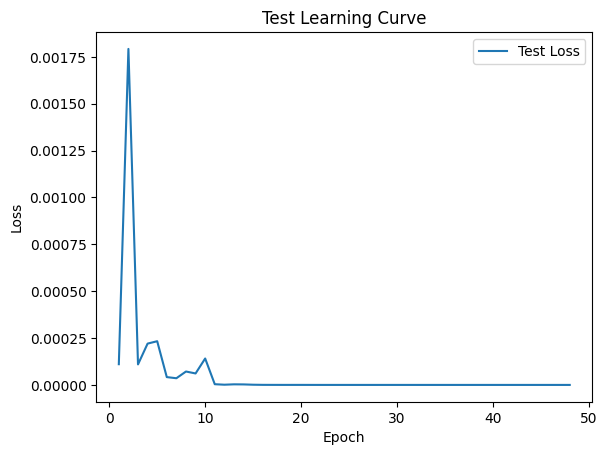


 Epoch: (49/50) Loss = 5.605466313340912e-09

 Epoch: (49/50) Loss_rmse = 7.486966205760837e-05

 Epoch: (49/50) R^2 = 0.9999976754188538

 Epoch: (49/50) MAE = 7.405877113342285e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

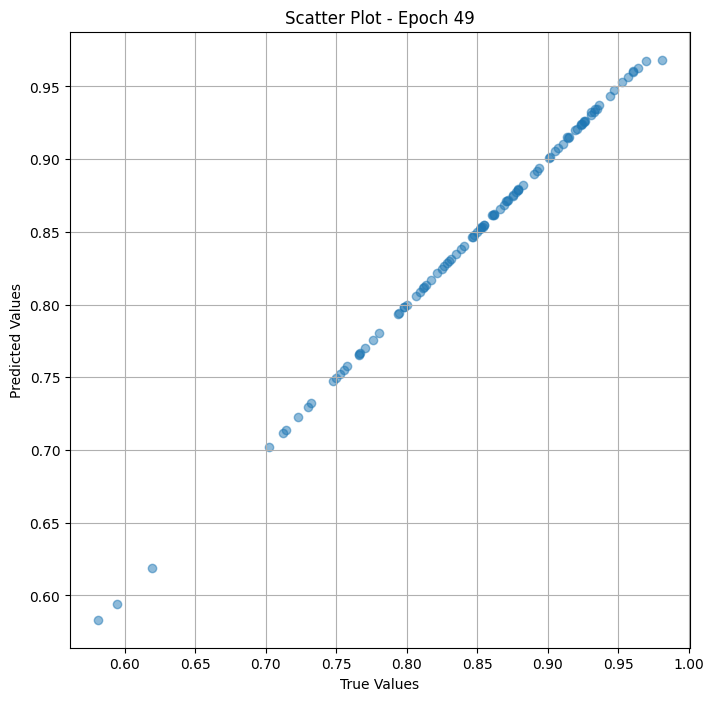

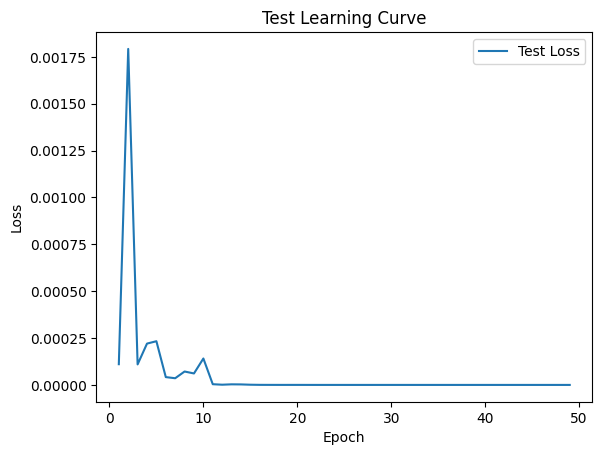


 Epoch: (50/50) Loss = 5.6100919465507104e-09

 Epoch: (50/50) Loss_rmse = 7.490054849768057e-05

 Epoch: (50/50) R^2 = 0.999997615814209

 Epoch: (50/50) MAE = 7.408857345581055e-05
Spearman correlation coefficient: SignificanceResult(statistic=0.9998372188156063, pvalue=1.0149305704264735e-165)

 true_values_list_val : 100

 predicted_values_list_val : 100

 true_values_list_val : [0.9237288, 0.8604651, 0.8545455, 0.89215684, 0.93457943, 0.94382024, 0.7118644, 0.91071427, 0.83505154, 0.8214286, 0.8172043, 0.96, 0.83838385, 0.8659794, 0.75789475, 0.8785047, 0.7706422, 0.8468468, 0.9052632, 0.82608694, 0.9142857, 0.8118812, 0.76666665, 0.9150943, 0.85365856, 0.82474226, 0.85263157, 0.90123457, 0.71428573, 0.7227723, 0.79787236, 0.9263158, 0.8, 0.7525773, 0.75, 0.85263157, 0.8712871, 0.8787879, 0.89361703, 0.8545455, 0.61904764, 0.70238096, 0.8703704, 0.8113208, 0.8518519, 0.92523366, 0.9207921, 0.7943925, 0.875, 0.95238096, 0.88990825, 0.84615386, 0.7802198, 0.8064516, 0.83157897, 0.8

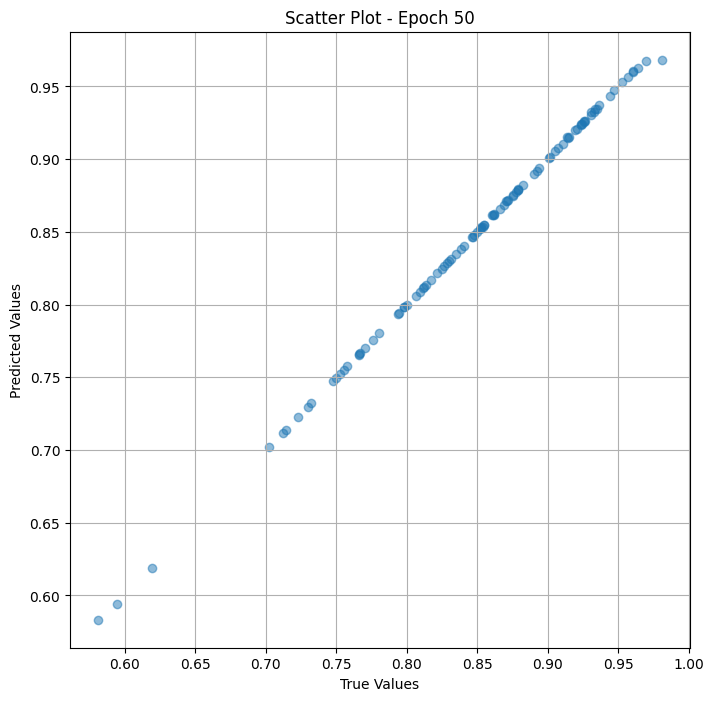

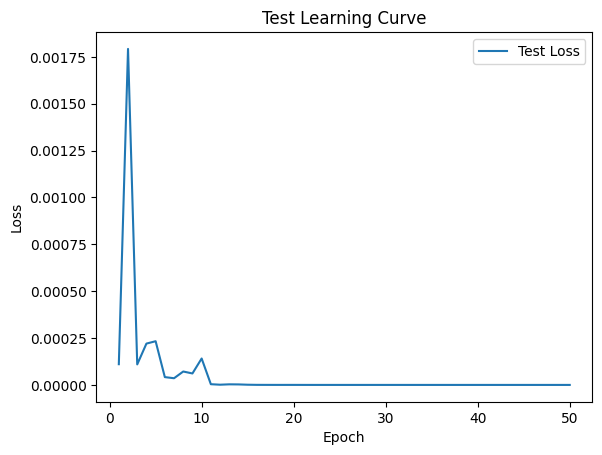

In [ ]:
# val the model and save weights
fit(50,model_res_test , test_dl )
torch.save(model_res_test.state_dict(), "model_weights_s")

In [ ]:
true_values_list_test = []
predicted_values_list_test = []

for x_trans, yb in test_dl:
    preds = model_res_test(x_trans)
    true_values_list_test.extend(yb.cpu().detach().numpy())
    predicted_values_list_test.extend(preds.squeeze().cpu().detach().numpy())



# Assuming 'df_test_food' is your original DataFrame and 'true_values' and 'predicted_values' are lists of true and predicted values
df_result_fine = pd.DataFrame({
    'Image Path': df_test_food['preprocessed_image_path'],
    'True Value': true_values_list_test,  # Replace with your actual true values
    'Predicted Value': predicted_values_list_test # Replace with your actual predicted values
})

# Display the resulting DataFrame
print(df_result_fine)

                                        Image Path  True Value  \
0      /content/food/000000445557_preprocessed.jpg    0.923729   
1      /content/food/000000321324_preprocessed.jpg    0.860465   
2   /content/food/n07806221_23145_preprocessed.jpg    0.854545   
3   /content/food/n07863374_17253_preprocessed.jpg    0.892157   
4    /content/food/n07711569_4665_preprocessed.jpg    0.934579   
..                                             ...         ...   
95  /content/food/n07849336_29721_preprocessed.jpg    0.765957   
96    /content/food/n07680932_803_preprocessed.jpg    0.829787   
97  /content/food/n07654148_13056_preprocessed.jpg    0.871795   
98     /content/food/000000558809_preprocessed.jpg    0.925926   
99   /content/food/n07717556_4579_preprocessed.jpg    0.956522   

    Predicted Value  
0          0.924019  
1          0.861838  
2          0.854638  
3          0.891719  
4          0.934309  
..              ...  
95         0.765569  
96         0.829727  
97       

# ทดสอบกับรูปอื่นๆ

In [ ]:
model = Resnet_model_test_res_food()
image = Image.open("/content/animal/000000002066.jpg")

# Define preprocessing transforms
preprocess = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize to match the input size expected by the model
    transforms.ToTensor(),           # Convert to a PyTorch tensor
    transforms.Normalize(mean=[0.0, 0.0, 0.0], std=[1.0, 1.0, 1.0])  # Normalize the image
])

# Apply preprocessing transforms
input_data = preprocess(image)

# Add batch dimension as the model expects a batch
input_data = input_data.unsqueeze(0)

# Assuming ViTMem_model is a PyTorch model
model = Resnet_model_test_res_food()
memorability = model(input_data)

print(f"Estimated memorability: {memorability}")



Estimated memorability: tensor([[0.5027]], grad_fn=<SigmoidBackward0>)
